In [2]:
import numpy as np
import pandas as pd 

import matplotlib.pyplot as plt
import pickle
import statsmodels.api as sm
from statsmodels.formula.api import ols
from statsmodels.sandbox.regression.predstd import wls_prediction_std
import datetime
import xlrd
import os
import re
from scipy.stats import kstest
from scipy.spatial.distance import directed_hausdorff
from scipy import optimize
import pwlf
from scipy.optimize import minimize
from pyecharts import options as opts
from pyecharts.charts import Calendar
from matplotlib.ticker import FuncFormatter
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
import math
from sklearn.exceptions import ConvergenceWarning
import warnings
import contextlib
import xgboost
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from sklearn.model_selection import train_test_split
from scipy.optimize import curve_fit

In [3]:
# load day ahead price data from E:\day-ahead price\Data\ISO_New_England\day_ahead_price
path = r'E:\day-ahead price\Data\ISO_New_England\day_ahead_price'
os.chdir(path)
files = os.listdir(path)
df_d1 = pd.DataFrame()
for file in files:
    delimiter = ','
    max_columns = max(open(file), key=lambda x: x.count(delimiter)).count(delimiter)
    df_tmp = pd.read_csv(file, header=None, names=list(range(max_columns+1)))
    # print(df_tmp)
    df_d1 = pd.concat([df_d1, df_tmp])
df_d1.columns = df_d1.iloc[4]
df_d1 = df_d1[df_d1['H'] == 'D'].drop(['H'], axis = 1).reset_index(drop = True)
# average price by Date and Hour Ending
tmp = []
df_d1['Hour Ending'] = df_d1['Hour Ending'].astype(str)
df_d1['Date'] = pd.to_datetime(df_d1['Date'])
df_d1['Date'] = df_d1['Date'].dt.strftime('%Y-%m-%d')
df_d1['Locational Marginal Price'] = df_d1['Locational Marginal Price'].astype(float)
df_d1['Energy Component'] = df_d1['Energy Component'].astype(float)
df_d1['Congestion Component'] = df_d1['Congestion Component'].astype(float)
df_d1['Marginal Loss Component'] = df_d1['Marginal Loss Component'].astype(float)
df_group = df_d1.groupby(['Date', 'Hour Ending'])
for [Date, Hour_Ending], group in df_group:
    Locational_Marginal_Price = group['Locational Marginal Price'].mean() 
    Energy_Component = group['Energy Component'].mean()
    Congestion_Component = group['Congestion Component'].mean()
    Marginal_Loss_Component = group['Marginal Loss Component'].mean()
    tmp.append([Date, Hour_Ending, Locational_Marginal_Price, Energy_Component, Congestion_Component, Marginal_Loss_Component])
df_price = pd.DataFrame(tmp, columns = ['Date', 'Hour Ending', 'Locational Marginal Price', 'Energy Component', 'Congestion Component', 'Marginal Loss Component'])
df_price

,Date,Hour Ending,Locational Marginal Price,Energy Component,Congestion Component,Marginal Loss Component
0,2022-01-01,01,32.124229,32.35,-0.089337,-0.136434
1,2022-01-01,02,32.057678,32.31,-0.111808,-0.140514
2,2022-01-01,03,30.726426,30.85,0.000000,-0.123574
3,2022-01-01,04,29.569668,29.69,0.000000,-0.120332
4,2022-01-01,05,30.738126,30.86,0.000000,-0.121874
...,...,...,...,...,...,...
16315,2023-11-11,20,40.609046,40.90,-0.030929,-0.260025
16316,2023-11-11,21,40.179589,40.43,-0.028840,-0.221571
16317,2023-11-11,22,39.871406,40.09,-0.032385,-0.186209
16318,2023-11-11,23,29.190831,29.34,-0.002179,-0.146990


In [4]:
# df_price lack a line of data in Date 2023-03-12, Hour Ending 3, so we need to add this line by average of Hour Ending 2 and Hour Ending 4
lost_data = pd.DataFrame({'Date': '2023-03-12', 'Hour Ending': '03', 'Locational Marginal Price': (df_price[(df_price['Date'] == '2023-03-12') & (df_price['Hour Ending'] == '02')]['Locational Marginal Price'].values[0] + df_price[(df_price['Date'] == '2023-03-12') & (df_price['Hour Ending'] == '04')]['Locational Marginal Price'].values[0])/2, 'Energy Component': (df_price[(df_price['Date'] == '2023-03-12') & (df_price['Hour Ending'] == '02')]['Energy Component'].values[0] + df_price[(df_price['Date'] == '2023-03-12') & (df_price['Hour Ending'] == '04')]['Energy Component'].values[0])/2, 'Congestion Component': (df_price[(df_price['Date'] == '2023-03-12') & (df_price['Hour Ending'] == '02')]['Congestion Component'].values[0] + df_price[(df_price['Date'] == '2023-03-12') & (df_price['Hour Ending'] == '04')]['Congestion Component'].values[0])/2, 'Marginal Loss Component': (df_price[(df_price['Date'] == '2023-03-12') & (df_price['Hour Ending'] == '02')]['Marginal Loss Component'].values[0] + df_price[(df_price['Date'] == '2023-03-12') & (df_price['Hour Ending'] == '04')]['Marginal Loss Component'].values[0])/2}, index = [0])
df_price = pd.concat([df_price, lost_data]).sort_values(by = ['Date', 'Hour Ending']).reset_index(drop = True)
# delete the line of data in Date 2023-11-05, whose Hour Ending = '02X' 
df_price = df_price.drop(df_price[(df_price['Date'] == '2023-11-05') & (df_price['Hour Ending'] == '02X')].index).reset_index(drop = True)
# delete the line of data in Date 2022-11-06, whose Hour Ending = '02X' 
df_price = df_price.drop(df_price[(df_price['Date'] == '2022-11-06') & (df_price['Hour Ending'] == '02X')].index).reset_index(drop = True)
df_price['Hour Ending'] = df_price['Hour Ending'].astype(int)
df_price['Date'] = pd.to_datetime(df_price['Date'])
df_price

,Date,Hour Ending,Locational Marginal Price,Energy Component,Congestion Component,Marginal Loss Component
0,2022-01-01,1,32.124229,32.35,-0.089337,-0.136434
1,2022-01-01,2,32.057678,32.31,-0.111808,-0.140514
2,2022-01-01,3,30.726426,30.85,0.000000,-0.123574
3,2022-01-01,4,29.569668,29.69,0.000000,-0.120332
4,2022-01-01,5,30.738126,30.86,0.000000,-0.121874
...,...,...,...,...,...,...
16314,2023-11-11,20,40.609046,40.90,-0.030929,-0.260025
16315,2023-11-11,21,40.179589,40.43,-0.028840,-0.221571
16316,2023-11-11,22,39.871406,40.09,-0.032385,-0.186209
16317,2023-11-11,23,29.190831,29.34,-0.002179,-0.146990


In [4]:
# load real capacity data from E:\day-ahead price\Data\ISO_New_England\real_capacity
path = r'E:\day-ahead price\Data\ISO_New_England\real_capacity'
os.chdir(path)
files = os.listdir(path)
df_peak_load = pd.DataFrame()
df_capa = pd.DataFrame()
df_interchange = pd.DataFrame()
for file in files:
    delimiter = ','
    max_columns = max(open(file), key=lambda x: x.count(delimiter)).count(delimiter)
    df_tmp = pd.read_csv(file, header=None, names=list(range(max_columns+1)))
    df_tmp = df_tmp.iloc[8:50, :].reset_index(drop=True)

    prior_date = pd.to_datetime(df_tmp.iloc[1, 1])
    Hour_Ending = int(df_tmp.iloc[1, 2])
    peak_load = float(df_tmp.iloc[1, 3])
    df_peak_load = pd.concat([df_peak_load, pd.DataFrame([[prior_date, Hour_Ending, peak_load]], columns=['Date', 'Hour Ending', 'Peak Load'])], axis=0)

    report_date = prior_date + datetime.timedelta(1)
    Capacity_Supply_Obligation = float(df_tmp.iloc[4, 2])
    Capacity_Additions_EcoMax_Bid_CSO = float(df_tmp.iloc[5, 2])	
    Generation_Outages_and_Reductions = float(df_tmp.iloc[6, 2])
    Uncommitted_Available_Generation = float(df_tmp.iloc[7, 2])
    DRR_Capacity = float(df_tmp.iloc[8, 2])
    Uncommitted_Available_DRR = float(df_tmp.iloc[9, 2])
    Net_Deliveries = float(df_tmp.iloc[17, 2])
    Total_Available_Capacity = float(df_tmp.iloc[18, 2])
    Peak_Load_Forecast = float(df_tmp.iloc[19, 2])
    Total_Operating_Reserve_Requirements = float(df_tmp.iloc[20, 2])
    Capacity_Required = float(df_tmp.iloc[21, 2])
    Surplus_Deficiency = float(df_tmp.iloc[22, 2])
    Replacement_Reserve_Requirement = float(df_tmp.iloc[23, 2])
    Excess_Commitment_Surplus_Deficiency = float(df_tmp.iloc[24, 2])
    df_capa = pd.concat([df_capa, pd.DataFrame([[report_date, Hour_Ending, Capacity_Supply_Obligation, Capacity_Additions_EcoMax_Bid_CSO, Generation_Outages_and_Reductions, Uncommitted_Available_Generation, DRR_Capacity, Uncommitted_Available_DRR, Net_Deliveries, Total_Available_Capacity, Peak_Load_Forecast, Total_Operating_Reserve_Requirements, Capacity_Required, Surplus_Deficiency, Replacement_Reserve_Requirement, Excess_Commitment_Surplus_Deficiency]], columns=['Date', 'Hour Ending', 'Capacity Supply Obligation', 'Capacity Additions EcoMax Bid CSO', 'Generation Outages and Reductions', 'Uncommitted Available Generation', 'DRR Capacity', 'Uncommitted Available DRR', 'Net Deliveries', 'Total Available Capacity', 'Peak Load Forecast', 'Total Operating Reserve Requirements', 'Capacity Required', 'Surplus Deficiency', 'Replacement Reserve Requirement', 'Excess Commitment Surplus Deficiency'])], axis=0)

    tmp_interchange = df_tmp.iloc[35:, 1:].reset_index(drop=True)
    tmp_interchange.columns = tmp_interchange.iloc[0]
    tmp_interchange = tmp_interchange.iloc[1:, :].reset_index(drop=True)
    tmp_interchange['Date'] = report_date
    df_interchange = pd.concat([df_interchange, tmp_interchange], axis=0)
    
df_peak_load = df_peak_load.drop_duplicates(subset=['Date'], keep='first').reset_index(drop=True)
df_capa = df_capa.drop_duplicates(subset=['Date'], keep='first').reset_index(drop=True)
df_interchange = df_interchange.drop_duplicates(subset=['Date', 'Description'], keep='first').reset_index(drop=True)
df_capa

,Date,Hour Ending,Capacity Supply Obligation,Capacity Additions EcoMax Bid CSO,Generation Outages and Reductions,Uncommitted Available Generation,DRR Capacity,Uncommitted Available DRR,Net Deliveries,Total Available Capacity,Peak Load Forecast,Total Operating Reserve Requirements,Capacity Required,Surplus Deficiency,Replacement Reserve Requirement,Excess Commitment Surplus Deficiency
0,2022-01-01,18,29741.0,1491.0,2621.0,13055.0,233.0,12.0,-3394.0,19171.0,14220.0,2209.0,16429.0,2742.0,180.0,2562.0
1,2022-01-02,18,29741.0,1970.0,1930.0,13834.0,232.0,12.0,-3088.0,19255.0,15400.0,2209.0,17609.0,1646.0,180.0,1466.0
2,2022-01-03,18,29741.0,2124.0,1806.0,11739.0,331.0,12.0,-2794.0,21433.0,18000.0,2209.0,20209.0,1224.0,180.0,1044.0
3,2022-01-04,18,29741.0,1867.0,2509.0,11443.0,322.0,12.0,-3146.0,21112.0,17570.0,2209.0,19779.0,1333.0,180.0,1153.0
4,2022-01-05,18,29741.0,1817.0,2524.0,9464.0,325.0,12.0,-1837.0,21720.0,16700.0,2209.0,18909.0,2811.0,180.0,2631.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
675,2023-11-07,18,28377.0,1129.0,9637.0,4125.0,220.0,12.0,-2401.0,18353.0,14500.0,2108.0,16608.0,1745.0,180.0,1565.0
676,2023-11-08,18,28377.0,1769.0,8918.0,4023.0,220.0,12.0,-2383.0,19796.0,15280.0,2053.0,17333.0,2463.0,180.0,2283.0
677,2023-11-09,18,28377.0,974.0,9639.0,3207.0,226.0,12.0,-2002.0,18721.0,15360.0,2110.0,17470.0,1251.0,180.0,1071.0
678,2023-11-10,18,28377.0,1268.0,9118.0,4559.0,224.0,12.0,-2145.0,18325.0,14830.0,2068.0,16898.0,1427.0,180.0,1247.0


In [5]:
# load real load data from E:\day-ahead price\Data\ISO_New_England\real_load
path = r'E:\day-ahead price\Data\ISO_New_England\real_load'
os.chdir(path)
files = os.listdir(path)
df_real_load = pd.DataFrame()
for file in files:
    delimiter = ','
    max_columns = max(open(file), key=lambda x: x.count(delimiter)).count(delimiter)
    df_tmp = pd.read_csv(file, header=None, names=list(range(max_columns+1)))
    df_tmp.columns = df_tmp.iloc[4]
    df_tmp = df_tmp[df_tmp['H'] == 'D'].iloc[:, 1:].reset_index(drop=True)
    df_tmp['Date'] = pd.to_datetime(df_tmp['Date'])
    df_tmp = df_tmp[df_tmp['Hour Ending'] != '02X']
    df_tmp['Hour Ending'] = df_tmp['Hour Ending'].astype(int)
    df_tmp['Day-Ahead Cleared Demand'] = df_tmp['Day-Ahead Cleared Demand'].astype(float)
    df_real_load = pd.concat([df_real_load, df_tmp], axis=0)
df_real_load

4,Date,Hour Ending,Day-Ahead Cleared Demand
0,2022-10-01,1,9518.0
1,2022-10-01,2,9639.0
2,2022-10-01,3,9445.0
3,2022-10-01,4,9317.0
4,2022-10-01,5,9460.0
...,...,...,...
356,2023-11-11,20,13427.0
357,2023-11-11,21,13145.0
358,2023-11-11,22,12383.0
359,2023-11-11,23,11749.0


In [6]:
# df_real_load lack a line of data in Date 2023-03-12, Hour Ending 3, so we need to add this line by average of Hour Ending 2 and Hour Ending 4
df_tmp = df_real_load[(df_real_load['Date'] == '2023-03-12') & (df_real_load['Hour Ending'] == 2)].reset_index(drop=True)
df_tmp['Hour Ending'] = 3
df_tmp['Day-Ahead Cleared Demand'] = (df_real_load[(df_real_load['Date'] == '2023-03-12') & (df_real_load['Hour Ending'] == 2)]['Day-Ahead Cleared Demand'].values + df_real_load[(df_real_load['Date'] == '2023-03-12') & (df_real_load['Hour Ending'] == 4)]['Day-Ahead Cleared Demand'].values) / 2
df_real_load = pd.concat([df_real_load, df_tmp], axis=0).reset_index(drop=True).sort_values(by=['Date', 'Hour Ending']).reset_index(drop=True)
df_real_load

4,Date,Hour Ending,Day-Ahead Cleared Demand
0,2022-10-01,1,9518.0
1,2022-10-01,2,9639.0
2,2022-10-01,3,9445.0
3,2022-10-01,4,9317.0
4,2022-10-01,5,9460.0
...,...,...,...
9763,2023-11-11,20,13427.0
9764,2023-11-11,21,13145.0
9765,2023-11-11,22,12383.0
9766,2023-11-11,23,11749.0


In [7]:
# load real wind generation data from E:\day-ahead price\Data\ISO_New_England\real_wind
path = r'E:\day-ahead price\Data\ISO_New_England\real_wind'
os.chdir(path)
df_wind_generation1 = pd.read_excel('hourly_wind_gen_2023.xlsx', sheet_name='HourlyData')
df_wind_generation2 = pd.read_excel('hourly_wind_gen_2022.xlsx', sheet_name='HourlyData')
df_wind_generation = pd.concat([df_wind_generation2, df_wind_generation1], axis=0).reset_index(drop=True)
# delete the line of data in Date 2022-11-06, whose local_hour_end = '02X' 
df_wind_generation = df_wind_generation.drop(df_wind_generation[(df_wind_generation['local_day'] == '2022-11-06') & (df_wind_generation['local_hour_end'] == '02X')].index).reset_index(drop = True)
# df lack a line of data in Date 2023-03-12, Hour Ending 2, so we need to add this line by average of Hour Ending 1 and Hour Ending 3
lost_data = pd.DataFrame({'year': 2023, 'local_day': pd.to_datetime('2023-03-12'), 'local_hour_end': 2, 'tot_wind_mwh': (df_wind_generation[(df_wind_generation['local_day'] == '2023-03-12') & (df_wind_generation['local_hour_end'] == 1)]['tot_wind_mwh'].values[0] + df_wind_generation[(df_wind_generation['local_day'] == '2023-03-12') & (df_wind_generation['local_hour_end'] == 3)]['tot_wind_mwh'].values[0])/2}, index = [0])
df_wind_generation = pd.concat([df_wind_generation, lost_data]).sort_values(by = ['local_day', 'local_hour_end']).reset_index(drop = True)
df_wind_generation['Hour Ending'] = df_wind_generation['local_hour_end'].astype(int)
df_wind_generation['Date'] = pd.to_datetime(df_wind_generation['local_day'])
df_wind_generation

,year,local_day,local_hour_end,tot_wind_mwh,_FREQ_,Hour Ending,Date
0,2022,2022-01-01,01,87.365,45.0,1,2022-01-01
1,2022,2022-01-01,02,108.647,44.0,2,2022-01-01
2,2022,2022-01-01,03,131.752,46.0,3,2022-01-01
3,2022,2022-01-01,04,154.410,46.0,4,2022-01-01
4,2022,2022-01-01,05,154.527,43.0,5,2022-01-01
...,...,...,...,...,...,...,...
15306,2023,2023-09-30,20,77.428,41.0,20,2023-09-30
15307,2023,2023-09-30,21,97.503,41.0,21,2023-09-30
15308,2023,2023-09-30,22,97.517,41.0,22,2023-09-30
15309,2023,2023-09-30,23,95.512,44.0,23,2023-09-30


In [8]:
# load forecast capacity data from E:\day-ahead price\Data\ISO_New_England\forecast_capacity
path = r'E:\day-ahead price\Data\ISO_New_England\forecast_capacity'
os.chdir(path)
files = os.listdir(path)
df1 = pd.DataFrame()
df2 = pd.DataFrame()
for file in files:
    delimiter = ','
    max_columns = max(open(file), key=lambda x: x.count(delimiter)).count(delimiter)
    df_tmp = pd.read_csv(file, header=None, names=list(range(max_columns+1)))
    df_tmp = df_tmp.iloc[6:27, 1:4].T
    df_tmp.columns = df_tmp.iloc[0]
    df_tmp = df_tmp.drop(['Weather', 'High Temperature - Boston', 'Dew Point - Boston', 'High Temperature - Hartford', 'Dew Point - Hartford', 'Generating Capacity Position'], axis=1).reset_index(drop=True).iloc[1:,:]
    df_tmp['Date'] = pd.to_datetime(df_tmp['Date'])
    df_tmp['Total Capacity Supply Obligation (CSO)'] = df_tmp['Total Capacity Supply Obligation (CSO)'].astype(float)
    df_tmp['Anticipated Cold Weather Outages'] = df_tmp['Anticipated Cold Weather Outages'].astype(float)
    df_tmp['Other Generation Outages'] = df_tmp['Other Generation Outages'].astype(float)
    df_tmp['Anticipated De-List MW Offered'] = df_tmp['Anticipated De-List MW Offered'].astype(float)
    df_tmp['Total Generation Available'] = df_tmp['Total Generation Available'].astype(float)
    df_tmp['Import at Time of Peak'] = df_tmp['Import at Time of Peak'].astype(float)
    df_tmp['Total Available Generation and Imports'] = df_tmp['Total Available Generation and Imports'].astype(float)
    df_tmp['Projected Peak Load'] = df_tmp['Projected Peak Load'].astype(float)
    df_tmp['Replacement Reserve Requirement'] = df_tmp['Replacement Reserve Requirement'].astype(float)
    df_tmp['Required Reserve'] = df_tmp['Required Reserve'].astype(float)
    df_tmp['Required Reserve including Replacement'] = df_tmp['Required Reserve including Replacement'].astype(float)
    df_tmp['Total Load plus Required Reserve'] = df_tmp['Total Load plus Required Reserve'].astype(float)
    df_tmp['Projected Surplus/(Deficiency)'] = df_tmp['Projected Surplus/(Deficiency)'].astype(float)
    df_tmp['Available Demand Response Resources'] = df_tmp['Available Demand Response Resources'].astype(float)
    column_name = df_tmp.columns
    df1 = pd.concat([df1, df_tmp.iloc[0, :]], axis=1)
    df2 = pd.concat([df2, df_tmp.iloc[1, :]], axis=1)
df1 = df1.T
df2 = df2.T
df1.columns = column_name
df2.columns = column_name
df1.drop_duplicates(subset=['Date'], keep='first', inplace=True)
df2.drop_duplicates(subset=['Date'], keep='first', inplace=True)
df_capa_pred_D1 = df1.reset_index(drop=True)
df_capa_pred_D2 = df2.reset_index(drop=True)
df_capa_pred_D1

1,Date,Total Capacity Supply Obligation (CSO),Anticipated Cold Weather Outages,Other Generation Outages,Anticipated De-List MW Offered,Total Generation Available,Import at Time of Peak,Total Available Generation and Imports,Projected Peak Load,Replacement Reserve Requirement,Required Reserve,Required Reserve including Replacement,Total Load plus Required Reserve,Projected Surplus/(Deficiency),Available Demand Response Resources
0,2022-10-01,28072.0,0.0,9388.0,1683.0,20367.0,3195.0,23562.0,13250.0,160.0,2303.0,2463.0,15713.0,7849.0,378.0
1,2022-10-02,28072.0,0.0,8530.0,1347.0,20889.0,3195.0,24084.0,13500.0,160.0,2303.0,2463.0,15963.0,8121.0,295.0
2,2022-10-03,28072.0,0.0,8672.0,1541.0,20941.0,3425.0,24366.0,14020.0,160.0,2303.0,2463.0,16483.0,7883.0,273.0
3,2022-10-04,28072.0,0.0,8673.0,1367.0,20766.0,3425.0,24191.0,14500.0,160.0,2303.0,2463.0,16963.0,7228.0,378.0
4,2022-10-05,28072.0,0.0,7819.0,1458.0,21711.0,3525.0,25236.0,14420.0,160.0,2303.0,2463.0,16883.0,8353.0,382.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
400,2023-11-08,28377.0,0.0,10394.0,1243.0,19226.0,3295.0,22521.0,15280.0,180.0,2303.0,2483.0,17763.0,4758.0,342.0
401,2023-11-09,28377.0,0.0,10998.0,1731.0,19110.0,3295.0,22405.0,15360.0,180.0,2303.0,2483.0,17843.0,4562.0,343.0
402,2023-11-10,28377.0,0.0,11241.0,962.0,18098.0,3295.0,21393.0,14830.0,180.0,2303.0,2483.0,17313.0,4080.0,355.0
403,2023-11-11,28377.0,0.0,9945.0,1209.0,19641.0,3095.0,22736.0,14430.0,180.0,2303.0,2483.0,16913.0,5823.0,353.0


In [9]:
df_xgbpred = pd.read_csv(r'E:\day-ahead price\Code\Time-Series-Library-main\Results\iso capacity\xgbpred.csv')

df_timesnetpred = pd.read_csv(r'E:\day-ahead price\Code\Time-Series-Library-main\Results\iso capacity\capacity_timesnet.csv')
df_xgbpred['Date'] = pd.to_datetime(df_xgbpred['Date'])
df_timesnetpred['Date'] = pd.to_datetime(df_timesnetpred['date'])
df_capa_pred_esmb = pd.merge(df_xgbpred, df_timesnetpred, on=['Date'], how='inner')
df_capa_pred_esmb['capa_pred_by_xgb_timesnet'] = 0.9 * df_capa_pred_esmb['day_ahead_thermal_power_capacity'] + 0.1 * df_capa_pred_esmb['pred']
df_capa_pred_esmb

,Date,day_ahead_thermal_power_capacity,date,mae,smape,pred,true,capa_pred_by_xgb_timesnet
0,2023-01-01,17645.152344,2023-01-01,1817.61330,0.093016,20449.613,18632.0,17925.598409
1,2023-01-02,19222.480469,2023-01-02,2456.73240,0.127959,20427.732,17971.0,19343.005622
2,2023-01-03,18990.980469,2023-01-03,1079.25590,0.055169,20102.256,19023.0,19102.108022
3,2023-01-04,19885.142578,2023-01-04,165.49610,0.008231,20189.496,20024.0,19915.577920
4,2023-01-05,20764.425781,2023-01-05,1073.35550,0.051447,20326.645,21400.0,20720.647703
...,...,...,...,...,...,...,...,...
267,2023-09-25,17384.283203,2023-09-25,71.99609,0.004068,17735.996,17664.0,17419.454483
268,2023-09-26,16988.562500,2023-09-26,335.25586,0.018841,17626.744,17962.0,17052.380650
269,2023-09-27,17147.863281,2023-09-27,991.24414,0.057378,17771.244,16780.0,17210.201353
270,2023-09-28,16907.158203,2023-09-28,381.24805,0.022153,17400.248,17019.0,16956.467183


In [10]:
# load forecast load data from E:\day-ahead price\Data\ISO_New_England\forecast_load
path = r'E:\day-ahead price\Data\ISO_New_England\forecast_load'
os.chdir(path)
files = os.listdir(path)
tmp1 = []
tmp2 = []
for file in files:
    delimiter = ','
    max_columns = max(open(file), key=lambda x: x.count(delimiter)).count(delimiter)
    df_tmp = pd.read_csv(file, header=None, names=list(range(max_columns+1)))
    # print(df_tmp)
    df_tmp.columns = df_tmp.iloc[4]
    df_tmp = df_tmp.iloc[6:]
    df_tmp = df_tmp[df_tmp['H'] == 'D'].drop(['H'], axis=1).reset_index(drop=True)
    df_tmp['Published Date'] = pd.to_datetime(df_tmp['Published Date'])
    df_tmp['Forecast Date'] = pd.to_datetime(df_tmp['Forecast Date'])
    df_tmp['Published Day'] = df_tmp['Published Date'].dt.strftime('%Y-%m-%d')
    df_tmp['Published Day'] = pd.to_datetime(df_tmp['Published Day'])
    df_tmp['delta'] = df_tmp['Forecast Date'] - df_tmp['Published Day']
    df_tmp['MW'] = df_tmp['MW'].astype(float)
    df_tmp['%'] = df_tmp['%'].astype(float)
    df_tmp1 = df_tmp[df_tmp['delta'] == datetime.timedelta(1)].reset_index(drop=True)
    df_tmp2 = df_tmp[df_tmp['delta'] == datetime.timedelta(2)].reset_index(drop=True)
    df_tmp1.drop_duplicates(subset=['Forecast Date', 'Hour', 'Reliability Region'], keep='first', inplace=True)
    df_tmp2.drop_duplicates(subset=['Forecast Date', 'Hour', 'Reliability Region'], keep='first', inplace=True)
    df_group1 = df_tmp1.groupby(['Forecast Date', 'Hour'])
    
    for [Forecast_Date, Hour], group in df_group1:
        Load = group['MW'].sum()
        percent = group['%'].sum()
        if percent > 90:
            tmp1.append([Forecast_Date, Hour, Load])
    df_group2 = df_tmp2.groupby(['Forecast Date', 'Hour'])
    for [Forecast_Date, Hour], group in df_group2:
        Load = group['MW'].sum()
        percent = group['%'].sum()
        if percent > 90:
            tmp2.append([Forecast_Date, Hour, Load])
df_load_pred_D1 = pd.DataFrame(tmp1, columns=['Forecast Date', 'Hour', 'Load(MW)'])
df_load_pred_D2 = pd.DataFrame(tmp2, columns=['Forecast Date', 'Hour', 'Load(MW)'])
df_load_pred_D1['Date'] = df_load_pred_D1['Forecast Date']
df_load_pred_D2['Date'] = df_load_pred_D2['Forecast Date']
df_load_pred_D1 = df_load_pred_D1[df_load_pred_D1['Hour'] != '02X']
df_load_pred_D2 = df_load_pred_D2[df_load_pred_D2['Hour'] != '02X']
df_load_pred_D1['Hour Ending'] = df_load_pred_D1['Hour'].astype(int)
df_load_pred_D2['Hour Ending'] = df_load_pred_D2['Hour'].astype(int)
df_load_pred_D1

,Forecast Date,Hour,Load(MW),Date,Hour Ending
0,2022-10-01,01,9850.000,2022-10-01,1
1,2022-10-01,02,9410.001,2022-10-01,2
2,2022-10-01,03,9190.000,2022-10-01,3
3,2022-10-01,04,9110.000,2022-10-01,4
4,2022-10-01,05,9140.001,2022-10-01,5
...,...,...,...,...,...
9764,2023-11-11,20,13819.999,2023-11-11,20
9765,2023-11-11,21,13249.999,2023-11-11,21
9766,2023-11-11,22,12730.000,2023-11-11,22
9767,2023-11-11,23,12020.000,2023-11-11,23


In [11]:
# df_load_pred_D1 lack a line of data in Date 2023-03-12, Hour Ending 3, so we need to add this line by average of Hour Ending 2 and Hour Ending 4
df_tmp = df_load_pred_D1[(df_load_pred_D1['Date'] == '2023-03-12') & (df_load_pred_D1['Hour'] == '02')].reset_index(drop=True)
df_tmp['Hour'] = 3
df_tmp['Load(MW)'] = (df_load_pred_D1[(df_load_pred_D1['Date'] == '2023-03-12') & (df_load_pred_D1['Hour'] == '02')]['Load(MW)'].values + df_load_pred_D1[(df_load_pred_D1['Date'] == '2023-03-12') & (df_load_pred_D1['Hour'] == '04')]['Load(MW)'].values) / 2
df_load_pred_D1 = pd.concat([df_load_pred_D1, df_tmp], axis=0).reset_index(drop=True).sort_values(by=['Date', 'Hour']).reset_index(drop=True)
df_load_pred_D1

,Forecast Date,Hour,Load(MW),Date,Hour Ending
0,2022-10-01,01,9850.000,2022-10-01,1
1,2022-10-01,02,9410.001,2022-10-01,2
2,2022-10-01,03,9190.000,2022-10-01,3
3,2022-10-01,04,9110.000,2022-10-01,4
4,2022-10-01,05,9140.001,2022-10-01,5
...,...,...,...,...,...
9763,2023-11-11,20,13819.999,2023-11-11,20
9764,2023-11-11,21,13249.999,2023-11-11,21
9765,2023-11-11,22,12730.000,2023-11-11,22
9766,2023-11-11,23,12020.000,2023-11-11,23


In [12]:
# load forecast wind data from E:\day-ahead price\Data\ISO_New_England\forecast_wind
path = r'E:\day-ahead price\Data\ISO_New_England\forecast_wind'
os.chdir(path)
files = os.listdir(path)
df1 = pd.DataFrame()
df2 = pd.DataFrame()
for file in files:
    delimiter = ','
    max_columns = max(open(file), key=lambda x: x.count(delimiter)).count(delimiter)
    df_tmp = pd.read_csv(file, header=None, names=list(range(max_columns+1)))
    df_tmp = df_tmp.iloc[6:31, 2:6].T.reset_index(drop=True)
    df_tmp.columns = df_tmp.iloc[0]
    df1 = pd.concat([df1, df_tmp.iloc[2, :]], axis=1)
    df2 = pd.concat([df2, df_tmp.iloc[3, :]], axis=1)     
df1 = df1.T
df2 = df2.T
df_wind_pred_D1 = df1.drop(['02X'], axis=1)
df_wind_pred_D2 = df2.drop(['02X'], axis=1)
df_tmp = pd.DataFrame()
for line_index in range(0, len(df_wind_pred_D1)):
    line = df_wind_pred_D1.iloc[line_index, :]
    date = df_wind_pred_D1.iloc[line_index, 0]
    line = pd.DataFrame(line).reset_index()
    line.columns = ['Hour Ending', 'Wind(MW)']
    line['Date'] = date
    line = line.iloc[1:, :]
    df_tmp = pd.concat([df_tmp, line], axis=0)
df_wind_pred_D1 = df_tmp.reset_index(drop=True)
df_tmp = pd.DataFrame()
for line_index in range(0, len(df_wind_pred_D2)):
    line = df_wind_pred_D2.iloc[line_index, :]
    date = df_wind_pred_D2.iloc[line_index, 0]
    line = pd.DataFrame(line).reset_index()
    line.columns = ['Hour Ending', 'Wind(MW)']
    line['Date'] = date
    line = line.iloc[1:, :]
    df_tmp = pd.concat([df_tmp, line], axis=0)
df_wind_pred_D2 = df_tmp.reset_index(drop=True)
df_wind_pred_D1['Hour Ending'] = df_wind_pred_D1['Hour Ending'].astype(int)
df_wind_pred_D2['Hour Ending'] = df_wind_pred_D2['Hour Ending'].astype(int)
df_wind_pred_D1['Date'] = pd.to_datetime(df_wind_pred_D1['Date'])
df_wind_pred_D2['Date'] = pd.to_datetime(df_wind_pred_D2['Date'])
df_wind_pred_D1['Wind(MW)'] = df_wind_pred_D1['Wind(MW)'].astype(float)
df_wind_pred_D2['Wind(MW)'] = df_wind_pred_D2['Wind(MW)'].astype(float)
df_wind_pred_D1

,Hour Ending,Wind(MW),Date
0,1,613.0,2022-10-02
1,2,638.0,2022-10-02
2,3,673.0,2022-10-02
3,4,694.0,2022-10-02
4,5,685.0,2022-10-02
...,...,...,...
9763,20,289.0,2023-11-12
9764,21,253.0,2023-11-12
9765,22,238.0,2023-11-12
9766,23,217.0,2023-11-12


In [13]:
# df_wind_pred_D1 is nan of data in Date 2023-03-12, Hour Ending 2, so we need to replace this data by average of Hour Ending 3 and Hour Ending 1
tmp_wind = (df_wind_pred_D1[(df_wind_pred_D1['Date'] == '2023-03-12') & (df_wind_pred_D1['Hour Ending'] == 3)]['Wind(MW)'].values + df_wind_pred_D1[(df_wind_pred_D1['Date'] == '2023-03-12') & (df_wind_pred_D1['Hour Ending'] == 1)]['Wind(MW)'].values) / 2
df_wind_pred_D1.loc[(df_wind_pred_D1['Date'] == '2023-03-12') & (df_wind_pred_D1['Hour Ending'] == 2), 'Wind(MW)'] = tmp_wind
df_wind_pred_D1


,Hour Ending,Wind(MW),Date
0,1,613.0,2022-10-02
1,2,638.0,2022-10-02
2,3,673.0,2022-10-02
3,4,694.0,2022-10-02
4,5,685.0,2022-10-02
...,...,...,...
9763,20,289.0,2023-11-12
9764,21,253.0,2023-11-12
9765,22,238.0,2023-11-12
9766,23,217.0,2023-11-12


In [15]:
# load real electricity generation distribution data from E:\day-ahead price\Data\ISO_New_England\power_distribution_part
path = r'E:\day-ahead price\Data\ISO_New_England\power_distribution_part'
os.chdir(path)
files = os.listdir(path)
df_generation_distribution = pd.DataFrame()
for file in files:
    delimiter = ','
    max_columns = max(open(file), key=lambda x: x.count(delimiter)).count(delimiter)
    df_tmp = pd.read_csv(file, header=None, names=list(range(max_columns+1)))
    df_tmp.columns = df_tmp.iloc[4]
    df_tmp = df_tmp[df_tmp['H'] == 'D'].iloc[:, 1:].reset_index(drop=True)
    df_tmp['Date'] = pd.to_datetime(df_tmp['Date'])
    df_tmp['Hour Ending'] = pd.to_datetime(df_tmp['Time'], format="%H:%M:%S").dt.hour + 1
    df_tmp['Gen Mw'] = df_tmp['Gen Mw'].astype(float)
    df_group = df_tmp.groupby(['Date', 'Time'])
    for [Date, Time], group in df_group:
        total_generation = group['Gen Mw'].sum()
        group['percent'] = group['Gen Mw'] / total_generation
        df_generation_distribution = pd.concat([df_generation_distribution, group], axis=0)
    
df_generation_distribution = df_generation_distribution.reset_index(drop=True)
df_generation_distribution

4,Date,Time,Fuel Category,Fuel Category Rollup,Gen Mw,Marginal Flag,Hour Ending,percent
0,2022-10-01,00:00:13,Hydro,Hydro,529.0,No,1,0.053445
1,2022-10-01,00:00:13,Natural Gas,Natural Gas,5361.0,Yes,1,0.541625
2,2022-10-01,00:00:13,Nuclear,Nuclear,3343.0,No,1,0.337745
3,2022-10-01,00:00:13,Other,Other,6.0,No,1,0.000606
4,2022-10-01,00:00:13,Landfill Gas,Renewables,37.0,No,1,0.003738
...,...,...,...,...,...,...,...,...
851384,2023-11-11,23:57:59,Landfill Gas,Renewables,37.0,No,24,0.003626
851385,2023-11-11,23:57:59,Refuse,Renewables,315.0,No,24,0.030873
851386,2023-11-11,23:57:59,Solar,Renewables,1.0,No,24,0.000098
851387,2023-11-11,23:57:59,Wind,Renewables,479.0,No,24,0.046947


In [16]:
# df_hydro_generation
df_group = df_generation_distribution.groupby(['Date', 'Hour Ending'])
tmp = []
for [Date, Hour_Ending], group in df_group:
    sub_tmp = dict()
    time_num = len(group['Time'].unique())
    tmp_group = group.groupby(['Fuel Category'])
    for Fuel_Category, sub_group in tmp_group:
        # sub_tmp[Fuel_Category] = sub_group['Gen Mw'].sum() / time_num
        # sub_tmp.append([Fuel_Category, sub_group['Gen Mw'].sum() / time_num])
        if Fuel_Category == 'Hydro':
            tmp.append([Date, Hour_Ending, sub_group['Gen Mw'].sum() / time_num])
    # tmp.append([Date, Hour_Ending, sub_tmp, group['Gen Mw'].sum() / time_num])
df_hydro_generation_by_hour = pd.DataFrame(tmp, columns=['Date', 'Hour Ending', 'Hydro Generation'])
df_hydro_generation_by_hour_pred = df_hydro_generation_by_hour.copy()
df_hydro_generation_by_hour_pred['Date'] = df_hydro_generation_by_hour_pred['Date'] + datetime.timedelta(1)
df_hydro_generation_by_hour_pred

,Date,Hour Ending,Hydro Generation
0,2022-10-02,1,529.000000
1,2022-10-02,2,433.500000
2,2022-10-02,3,384.500000
3,2022-10-02,4,397.111111
4,2022-10-02,5,388.571429
...,...,...,...
9756,2023-11-12,20,908.076923
9757,2023-11-12,21,801.454545
9758,2023-11-12,22,676.818182
9759,2023-11-12,23,654.428571


In [17]:
df_hydro_generation_by_hour

,Date,Hour Ending,Hydro Generation
0,2022-10-01,1,529.000000
1,2022-10-01,2,433.500000
2,2022-10-01,3,384.500000
3,2022-10-01,4,397.111111
4,2022-10-01,5,388.571429
...,...,...,...
9756,2023-11-11,20,908.076923
9757,2023-11-11,21,801.454545
9758,2023-11-11,22,676.818182
9759,2023-11-11,23,654.428571


In [18]:
df_nuclear_generation = df_generation_distribution[df_generation_distribution['Fuel Category Rollup'] == 'Nuclear'].reset_index(drop=True)
tmp = []
for line_index in range(0, len(df_hydro_generation_by_hour_pred)):
    date = df_hydro_generation_by_hour_pred.iloc[line_index, 0]
    hour_ending = df_hydro_generation_by_hour_pred.iloc[line_index, 1]
    Total_Generation = df_nuclear_generation[df_nuclear_generation['Date'] == date - datetime.timedelta(1)]['Gen Mw'].values[-1]

    tmp.append([date, hour_ending, Total_Generation])
df_nuclear_generation_by_hour_pred = pd.DataFrame(tmp, columns=['Date', 'Hour Ending', 'Nuclear Generation'])
df_nuclear_generation_by_hour_pred

,Date,Hour Ending,Nuclear Generation
0,2022-10-02,1,3342.0
1,2022-10-02,2,3342.0
2,2022-10-02,3,3342.0
3,2022-10-02,4,3342.0
4,2022-10-02,5,3342.0
...,...,...,...
9756,2023-11-12,20,2121.0
9757,2023-11-12,21,2121.0
9758,2023-11-12,22,2121.0
9759,2023-11-12,23,2121.0


In [19]:
# df_nuclear_generation
df_group = df_generation_distribution.groupby(['Date', 'Hour Ending'])
tmp = []
for [Date, Hour_Ending], group in df_group:
    sub_tmp = dict()
    time_num = len(group['Time'].unique())
    tmp_group = group.groupby(['Fuel Category'])
    for Fuel_Category, sub_group in tmp_group:
        # sub_tmp[Fuel_Category] = sub_group['Gen Mw'].sum() / time_num
        # sub_tmp.append([Fuel_Category, sub_group['Gen Mw'].sum() / time_num])
        if Fuel_Category == 'Nuclear':
            tmp.append([Date, Hour_Ending, sub_group['Gen Mw'].sum() / time_num])
    # tmp.append([Date, Hour_Ending, sub_tmp, group['Gen Mw'].sum() / time_num])
df_nuclear_generation_by_hour = pd.DataFrame(tmp, columns=['Date', 'Hour Ending', 'Nuclear Generation'])
df_nuclear_generation_by_hour

,Date,Hour Ending,Nuclear Generation
0,2022-10-01,1,3343.000000
1,2022-10-01,2,3342.200000
2,2022-10-01,3,3343.900000
3,2022-10-01,4,3344.000000
4,2022-10-01,5,3344.285714
...,...,...,...
9756,2023-11-11,20,2121.384615
9757,2023-11-11,21,2121.636364
9758,2023-11-11,22,2121.363636
9759,2023-11-11,23,2122.142857


In [20]:
# cheak if df lack any data during 2022-10-01 to 2023-9-30, try to fill the data by average of the data above and below
date_list = pd.date_range(start='2022-10-02', end='2023-09-30')
for date in date_list:
    if len(df_nuclear_generation_by_hour[df_nuclear_generation_by_hour['Date'] == date]) != 24:
        print(date)
        tmp = []
        for hour_ending in range(1, 25):
            if len(df_nuclear_generation_by_hour[(df_nuclear_generation_by_hour['Date'] == date) & (df_nuclear_generation_by_hour['Hour Ending'] == hour_ending)]) == 0:
                tmp.append([date, hour_ending, (df_nuclear_generation_by_hour[(df_nuclear_generation_by_hour['Date'] == date - datetime.timedelta(1)) & (df_nuclear_generation_by_hour['Hour Ending'] == hour_ending)]['Nuclear Generation'].values[0] + df_nuclear_generation_by_hour[(df_nuclear_generation_by_hour['Date'] == date + datetime.timedelta(1)) & (df_nuclear_generation_by_hour['Hour Ending'] == hour_ending)]['Nuclear Generation'].values[0])/2])
        df_tmp = pd.DataFrame(tmp, columns=['Date', 'Hour Ending', 'Nuclear Generation'])
        df_nuclear_generation_by_hour = pd.concat([df_nuclear_generation_by_hour, df_tmp], axis=0).sort_values(by=['Date', 'Hour Ending']).reset_index(drop=True)
    if len(df_nuclear_generation_by_hour_pred[df_nuclear_generation_by_hour_pred['Date'] == date]) != 24:
        print(date)
        tmp = []
        for hour_ending in range(1, 25):
            if len(df_nuclear_generation_by_hour_pred[(df_nuclear_generation_by_hour_pred['Date'] == date) & (df_nuclear_generation_by_hour_pred['Hour Ending'] == hour_ending)]) == 0:
                tmp.append([date, hour_ending, (df_nuclear_generation_by_hour_pred[(df_nuclear_generation_by_hour_pred['Date'] == date - datetime.timedelta(1)) & (df_nuclear_generation_by_hour_pred['Hour Ending'] == hour_ending)]['Nuclear Generation'].values[0] + df_nuclear_generation_by_hour_pred[(df_nuclear_generation_by_hour_pred['Date'] == date + datetime.timedelta(1)) & (df_nuclear_generation_by_hour_pred['Hour Ending'] == hour_ending)]['Nuclear Generation'].values[0])/2])
        df_tmp = pd.DataFrame(tmp, columns=['Date', 'Hour Ending', 'Nuclear Generation'])
        df_nuclear_generation_by_hour_pred = pd.concat([df_nuclear_generation_by_hour_pred, df_tmp], axis=0).sort_values(by=['Date', 'Hour Ending']).reset_index(drop=True)
    if len(df_hydro_generation_by_hour_pred[df_hydro_generation_by_hour_pred['Date'] == date]) != 24:
        print(date)
        tmp = []
        for hour_ending in range(1, 25):
            if len(df_hydro_generation_by_hour_pred[(df_hydro_generation_by_hour_pred['Date'] == date) & (df_hydro_generation_by_hour_pred['Hour Ending'] == hour_ending)]) == 0:
                tmp.append([date, hour_ending, (df_hydro_generation_by_hour_pred[(df_hydro_generation_by_hour_pred['Date'] == date - datetime.timedelta(1)) & (df_hydro_generation_by_hour_pred['Hour Ending'] == hour_ending)]['Hydro Generation'].values[0] + df_hydro_generation_by_hour_pred[(df_hydro_generation_by_hour_pred['Date'] == date + datetime.timedelta(1)) & (df_hydro_generation_by_hour_pred['Hour Ending'] == hour_ending)]['Hydro Generation'].values[0])/2])
        df_tmp = pd.DataFrame(tmp, columns=['Date', 'Hour Ending', 'Hydro Generation'])
        df_hydro_generation_by_hour_pred = pd.concat([df_hydro_generation_by_hour_pred, df_tmp], axis=0).sort_values(by=['Date', 'Hour Ending']).reset_index(drop=True)
    if len(df_hydro_generation_by_hour[df_hydro_generation_by_hour['Date'] == date]) != 24:
        print(date)
        tmp = []
        for hour_ending in range(1, 25):
            if len(df_hydro_generation_by_hour[(df_hydro_generation_by_hour['Date'] == date) & (df_hydro_generation_by_hour['Hour Ending'] == hour_ending)]) == 0:
                tmp.append([date, hour_ending, (df_hydro_generation_by_hour[(df_hydro_generation_by_hour['Date'] == date - datetime.timedelta(1)) & (df_hydro_generation_by_hour['Hour Ending'] == hour_ending)]['Hydro Generation'].values[0] + df_hydro_generation_by_hour[(df_hydro_generation_by_hour['Date'] == date + datetime.timedelta(1)) & (df_hydro_generation_by_hour['Hour Ending'] == hour_ending)]['Hydro Generation'].values[0])/2])
        df_tmp = pd.DataFrame(tmp, columns=['Date', 'Hour Ending', 'Hydro Generation'])
        df_hydro_generation_by_hour = pd.concat([df_hydro_generation_by_hour, df_tmp], axis=0).sort_values(by=['Date', 'Hour Ending']).reset_index(drop=True)




2022-11-19 00:00:00
2022-11-19 00:00:00
2022-11-20 00:00:00
2022-11-20 00:00:00
2023-03-12 00:00:00
2023-03-12 00:00:00
2023-03-13 00:00:00
2023-03-13 00:00:00
2023-05-15 00:00:00
2023-05-15 00:00:00
2023-05-16 00:00:00
2023-05-16 00:00:00
2023-05-16 00:00:00
2023-05-16 00:00:00
2023-05-17 00:00:00
2023-05-17 00:00:00
2023-06-26 00:00:00
2023-06-26 00:00:00
2023-06-27 00:00:00
2023-06-27 00:00:00
2023-09-12 00:00:00
2023-09-12 00:00:00
2023-09-13 00:00:00
2023-09-13 00:00:00


In [5]:
def loss(target, prediction):
    if np.isnan(target).all() or np.isnan(prediction).all():
        return 0, 0, 0, 0
    from math import sqrt
    error = []
    pError = []
    for i in range(len(target)):
        error.append(target[i] - prediction[i])

        pError.append(abs(target[i] - prediction[i]) / ((abs(target[i]) + abs(prediction[i]))/2))

    squaredError = []
    absError = []
    for val in error:
        squaredError.append(val * val)#target-prediction之差平方 
        absError.append(abs(val))#误差绝对值
    mse = sum(squaredError) / len(squaredError)#均方误差MSE
    rmse = sqrt(sum(squaredError) / len(squaredError))#均方根误差RMSE
    mae = sum(absError) / len(absError)#平均绝对误差MAE
    smape = sum(pError) / len(absError)
    return mse, rmse, mae, smape

df_price['Date'] = pd.to_datetime(df_price['Date'])
df_price['Hour Ending'] = df_price['Hour Ending'].astype(int)
def get_price_data(tgt_dt):
    df_1 = df_price[df_price['Date'] == tgt_dt].reset_index(drop=True)
    return df_1

df_predpower_predcapa = pd.merge(df_wind_pred_D1 , df_load_pred_D1, on=['Date', 'Hour Ending'], how='inner')
df_predpower_predcapa = pd.merge(df_predpower_predcapa, df_capa_pred_esmb, on=['Date'], how='inner')
df_predpower_predcapa = pd.merge(df_predpower_predcapa, df_hydro_generation_by_hour_pred, on=['Date', 'Hour Ending'], how='inner')
df_predpower_predcapa = pd.merge(df_predpower_predcapa, df_nuclear_generation_by_hour_pred, on=['Date', 'Hour Ending'], how='inner')
df_predpower_predcapa['thermal'] = df_predpower_predcapa['Load(MW)'] - df_predpower_predcapa['Wind(MW)'] - df_predpower_predcapa['Hydro Generation'] - df_predpower_predcapa['Nuclear Generation']
df_predpower_predcapa['thermal/capa'] = df_predpower_predcapa['thermal'] / df_predpower_predcapa['capa_pred_by_xgb_timesnet']

def get_predpower_predcapa(tgt_dt):
    df_1 = df_predpower_predcapa[df_predpower_predcapa['Date'] == tgt_dt].reset_index(drop=True)

    return df_1

def simulate_by_2_part_line(x, y):
    # initialize piecewise linear fit with your x and y data
    # print(x.shape, y.shape)
    mypwlf1 = pwlf.PiecewiseLinFit(x, y)
    mypwlf1.fit(2)
    return mypwlf1

def evaluate_model_dist(mypwlf11, mypwlf12, down, up):
    xd = np.linspace(down, up)
    y1, y2 = mypwlf11.predict(xd), mypwlf12.predict(xd)
    y1[y1<0] = 0
    y2[y2<0] = 0
    y1[y1>400] = 400
    y2[y2>400] = 400
    return abs(y1 - y2).sum()

def evaluate_model_accu(mypwlf1, x, y):
    y1 = mypwlf1.predict(x)
    return abs(y1 - y).sum()

def simulate_by_2_part_line1(x, y):
    # initialize piecewise linear fit with your x and y data
    mypwlf1 = pwlf.PiecewiseLinFit(x, y)
    mypwlf1.use_custom_opt(2)
    xGuess = np.zeros(1)
    xGuess[0] = 0.4 if np.min(x) < 0.4 else np.min(x)+0.05
    res = minimize(mypwlf1.fit_with_breaks_opt, xGuess)
    x0 = np.zeros(3)
    x0[0] = np.min(x)
    x0[-1] = np.max(x)
    # print(res.x)
    x0[1] = res.x
    mypwlf1.fit_with_breaks(x0)
    return mypwlf1, res.x

df_realpower_realcapa = pd.merge(df_wind_generation, df_real_load, on=['Date', 'Hour Ending'], how='inner')
df_realpower_realcapa = pd.merge(df_realpower_realcapa, df_capa.drop(['Hour Ending'], axis=1), on=['Date'], how='inner')
df_realpower_realcapa = pd.merge(df_realpower_realcapa, df_hydro_generation_by_hour, on=['Date', 'Hour Ending'], how='inner')
df_realpower_realcapa = pd.merge(df_realpower_realcapa, df_nuclear_generation_by_hour, on=['Date', 'Hour Ending'], how='inner')
df_realpower_realcapa['thermal'] = df_realpower_realcapa['Day-Ahead Cleared Demand'] - df_realpower_realcapa['tot_wind_mwh'] - df_realpower_realcapa['Hydro Generation'] - df_realpower_realcapa['Nuclear Generation']
df_realpower_realcapa['thermal/capa'] = df_realpower_realcapa['thermal'] / df_realpower_realcapa['Total Available Capacity']

def get_realpower_realcapa(tgt_dt):
    df_1 = df_realpower_realcapa[df_realpower_realcapa['Date'] == tgt_dt].reset_index(drop=True)

    return df_1

def calculate_dist(mypwlf1, tgt_day):
    y = get_price_data(tgt_day)['Locational Marginal Price']
    x = get_predpower_predcapa(tgt_day)['thermal/capa']
    y_pred = mypwlf1.predict(x)
    y_pred[y_pred<0] = 0
    y_pred[y_pred>400] = 400
    mse, rmse, mae, smape = loss(y, y_pred)

    return mae, smape

def find_nearest_k_point(x_list, y_list, x_tgt, k):
    x_delta = abs(np.array(x_list) - x_tgt)
    sorted_id = sorted(range(len(x_delta)), key=lambda k: x_delta[k], reverse=True)
    return np.array(x_list)[sorted_id[-k:]], np.array(y_list)[sorted_id[-k:]]

# check the output of the output of the model
def check(pred):
    pred = np.array(pred)
#     print('mean',np.mean(pred))
    pred[pred<0] = 0
    return pred.tolist()

def predict_with_predpower_predcapa(tgt_day, k=2):
    price_output = []
    t = 0
    color = ['k', 'b', 'g', 'c', 'm', 'y']
    load_per_capa_before = get_realpower_realcapa(tgt_day - datetime.timedelta(1))['thermal/capa']
    load_per_capa_pred = get_predpower_predcapa(tgt_day)['thermal/capa']
    if pd.isna(load_per_capa_before).all() or pd.isna(load_per_capa_pred).all():
        return []
    price_before = get_price_data(tgt_day - datetime.timedelta(1))['Locational Marginal Price']
    # find the slope and midpoint
    strange_flag = 0
    tmp_model = 0
    model_dis = 0
    min1, max1, min2, max2 = 0, 0, 0, 0
    X = np.array([])
    Y = np.array([])
    plt.cla()
    plt.xlim(0,1)
    plt.ylim(0,400)
    plt.xlabel('thermal power/capa')
    plt.ylabel('day-ahead price')
    plt.title('{}'.format(tgt_day))

    for __ in range(1, 6):
        date = tgt_day - datetime.timedelta(__)
        df10 = get_price_data(date)['Locational Marginal Price']
        if __ > 1:
            df11 = get_realpower_realcapa(date)['thermal/capa']
            # df11 = get_predpower_predcapa(date)['thermal/capa']
        else:
            df11 = load_per_capa_before
        df12 = pd.concat([df11, df10], axis=1)
        df12[df12['Locational Marginal Price'] < 0] = np.nan
        df12[df12['Locational Marginal Price'] > 450] = np.nan
        df12 = df12.dropna(how='all')
        y = df12['Locational Marginal Price'].values
        x = df12['thermal/capa'].values.astype(float)
        # print(np.size(x))
        if np.isnan(x).any() or np.isnan(y).any():
            # print(1)
            continue
        # print(x.shape, y.shape)
        model = simulate_by_2_part_line(x, y)
        print('model acc:', evaluate_model_accu(model, x, y), date)
        if not tmp_model:
            min1, max1 = min(x), max(x)
            tmp_model = model
        else:
            min2, max2 = min(x), max(x)
            up = min(max1, max2)
            down = max(min1, min2)
            model_dis = evaluate_model_dist(tmp_model, model, down, up)
        # print('model dist:', model_dis, date)
        if model_dis > 900:
            print('search {} days for 3 part'.format(__-1))
            break
        X = np.append(X, x)
        Y = np.append(Y, y)
        if t < 6:    
            plt.scatter(x, y, s = 20, alpha = 0.3, color = color[t])
            t += 1
        
    if not(np.isnan(X).all() or np.isnan(Y).all()):
        myPWLF, midpoint = simulate_by_2_part_line1(X,Y)
    else:
        return []
    s1, s2 = myPWLF.calc_slopes()

    if s1 < 0 or s2 < 0:
        myPWLF = pwlf.PiecewiseLinFit(X, Y)
        myPWLF.fit(1)
    x = get_realpower_realcapa(tgt_day)['thermal/capa']
    y = get_price_data(tgt_day)['Locational Marginal Price']
    x, y = np.array(pd.DataFrame(np.append(x,y).reshape(2,-1)).T.dropna().T)[0,:].astype(float), np.array(pd.DataFrame(np.append(x,y).reshape(2,-1)).T.dropna().T)[1,:].astype(float)
    if not(np.isnan(x).all() or np.isnan(y).all()):
        plt.scatter(x, y, s = 20, alpha = 0.3, color='r')
    xd = np.linspace(0, 1)
    plt.plot(xd, myPWLF.predict(xd))
    plt.show()
    print(midpoint, [s1, s2])
    
    # predict the price
    x_max, x_min = max(X), min(X)
        
    price_output = np.array(myPWLF.predict(load_per_capa_pred))
    price_output[price_output < 0] = 0
    price_output[price_output > 400] = 400
    
    price_output = check(price_output)
    return price_output


NameError: name 'df_wind_pred_D1' is not defined

model acc: 44.78345670563862 2022-12-31 00:00:00
model acc: 153.23999713202505 2022-12-30 00:00:00
model acc: 649.1552602706447 2022-12-29 00:00:00
search 2 days for 3 part


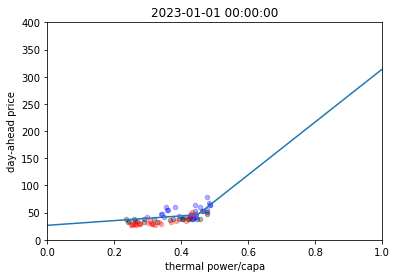

[0.44881227] [43.418108492074474, 485.68309388401593]
model acc: 35.2144323869355 2023-01-01 00:00:00
model acc: 44.78345680412496 2022-12-31 00:00:00
model acc: 153.2366133087407 2022-12-30 00:00:00
model acc: 649.1552654875705 2022-12-29 00:00:00
search 3 days for 3 part


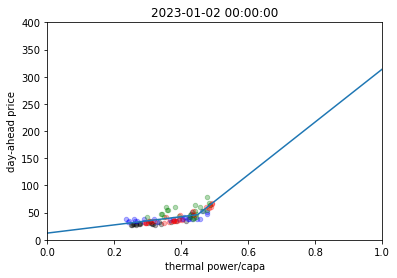

[0.44903372] [75.47224014292959, 485.6830997380052]
model acc: 55.06184309802557 2023-01-02 00:00:00
model acc: 35.2144299903663 2023-01-01 00:00:00
model acc: 44.78345680923739 2022-12-31 00:00:00
model acc: 153.23680727040826 2022-12-30 00:00:00
model acc: 649.1552273866666 2022-12-29 00:00:00
search 4 days for 3 part


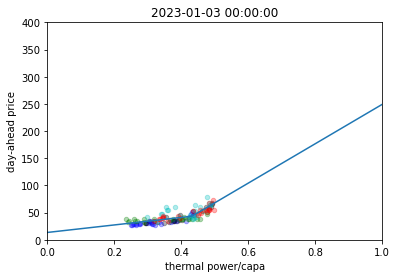

[0.43206204] [69.06530911974964, 362.2337058118042]
model acc: 81.92878798336734 2023-01-03 00:00:00
model acc: 55.061843019015285 2023-01-02 00:00:00
model acc: 35.214429995384435 2023-01-01 00:00:00
model acc: 44.78345670353956 2022-12-31 00:00:00
model acc: 153.2368072604166 2022-12-30 00:00:00


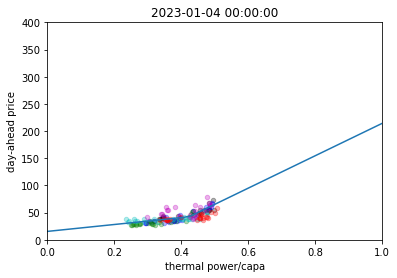

[0.4232601] [63.48988083248471, 298.02274707746426]
model acc: 55.58974335825066 2023-01-04 00:00:00
model acc: 81.92878797954333 2023-01-03 00:00:00
model acc: 55.06184406006339 2023-01-02 00:00:00
model acc: 35.21443237466939 2023-01-01 00:00:00
model acc: 44.78345671222542 2022-12-31 00:00:00


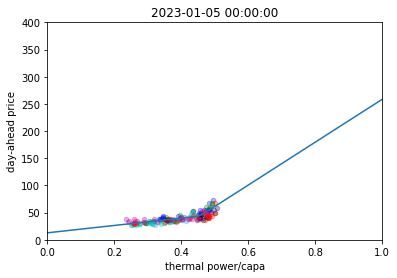

[0.45558685] [67.7725319062983, 394.29785543162006]
model acc: 52.494296358040664 2023-01-05 00:00:00
model acc: 55.589692099326555 2023-01-04 00:00:00
model acc: 81.92878793834797 2023-01-03 00:00:00
model acc: 55.06184351345976 2023-01-02 00:00:00
model acc: 35.21443236705163 2023-01-01 00:00:00


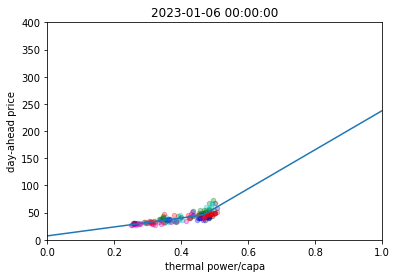

[0.46505974] [82.20912540245881, 359.08196922416903]
model acc: 53.90606161761883 2023-01-06 00:00:00
model acc: 52.49440019043719 2023-01-05 00:00:00
model acc: 55.58969236522543 2023-01-04 00:00:00
model acc: 81.92878755974776 2023-01-03 00:00:00
model acc: 55.06075475179706 2023-01-02 00:00:00


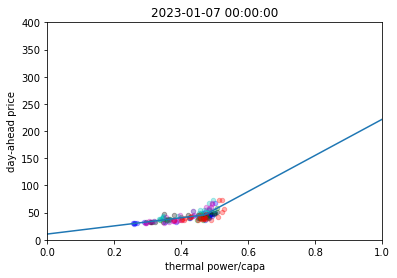

[0.47041344] [75.02568389549495, 331.9305426293506]
model acc: 112.21204131907041 2023-01-07 00:00:00
model acc: 53.905901057510754 2023-01-06 00:00:00
model acc: 52.49436659990752 2023-01-05 00:00:00
model acc: 55.58969214916766 2023-01-04 00:00:00
model acc: 81.92878790413593 2023-01-03 00:00:00


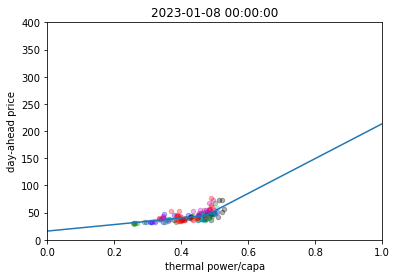

[0.47211146] [60.063741626630886, 320.2171280288622]
model acc: 110.4310507125943 2023-01-08 00:00:00
model acc: 112.21204171294302 2023-01-07 00:00:00
model acc: 53.9059016964781 2023-01-06 00:00:00
model acc: 52.49432329144548 2023-01-05 00:00:00
model acc: 55.589900313190554 2023-01-04 00:00:00


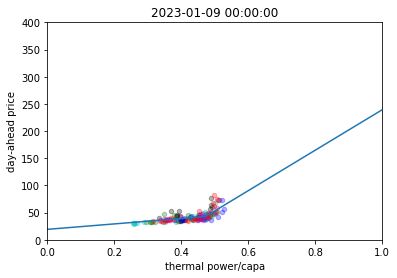

[0.47236067] [49.950574330165686, 372.0965214234401]
model acc: 100.93330874352252 2023-01-09 00:00:00
model acc: 110.4309555917267 2023-01-08 00:00:00
model acc: 112.21204147025395 2023-01-07 00:00:00
model acc: 53.90590170925371 2023-01-06 00:00:00
model acc: 52.49439902321961 2023-01-05 00:00:00


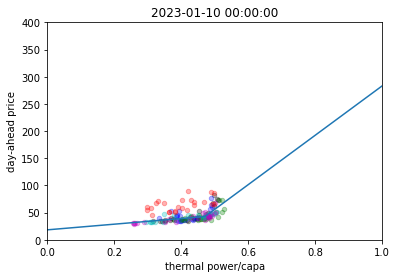

[0.47104479] [52.09891759002843, 454.19608128883306]
model acc: 190.06615550633603 2023-01-10 00:00:00
model acc: 100.93330975190085 2023-01-09 00:00:00
search 1 days for 3 part


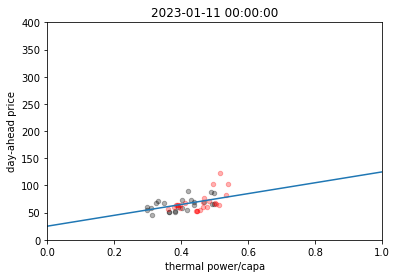

[0.37701573] [-3.622153780901443, 160.2152109853444]
model acc: 202.11176800438733 2023-01-11 00:00:00
model acc: 190.06615054994734 2023-01-10 00:00:00
model acc: 100.93330638529217 2023-01-09 00:00:00
search 2 days for 3 part


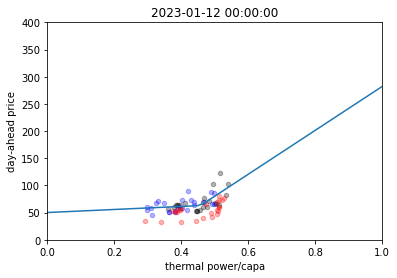

[0.45754161] [28.064823637508066, 403.7604739813696]
model acc: 198.14553590346765 2023-01-12 00:00:00
model acc: 202.10979068131363 2023-01-11 00:00:00
model acc: 190.06604751970218 2023-01-10 00:00:00
search 2 days for 3 part


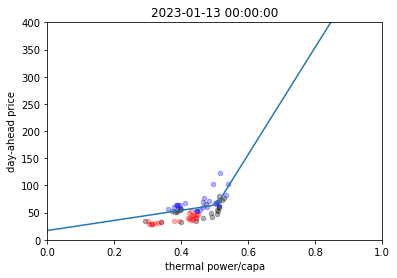

[0.50582238] [93.2010551616559, 985.704206178059]
model acc: 64.35333828399352 2023-01-13 00:00:00
model acc: 198.14553424955818 2023-01-12 00:00:00
model acc: 202.10979043826018 2023-01-11 00:00:00
search 2 days for 3 part


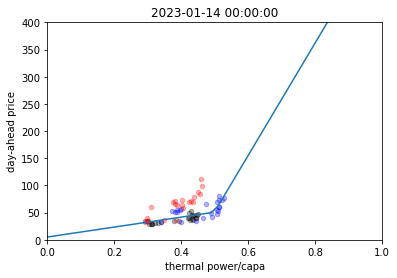

[0.49889222] [91.40394820216656, 1034.3482445208608]
model acc: 164.73113442508154 2023-01-14 00:00:00
model acc: 64.35335673279945 2023-01-13 00:00:00
search 1 days for 3 part


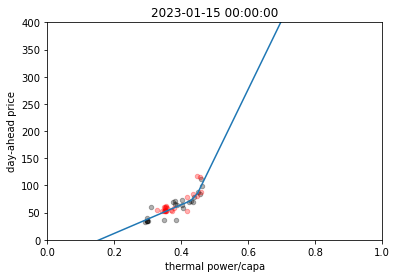

[0.44070925] [263.6280892208354, 1266.6334272959757]
model acc: 142.55297766553582 2023-01-15 00:00:00
model acc: 164.73113308411098 2023-01-14 00:00:00
model acc: 64.35335469655135 2023-01-13 00:00:00
search 2 days for 3 part


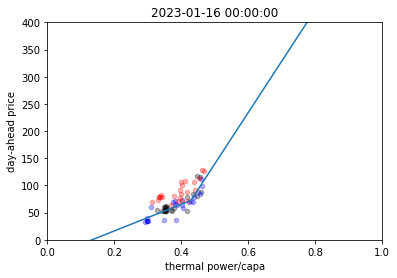

[0.42879651] [245.0669927837788, 944.1622595966224]
model acc: 180.4597060101077 2023-01-16 00:00:00
model acc: 142.552977659732 2023-01-15 00:00:00
search 1 days for 3 part


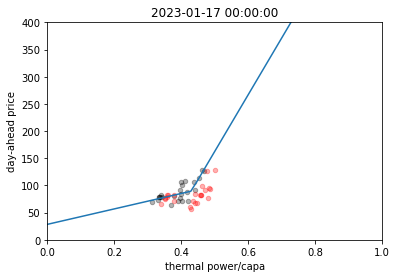

[0.42993022] [142.11561175691972, 1043.0221784432706]
model acc: 187.3220204234658 2023-01-17 00:00:00
model acc: 180.45970432577556 2023-01-16 00:00:00
search 1 days for 3 part


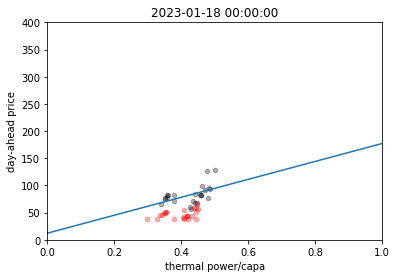

[0.42782905] [-208.078063939766, 747.7389336906199]
model acc: 119.06045600151234 2023-01-18 00:00:00
model acc: 187.32204922831414 2023-01-17 00:00:00
search 1 days for 3 part


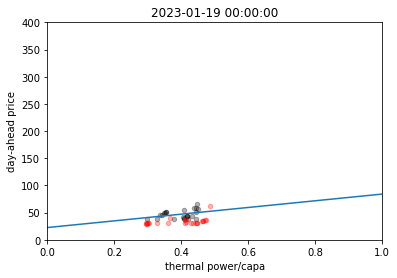

[0.43099571] [-9.007812820791182, 799.8171897472846]
model acc: 41.30469257354575 2023-01-19 00:00:00
model acc: 119.05969712856124 2023-01-18 00:00:00
model acc: 187.32202035303254 2023-01-17 00:00:00
search 2 days for 3 part


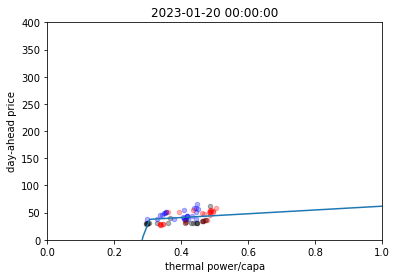

[0.29793753] [2576.8359721779348, 34.79553540041911]
model acc: 108.82955892132273 2023-01-20 00:00:00
model acc: 41.30469035272106 2023-01-19 00:00:00
model acc: 119.0604558986957 2023-01-18 00:00:00
model acc: 187.32294810764023 2023-01-17 00:00:00
search 3 days for 3 part


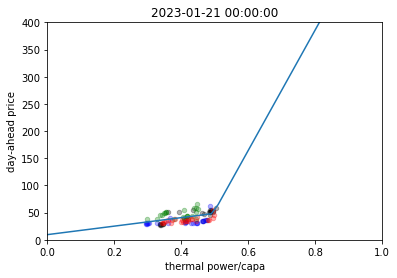

[0.49525724] [78.2286955068404, 1108.2557693662393]
model acc: 62.059674562061005 2023-01-21 00:00:00
model acc: 108.82872442987102 2023-01-20 00:00:00
model acc: 41.304690331149295 2023-01-19 00:00:00
model acc: 119.06147323509438 2023-01-18 00:00:00
model acc: 187.32203844392126 2023-01-17 00:00:00
search 4 days for 3 part


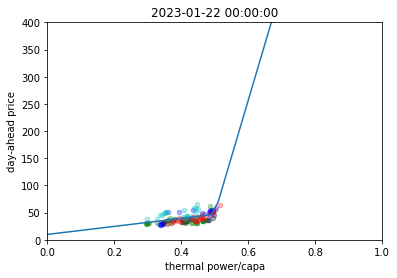

[0.49928301] [74.14430983175586, 2079.9425926175186]
model acc: 57.55530602872838 2023-01-22 00:00:00
model acc: 62.05828969193165 2023-01-21 00:00:00
model acc: 108.82872463808184 2023-01-20 00:00:00
model acc: 41.304692560042184 2023-01-19 00:00:00
model acc: 119.0604560971669 2023-01-18 00:00:00


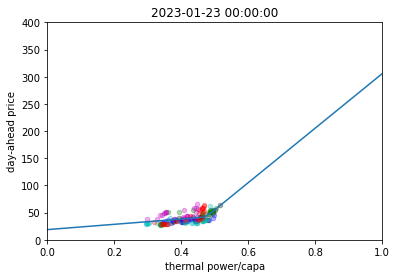

[0.47384515] [48.75669069589935, 501.19416059409565]
model acc: 99.29090840238011 2023-01-23 00:00:00
model acc: 57.55530603685888 2023-01-22 00:00:00
model acc: 62.058289722550555 2023-01-21 00:00:00
model acc: 108.82872463808165 2023-01-20 00:00:00
model acc: 41.30469029668223 2023-01-19 00:00:00


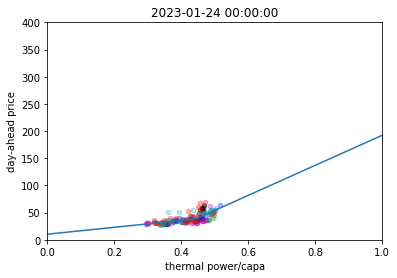

[0.44324966] [63.2492907775137, 276.40811910218486]
model acc: 159.8088127024183 2023-01-24 00:00:00
model acc: 99.29090838291046 2023-01-23 00:00:00
model acc: 57.55530615124755 2023-01-22 00:00:00
model acc: 62.058289617564995 2023-01-21 00:00:00
model acc: 108.82872106020224 2023-01-20 00:00:00


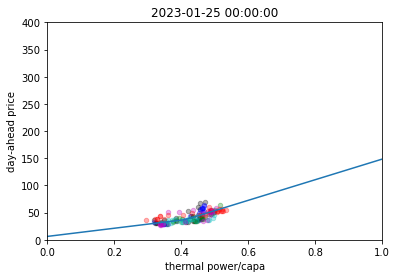

[0.41420809] [75.18207167956463, 189.5963472516283]
model acc: 50.89313124659807 2023-01-25 00:00:00
model acc: 159.80881255423893 2023-01-24 00:00:00
model acc: 99.29463636277288 2023-01-23 00:00:00
model acc: 57.55530608016609 2023-01-22 00:00:00
model acc: 62.058289492062926 2023-01-21 00:00:00


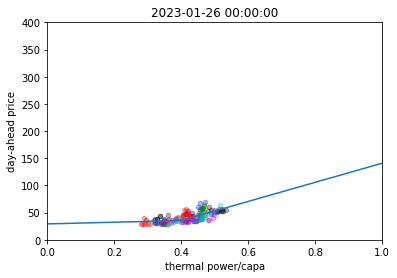

[0.3999222] [15.508449191364937, 175.64184878710125]
model acc: 64.25933588445238 2023-01-26 00:00:00
model acc: 50.891948968394104 2023-01-25 00:00:00
model acc: 159.808812644441 2023-01-24 00:00:00
model acc: 99.29090843463855 2023-01-23 00:00:00
model acc: 57.555306076247746 2023-01-22 00:00:00


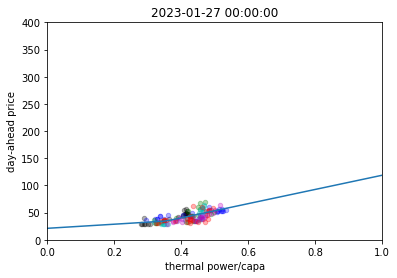

[0.35549481] [37.79479132137821, 130.6100960553686]
model acc: 124.69789253690543 2023-01-27 00:00:00
model acc: 64.25933499554286 2023-01-26 00:00:00
model acc: 50.891948965137004 2023-01-25 00:00:00
model acc: 159.80881270241832 2023-01-24 00:00:00
model acc: 99.29090838731273 2023-01-23 00:00:00


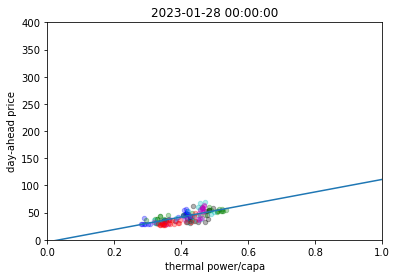

[0.30666405] [-34.48620894827429, 119.8353431926847]
model acc: 67.71808956342089 2023-01-28 00:00:00
model acc: 124.69741803274665 2023-01-27 00:00:00
model acc: 64.25790091272097 2023-01-26 00:00:00
model acc: 50.892226249632465 2023-01-25 00:00:00
model acc: 159.80881270241832 2023-01-24 00:00:00


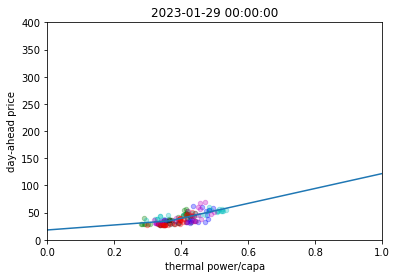

[0.36529147] [45.99268718003279, 137.02234788138844]
model acc: 49.691342871836916 2023-01-29 00:00:00
model acc: 73.69108807102447 2023-01-28 00:00:00
model acc: 124.69819334765604 2023-01-27 00:00:00
model acc: 64.25933560623287 2023-01-26 00:00:00
model acc: 50.89194898697134 2023-01-25 00:00:00


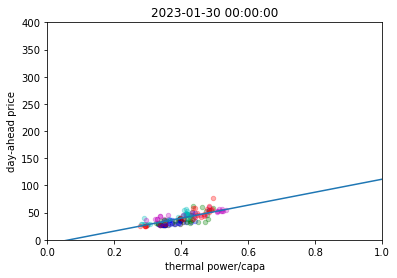

[0.31675784] [-76.15758285222559, 130.3365803470631]
model acc: 93.58214627733537 2023-01-30 00:00:00
model acc: 49.69134291431787 2023-01-29 00:00:00
model acc: 67.71808956343753 2023-01-28 00:00:00
model acc: 124.69741810577878 2023-01-27 00:00:00
model acc: 64.25933449255527 2023-01-26 00:00:00


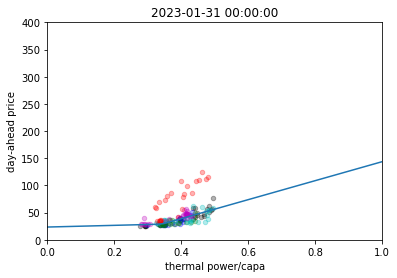

[0.34201631] [15.606851801062371, 174.6158164807878]
model acc: 310.71573869290023 2023-01-31 00:00:00
model acc: 93.58217857289146 2023-01-30 00:00:00
search 1 days for 3 part


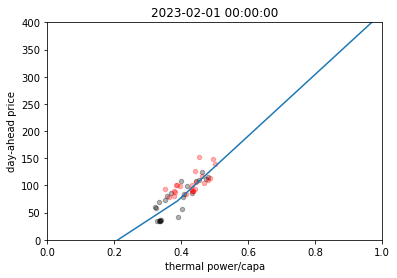

[0.38951938] [402.00624163564765, 566.3378928029358]
model acc: 243.9206282330557 2023-02-01 00:00:00
model acc: 310.71736685923867 2023-01-31 00:00:00
model acc: 93.58217849993775 2023-01-30 00:00:00
search 2 days for 3 part


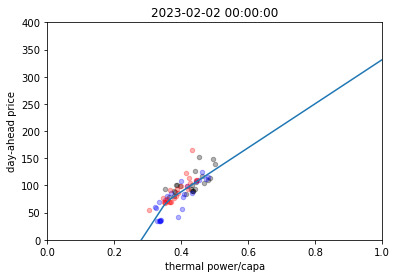

[0.35612043] [937.1684046249622, 404.96298550422125]
model acc: 207.95481928334405 2023-02-02 00:00:00
model acc: 243.9206481971883 2023-02-01 00:00:00
model acc: 310.72005440763223 2023-01-31 00:00:00
model acc: 93.58217829601438 2023-01-30 00:00:00
search 3 days for 3 part


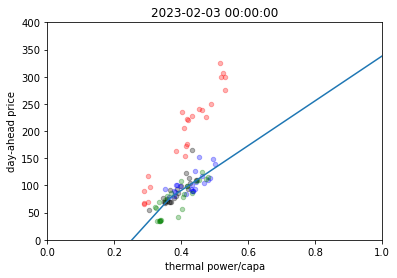

[0.36630267] [677.8947178349433, 412.2149163945796]
model acc: 396.3854718991138 2023-02-03 00:00:00
model acc: 207.95592002491605 2023-02-02 00:00:00
search 1 days for 3 part


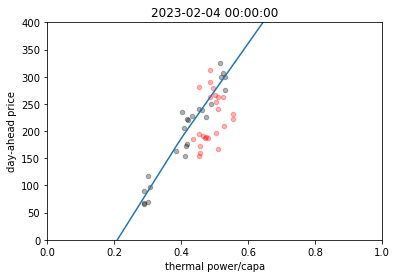

[0.4] [979.4240014568442, 872.417370330532]
model acc: 759.3801156524339 2023-02-04 00:00:00
model acc: 396.38548795694925 2023-02-03 00:00:00
search 1 days for 3 part


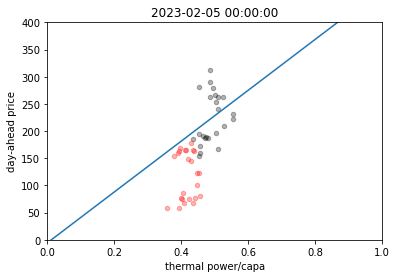

[0.48532158] [1820.0401546264545, -417.192343112999]
model acc: 888.5930885432982 2023-02-05 00:00:00
model acc: 759.3974455521591 2023-02-04 00:00:00
search 1 days for 3 part


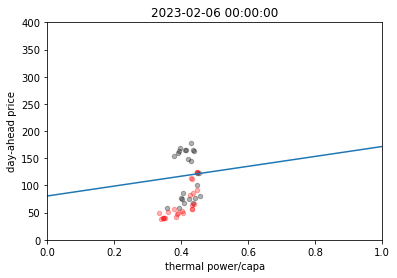

[0.37234386] [4654.354984276507, -213.17475872853683]
model acc: 276.2894701839399 2023-02-06 00:00:00
model acc: 888.5930885432994 2023-02-05 00:00:00
search 1 days for 3 part


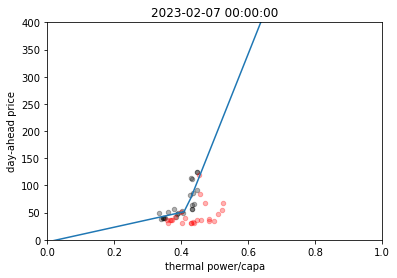

[0.41270268] [136.13513121146988, 1547.5049254624807]
model acc: 327.3458807102155 2023-02-07 00:00:00
model acc: 276.289470171416 2023-02-06 00:00:00
search 1 days for 3 part


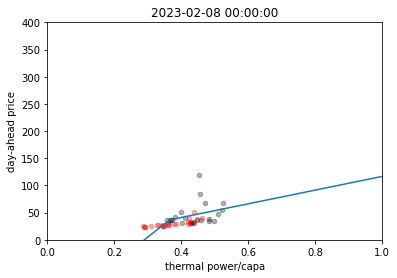

[0.36531136] [485.29305703559055, 125.99325765544862]
model acc: 48.96123284868958 2023-02-08 00:00:00
model acc: 327.3411280086874 2023-02-07 00:00:00
model acc: 276.28951746662915 2023-02-06 00:00:00
search 2 days for 3 part


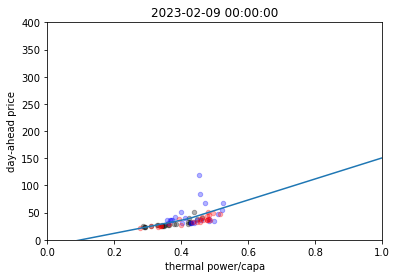

[0.41960535] [120.34051396055325, 193.5402828753441]
model acc: 72.27618549739282 2023-02-09 00:00:00
model acc: 48.961232521420456 2023-02-08 00:00:00
model acc: 327.34112816940694 2023-02-07 00:00:00
model acc: 276.2894695654452 2023-02-06 00:00:00
search 3 days for 3 part


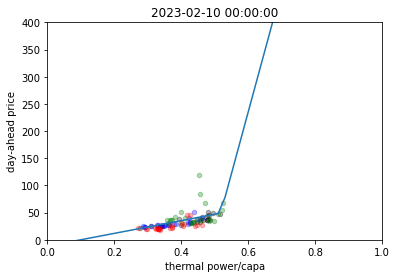

[0.51797022] [117.37900582888587, 2266.993724037908]
model acc: 89.36444150961225 2023-02-10 00:00:00
model acc: 72.27618539745322 2023-02-09 00:00:00
model acc: 48.961232861055656 2023-02-08 00:00:00
model acc: 327.3411273670845 2023-02-07 00:00:00
model acc: 276.28962241500426 2023-02-06 00:00:00
search 4 days for 3 part


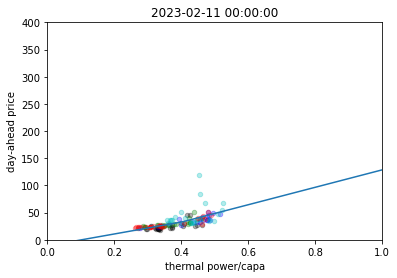

[0.40414507] [109.58128723544625, 160.36359928039332]
model acc: 43.70369767797957 2023-02-11 00:00:00
model acc: 89.36444153132945 2023-02-10 00:00:00
model acc: 72.27618548284639 2023-02-09 00:00:00
model acc: 48.96123252379661 2023-02-08 00:00:00
model acc: 327.3411267510111 2023-02-07 00:00:00


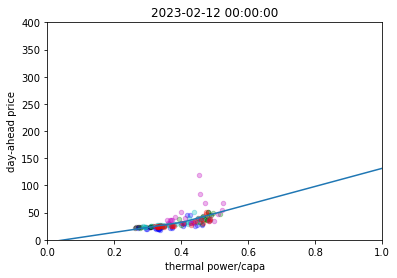

[0.40414507] [91.83709950713794, 166.2876694814312]
model acc: 57.54531693253378 2023-02-12 00:00:00
model acc: 43.70369830373289 2023-02-11 00:00:00
model acc: 89.36449747576826 2023-02-10 00:00:00
model acc: 72.27604797431303 2023-02-09 00:00:00
model acc: 48.96123286299651 2023-02-08 00:00:00


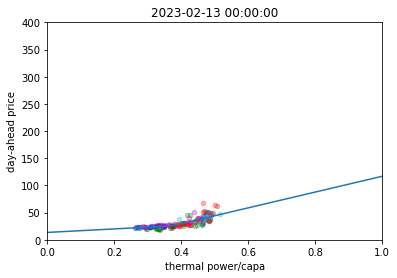

[0.37156026] [32.35621380611961, 145.21375009681213]
model acc: 116.69588039972297 2023-02-13 00:00:00
model acc: 57.54531696334567 2023-02-12 00:00:00
model acc: 43.70369748225508 2023-02-11 00:00:00
model acc: 89.36444149783856 2023-02-10 00:00:00
model acc: 72.2762923181188 2023-02-09 00:00:00


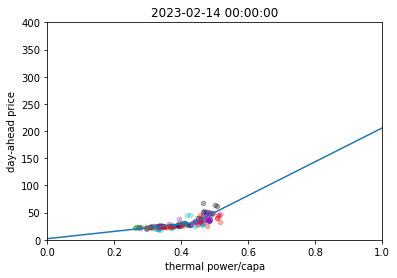

[0.43900207] [66.8648763356847, 310.6472241496992]
model acc: 56.84646738032216 2023-02-14 00:00:00
model acc: 116.69588012153412 2023-02-13 00:00:00
model acc: 57.54531666571003 2023-02-12 00:00:00
model acc: 43.703697557458874 2023-02-11 00:00:00
model acc: 89.36464587045731 2023-02-10 00:00:00


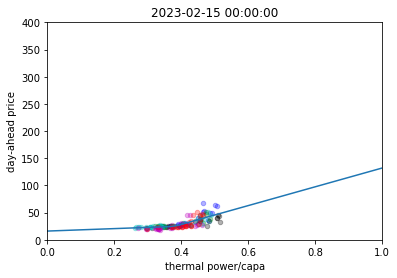

[0.37832369] [22.589371344225846, 172.810621761637]
model acc: 71.62081785729455 2023-02-15 00:00:00
model acc: 56.8464673891978 2023-02-14 00:00:00
model acc: 116.69588091304018 2023-02-13 00:00:00
model acc: 57.5448414901023 2023-02-12 00:00:00
model acc: 43.70369742218493 2023-02-11 00:00:00


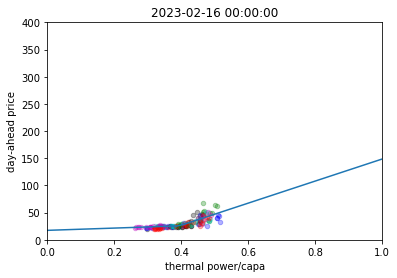

[0.39376398] [20.836535338442257, 202.90459868078997]
model acc: 43.40307925071505 2023-02-16 00:00:00
model acc: 71.62081785315837 2023-02-15 00:00:00
model acc: 56.84646735186749 2023-02-14 00:00:00
model acc: 116.69588075661326 2023-02-13 00:00:00
model acc: 57.54531691938525 2023-02-12 00:00:00


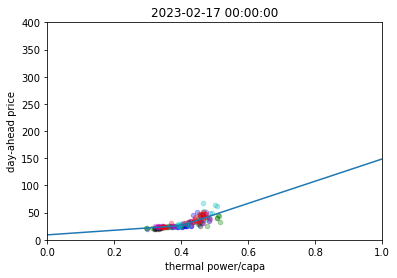

[0.39966827] [42.48273234124685, 204.23256775459245]
model acc: 65.02494811882175 2023-02-17 00:00:00
model acc: 43.40372809813428 2023-02-16 00:00:00
model acc: 71.62081785626182 2023-02-15 00:00:00
model acc: 56.84646735268972 2023-02-14 00:00:00
model acc: 116.69588086282104 2023-02-13 00:00:00


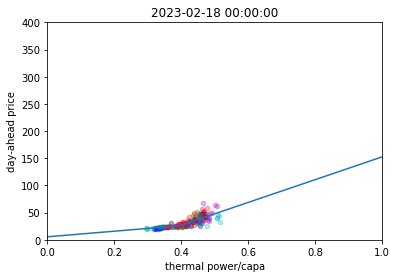

[0.39516584] [51.45110583797072, 209.40632343828725]
model acc: 80.34512537589424 2023-02-18 00:00:00
model acc: 65.02494810294485 2023-02-17 00:00:00
model acc: 43.402270288237425 2023-02-16 00:00:00
model acc: 71.62081785718416 2023-02-15 00:00:00
model acc: 56.846467308052624 2023-02-14 00:00:00


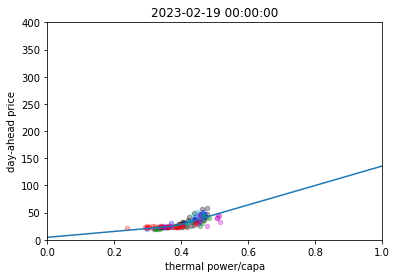

[0.38248544] [54.36246974727535, 178.7179467042793]
model acc: 21.667301954166472 2023-02-19 00:00:00
model acc: 80.34512537589427 2023-02-18 00:00:00
model acc: 65.027094837133 2023-02-17 00:00:00
model acc: 43.40374620382984 2023-02-16 00:00:00
model acc: 71.62081785702854 2023-02-15 00:00:00


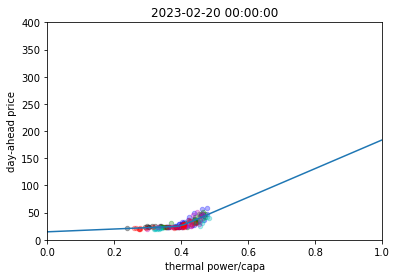

[0.39723053] [25.701836270142977, 263.54409695944065]
model acc: 37.63780522234953 2023-02-20 00:00:00
model acc: 21.667301953814192 2023-02-19 00:00:00
model acc: 80.34512537589485 2023-02-18 00:00:00
model acc: 65.02494810335308 2023-02-17 00:00:00
model acc: 43.40348220646801 2023-02-16 00:00:00


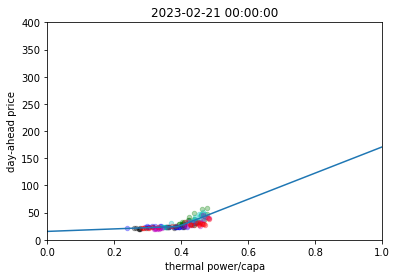

[0.39141745] [22.980390241314904, 240.57950310339203]
model acc: 27.769477471302498 2023-02-21 00:00:00
model acc: 37.63780011867085 2023-02-20 00:00:00
model acc: 21.667301887551375 2023-02-19 00:00:00
model acc: 80.34512537589461 2023-02-18 00:00:00
model acc: 65.03150441005364 2023-02-17 00:00:00


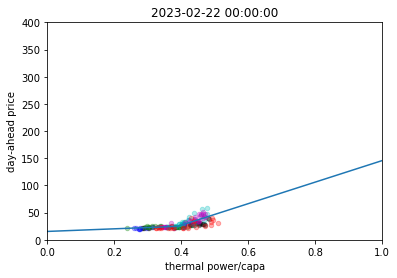

[0.38918377] [24.005741729872486, 198.0357120155831]
model acc: 65.08321639849171 2023-02-22 00:00:00
model acc: 27.769477836454172 2023-02-21 00:00:00
model acc: 37.63780517030596 2023-02-20 00:00:00
model acc: 21.66730196717343 2023-02-19 00:00:00
model acc: 80.34512537589471 2023-02-18 00:00:00


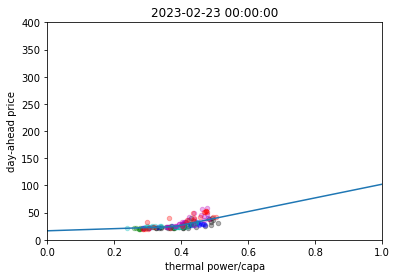

[0.37730365] [19.772567926574894, 125.6514513718814]
model acc: 110.36565230760833 2023-02-23 00:00:00
model acc: 65.08321640090693 2023-02-22 00:00:00
model acc: 27.769478050534648 2023-02-21 00:00:00
model acc: 37.63780525652491 2023-02-20 00:00:00
model acc: 21.667301944731758 2023-02-19 00:00:00


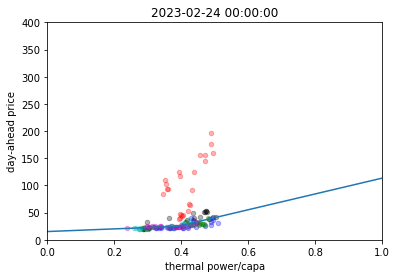

[0.38970987] [24.38146727225569, 145.4293224668365]
model acc: 408.17497555368425 2023-02-24 00:00:00
model acc: 110.3656531679712 2023-02-23 00:00:00
search 1 days for 3 part


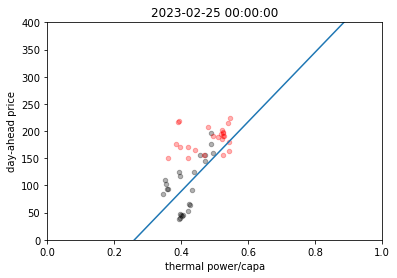

[0.40950063] [-802.9876238984389, 1605.9117176445448]
model acc: 369.1496977338058 2023-02-25 00:00:00
model acc: 408.1749811311663 2023-02-24 00:00:00
search 1 days for 3 part


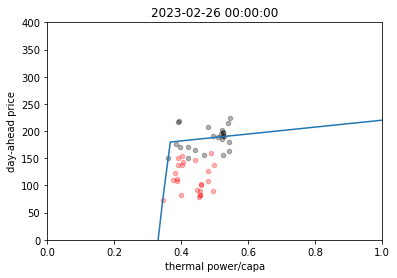

[0.36500498] [5273.367649299362, 63.51531131743693]
model acc: 496.0360095196587 2023-02-26 00:00:00
model acc: 369.14969773380545 2023-02-25 00:00:00
search 1 days for 3 part


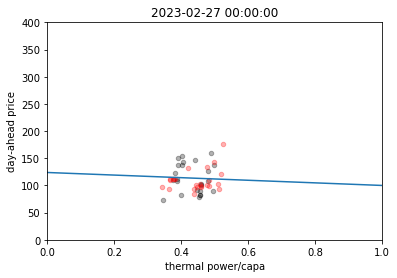

[0.40178948] [775.244964125258, -246.2721265718116]
model acc: 246.8793717032686 2023-02-27 00:00:00
model acc: 496.03670168558136 2023-02-26 00:00:00
model acc: 369.1496977338058 2023-02-25 00:00:00
search 2 days for 3 part


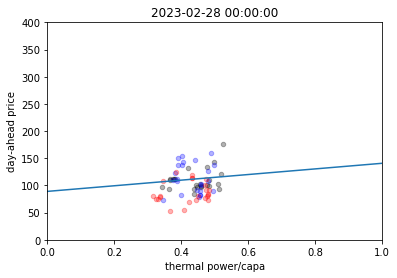

[0.37935237] [845.4731085740916, -21.974432774788024]
model acc: 343.6081212557314 2023-02-28 00:00:00
model acc: 246.8793722652345 2023-02-27 00:00:00
model acc: 496.04504398444396 2023-02-26 00:00:00
search 2 days for 3 part


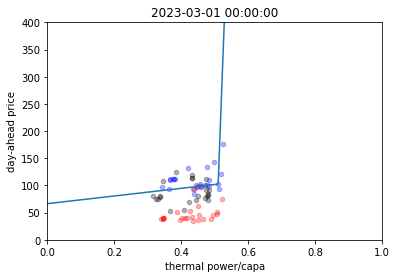

[0.52249911] [70.50603014851511, 40768.643131836754]
model acc: 238.80267290470482 2023-03-01 00:00:00
model acc: 343.6081213647236 2023-02-28 00:00:00
search 1 days for 3 part


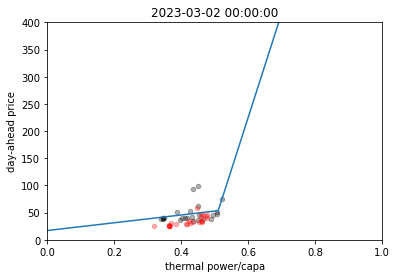

[0.51055262] [71.50982842106745, 1918.66236265844]
model acc: 90.21170990399814 2023-03-02 00:00:00
model acc: 238.80267290470542 2023-03-01 00:00:00
model acc: 343.6081213271354 2023-02-28 00:00:00
search 2 days for 3 part


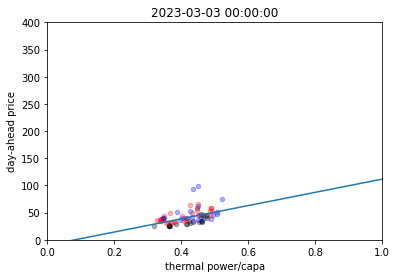

[0.36382191] [-105.97110977178804, 147.14553151233298]
model acc: 136.0671056734393 2023-03-03 00:00:00
model acc: 90.21171675267776 2023-03-02 00:00:00
model acc: 238.80267290470474 2023-03-01 00:00:00
model acc: 343.60812141466363 2023-02-28 00:00:00
search 3 days for 3 part


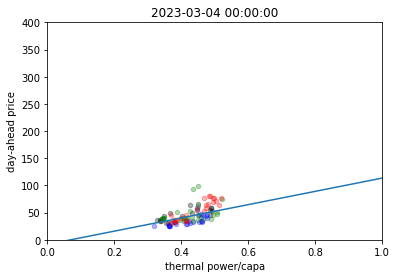

[0.36317013] [-81.24519156284423, 148.73898596697092]
model acc: 129.10538870054614 2023-03-04 00:00:00
model acc: 136.06710567733847 2023-03-03 00:00:00
model acc: 90.2117094824383 2023-03-02 00:00:00
model acc: 238.8026729047044 2023-03-01 00:00:00
model acc: 343.608121341398 2023-02-28 00:00:00
search 4 days for 3 part


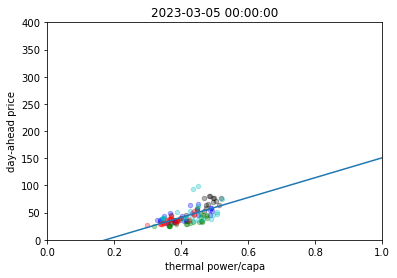

[0.37940577] [-51.48050287282869, 236.28498761259632]
model acc: 63.07128100516334 2023-03-05 00:00:00
model acc: 129.10538870246415 2023-03-04 00:00:00
model acc: 136.0671056732295 2023-03-03 00:00:00
model acc: 90.21170979246756 2023-03-02 00:00:00
model acc: 238.80267290470601 2023-03-01 00:00:00


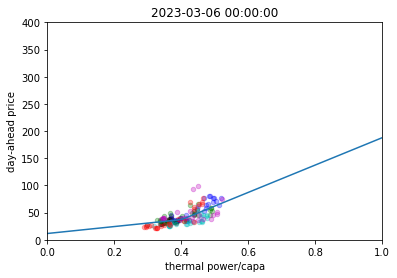

[0.4014311] [63.81833741370291, 251.55562230093798]
model acc: 99.7094386789469 2023-03-06 00:00:00
model acc: 63.07128351641215 2023-03-05 00:00:00
model acc: 129.1053893209529 2023-03-04 00:00:00
model acc: 136.06713540536032 2023-03-03 00:00:00
model acc: 90.21170978980246 2023-03-02 00:00:00


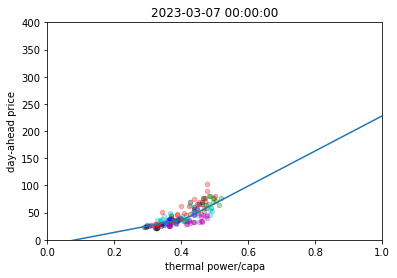

[0.41391341] [118.15982065464158, 322.46205632594524]
model acc: 183.12407212465274 2023-03-07 00:00:00
model acc: 99.70943981852332 2023-03-06 00:00:00
model acc: 63.07058442760638 2023-03-05 00:00:00
model acc: 129.10538939259845 2023-03-04 00:00:00
model acc: 136.06710567733847 2023-03-03 00:00:00


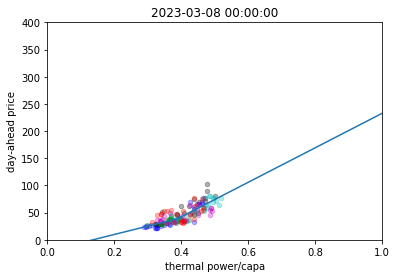

[0.38911339] [153.6949243677079, 317.3132254553207]
model acc: 195.4997881681392 2023-03-08 00:00:00
model acc: 183.12407213245484 2023-03-07 00:00:00
model acc: 99.70943965048069 2023-03-06 00:00:00
model acc: 63.07128351145917 2023-03-05 00:00:00
model acc: 129.10538870126985 2023-03-04 00:00:00


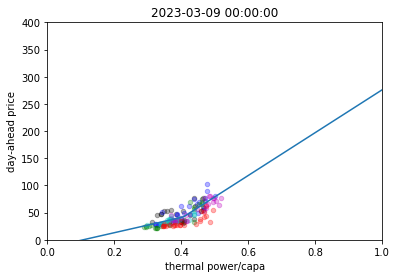

[0.40631379] [140.0871652597818, 394.0992509194885]
model acc: 94.70862119262614 2023-03-09 00:00:00
model acc: 195.499722168961 2023-03-08 00:00:00
model acc: 183.12397409382461 2023-03-07 00:00:00
search 2 days for 3 part


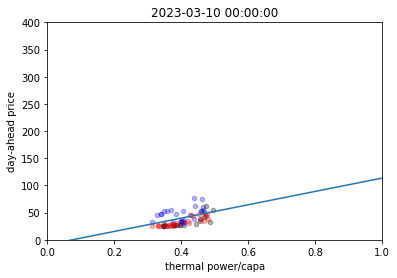

[0.38976348] [-111.34662284708872, 244.06208989463443]
model acc: 63.8648716350706 2023-03-10 00:00:00
model acc: 94.70862122874561 2023-03-09 00:00:00
model acc: 195.49978849020323 2023-03-08 00:00:00
model acc: 183.12407210058626 2023-03-07 00:00:00
search 3 days for 3 part


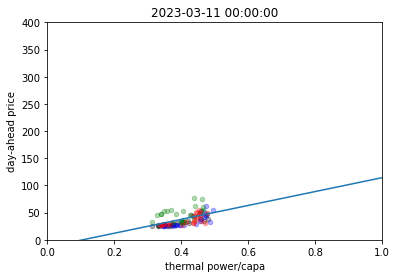

[0.38582825] [-28.98589092565663, 204.9341697736064]
model acc: 103.18711923878242 2023-03-11 00:00:00
model acc: 63.864871409337475 2023-03-10 00:00:00
model acc: 94.70800953700366 2023-03-09 00:00:00
model acc: 195.49978691502088 2023-03-08 00:00:00
model acc: 179.7373160808527 2023-03-07 00:00:00
search 4 days for 3 part


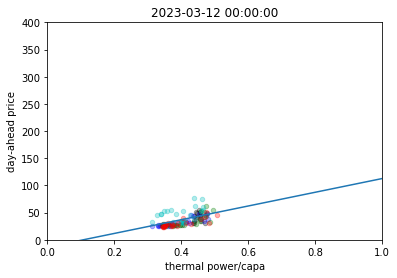

[0.38759159] [-15.47930815059506, 201.37585311618685]
model acc: 64.44311068147081 2023-03-12 00:00:00
model acc: 103.18711875945498 2023-03-11 00:00:00
model acc: 63.86487122103317 2023-03-10 00:00:00
model acc: 94.70862043880294 2023-03-09 00:00:00
model acc: 195.49978849020323 2023-03-08 00:00:00


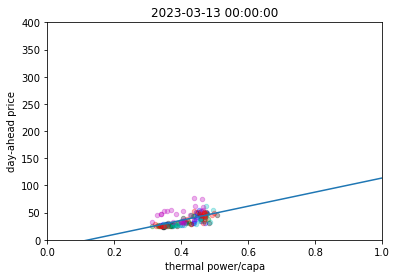

[0.37632951] [-26.89722297250501, 179.1426765436923]
model acc: 85.0870758105062 2023-03-13 00:00:00
model acc: 64.43608216523269 2023-03-12 00:00:00
model acc: 103.18709521017239 2023-03-11 00:00:00
model acc: 63.86487116624228 2023-03-10 00:00:00
model acc: 94.7086206213317 2023-03-09 00:00:00


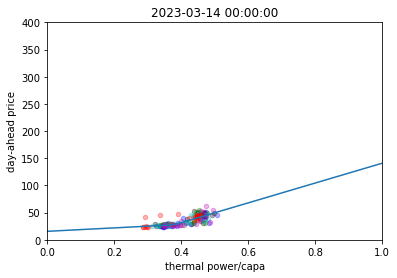

[0.37857609] [31.537764565188922, 182.33943924890139]
model acc: 93.95031064224673 2023-03-14 00:00:00
model acc: 85.08705499885565 2023-03-13 00:00:00
model acc: 64.43636208382321 2023-03-12 00:00:00
model acc: 103.18711874216052 2023-03-11 00:00:00
model acc: 63.86487119242399 2023-03-10 00:00:00


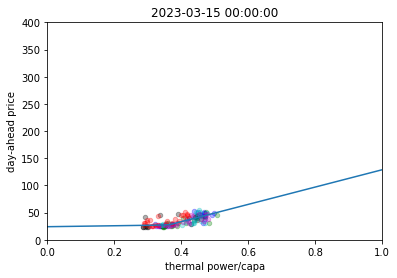

[0.36213271] [8.771128516705865, 159.26561129484313]
model acc: 88.79999111578505 2023-03-15 00:00:00
model acc: 93.95031062248938 2023-03-14 00:00:00
model acc: 85.08705835193116 2023-03-13 00:00:00
model acc: 64.43608200918408 2023-03-12 00:00:00
model acc: 103.18716286764818 2023-03-11 00:00:00


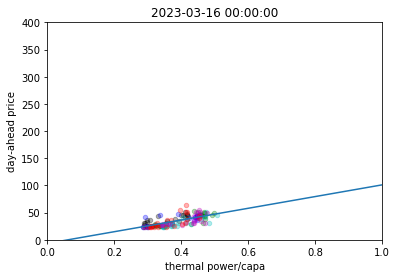

[0.34825459] [-12.229142538398511, 140.01516711731023]
model acc: 120.6039760597275 2023-03-16 00:00:00
model acc: 88.79999075342162 2023-03-15 00:00:00
model acc: 93.95114234041544 2023-03-14 00:00:00
model acc: 85.0870552570109 2023-03-13 00:00:00
model acc: 64.43608207418563 2023-03-12 00:00:00


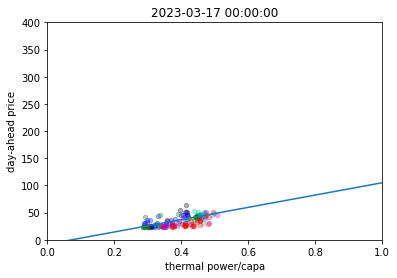

[0.50631042] [114.21665004804463, -1962.5132996748039]
model acc: 57.54760025046065 2023-03-17 00:00:00
model acc: 120.60397581042864 2023-03-16 00:00:00
model acc: 88.79796223521333 2023-03-15 00:00:00
model acc: 93.95031059107575 2023-03-14 00:00:00
model acc: 85.08706243033856 2023-03-13 00:00:00


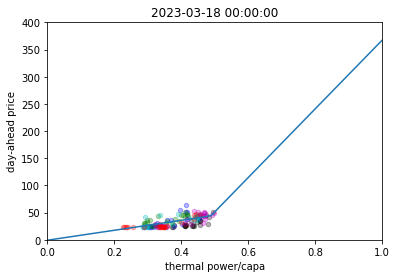

[0.48834004] [91.58073720015905, 631.7507912814232]
model acc: 33.20433099473948 2023-03-18 00:00:00
model acc: 57.54760025046068 2023-03-17 00:00:00
model acc: 120.60397616798608 2023-03-16 00:00:00
model acc: 88.7987352939769 2023-03-15 00:00:00
model acc: 93.95031064224676 2023-03-14 00:00:00


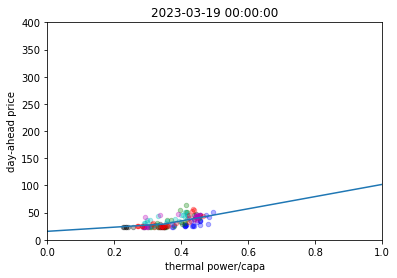

[0.34811974] [38.165146416275896, 111.97685985020503]
model acc: 71.96937347422646 2023-03-19 00:00:00
model acc: 33.203907765865836 2023-03-18 00:00:00
model acc: 57.547600400482395 2023-03-17 00:00:00
model acc: 120.60399870494938 2023-03-16 00:00:00
model acc: 88.79670970575313 2023-03-15 00:00:00


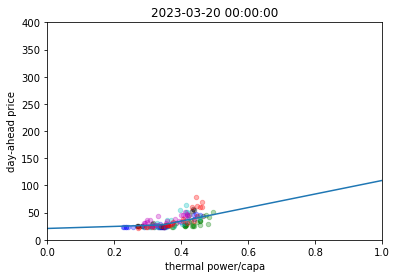

[0.34317323] [18.759354140488256, 124.59952604863892]
model acc: 106.88487994576975 2023-03-20 00:00:00
model acc: 71.95240131820242 2023-03-19 00:00:00
model acc: 33.204314369071334 2023-03-18 00:00:00
model acc: 57.54571451558145 2023-03-17 00:00:00
model acc: 120.60397592820917 2023-03-16 00:00:00


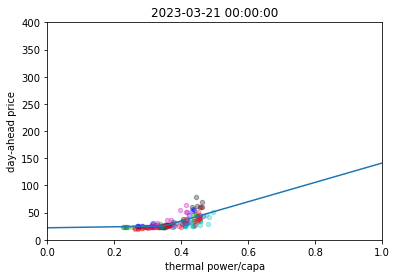

[0.34840749] [9.138306663184183, 177.96830510577135]
model acc: 67.413929391811 2023-03-21 00:00:00
model acc: 106.88488038571234 2023-03-20 00:00:00
model acc: 71.95240133795424 2023-03-19 00:00:00
model acc: 33.204314467618346 2023-03-18 00:00:00
model acc: 57.54760025046064 2023-03-17 00:00:00


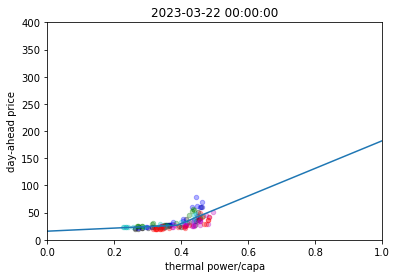

[0.38769764] [28.34973822310049, 253.63184536141122]
model acc: 70.17090299932747 2023-03-22 00:00:00
model acc: 67.41392929200859 2023-03-21 00:00:00
model acc: 106.88488052006178 2023-03-20 00:00:00
model acc: 71.95557637378433 2023-03-19 00:00:00
model acc: 33.20431441975485 2023-03-18 00:00:00


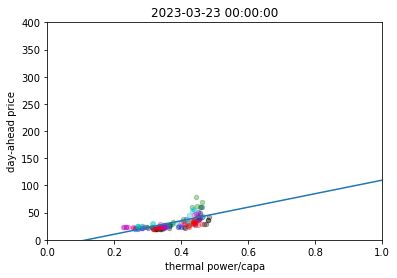

[0.34661146] [-0.3203616217209736, 199.12902990309058]
model acc: 45.23597103260225 2023-03-23 00:00:00
model acc: 70.17090299684025 2023-03-22 00:00:00
model acc: 67.41392938057263 2023-03-21 00:00:00
model acc: 106.8848808351421 2023-03-20 00:00:00
model acc: 71.95228584166608 2023-03-19 00:00:00


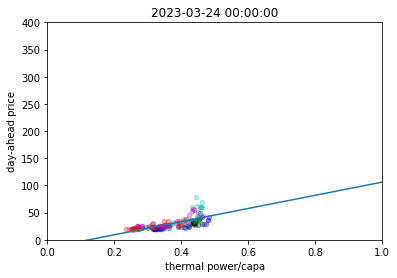

[0.33786691] [-12.956512458803168, 164.9776099158343]
model acc: 47.71571400610138 2023-03-24 00:00:00
model acc: 45.23164547028465 2023-03-23 00:00:00
model acc: 70.17090299458056 2023-03-22 00:00:00
model acc: 67.41393019172641 2023-03-21 00:00:00
model acc: 106.88478154492796 2023-03-20 00:00:00


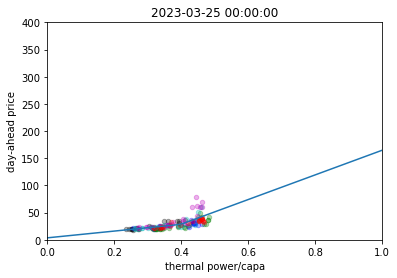

[0.39851475] [62.16094164722993, 226.6876445359632]
model acc: 26.744384378152542 2023-03-25 00:00:00
model acc: 47.715714006101344 2023-03-24 00:00:00
model acc: 45.23164520814973 2023-03-23 00:00:00
model acc: 70.17090302033638 2023-03-22 00:00:00
model acc: 67.41393021640866 2023-03-21 00:00:00


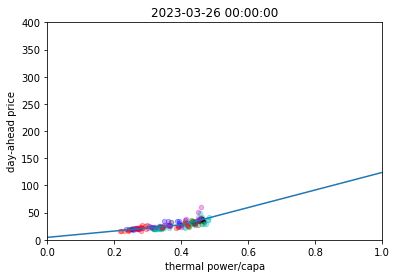

[0.40619926] [58.09994345944211, 161.41165574819803]
model acc: 48.88086311582255 2023-03-26 00:00:00
model acc: 26.744395646417484 2023-03-25 00:00:00
model acc: 47.715714006101834 2023-03-24 00:00:00
model acc: 45.231645168543466 2023-03-23 00:00:00
model acc: 70.17090305888743 2023-03-22 00:00:00


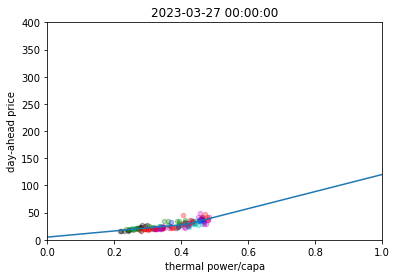

[0.41623623] [56.69689613059616, 156.8727136502013]
model acc: 47.269444356917774 2023-03-27 00:00:00
model acc: 48.88068278025571 2023-03-26 00:00:00
model acc: 26.74439563340896 2023-03-25 00:00:00
model acc: 47.71571400610132 2023-03-24 00:00:00
model acc: 45.231645411893126 2023-03-23 00:00:00


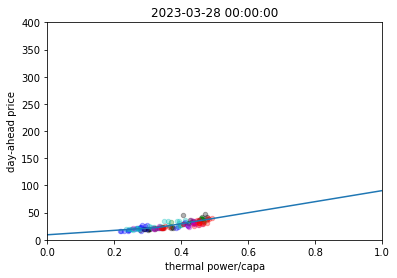

[0.33182558] [40.490096951158456, 101.45127615655153]
model acc: 45.89541685510837 2023-03-28 00:00:00
model acc: 47.26912802566656 2023-03-27 00:00:00
model acc: 48.88068277920749 2023-03-26 00:00:00
model acc: 26.744394559372775 2023-03-25 00:00:00
model acc: 47.715714006101386 2023-03-24 00:00:00


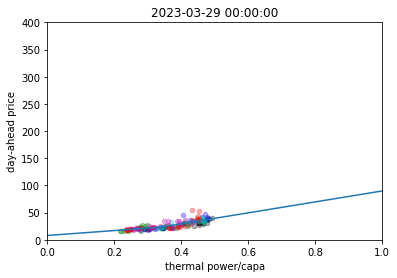

[0.33886476] [45.321548395280026, 100.65069184319572]
model acc: 69.66762152578721 2023-03-29 00:00:00
model acc: 45.89541679676745 2023-03-28 00:00:00
model acc: 47.269176483224754 2023-03-27 00:00:00
model acc: 48.88068280154334 2023-03-26 00:00:00
model acc: 26.744393274275783 2023-03-25 00:00:00


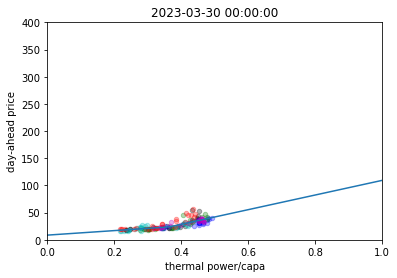

[0.36481665] [41.53410436637698, 134.7032688030471]
model acc: 63.55252167741398 2023-03-30 00:00:00
model acc: 69.67810999979585 2023-03-29 00:00:00
model acc: 45.895416848280654 2023-03-28 00:00:00
model acc: 47.269128114580795 2023-03-27 00:00:00
model acc: 48.88068281328414 2023-03-26 00:00:00


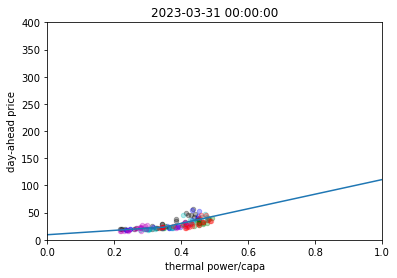

[0.34788992] [40.10839361431106, 134.1726661488159]
model acc: 78.8186874769122 2023-03-31 00:00:00
model acc: 63.55241967459615 2023-03-30 00:00:00
model acc: 69.67177904737724 2023-03-29 00:00:00
model acc: 45.89541685721119 2023-03-28 00:00:00
model acc: 47.269170754273894 2023-03-27 00:00:00


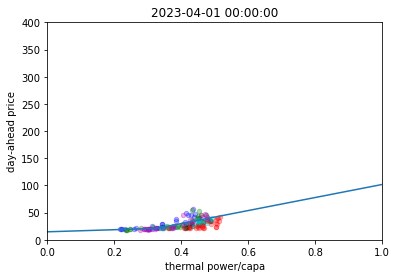

[0.3262497] [19.240833677523433, 119.88055478468048]
model acc: 75.03313970352065 2023-04-01 00:00:00
model acc: 78.83258939803613 2023-03-31 00:00:00
model acc: 63.55247117783915 2023-03-30 00:00:00
search 2 days for 3 part


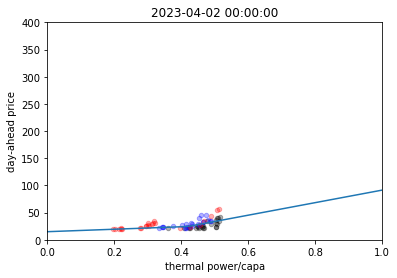

[0.41920761] [22.655814083635057, 115.34261799157522]
model acc: 70.81747236902075 2023-04-02 00:00:00
model acc: 75.03314000634262 2023-04-01 00:00:00
model acc: 78.82682224491994 2023-03-31 00:00:00
model acc: 63.5524711816895 2023-03-30 00:00:00
model acc: 69.66457493813112 2023-03-29 00:00:00


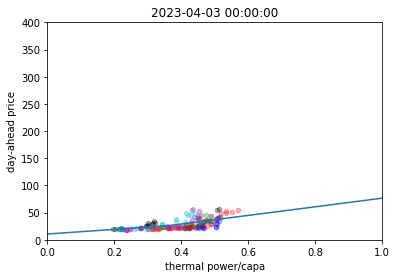

[0.3650349] [42.68966543365464, 79.26882378474224]
model acc: 44.658748898231764 2023-04-03 00:00:00
model acc: 70.81747170526273 2023-04-02 00:00:00
model acc: 75.03314000634262 2023-04-01 00:00:00
model acc: 78.83204153088298 2023-03-31 00:00:00
model acc: 63.55244034035029 2023-03-30 00:00:00


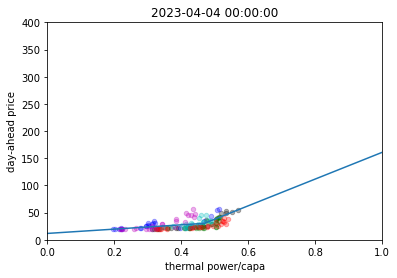

[0.46886544] [39.594163757055384, 245.8945524867447]
model acc: 37.151538636347595 2023-04-04 00:00:00
model acc: 44.65874887465102 2023-04-03 00:00:00
model acc: 70.81747202634128 2023-04-02 00:00:00
model acc: 75.03365534887357 2023-04-01 00:00:00
model acc: 78.82835769181527 2023-03-31 00:00:00


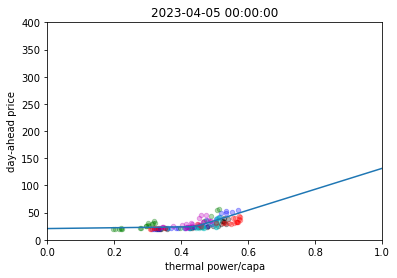

[0.44161669] [7.624288871458555, 192.38852558218335]
model acc: 45.84966071643912 2023-04-05 00:00:00
model acc: 37.15153929867962 2023-04-04 00:00:00
model acc: 44.65874893948269 2023-04-03 00:00:00
model acc: 70.81747173007233 2023-04-02 00:00:00
model acc: 75.03316401040811 2023-04-01 00:00:00


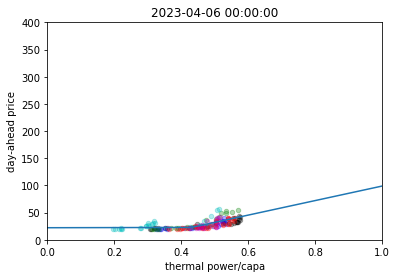

[0.4304935] [1.2998074073947654, 133.65931388497546]
model acc: 54.21593827812492 2023-04-06 00:00:00
model acc: 45.84961351190546 2023-04-05 00:00:00
model acc: 37.151539648680625 2023-04-04 00:00:00
model acc: 44.65874893661738 2023-04-03 00:00:00
model acc: 70.81747170827651 2023-04-02 00:00:00


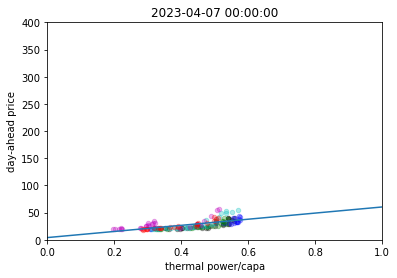

[0.42438235] [-1.2712457745542187, 122.49871934266892]
model acc: 26.383438679380305 2023-04-07 00:00:00
model acc: 54.215937791874474 2023-04-06 00:00:00
model acc: 45.84961345479462 2023-04-05 00:00:00
model acc: 37.151694379699634 2023-04-04 00:00:00
model acc: 44.658748831431915 2023-04-03 00:00:00


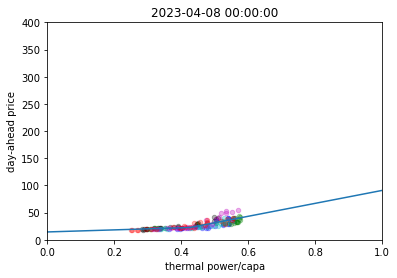

[0.42598007] [18.989115008061077, 118.99624587267611]
model acc: 47.48750204086387 2023-04-08 00:00:00
model acc: 26.383438678516747 2023-04-07 00:00:00
model acc: 54.21593780248348 2023-04-06 00:00:00
model acc: 45.84961325325867 2023-04-05 00:00:00
model acc: 37.151538635101474 2023-04-04 00:00:00


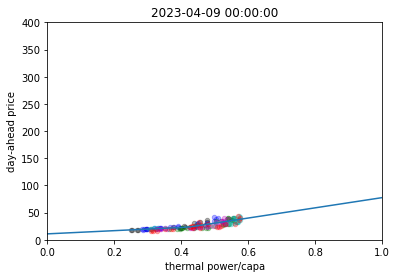

[0.42267709] [29.477505710132554, 93.88185128884662]
model acc: 49.411077231383985 2023-04-09 00:00:00
model acc: 47.48750209731733 2023-04-08 00:00:00
model acc: 26.383438682060447 2023-04-07 00:00:00
model acc: 54.21605135733559 2023-04-06 00:00:00
model acc: 45.84961331607954 2023-04-05 00:00:00


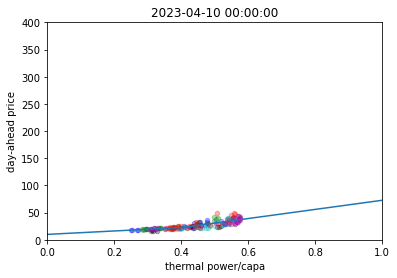

[0.40314612] [31.344821811855073, 83.90182676662076]
model acc: 66.93100218586588 2023-04-10 00:00:00
model acc: 49.41107721301789 2023-04-09 00:00:00
model acc: 47.487502128123424 2023-04-08 00:00:00
model acc: 26.38343867766762 2023-04-07 00:00:00
model acc: 54.21593778967526 2023-04-06 00:00:00


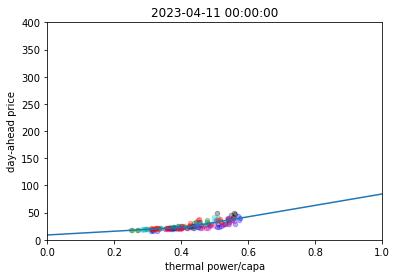

[0.41837211] [34.55197796260249, 104.8434282373312]
model acc: 47.79334134157735 2023-04-11 00:00:00
model acc: 66.93915700184695 2023-04-10 00:00:00
model acc: 49.41107722835045 2023-04-09 00:00:00
model acc: 47.48750211992484 2023-04-08 00:00:00
model acc: 26.383438698785874 2023-04-07 00:00:00


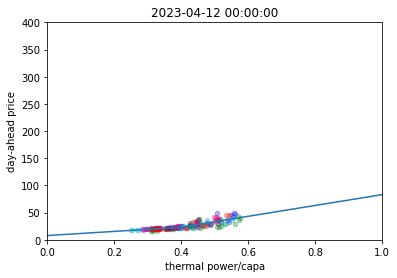

[0.39740109] [38.243377913522345, 99.71907986093997]
model acc: 48.49450360675189 2023-04-12 00:00:00
model acc: 47.793341797227654 2023-04-11 00:00:00
model acc: 66.93942821469581 2023-04-10 00:00:00
model acc: 49.41107729173582 2023-04-09 00:00:00
model acc: 47.48758068662915 2023-04-08 00:00:00


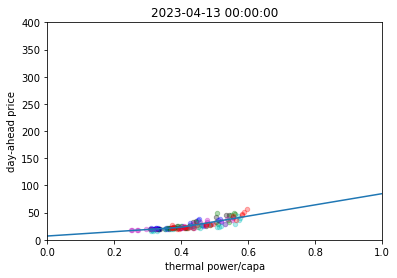

[0.39837511] [39.965869180517274, 103.0543198756909]
model acc: 48.232599806867796 2023-04-13 00:00:00
model acc: 48.49464255828339 2023-04-12 00:00:00
model acc: 47.79338265530083 2023-04-11 00:00:00
model acc: 66.93915701486492 2023-04-10 00:00:00
model acc: 49.41107722465408 2023-04-09 00:00:00


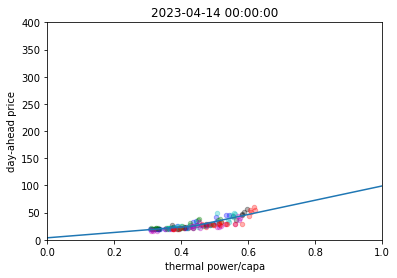

[0.43686336] [49.218131752653676, 131.18337461930017]
model acc: 50.04603048484818 2023-04-14 00:00:00
model acc: 48.232599466241986 2023-04-13 00:00:00
model acc: 48.49450357834973 2023-04-12 00:00:00
model acc: 47.79338261025309 2023-04-11 00:00:00
model acc: 66.93788258042326 2023-04-10 00:00:00


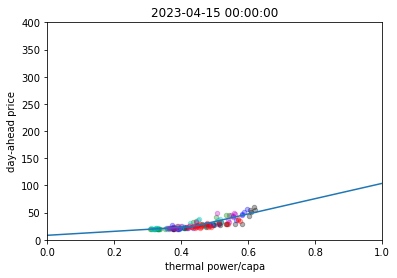

[0.43348515] [36.615685250568475, 140.63654273260133]
model acc: 43.89963008487766 2023-04-15 00:00:00
model acc: 50.04588855978115 2023-04-14 00:00:00
model acc: 48.23259980552167 2023-04-13 00:00:00
model acc: 48.49519710711169 2023-04-12 00:00:00
model acc: 47.79338257392604 2023-04-11 00:00:00


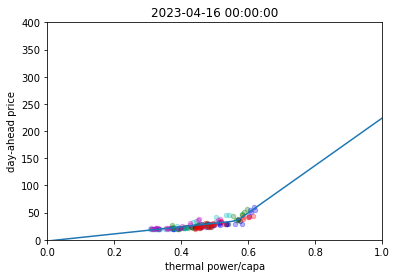

[0.56635156] [65.47027362359272, 435.97792528670783]
model acc: 38.31369571435681 2023-04-16 00:00:00
model acc: 43.899189852265735 2023-04-15 00:00:00
model acc: 50.045888756112745 2023-04-14 00:00:00
model acc: 48.232599465434575 2023-04-13 00:00:00
model acc: 48.4945595599078 2023-04-12 00:00:00


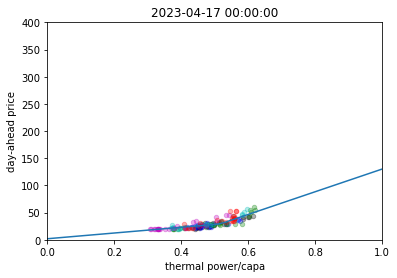

[0.51591831] [52.71089449394107, 208.64147038978922]
model acc: 79.40300722465548 2023-04-17 00:00:00
model acc: 38.31369608780581 2023-04-16 00:00:00
model acc: 43.89930279373887 2023-04-15 00:00:00
model acc: 50.04588875611277 2023-04-14 00:00:00
model acc: 48.232599777396416 2023-04-13 00:00:00


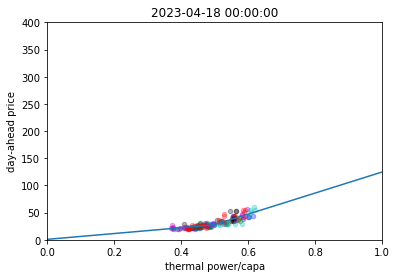

[0.4978064] [53.506142547283154, 193.63570676000194]
model acc: 70.52626276029964 2023-04-18 00:00:00
model acc: 79.40300734079615 2023-04-17 00:00:00
model acc: 38.31369589988994 2023-04-16 00:00:00
model acc: 43.89918974385719 2023-04-15 00:00:00
model acc: 50.046133729951045 2023-04-14 00:00:00


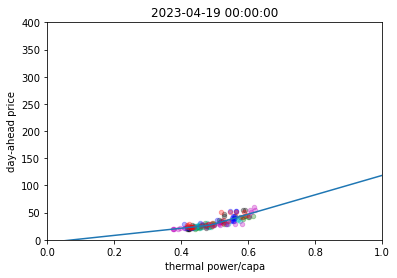

[0.48771893] [65.9142776124222, 178.43326617417318]
model acc: 80.14274804874569 2023-04-19 00:00:00
model acc: 70.54340671528499 2023-04-18 00:00:00
model acc: 79.40300700002669 2023-04-17 00:00:00
model acc: 38.3136960932051 2023-04-16 00:00:00
model acc: 43.899593765351995 2023-04-15 00:00:00


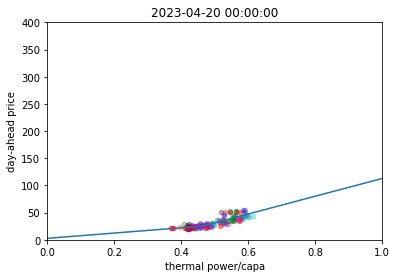

[0.4640598] [48.65699958168006, 163.30542752108528]
model acc: 82.28033893355612 2023-04-20 00:00:00
model acc: 80.14718375063322 2023-04-19 00:00:00
model acc: 70.54396696693705 2023-04-18 00:00:00
model acc: 79.4030070025791 2023-04-17 00:00:00
model acc: 38.31369610137217 2023-04-16 00:00:00


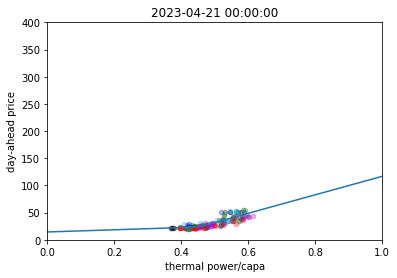

[0.45128595] [20.026207869477116, 170.03671046990655]
model acc: 38.97800149579206 2023-04-21 00:00:00
model acc: 82.28033889738691 2023-04-20 00:00:00
model acc: 80.14298233950231 2023-04-19 00:00:00
model acc: 70.54396682366101 2023-04-18 00:00:00
model acc: 79.40300700078697 2023-04-17 00:00:00


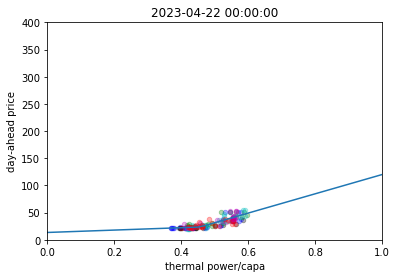

[0.45497694] [21.91909136790568, 177.2484547475283]
model acc: 63.14706228476723 2023-04-22 00:00:00
model acc: 38.9780015104092 2023-04-21 00:00:00
model acc: 82.2808166648331 2023-04-20 00:00:00
model acc: 80.14274836890098 2023-04-19 00:00:00
model acc: 70.53940442378189 2023-04-18 00:00:00


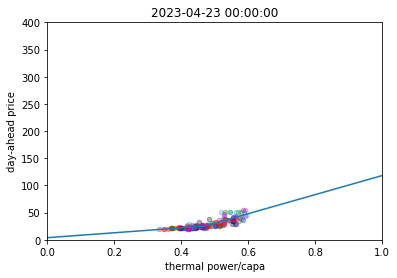

[0.46919938] [45.257163569038305, 175.258663758247]
model acc: 42.82015616361523 2023-04-23 00:00:00
model acc: 63.14742477618449 2023-04-22 00:00:00
model acc: 38.97800149781201 2023-04-21 00:00:00
model acc: 82.28033889115858 2023-04-20 00:00:00
model acc: 80.14274771606327 2023-04-19 00:00:00


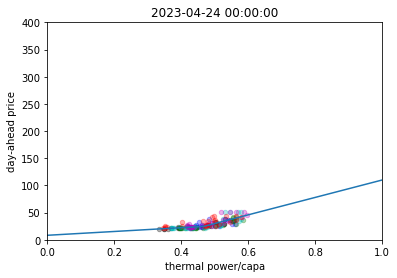

[0.46734238] [35.03617183186345, 160.1777258587545]
model acc: 95.40346371807294 2023-04-24 00:00:00
model acc: 42.82015596856546 2023-04-23 00:00:00
model acc: 63.14742453342329 2023-04-22 00:00:00
model acc: 38.978001437912674 2023-04-21 00:00:00
model acc: 82.28051325729646 2023-04-20 00:00:00


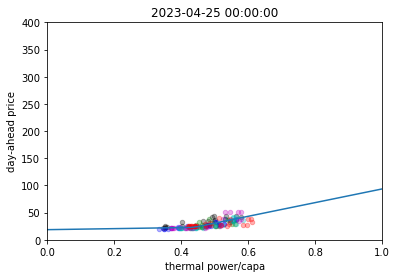

[0.4371595] [9.419519322764826, 125.81236978815524]
model acc: 66.41906999221115 2023-04-25 00:00:00
model acc: 95.40346375505526 2023-04-24 00:00:00
model acc: 42.820328432871406 2023-04-23 00:00:00
model acc: 63.14718236091475 2023-04-22 00:00:00
model acc: 38.978001504042524 2023-04-21 00:00:00


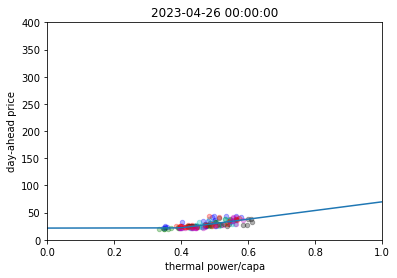

[0.39878391] [0.9228893526420824, 79.75533736493844]
model acc: 62.008685751836765 2023-04-26 00:00:00
model acc: 66.41907001043171 2023-04-25 00:00:00
model acc: 95.40346371466185 2023-04-24 00:00:00
model acc: 42.82035310143819 2023-04-23 00:00:00
model acc: 63.147172266990346 2023-04-22 00:00:00


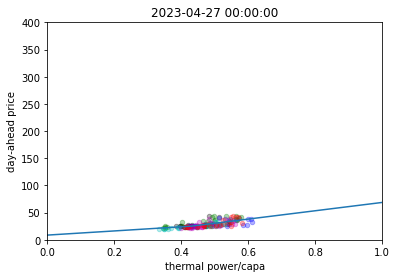

[0.42999575] [38.29032742947276, 76.5001464296308]
model acc: 73.52378788459504 2023-04-27 00:00:00
model acc: 62.00868580426997 2023-04-26 00:00:00
model acc: 66.4190700099134 2023-04-25 00:00:00
model acc: 95.40346375505521 2023-04-24 00:00:00
model acc: 42.820156052546736 2023-04-23 00:00:00


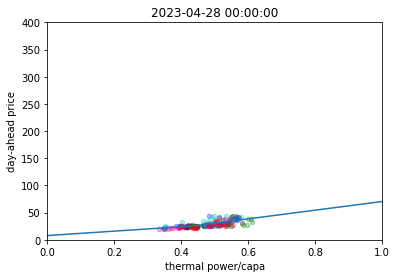

[0.43907384] [40.76353017379977, 79.80153760878132]
model acc: 46.64635879569843 2023-04-28 00:00:00
model acc: 73.5237878845951 2023-04-27 00:00:00
model acc: 62.00868581612922 2023-04-26 00:00:00
model acc: 66.41910514829604 2023-04-25 00:00:00
model acc: 95.40346366769285 2023-04-24 00:00:00


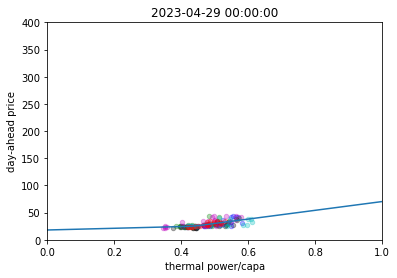

[0.43566701] [15.7001322097569, 80.56759740279904]
model acc: 34.78920336938499 2023-04-29 00:00:00
model acc: 46.647269542228585 2023-04-28 00:00:00
model acc: 73.52378788458142 2023-04-27 00:00:00
model acc: 62.00868658394856 2023-04-26 00:00:00
model acc: 66.41906998350909 2023-04-25 00:00:00


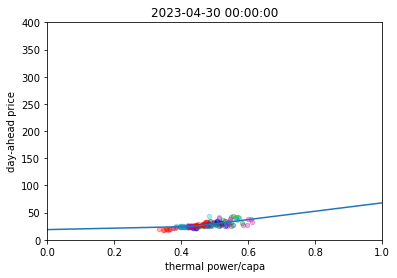

[0.43490297] [13.17195498693337, 76.91479619994041]
model acc: 19.964156523575486 2023-04-30 00:00:00
model acc: 34.78926969145142 2023-04-29 00:00:00
model acc: 46.646406192462365 2023-04-28 00:00:00
model acc: 73.52378788459504 2023-04-27 00:00:00
model acc: 62.008685598643964 2023-04-26 00:00:00


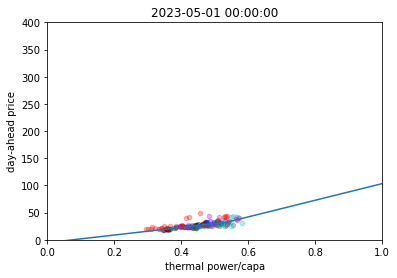

[0.53754223] [70.47736954183567, 153.05465746810214]
model acc: 92.44236934951928 2023-05-01 00:00:00
model acc: 19.964156615803287 2023-04-30 00:00:00
model acc: 34.78920336938499 2023-04-29 00:00:00
model acc: 46.64640615034542 2023-04-28 00:00:00
model acc: 73.52378788459515 2023-04-27 00:00:00


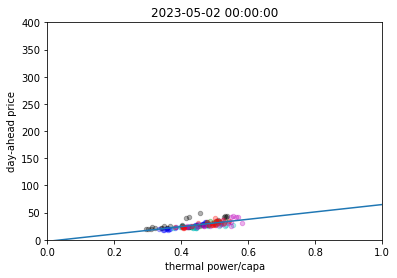

[0.35949495] [-10.256604283043746, 75.80323180753476]
model acc: 51.28376769475722 2023-05-02 00:00:00
model acc: 92.44279134085451 2023-05-01 00:00:00
model acc: 19.96415662529015 2023-04-30 00:00:00
model acc: 34.79387887774196 2023-04-29 00:00:00
model acc: 46.6464060899162 2023-04-28 00:00:00


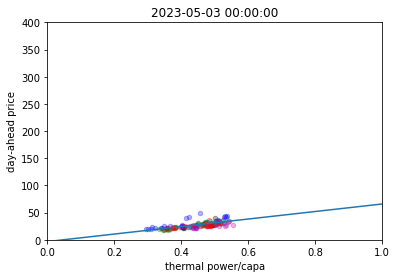

[0.35912723] [-8.11961774038564, 77.74163295961229]
model acc: 45.377915284873964 2023-05-03 00:00:00
model acc: 51.28376758942362 2023-05-02 00:00:00
model acc: 92.44269095998484 2023-05-01 00:00:00
model acc: 19.964156625569906 2023-04-30 00:00:00
model acc: 34.78920336938499 2023-04-29 00:00:00


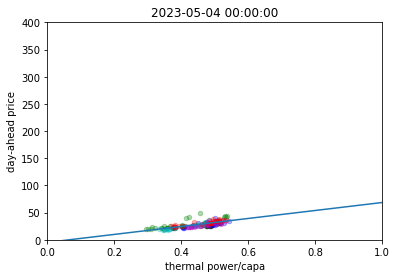

[0.35912723] [-9.186089396796667, 82.70752119974765]
model acc: 29.95151269747286 2023-05-04 00:00:00
model acc: 45.377909096589114 2023-05-03 00:00:00
model acc: 51.283767695830875 2023-05-02 00:00:00
model acc: 92.4423693502892 2023-05-01 00:00:00
model acc: 19.964156571646004 2023-04-30 00:00:00


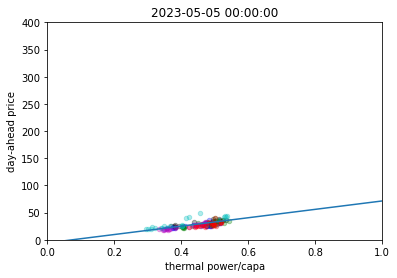

[0.35439308] [-3.002278467786622, 84.00056223317206]
model acc: 47.46434728780639 2023-05-05 00:00:00
model acc: 29.95257452788471 2023-05-04 00:00:00
model acc: 45.37790955513927 2023-05-03 00:00:00
model acc: 51.28376768560713 2023-05-02 00:00:00
model acc: 92.44236935004324 2023-05-01 00:00:00


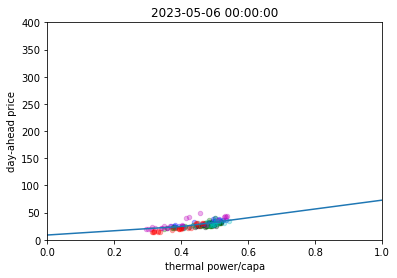

[0.40697912] [39.22052970202963, 81.26816147617792]
model acc: 29.92883178604243 2023-05-06 00:00:00
model acc: 47.464347348752 2023-05-05 00:00:00
model acc: 29.949601854073972 2023-05-04 00:00:00
model acc: 45.37791002238083 2023-05-03 00:00:00
model acc: 51.28376772676782 2023-05-02 00:00:00


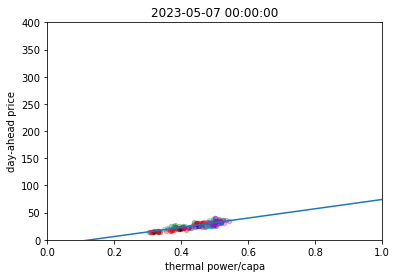

[0.4] [84.62583879811513, 85.35153781987738]
model acc: 32.17196254801347 2023-05-07 00:00:00
model acc: 29.928831783852722 2023-05-06 00:00:00
model acc: 47.464347333884085 2023-05-05 00:00:00
model acc: 29.94960187627725 2023-05-04 00:00:00
model acc: 45.377910031863024 2023-05-03 00:00:00


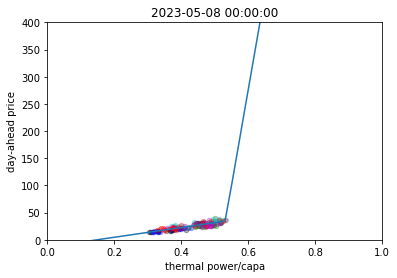

[0.53166931] [89.72961336646698, 3533.821191014888]
model acc: 45.54506330761397 2023-05-08 00:00:00
model acc: 32.17205991033274 2023-05-07 00:00:00
model acc: 29.928831921948944 2023-05-06 00:00:00
model acc: 47.46434734875197 2023-05-05 00:00:00
model acc: 29.950028293828385 2023-05-04 00:00:00


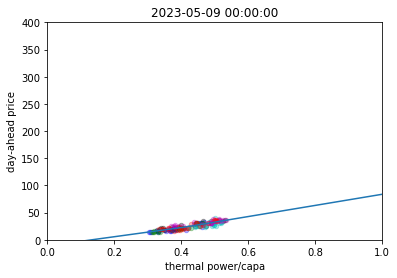

[0.41394142] [84.31540334047149, 102.45800666523986]
model acc: 44.0944783867318 2023-05-09 00:00:00
model acc: 45.54569657721125 2023-05-08 00:00:00
model acc: 32.172790559360564 2023-05-07 00:00:00
model acc: 29.92883180302674 2023-05-06 00:00:00
model acc: 47.4642205481082 2023-05-05 00:00:00


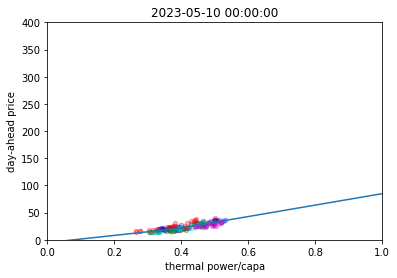

[0.39160383] [66.56031361720227, 105.27516888550316]
model acc: 25.88850193702892 2023-05-10 00:00:00
model acc: 44.094478594733 2023-05-09 00:00:00
model acc: 45.54506338172254 2023-05-08 00:00:00
model acc: 32.171962601217615 2023-05-07 00:00:00
model acc: 29.928803258051452 2023-05-06 00:00:00


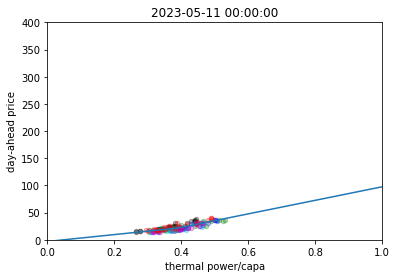

[0.39172387] [63.471429516767266, 124.54883012575353]
model acc: 42.073381787047396 2023-05-11 00:00:00
model acc: 25.888501920437676 2023-05-10 00:00:00
model acc: 44.094478488208544 2023-05-09 00:00:00
model acc: 45.54506338172256 2023-05-08 00:00:00
model acc: 32.17492358877917 2023-05-07 00:00:00


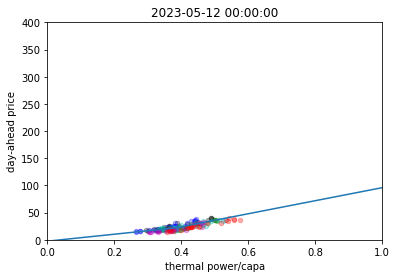

[0.38474993] [64.03885361791679, 119.91181837743476]
model acc: 29.28909841881386 2023-05-12 00:00:00
model acc: 42.073381483590495 2023-05-11 00:00:00
model acc: 25.889067816506596 2023-05-10 00:00:00
model acc: 44.09447804618577 2023-05-09 00:00:00
model acc: 45.545063381722514 2023-05-08 00:00:00


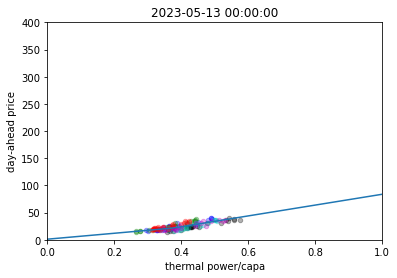

[0.37538017] [54.526211399674516, 99.5395339971504]
model acc: 34.0379318990376 2023-05-13 00:00:00
model acc: 29.28909853790774 2023-05-12 00:00:00
model acc: 42.07338172546654 2023-05-11 00:00:00
model acc: 25.888715099610707 2023-05-10 00:00:00
model acc: 44.09447852640436 2023-05-09 00:00:00


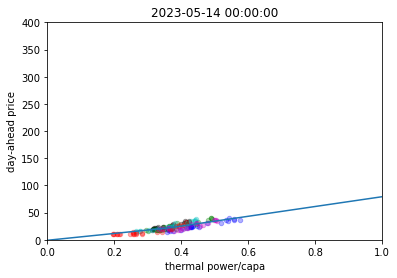

[0.3648354] [63.00360523863848, 90.03178418598473]
model acc: 16.818353976507446 2023-05-14 00:00:00
model acc: 34.039455026487246 2023-05-13 00:00:00
model acc: 29.28896731652585 2023-05-12 00:00:00
model acc: 42.07338147434538 2023-05-11 00:00:00
model acc: 25.88850183356146 2023-05-10 00:00:00


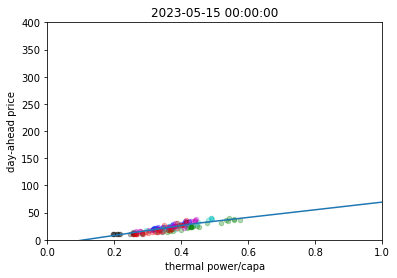

[0.44409417] [90.75772377282492, 70.31338026437528]
model acc: 42.852040696432326 2023-05-15 00:00:00
model acc: 16.818357205762098 2023-05-14 00:00:00
model acc: 34.037931462890896 2023-05-13 00:00:00
model acc: 29.28909841354796 2023-05-12 00:00:00
model acc: 42.07338175227618 2023-05-11 00:00:00


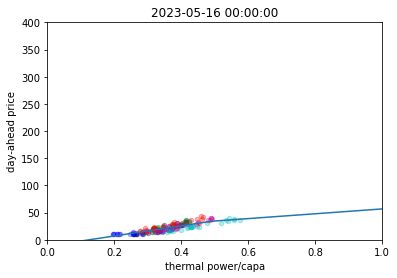

[0.49087765] [93.19873420563292, 44.51378960945762]
model acc: 42.23201270708911 2023-05-16 00:00:00
model acc: 42.852040328709165 2023-05-15 00:00:00
model acc: 16.818357287076434 2023-05-14 00:00:00
model acc: 34.0379318990376 2023-05-13 00:00:00
model acc: 29.290541729058674 2023-05-12 00:00:00


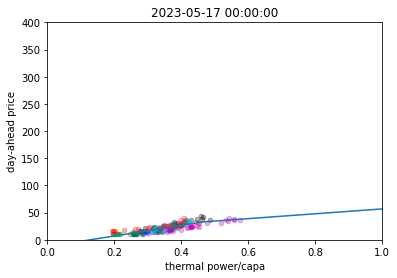

[0.46468139] [97.77536878068848, 44.64314397375792]
model acc: 42.495584503828155 2023-05-17 00:00:00
model acc: 42.23201270708908 2023-05-16 00:00:00
model acc: 42.852040645234425 2023-05-15 00:00:00
model acc: 16.818357206306885 2023-05-14 00:00:00
model acc: 34.03852587433629 2023-05-13 00:00:00


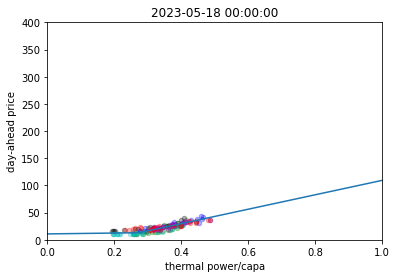

[0.27414652] [7.935601664085999, 132.698221905878]
model acc: 41.089584918581124 2023-05-18 00:00:00
model acc: 42.495584498245044 2023-05-17 00:00:00
model acc: 42.23201270708907 2023-05-16 00:00:00
model acc: 42.852040668877194 2023-05-15 00:00:00
model acc: 16.81835724797161 2023-05-14 00:00:00


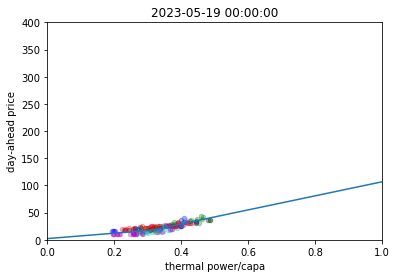

[0.31169611] [49.84009508354725, 129.27369938778966]
model acc: 31.537223791436862 2023-05-19 00:00:00
model acc: 41.08958494924251 2023-05-18 00:00:00
model acc: 42.49558448813596 2023-05-17 00:00:00
model acc: 42.23201270708914 2023-05-16 00:00:00
model acc: 42.852040649274066 2023-05-15 00:00:00


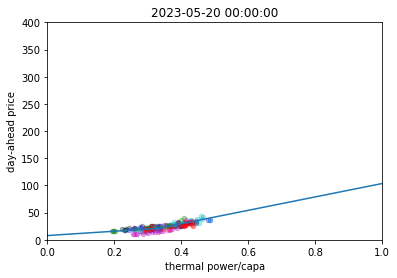

[0.33043865] [39.89730647867906, 123.28900637705782]
model acc: 46.32589330645387 2023-05-20 00:00:00
model acc: 31.53722379143685 2023-05-19 00:00:00
model acc: 41.08958492566714 2023-05-18 00:00:00
model acc: 42.49558449550116 2023-05-17 00:00:00
model acc: 42.23201270708907 2023-05-16 00:00:00


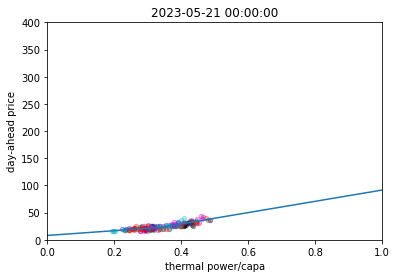

[0.33687261] [43.86243714103418, 103.67730502641378]
model acc: 52.77741340482727 2023-05-21 00:00:00
model acc: 46.325893306603135 2023-05-20 00:00:00
model acc: 31.53722379143681 2023-05-19 00:00:00
model acc: 41.0895849520141 2023-05-18 00:00:00
model acc: 42.49558450842558 2023-05-17 00:00:00


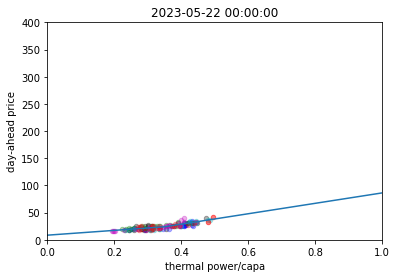

[0.35034777] [44.20722056972642, 95.86204360800501]
model acc: 47.89324585061273 2023-05-22 00:00:00
model acc: 52.77752601624422 2023-05-21 00:00:00
model acc: 46.32589330649108 2023-05-20 00:00:00
model acc: 31.53722379143679 2023-05-19 00:00:00
model acc: 41.08958491121008 2023-05-18 00:00:00


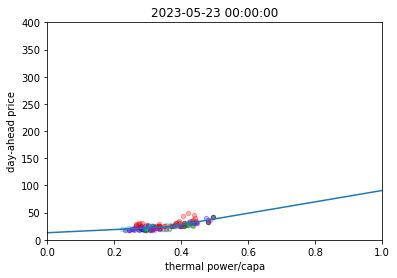

[0.35643835] [29.26926619997799, 104.54371796247993]
model acc: 56.15054215302618 2023-05-23 00:00:00
model acc: 47.89324584456779 2023-05-22 00:00:00
model acc: 52.77752607809526 2023-05-21 00:00:00
model acc: 46.32589330708282 2023-05-20 00:00:00
model acc: 31.537223791436904 2023-05-19 00:00:00


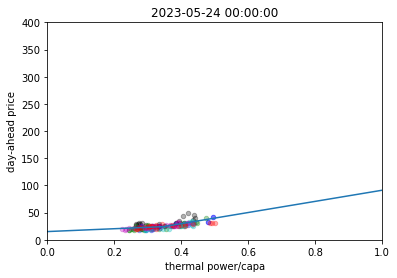

[0.34657628] [26.145889930468055, 102.50586212516878]
model acc: 28.407219361587416 2023-05-24 00:00:00
model acc: 56.15054214458544 2023-05-23 00:00:00
model acc: 47.893246701350776 2023-05-22 00:00:00
model acc: 52.77752584245259 2023-05-21 00:00:00
model acc: 46.325893307461314 2023-05-20 00:00:00


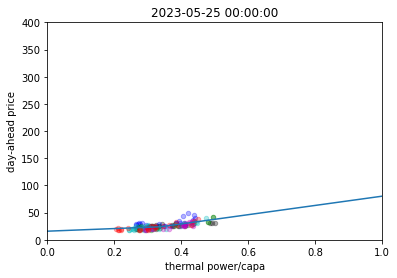

[0.3389488] [24.05322137494826, 85.09647917966765]
model acc: 37.54756572570189 2023-05-25 00:00:00
model acc: 28.407219071494907 2023-05-24 00:00:00
model acc: 56.15054213152788 2023-05-23 00:00:00
model acc: 47.893245838193934 2023-05-22 00:00:00
model acc: 52.77752607925156 2023-05-21 00:00:00


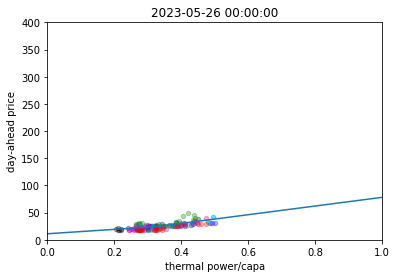

[0.32733861] [40.555009494526686, 79.9264015507271]
model acc: 34.03882994626041 2023-05-26 00:00:00
model acc: 37.54756579018205 2023-05-25 00:00:00
model acc: 28.40720533007464 2023-05-24 00:00:00
model acc: 56.15054214983053 2023-05-23 00:00:00
model acc: 47.89324643787322 2023-05-22 00:00:00


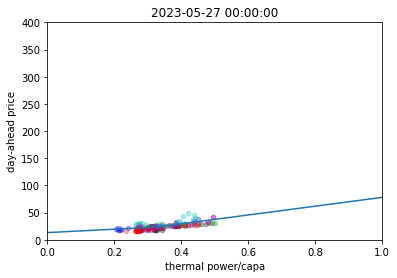

[0.32531345] [31.240731035541113, 80.94826849093639]
model acc: 26.130571705205107 2023-05-27 00:00:00
model acc: 34.038829589418064 2023-05-26 00:00:00
model acc: 37.547565789031076 2023-05-25 00:00:00
model acc: 28.40721937229095 2023-05-24 00:00:00
model acc: 56.15054215266517 2023-05-23 00:00:00


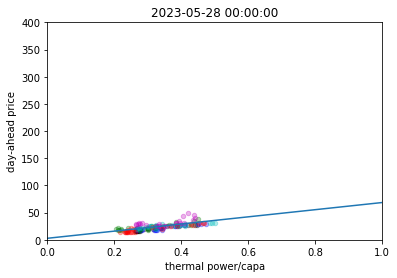

[0.4377374] [73.12036411501936, -34.358110501620686]
model acc: 30.575822888391457 2023-05-28 00:00:00
model acc: 26.130575885880404 2023-05-27 00:00:00
model acc: 34.03883001857572 2023-05-26 00:00:00
model acc: 37.54756578574364 2023-05-25 00:00:00
model acc: 28.407219297881447 2023-05-24 00:00:00


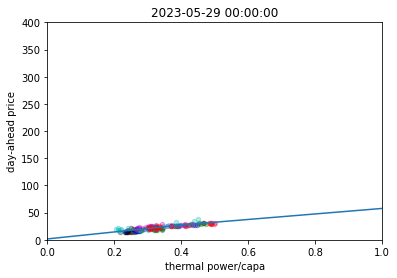

[0.4] [64.17169071983041, 50.713501116291106]
model acc: 24.824175837286226 2023-05-29 00:00:00
model acc: 30.57582290796229 2023-05-28 00:00:00
model acc: 26.130571670594545 2023-05-27 00:00:00
model acc: 34.03772757699349 2023-05-26 00:00:00
model acc: 37.54860987710339 2023-05-25 00:00:00


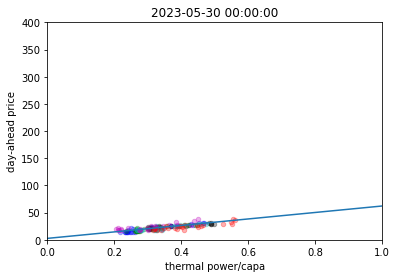

[0.45388156] [64.86212294153044, -34.45411531618916]
model acc: 43.218281442474265 2023-05-30 00:00:00
model acc: 24.824175838054767 2023-05-29 00:00:00
model acc: 30.575822889013374 2023-05-28 00:00:00
model acc: 26.13057165528307 2023-05-27 00:00:00
model acc: 34.038829578595156 2023-05-26 00:00:00


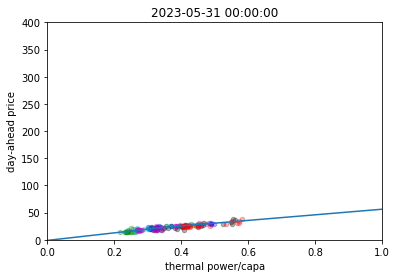

[0.33243952] [69.29897199407817, 51.40980565904878]
model acc: 24.44834237584779 2023-05-31 00:00:00
model acc: 43.218281162735586 2023-05-30 00:00:00
model acc: 24.824175834156833 2023-05-29 00:00:00
model acc: 30.57604650204618 2023-05-28 00:00:00
model acc: 26.130571667734642 2023-05-27 00:00:00


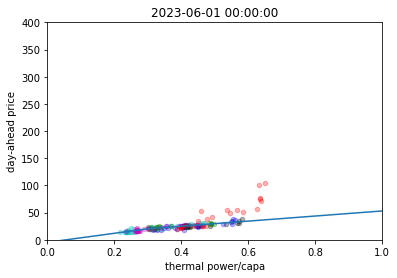

[0.30209197] [83.14931791382331, 46.714346956478416]
model acc: 140.99631252608918 2023-06-01 00:00:00
model acc: 24.448342375843144 2023-05-31 00:00:00
model acc: 43.21824482135769 2023-05-30 00:00:00
model acc: 24.82417582643839 2023-05-29 00:00:00
model acc: 30.575822888140646 2023-05-28 00:00:00


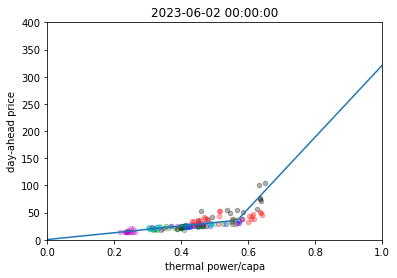

[0.56781711] [62.57643198062231, 659.041798766521]
model acc: 108.8897464428712 2023-06-02 00:00:00
model acc: 140.99809984348764 2023-06-01 00:00:00
model acc: 24.448342375843072 2023-05-31 00:00:00
model acc: 43.21827982842283 2023-05-30 00:00:00
model acc: 24.82418489293193 2023-05-29 00:00:00


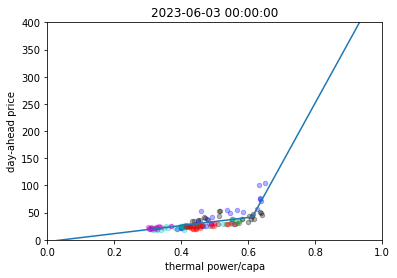

[0.61250715] [74.06438060283028, 1118.7352609040377]
model acc: 48.06281447199957 2023-06-03 00:00:00
model acc: 108.88975084646691 2023-06-02 00:00:00
model acc: 140.99631683413816 2023-06-01 00:00:00
model acc: 24.44834237584319 2023-05-31 00:00:00
model acc: 43.218281426724815 2023-05-30 00:00:00


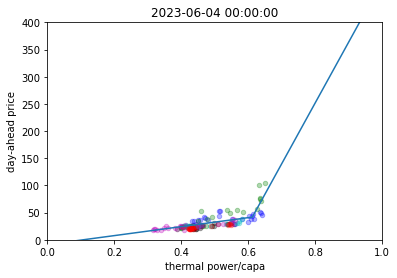

[0.61235685] [82.64907688634207, 1118.7352672754682]
model acc: 17.445378298971033 2023-06-04 00:00:00
model acc: 48.062831009745736 2023-06-03 00:00:00
model acc: 108.89281535230862 2023-06-02 00:00:00
model acc: 140.99631286984106 2023-06-01 00:00:00
model acc: 24.448342375843023 2023-05-31 00:00:00


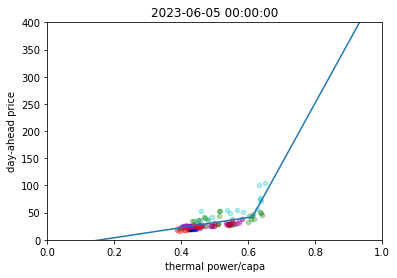

[0.61271242] [93.0192338997504, 1118.7352731164085]
model acc: 35.41995003344395 2023-06-05 00:00:00
model acc: 17.445376477321943 2023-06-04 00:00:00
model acc: 48.06281455516712 2023-06-03 00:00:00
model acc: 108.89270518681238 2023-06-02 00:00:00
model acc: 140.99631253572994 2023-06-01 00:00:00


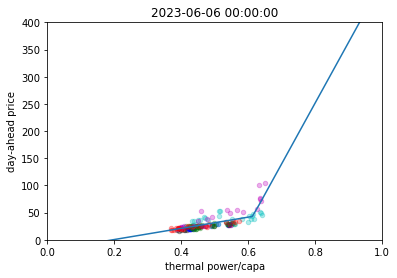

[0.6135223] [103.00325182032654, 1118.7352777764754]
model acc: 33.78164213670406 2023-06-06 00:00:00
model acc: 35.420126747263964 2023-06-05 00:00:00
model acc: 17.44536962895464 2023-06-04 00:00:00
model acc: 48.06281458193406 2023-06-03 00:00:00
model acc: 108.88974645247315 2023-06-02 00:00:00


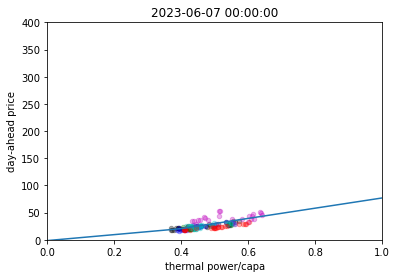

[0.39847819] [54.779487376394066, 94.05849537211064]
model acc: 17.767571478089973 2023-06-07 00:00:00
model acc: 33.781642136711596 2023-06-06 00:00:00
model acc: 35.42012661944487 2023-06-05 00:00:00
model acc: 17.446281949236344 2023-06-04 00:00:00
model acc: 48.062814583433834 2023-06-03 00:00:00


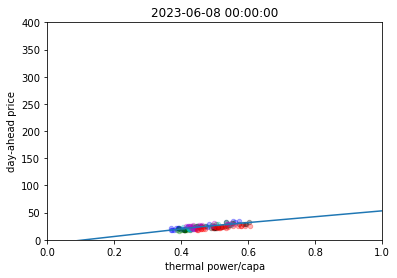

[0.45568553] [69.56245605409703, 53.973204708005255]
model acc: 19.111624776048558 2023-06-08 00:00:00
model acc: 17.7675946642198 2023-06-07 00:00:00
model acc: 33.781642074728616 2023-06-06 00:00:00
model acc: 35.42012663165863 2023-06-05 00:00:00
model acc: 17.447596740931775 2023-06-04 00:00:00


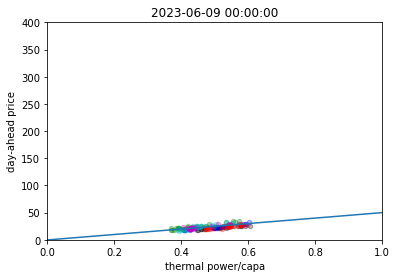

[0.56794545] [53.065823752247205, -3.6299654352980233]
model acc: 12.962342765979905 2023-06-09 00:00:00
model acc: 19.11149511329061 2023-06-08 00:00:00
model acc: 17.767717935196345 2023-06-07 00:00:00
model acc: 33.78164213685996 2023-06-06 00:00:00
model acc: 35.42012671187642 2023-06-05 00:00:00


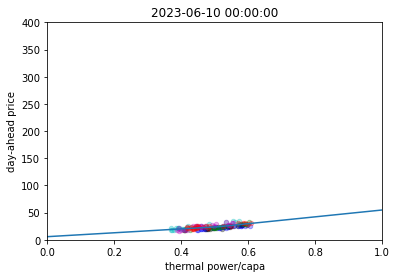

[0.51160275] [35.84331691652321, 62.93418271025369]
model acc: 34.218960043370785 2023-06-10 00:00:00
model acc: 12.962342765979912 2023-06-09 00:00:00
model acc: 19.111495113290584 2023-06-08 00:00:00
model acc: 17.76758271879089 2023-06-07 00:00:00
model acc: 33.78164213671609 2023-06-06 00:00:00


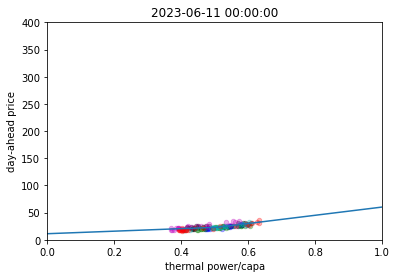

[0.50857177] [23.320552251584004, 75.63467999711298]
model acc: 29.25522257675223 2023-06-11 00:00:00
model acc: 34.21918836240863 2023-06-10 00:00:00
model acc: 12.962342765979912 2023-06-09 00:00:00
model acc: 19.111665663442732 2023-06-08 00:00:00
model acc: 17.767673268478823 2023-06-07 00:00:00


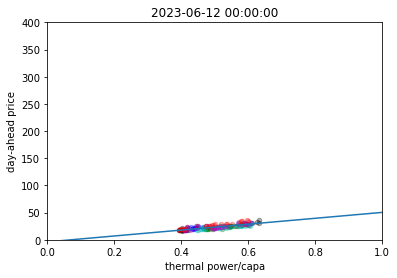

[0.39399065] [-334.7017107655286, 54.37174236113459]
model acc: 21.859986879313958 2023-06-12 00:00:00
model acc: 29.255588553394574 2023-06-11 00:00:00
model acc: 34.21918851038429 2023-06-10 00:00:00
model acc: 12.962342765979912 2023-06-09 00:00:00
model acc: 19.11168076355081 2023-06-08 00:00:00


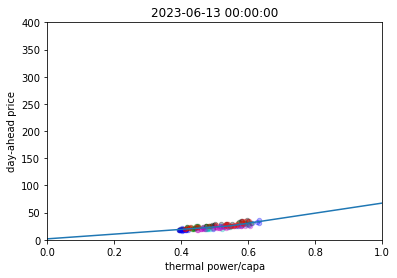

[0.54569383] [43.514540103787205, 92.45511428767078]
model acc: 31.347399081114467 2023-06-13 00:00:00
model acc: 21.859986883692724 2023-06-12 00:00:00
model acc: 29.25602003494624 2023-06-11 00:00:00
model acc: 34.21918857484472 2023-06-10 00:00:00
model acc: 12.962342765982878 2023-06-09 00:00:00


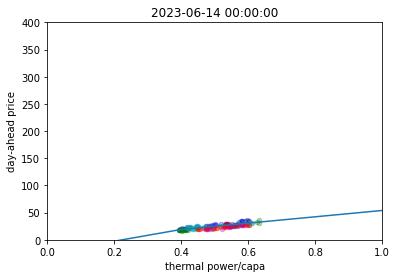

[0.39984871] [108.11017409318615, 58.15405173876995]
model acc: 22.83338386841414 2023-06-14 00:00:00
model acc: 31.347399031534824 2023-06-13 00:00:00
model acc: 21.859934293093456 2023-06-12 00:00:00
model acc: 29.255160581718314 2023-06-11 00:00:00
model acc: 34.21918836351715 2023-06-10 00:00:00


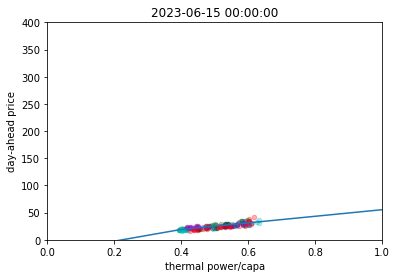

[0.39918269] [108.11019069138452, 60.59406445286496]
model acc: 36.30903790476188 2023-06-15 00:00:00
model acc: 22.83338386501897 2023-06-14 00:00:00
model acc: 31.34739903137288 2023-06-13 00:00:00
model acc: 21.859953385143353 2023-06-12 00:00:00
model acc: 29.255160904260684 2023-06-11 00:00:00


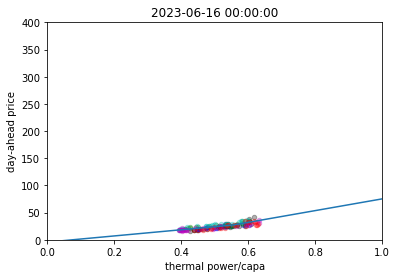

[0.55673352] [56.86599364784361, 108.01675889973434]
model acc: 39.98556838551254 2023-06-16 00:00:00
model acc: 36.31269681629681 2023-06-15 00:00:00
model acc: 22.833191704209128 2023-06-14 00:00:00
model acc: 31.347399111457392 2023-06-13 00:00:00
model acc: 21.859958158653928 2023-06-12 00:00:00


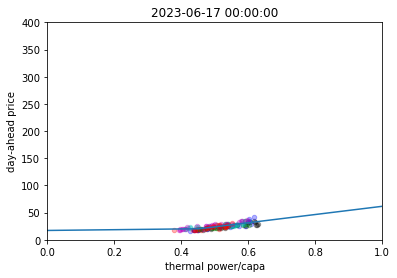

[0.45366934] [6.89454253621158, 75.53598005231756]
model acc: 33.274184270261074 2023-06-17 00:00:00
model acc: 39.98623429556811 2023-06-16 00:00:00
model acc: 36.30946556099161 2023-06-15 00:00:00
model acc: 22.83338386394239 2023-06-14 00:00:00
model acc: 31.347399033368124 2023-06-13 00:00:00


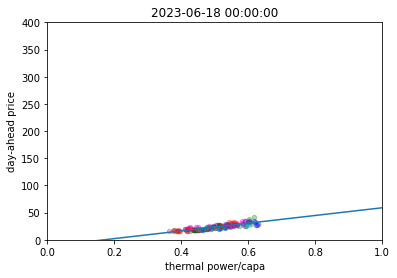

[0.4] [-63.76223725744388, 71.89443790802248]
model acc: 25.709835046574092 2023-06-18 00:00:00
model acc: 33.274184270261195 2023-06-17 00:00:00
model acc: 39.9864101529004 2023-06-16 00:00:00
model acc: 36.31027640395298 2023-06-15 00:00:00
model acc: 22.833371601475825 2023-06-14 00:00:00


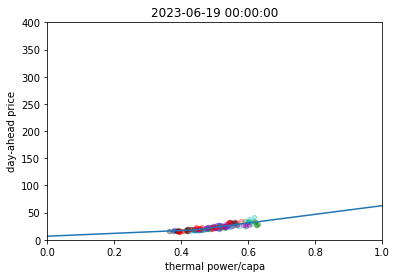

[0.44034859] [26.26425673783914, 79.67138744570546]
model acc: 29.961632821160435 2023-06-19 00:00:00
model acc: 25.709835063533873 2023-06-18 00:00:00
model acc: 33.274184270261074 2023-06-17 00:00:00
model acc: 39.98553784572165 2023-06-16 00:00:00
model acc: 36.312346747726735 2023-06-15 00:00:00


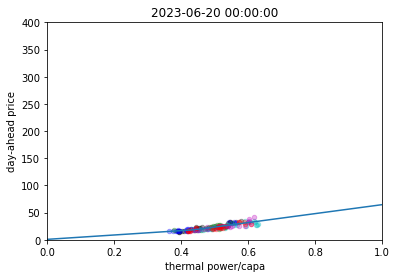

[0.43869242] [40.13554439271685, 82.32181645384395]
model acc: 40.72888367613834 2023-06-20 00:00:00
model acc: 29.96161878246788 2023-06-19 00:00:00
model acc: 25.709835058963986 2023-06-18 00:00:00
model acc: 33.2741842702611 2023-06-17 00:00:00
model acc: 39.98553709273271 2023-06-16 00:00:00


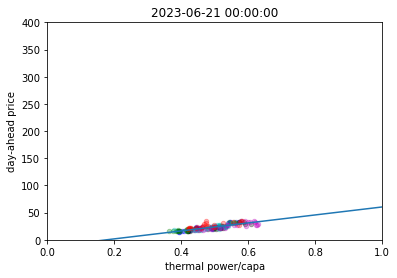

[0.40001854] [-21.56920612772954, 76.92300931404063]
model acc: 46.57610338601022 2023-06-21 00:00:00
model acc: 40.72887903678322 2023-06-20 00:00:00
model acc: 29.961651626469212 2023-06-19 00:00:00
model acc: 25.709835017830216 2023-06-18 00:00:00
model acc: 33.27418427026105 2023-06-17 00:00:00


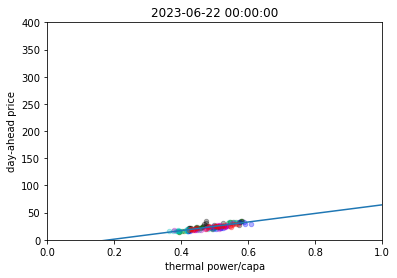

[0.39391358] [-12.485349522885445, 81.13539563221009]
model acc: 24.715387356819033 2023-06-22 00:00:00
model acc: 46.5760942034181 2023-06-21 00:00:00
model acc: 40.72888362761716 2023-06-20 00:00:00
model acc: 29.961618738289104 2023-06-19 00:00:00
model acc: 25.709835048528483 2023-06-18 00:00:00


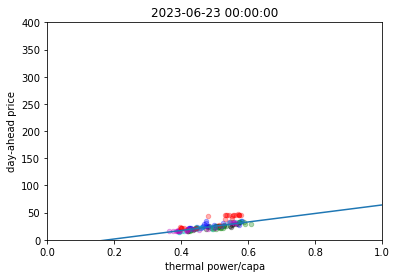

[0.36971574] [-281.35929900477197, 78.78560838874637]
model acc: 60.91678535694628 2023-06-23 00:00:00
model acc: 24.715387354212908 2023-06-22 00:00:00
model acc: 46.57610338601022 2023-06-21 00:00:00
model acc: 40.72888368993655 2023-06-20 00:00:00
model acc: 29.961578961861328 2023-06-19 00:00:00


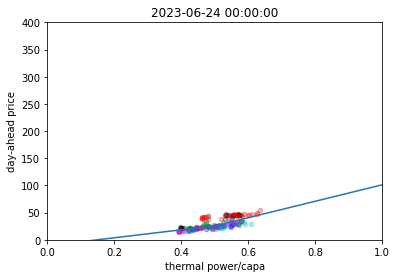

[0.50330836] [73.42313311585585, 151.32247851192625]
model acc: 38.307296128614304 2023-06-24 00:00:00
model acc: 60.916795302073915 2023-06-23 00:00:00
model acc: 24.715471223135655 2023-06-22 00:00:00
model acc: 46.5761033860102 2023-06-21 00:00:00
model acc: 40.72874018972857 2023-06-20 00:00:00


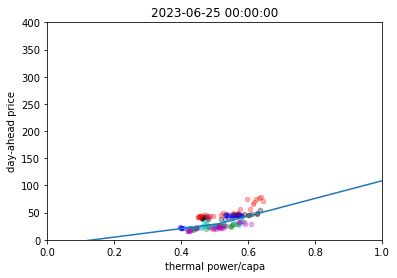

[0.51173415] [78.55470748571943, 162.1984213652918]
model acc: 58.50174716793409 2023-06-25 00:00:00
model acc: 38.307296128613196 2023-06-24 00:00:00
model acc: 60.91672441225134 2023-06-23 00:00:00
model acc: 24.71545293094604 2023-06-22 00:00:00
search 3 days for 3 part


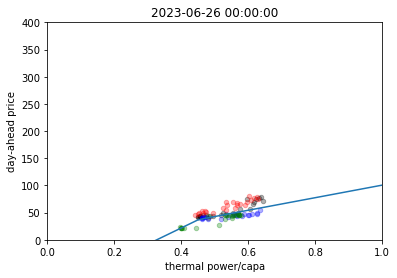

[0.45192501] [297.92069984640864, 115.52494385769168]
model acc: 67.2794236537693 2023-06-26 00:00:00
model acc: 58.501747934689604 2023-06-25 00:00:00
model acc: 38.30164335036417 2023-06-24 00:00:00
search 2 days for 3 part


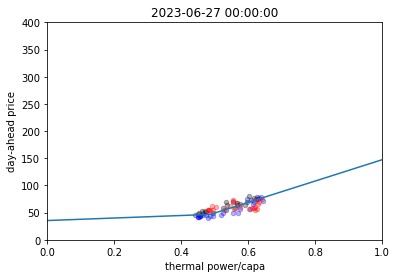

[0.48704342] [23.167461808012327, 196.0994726787072]
model acc: 102.15098297975041 2023-06-27 00:00:00
model acc: 67.27941727467609 2023-06-26 00:00:00
model acc: 58.50174786483651 2023-06-25 00:00:00
model acc: 38.30164564618305 2023-06-24 00:00:00
model acc: 60.9167953020739 2023-06-23 00:00:00
search 4 days for 3 part


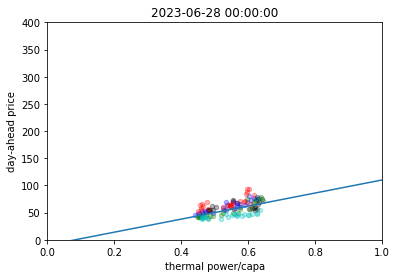

[0.45407658] [-193.72358099556024, 122.32180023354444]
model acc: 117.67053783498079 2023-06-28 00:00:00
model acc: 102.15098297636476 2023-06-27 00:00:00
model acc: 67.27998683492434 2023-06-26 00:00:00
model acc: 58.501747158361525 2023-06-25 00:00:00
model acc: 38.307296128614254 2023-06-24 00:00:00
search 4 days for 3 part


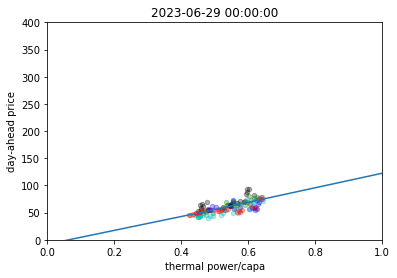

[0.49205847] [127.50939402813304, 133.54565209310576]
model acc: 51.15172687484597 2023-06-29 00:00:00
model acc: 117.67053786542863 2023-06-28 00:00:00
model acc: 102.15053040707515 2023-06-27 00:00:00
model acc: 67.2794173722512 2023-06-26 00:00:00
model acc: 58.50174716720134 2023-06-25 00:00:00


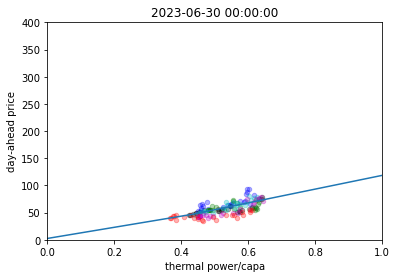

[0.43451063] [102.59766587718093, 126.36681535240814]
model acc: 60.92454848725605 2023-06-30 00:00:00
model acc: 51.1517258585125 2023-06-29 00:00:00
model acc: 117.67053781278769 2023-06-28 00:00:00
search 2 days for 3 part


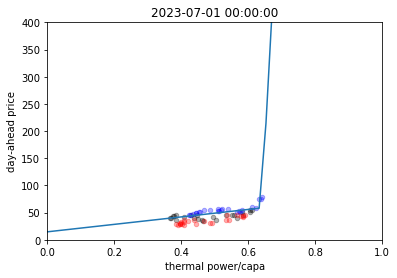

[0.63925752] [68.63026052421377, 11293.90279630086]
model acc: 57.02784479921725 2023-07-01 00:00:00
model acc: 60.924549034446414 2023-06-30 00:00:00
model acc: 51.15172586192907 2023-06-29 00:00:00
model acc: 117.6669396389669 2023-06-28 00:00:00
search 3 days for 3 part


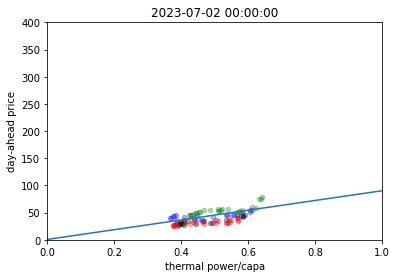

[0.39164248] [-370.2106639513826, 100.67459992274479]
model acc: 43.3303619900711 2023-07-02 00:00:00
model acc: 57.02784468733391 2023-07-01 00:00:00
model acc: 60.92454902875201 2023-06-30 00:00:00
model acc: 51.15172699329696 2023-06-29 00:00:00
search 3 days for 3 part


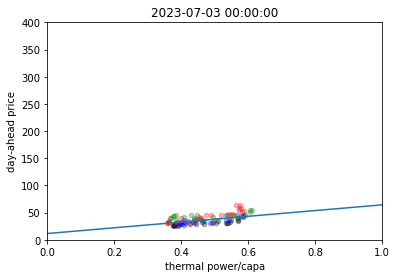

[0.39077912] [-245.16899645182346, 63.79144966638347]
model acc: 64.05466236928551 2023-07-03 00:00:00
model acc: 43.33036206440969 2023-07-02 00:00:00
model acc: 57.02861512156049 2023-07-01 00:00:00
model acc: 60.924549119515724 2023-06-30 00:00:00
model acc: 51.15172586296386 2023-06-29 00:00:00


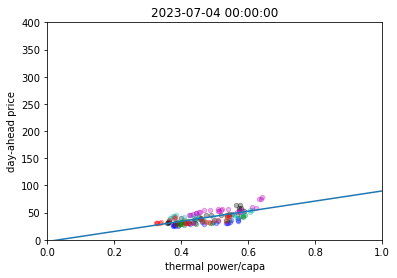

[0.38486911] [-75.61827689773368, 98.38055900107013]
model acc: 62.114515176007984 2023-07-04 00:00:00
model acc: 64.05468693539532 2023-07-03 00:00:00
model acc: 43.33036204264488 2023-07-02 00:00:00
model acc: 57.02850183166872 2023-07-01 00:00:00
model acc: 60.92454903658193 2023-06-30 00:00:00


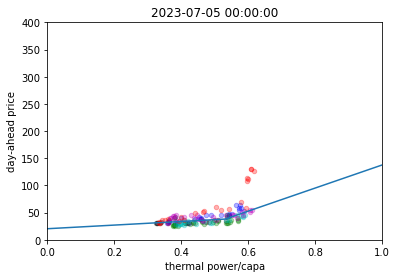

[0.53119229] [33.4432226870323, 212.29390984416253]
model acc: 141.86508169616098 2023-07-05 00:00:00
model acc: 62.11451514794889 2023-07-04 00:00:00
model acc: 64.05466237829147 2023-07-03 00:00:00
model acc: 43.330361981596354 2023-07-02 00:00:00
search 3 days for 3 part


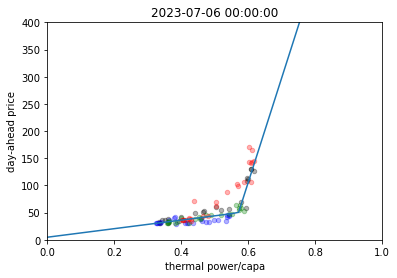

[0.5709795] [78.70864528324955, 1923.2599850834372]
model acc: 208.72706240552563 2023-07-06 00:00:00
model acc: 141.86508169166484 2023-07-05 00:00:00
model acc: 62.11451515845293 2023-07-04 00:00:00
search 2 days for 3 part


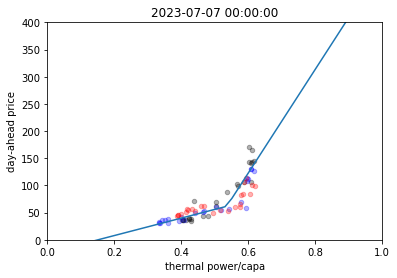

[0.53606365] [160.3257867843344, 953.4467961937955]
model acc: 161.756737746096 2023-07-07 00:00:00
model acc: 208.72706241549196 2023-07-06 00:00:00
search 1 days for 3 part


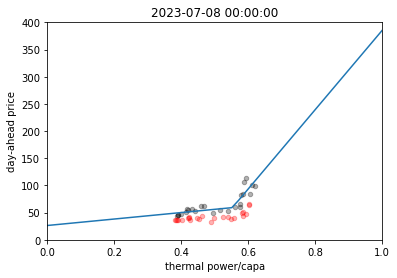

[0.552961] [59.49416452097535, 729.1701992211043]
model acc: 54.445650138278225 2023-07-08 00:00:00
model acc: 161.75673776621895 2023-07-07 00:00:00
search 1 days for 3 part


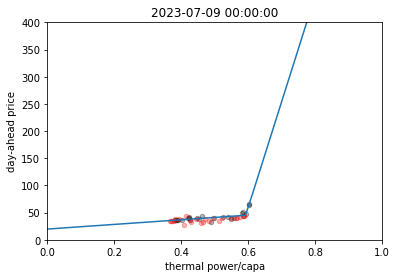

[0.592592] [42.84414302565302, 1947.234538931825]
model acc: 54.224147602640116 2023-07-09 00:00:00
model acc: 54.4455408718938 2023-07-08 00:00:00
model acc: 161.7567377892905 2023-07-07 00:00:00
search 2 days for 3 part


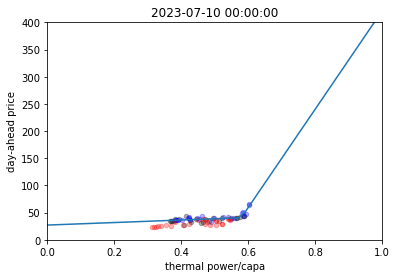

[0.5792516] [23.269493979387345, 904.4123658884123]
model acc: 61.59221259541187 2023-07-10 00:00:00
model acc: 54.227300945395356 2023-07-09 00:00:00
model acc: 54.44564867261439 2023-07-08 00:00:00
model acc: 161.75673779191274 2023-07-07 00:00:00
search 3 days for 3 part


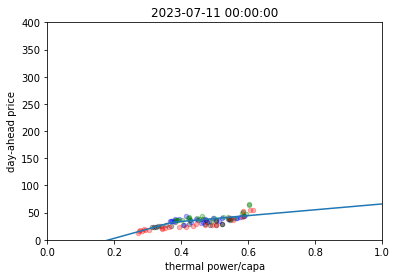

[0.37230151] [171.3088420692859, 53.69896206714656]
model acc: 40.57332214489098 2023-07-11 00:00:00
model acc: 61.592212596162696 2023-07-10 00:00:00
model acc: 54.227553403326255 2023-07-09 00:00:00
model acc: 54.44564867029379 2023-07-08 00:00:00
model acc: 161.75673794153926 2023-07-07 00:00:00
search 4 days for 3 part


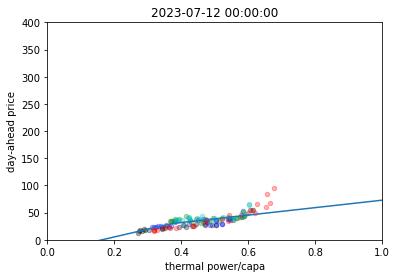

[0.37313867] [142.41490917010168, 68.54709102775142]
model acc: 92.46336289132758 2023-07-12 00:00:00
model acc: 40.573322492548726 2023-07-11 00:00:00
model acc: 61.59258345352325 2023-07-10 00:00:00
model acc: 54.2259296467233 2023-07-09 00:00:00
model acc: 54.445650129068206 2023-07-08 00:00:00


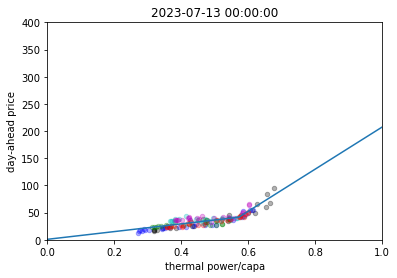

[0.57163098] [71.12860914679082, 387.2367118548634]
model acc: 33.98996050967469 2023-07-13 00:00:00
model acc: 92.46336221898092 2023-07-12 00:00:00
model acc: 40.57332423520785 2023-07-11 00:00:00
model acc: 61.59221259466647 2023-07-10 00:00:00
model acc: 54.22454604316977 2023-07-09 00:00:00


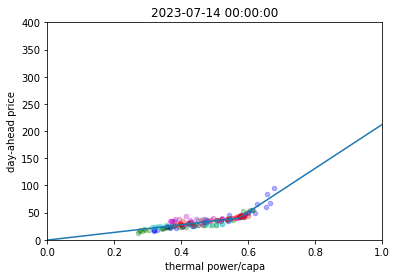

[0.5730419] [70.73389071781095, 402.9543146529733]
model acc: 28.295805156114138 2023-07-14 00:00:00
model acc: 33.98996067209838 2023-07-13 00:00:00
model acc: 92.46336296107232 2023-07-12 00:00:00
model acc: 40.5733221625031 2023-07-11 00:00:00
model acc: 61.59227115258589 2023-07-10 00:00:00


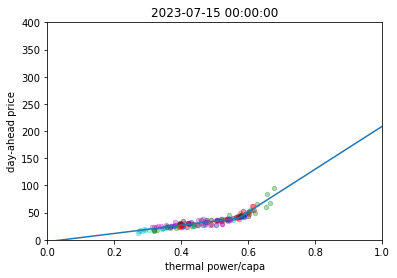

[0.57152557] [75.8085661926742, 394.0773616049822]
model acc: 64.37578364822298 2023-07-15 00:00:00
model acc: 28.295735085973657 2023-07-14 00:00:00
model acc: 33.98996049323006 2023-07-13 00:00:00
model acc: 92.46336333736234 2023-07-12 00:00:00
model acc: 40.57332193415919 2023-07-11 00:00:00


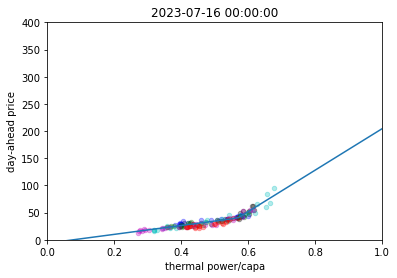

[0.5691291] [81.50577853910708, 381.3537123645345]
model acc: 33.623082113242745 2023-07-16 00:00:00
model acc: 64.37578602958419 2023-07-15 00:00:00
model acc: 28.295735105029394 2023-07-14 00:00:00
model acc: 33.989960494376035 2023-07-13 00:00:00
model acc: 92.46336333812215 2023-07-12 00:00:00


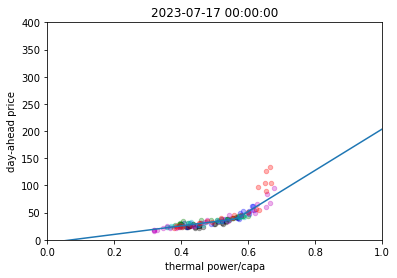

[0.56463207] [78.39668749898301, 379.36512787194073]
model acc: 148.8607967579605 2023-07-17 00:00:00
model acc: 33.62308211486098 2023-07-16 00:00:00
model acc: 64.37578590456214 2023-07-15 00:00:00
model acc: 28.295735160633793 2023-07-14 00:00:00
model acc: 33.989960464819454 2023-07-13 00:00:00


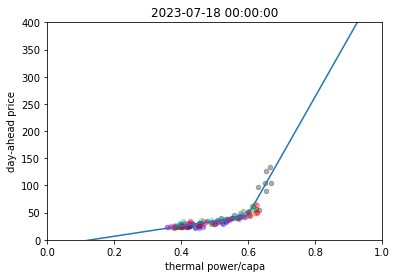

[0.59804751] [94.0445265936142, 1086.3064706349103]
model acc: 74.4247091575661 2023-07-18 00:00:00
model acc: 148.86079708281278 2023-07-17 00:00:00
model acc: 33.62308211346283 2023-07-16 00:00:00
model acc: 64.37578364360564 2023-07-15 00:00:00
model acc: 28.295735114612466 2023-07-14 00:00:00


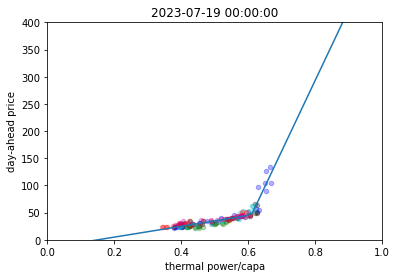

[0.6097266] [99.66344526777972, 1300.2593822628628]
model acc: 39.18358580597126 2023-07-19 00:00:00
model acc: 74.42471155365023 2023-07-18 00:00:00
model acc: 148.86079674625748 2023-07-17 00:00:00
model acc: 33.62308211482995 2023-07-16 00:00:00
model acc: 64.3757836570436 2023-07-15 00:00:00


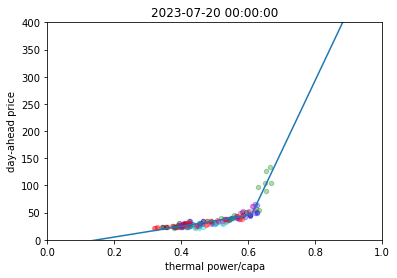

[0.60975237] [99.3845063431714, 1300.2593842313177]
model acc: 46.697176901395856 2023-07-20 00:00:00
model acc: 39.18133426540132 2023-07-19 00:00:00
model acc: 74.42471026389768 2023-07-18 00:00:00
model acc: 148.8607967488658 2023-07-17 00:00:00
model acc: 33.62308211377872 2023-07-16 00:00:00


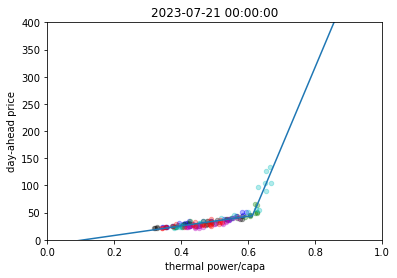

[0.613264] [88.25294100045875, 1463.2638942008234]
model acc: 51.84973924656412 2023-07-21 00:00:00
model acc: 46.69700452408709 2023-07-20 00:00:00
model acc: 39.18133440891293 2023-07-19 00:00:00
model acc: 74.4247102217841 2023-07-18 00:00:00
model acc: 148.8607969284526 2023-07-17 00:00:00


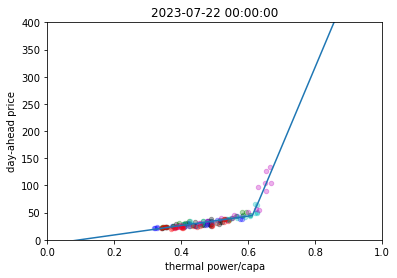

[0.61350979] [86.72030489662058, 1463.2638969439708]
model acc: 25.149670640042014 2023-07-22 00:00:00
model acc: 51.85274135115105 2023-07-21 00:00:00
model acc: 46.69700454153483 2023-07-20 00:00:00
model acc: 39.18133440891298 2023-07-19 00:00:00
model acc: 74.42471152567005 2023-07-18 00:00:00


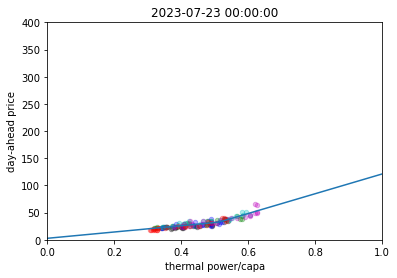

[0.51239402] [57.99966881035108, 181.7820614378528]
model acc: 34.615499632503976 2023-07-23 00:00:00
model acc: 25.149670645074945 2023-07-22 00:00:00
model acc: 51.84941073735776 2023-07-21 00:00:00
model acc: 46.697004530657296 2023-07-20 00:00:00
model acc: 39.18130573542544 2023-07-19 00:00:00


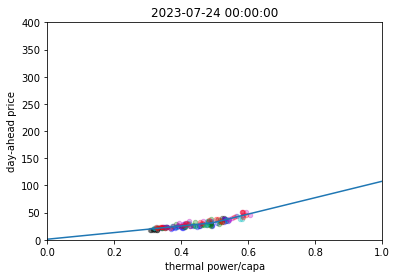

[0.49404421] [61.13211904476957, 151.0260836331595]
model acc: 47.31513819074155 2023-07-24 00:00:00
model acc: 34.61549964958864 2023-07-23 00:00:00
model acc: 25.14967063992662 2023-07-22 00:00:00
model acc: 51.8494108055601 2023-07-21 00:00:00
model acc: 46.69700450831806 2023-07-20 00:00:00


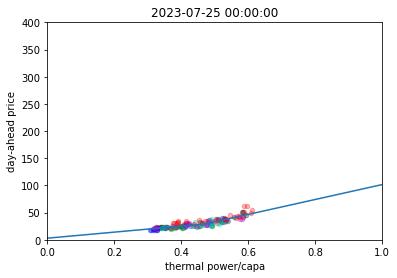

[0.47352226] [55.718845387025965, 137.23151080238532]
model acc: 69.77625367940955 2023-07-25 00:00:00
model acc: 47.31513813438413 2023-07-24 00:00:00
model acc: 34.6154996567328 2023-07-23 00:00:00
model acc: 25.149670638511747 2023-07-22 00:00:00
model acc: 51.84941081309024 2023-07-21 00:00:00


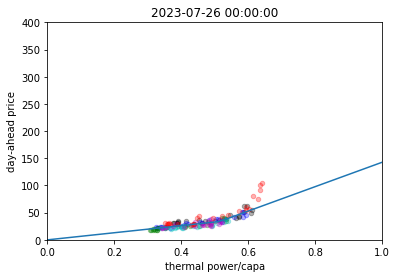

[0.51410014] [65.56337289728917, 224.46513792720387]
model acc: 97.73849091441176 2023-07-26 00:00:00
model acc: 69.7762538195426 2023-07-25 00:00:00
model acc: 47.31514077750575 2023-07-24 00:00:00
model acc: 34.61549956693423 2023-07-23 00:00:00
model acc: 25.149670639342837 2023-07-22 00:00:00


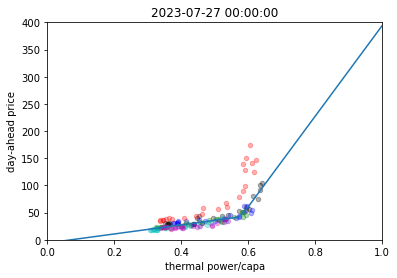

[0.57785232] [83.22211365179884, 833.2188637741242]
model acc: 228.94247972041873 2023-07-27 00:00:00
model acc: 97.73849110057975 2023-07-26 00:00:00
search 1 days for 3 part


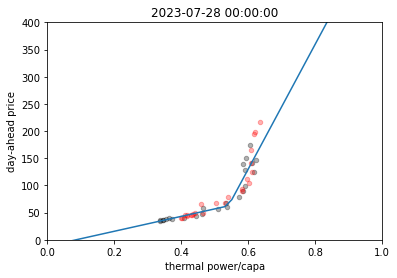

[0.54111776] [137.1802636673557, 1147.9830882709077]
model acc: 183.45208761981894 2023-07-28 00:00:00
model acc: 228.94247958128398 2023-07-27 00:00:00
model acc: 97.73849055285152 2023-07-26 00:00:00
search 2 days for 3 part


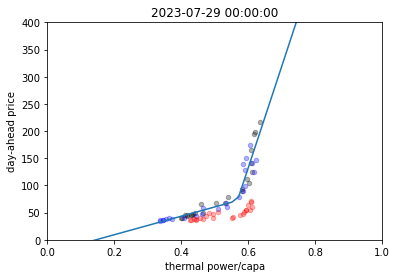

[0.56769916] [170.3602791121099, 1865.71386481338]
model acc: 77.9417646360773 2023-07-29 00:00:00
model acc: 183.45209032530946 2023-07-28 00:00:00
search 1 days for 3 part


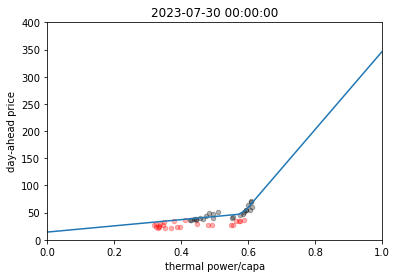

[0.58321964] [57.2453683319728, 716.9592726234093]
model acc: 72.5895067627203 2023-07-30 00:00:00
model acc: 77.9417652711831 2023-07-29 00:00:00
model acc: 183.4520903998722 2023-07-28 00:00:00
search 2 days for 3 part


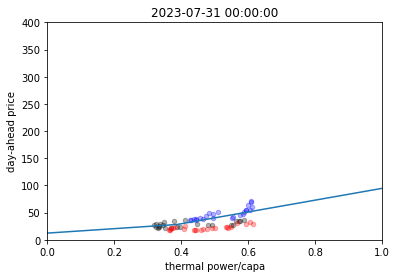

[0.38748724] [40.89496914672377, 108.56254813849095]
model acc: 41.48049803070376 2023-07-31 00:00:00
model acc: 72.57650428855035 2023-07-30 00:00:00
model acc: 77.94176463703262 2023-07-29 00:00:00
search 2 days for 3 part


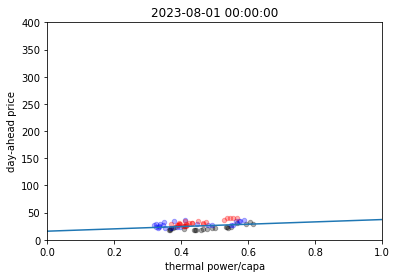

[0.46804438] [-32.73368313249556, 87.61409132882078]
model acc: 42.85941890940697 2023-08-01 00:00:00
model acc: 41.48049801968583 2023-07-31 00:00:00
model acc: 72.57625712200985 2023-07-30 00:00:00
model acc: 77.94176463694014 2023-07-29 00:00:00
model acc: 183.45208761973586 2023-07-28 00:00:00
search 4 days for 3 part


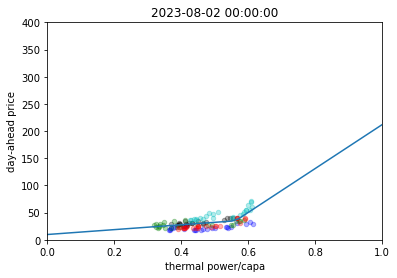

[0.56199085] [44.832320506651136, 403.9449319566556]
model acc: 34.9664800228115 2023-08-02 00:00:00
model acc: 42.85941933766401 2023-08-01 00:00:00
model acc: 41.48050492588821 2023-07-31 00:00:00
model acc: 72.57652094208746 2023-07-30 00:00:00
model acc: 77.94176531215231 2023-07-29 00:00:00


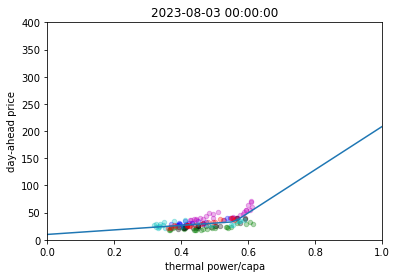

[0.5589829] [41.706985330022626, 397.3657150067031]
model acc: 25.64855981471018 2023-08-03 00:00:00
model acc: 34.96648013754624 2023-08-02 00:00:00
model acc: 42.85940872806987 2023-08-01 00:00:00
model acc: 41.4804980279993 2023-07-31 00:00:00
model acc: 72.57696688890292 2023-07-30 00:00:00


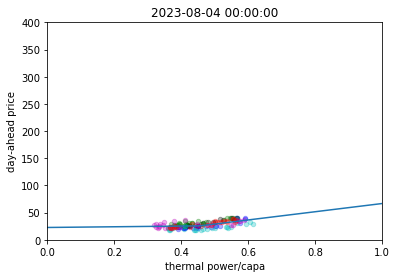

[0.45553832] [6.462046428948108, 75.50026128045555]
model acc: 34.49978652300355 2023-08-04 00:00:00
model acc: 25.648559618756092 2023-08-03 00:00:00
model acc: 34.96649961547166 2023-08-02 00:00:00
model acc: 42.859418690081945 2023-08-01 00:00:00
model acc: 41.48049804719503 2023-07-31 00:00:00


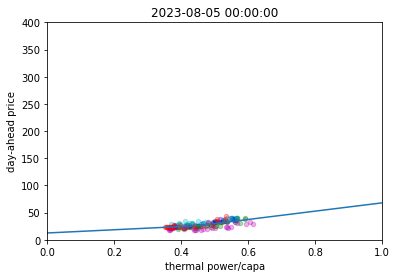

[0.44860893] [29.6335736972697, 76.40400810588612]
model acc: 31.952952508233714 2023-08-05 00:00:00
model acc: 34.499786512325834 2023-08-04 00:00:00
model acc: 25.64855981471017 2023-08-03 00:00:00
model acc: 34.96648014498345 2023-08-02 00:00:00
model acc: 42.85941883400865 2023-08-01 00:00:00


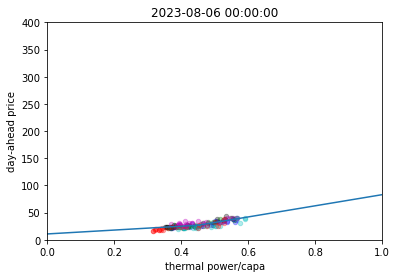

[0.45135476] [35.5979502857684, 102.36202244286679]
model acc: 34.262292039025986 2023-08-06 00:00:00
model acc: 31.95295184478904 2023-08-05 00:00:00
model acc: 34.499786515944464 2023-08-04 00:00:00
model acc: 25.648559775435707 2023-08-03 00:00:00
model acc: 34.96648013754509 2023-08-02 00:00:00


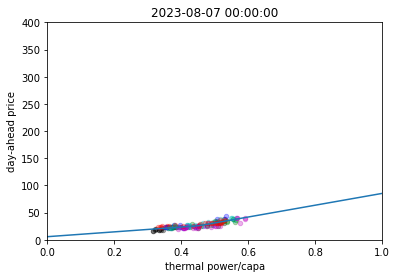

[0.45135475] [44.406591788671754, 108.61826349676883]
model acc: 25.13628879803142 2023-08-07 00:00:00
model acc: 34.262300706760044 2023-08-06 00:00:00
model acc: 31.952952494601256 2023-08-05 00:00:00
model acc: 34.49978651772993 2023-08-04 00:00:00
model acc: 25.648455339961995 2023-08-03 00:00:00


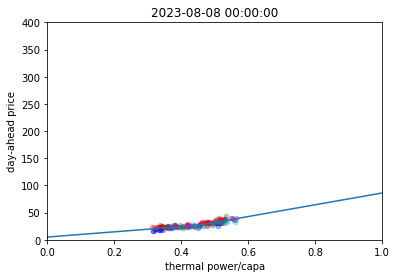

[0.45194344] [47.98963925801243, 108.29308137347145]
model acc: 27.204057674340444 2023-08-08 00:00:00
model acc: 25.136288125128953 2023-08-07 00:00:00
model acc: 34.26217313004476 2023-08-06 00:00:00
model acc: 31.952952508779777 2023-08-05 00:00:00
model acc: 34.499786517823196 2023-08-04 00:00:00


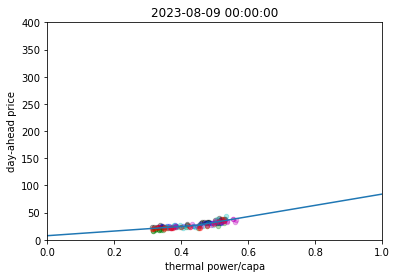

[0.44419715] [42.546213418774954, 103.689297404227]
model acc: 24.729609640719 2023-08-09 00:00:00
model acc: 27.20405767119047 2023-08-08 00:00:00
model acc: 25.136288109806678 2023-08-07 00:00:00
model acc: 34.26452430758892 2023-08-06 00:00:00
model acc: 31.952973959703147 2023-08-05 00:00:00


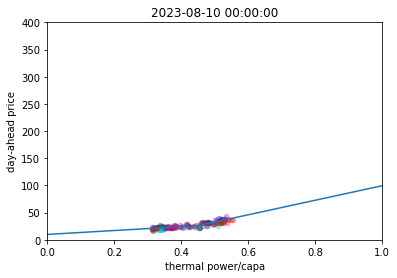

[0.45084922] [35.981199962346466, 133.5944441492127]
model acc: 31.0257355925296 2023-08-10 00:00:00
model acc: 24.729609168073473 2023-08-09 00:00:00
model acc: 27.204057664324484 2023-08-08 00:00:00
model acc: 25.136217585662617 2023-08-07 00:00:00
model acc: 34.26229981456934 2023-08-06 00:00:00


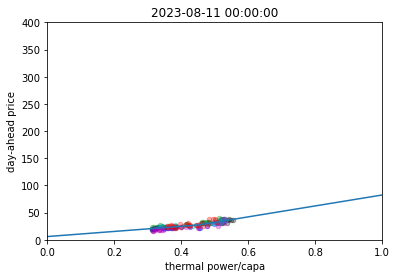

[0.45084922] [47.094398400168906, 100.5494367232859]
model acc: 49.579475153063974 2023-08-11 00:00:00
model acc: 31.025735465207163 2023-08-10 00:00:00
model acc: 24.729609067435344 2023-08-09 00:00:00
model acc: 27.204057674441817 2023-08-08 00:00:00
model acc: 25.136325703933107 2023-08-07 00:00:00


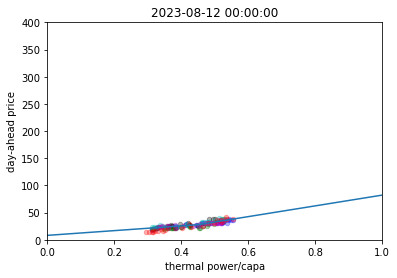

[0.44983109] [43.578276142153456, 98.94140510110822]
model acc: 39.727978947092 2023-08-12 00:00:00
model acc: 49.57947511852357 2023-08-11 00:00:00
model acc: 31.025735472699914 2023-08-10 00:00:00
model acc: 24.72960913144072 2023-08-09 00:00:00
model acc: 27.204057864798894 2023-08-08 00:00:00


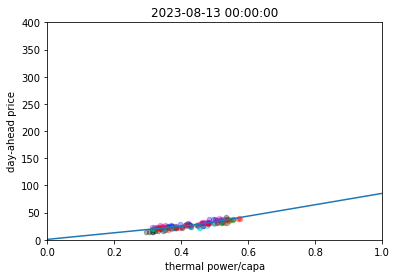

[0.45325977] [60.72900387468899, 104.44945729998737]
model acc: 33.312385878560235 2023-08-13 00:00:00
model acc: 39.727978947091984 2023-08-12 00:00:00
model acc: 49.57947522646688 2023-08-11 00:00:00
model acc: 31.025735468687152 2023-08-10 00:00:00
model acc: 24.729406371806423 2023-08-09 00:00:00


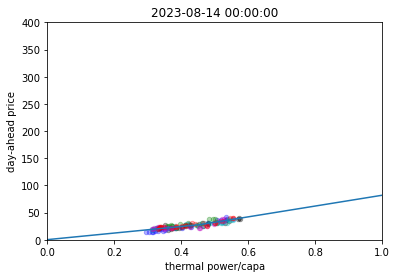

[0.45606828] [60.51388871707588, 99.37539057725377]
model acc: 31.854847661027996 2023-08-14 00:00:00
model acc: 33.31262621762592 2023-08-13 00:00:00
model acc: 39.727978920670516 2023-08-12 00:00:00
model acc: 49.57947511459467 2023-08-11 00:00:00
model acc: 31.02573516817534 2023-08-10 00:00:00


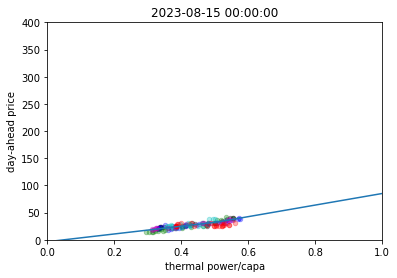

[0.50638983] [71.38463839200499, 106.4889659560077]
model acc: 35.8406310672416 2023-08-15 00:00:00
model acc: 31.85487696228483 2023-08-14 00:00:00
model acc: 33.31238601531049 2023-08-13 00:00:00
model acc: 39.727978947091984 2023-08-12 00:00:00
model acc: 49.5794751768271 2023-08-11 00:00:00


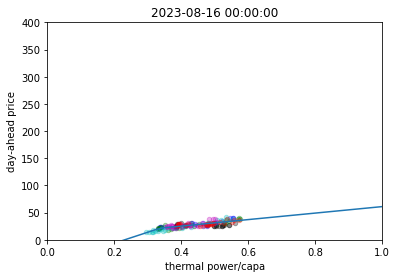

[0.33760535] [202.1657850109938, 59.68570308207358]
model acc: 28.898850866540265 2023-08-16 00:00:00
model acc: 35.84066271148464 2023-08-15 00:00:00
model acc: 31.854876960837352 2023-08-14 00:00:00
model acc: 33.31238601791037 2023-08-13 00:00:00
model acc: 39.727978947092 2023-08-12 00:00:00


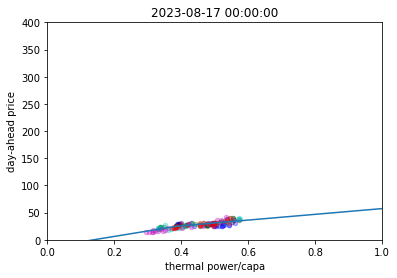

[0.38827637] [100.39561523942912, 52.7903162175475]
model acc: 37.73953852932716 2023-08-17 00:00:00
model acc: 28.898850863924604 2023-08-16 00:00:00
model acc: 35.84063117774339 2023-08-15 00:00:00
model acc: 31.854876979581377 2023-08-14 00:00:00
model acc: 33.31238594482181 2023-08-13 00:00:00


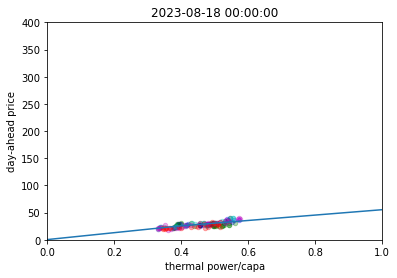

[0.38942351] [63.511215682746816, 49.51738068316683]
model acc: 40.067289436562 2023-08-18 00:00:00
model acc: 37.739512832121626 2023-08-17 00:00:00
model acc: 28.898850861211596 2023-08-16 00:00:00
model acc: 35.84079855039583 2023-08-15 00:00:00
model acc: 31.85487697338085 2023-08-14 00:00:00


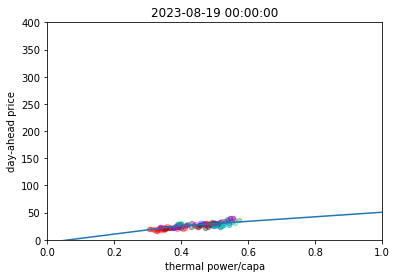

[0.3893335] [77.9645332994246, 41.64939009149326]
model acc: 40.03472120149564 2023-08-19 00:00:00
model acc: 40.06728949200036 2023-08-18 00:00:00
model acc: 37.7395386024043 2023-08-17 00:00:00
model acc: 28.89885086319542 2023-08-16 00:00:00
model acc: 35.840631169324936 2023-08-15 00:00:00


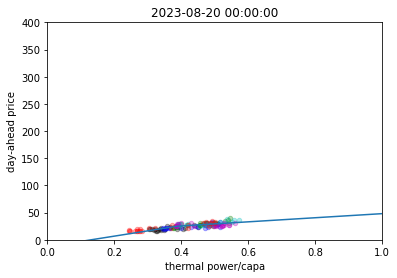

[0.38942038] [97.2029837066528, 37.61107245609471]
model acc: 45.9736671662621 2023-08-20 00:00:00
model acc: 40.02988913902816 2023-08-19 00:00:00
model acc: 40.067289438690835 2023-08-18 00:00:00
model acc: 37.73953850997505 2023-08-17 00:00:00
model acc: 28.89885086436887 2023-08-16 00:00:00


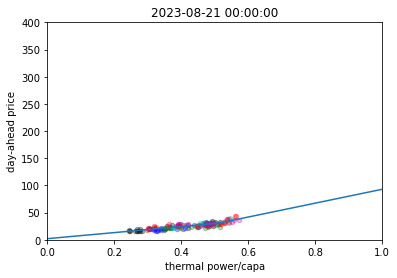

[0.51210558] [55.75562105733809, 127.62114528134066]
model acc: 40.44072629301141 2023-08-21 00:00:00
model acc: 45.97366662334173 2023-08-20 00:00:00
model acc: 40.030096418065156 2023-08-19 00:00:00
model acc: 40.06972461378311 2023-08-18 00:00:00
model acc: 37.7395385871244 2023-08-17 00:00:00


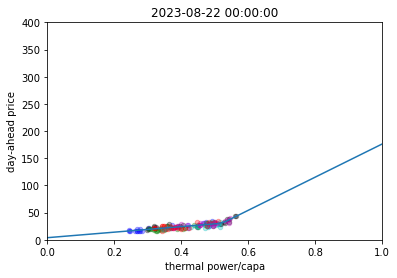

[0.52198824] [50.85811390266752, 305.0075729273135]
model acc: 48.68720150665817 2023-08-22 00:00:00
model acc: 40.44072629344964 2023-08-21 00:00:00
model acc: 45.97366680394252 2023-08-20 00:00:00
model acc: 40.029865359240915 2023-08-19 00:00:00
model acc: 36.571594719510315 2023-08-18 00:00:00


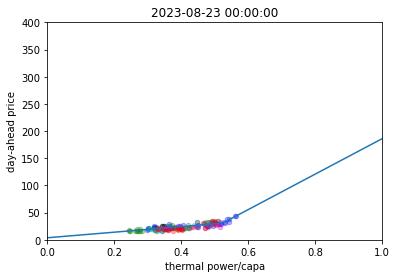

[0.52347407] [51.3187983853227, 326.13660607165446]
model acc: 43.91134219175353 2023-08-23 00:00:00
model acc: 48.68719989178669 2023-08-22 00:00:00
model acc: 40.44072629286552 2023-08-21 00:00:00
model acc: 45.973695439092886 2023-08-20 00:00:00
model acc: 40.037241826529865 2023-08-19 00:00:00


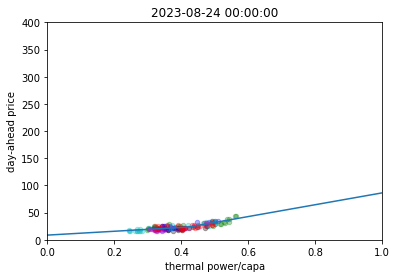

[0.42507839] [35.42135325700774, 108.96124128579002]
model acc: 48.75951140577318 2023-08-24 00:00:00
model acc: 43.91114144333059 2023-08-23 00:00:00
model acc: 48.687201351212416 2023-08-22 00:00:00
model acc: 40.44072556939115 2023-08-21 00:00:00
model acc: 45.973666726166385 2023-08-20 00:00:00


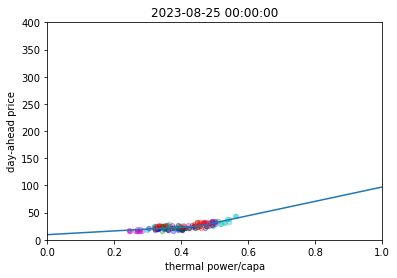

[0.45288829] [34.370121967494924, 131.75229838773967]
model acc: 52.386989847938615 2023-08-25 00:00:00
model acc: 48.75951139496804 2023-08-24 00:00:00
model acc: 43.910782084361855 2023-08-23 00:00:00
model acc: 48.68701433324329 2023-08-22 00:00:00
model acc: 40.440725956653864 2023-08-21 00:00:00


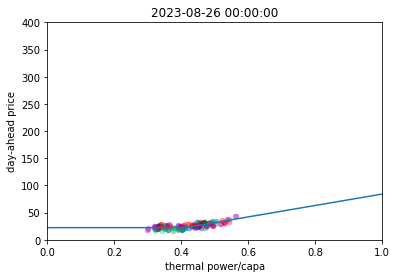

[0.4120906] [0.1951702398606281, 105.02508789705445]
model acc: 44.77354564864856 2023-08-26 00:00:00
model acc: 52.386989855583316 2023-08-25 00:00:00
model acc: 48.75951500885732 2023-08-24 00:00:00
model acc: 43.911121229731364 2023-08-23 00:00:00
model acc: 48.68720155498371 2023-08-22 00:00:00


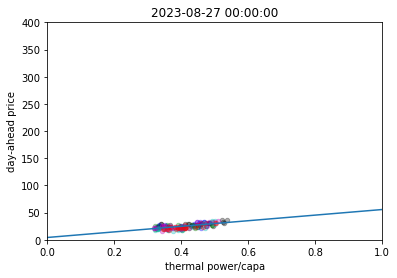

[0.40061205] [-7.570245960703273, 94.1705884864549]
model acc: 33.05176630165939 2023-08-27 00:00:00
model acc: 44.773545451717396 2023-08-26 00:00:00
model acc: 52.3869898577903 2023-08-25 00:00:00
model acc: 48.75951129632271 2023-08-24 00:00:00
model acc: 43.910782175379886 2023-08-23 00:00:00


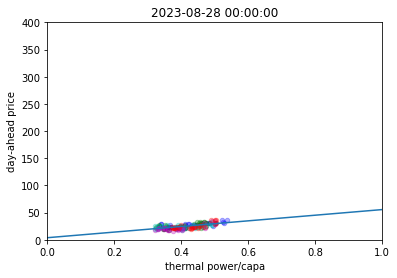

[0.39019151] [-19.125622116620594, 86.16499027072418]
model acc: 34.63243017324685 2023-08-28 00:00:00
model acc: 33.0517663704871 2023-08-27 00:00:00
model acc: 44.773255365500006 2023-08-26 00:00:00
model acc: 52.38698989162035 2023-08-25 00:00:00
model acc: 48.7595113914538 2023-08-24 00:00:00


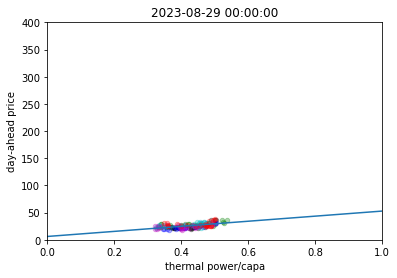

[0.41607699] [-5.979212599668954, 98.55408984625801]
model acc: 41.31841937362633 2023-08-29 00:00:00
model acc: 34.63242977097991 2023-08-28 00:00:00
model acc: 33.051766889208935 2023-08-27 00:00:00
model acc: 44.773545330929856 2023-08-26 00:00:00
model acc: 52.3869939001228 2023-08-25 00:00:00


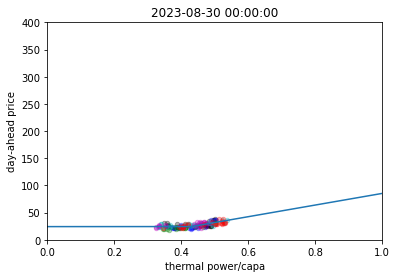

[0.43065928] [0.26224855595442564, 107.06616898119725]
model acc: 54.62732640569493 2023-08-30 00:00:00
model acc: 41.31846081413452 2023-08-29 00:00:00
model acc: 34.63243017308484 2023-08-28 00:00:00
model acc: 33.05176627733664 2023-08-27 00:00:00
model acc: 44.773545694365154 2023-08-26 00:00:00


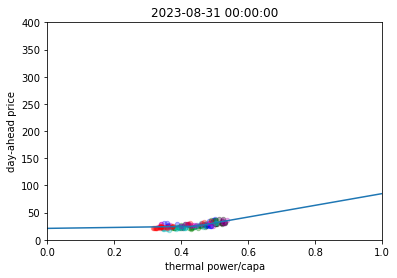

[0.44165194] [8.559153891370569, 107.76875260402763]
model acc: 17.717356104491596 2023-08-31 00:00:00
model acc: 54.62732640518148 2023-08-30 00:00:00
model acc: 41.31841949676752 2023-08-29 00:00:00
model acc: 34.63242976921822 2023-08-28 00:00:00
model acc: 33.05176631116744 2023-08-27 00:00:00


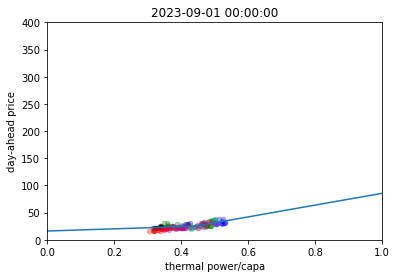

[0.44165086] [19.897568152972433, 108.46084363094187]
model acc: 32.3375557571628 2023-09-01 00:00:00
model acc: 17.717356104469122 2023-08-31 00:00:00
model acc: 54.62736927045377 2023-08-30 00:00:00
model acc: 41.31841835183316 2023-08-29 00:00:00
model acc: 34.63243017354781 2023-08-28 00:00:00


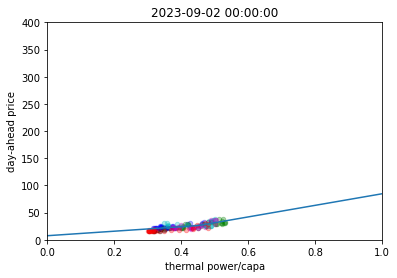

[0.45100841] [41.44076580214585, 106.5568226635761]
model acc: 26.207970636251282 2023-09-02 00:00:00
model acc: 32.337555997959846 2023-09-01 00:00:00
model acc: 17.717520765119698 2023-08-31 00:00:00
model acc: 54.62732640552376 2023-08-30 00:00:00
model acc: 41.318418759363894 2023-08-29 00:00:00


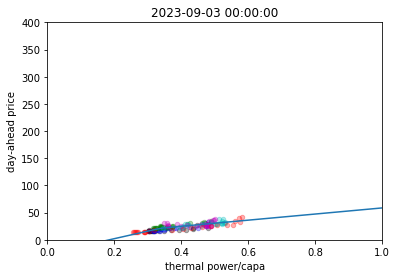

[0.34022171] [138.7468030267637, 56.25095649200258]
model acc: 23.556585082587606 2023-09-03 00:00:00
model acc: 26.207969964171085 2023-09-02 00:00:00
model acc: 32.33755596602682 2023-09-01 00:00:00
model acc: 17.717356111517397 2023-08-31 00:00:00
model acc: 54.62732640510307 2023-08-30 00:00:00


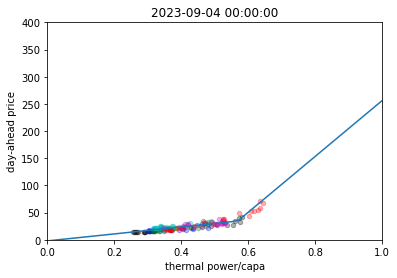

[0.568636] [64.19475022230253, 513.7415638476176]
model acc: 52.60168566135043 2023-09-04 00:00:00
model acc: 23.556584733411643 2023-09-03 00:00:00
model acc: 26.20797001192442 2023-09-02 00:00:00
model acc: 32.33755599795986 2023-09-01 00:00:00
model acc: 17.71735611158157 2023-08-31 00:00:00


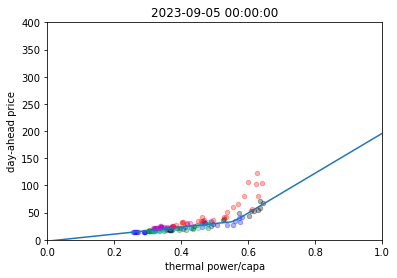

[0.55696487] [64.68005341456764, 366.1810606150369]
model acc: 145.92146334789504 2023-09-05 00:00:00
model acc: 52.60213728275207 2023-09-04 00:00:00
model acc: 23.55658511235977 2023-09-03 00:00:00
model acc: 26.20797052528117 2023-09-02 00:00:00
model acc: 32.33761693457717 2023-09-01 00:00:00


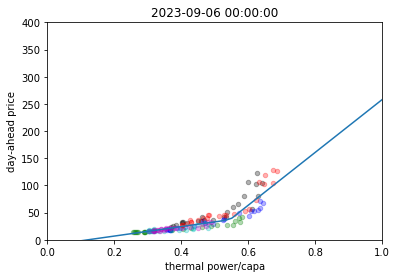

[0.5451455] [87.06957312945558, 485.8798689428979]
model acc: 108.57946600682186 2023-09-06 00:00:00
model acc: 145.92146307927874 2023-09-05 00:00:00
model acc: 52.602137280895874 2023-09-04 00:00:00
model acc: 23.55658473724177 2023-09-03 00:00:00
model acc: 26.20796997255268 2023-09-02 00:00:00


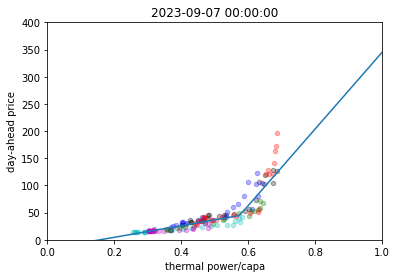

[0.57420569] [107.0042107395381, 705.3345031169148]
model acc: 131.2897051241229 2023-09-07 00:00:00
model acc: 108.57946642592822 2023-09-06 00:00:00
model acc: 145.92146415916406 2023-09-05 00:00:00
model acc: 52.60206191770513 2023-09-04 00:00:00
model acc: 23.55658479749541 2023-09-03 00:00:00


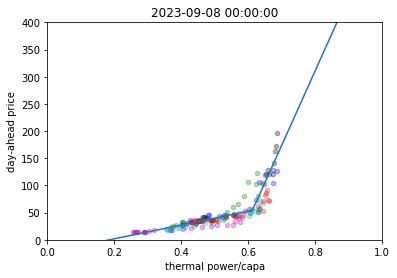

[0.61282245] [127.00672475185378, 1370.5151268465058]
model acc: 86.5214673321517 2023-09-08 00:00:00
model acc: 131.28913832479464 2023-09-07 00:00:00
model acc: 108.57946621541282 2023-09-06 00:00:00
model acc: 145.92146294233783 2023-09-05 00:00:00
model acc: 52.601834236063695 2023-09-04 00:00:00


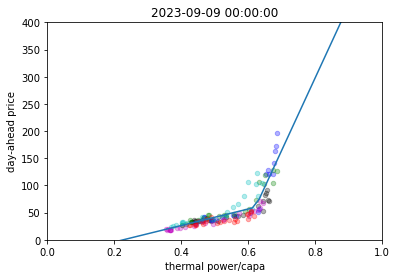

[0.62159658] [151.73314896916597, 1333.9791753331804]
model acc: 76.53937472232387 2023-09-09 00:00:00
model acc: 86.5214689097907 2023-09-08 00:00:00
model acc: 131.2897052152607 2023-09-07 00:00:00
model acc: 108.5794678441581 2023-09-06 00:00:00
model acc: 145.92146479690282 2023-09-05 00:00:00


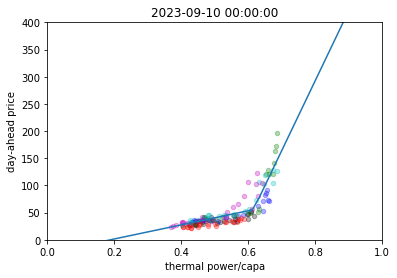

[0.61564995] [129.8568725984616, 1285.5123649673205]
model acc: 46.12801421146292 2023-09-10 00:00:00
model acc: 76.54402137570136 2023-09-09 00:00:00
model acc: 86.52146841814525 2023-09-08 00:00:00
model acc: 131.28970516352894 2023-09-07 00:00:00
model acc: 108.58225063574449 2023-09-06 00:00:00


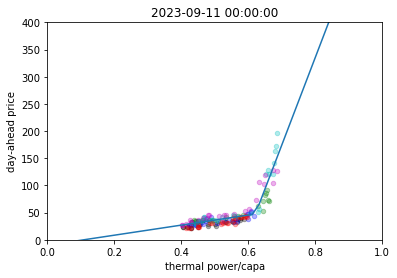

[0.62156172] [92.6721404820758, 1610.314567622075]
model acc: 43.884702689006104 2023-09-11 00:00:00
model acc: 46.12801423964643 2023-09-10 00:00:00
model acc: 76.5393751178184 2023-09-09 00:00:00
model acc: 86.52146889468128 2023-09-08 00:00:00
model acc: 131.28970512035687 2023-09-07 00:00:00


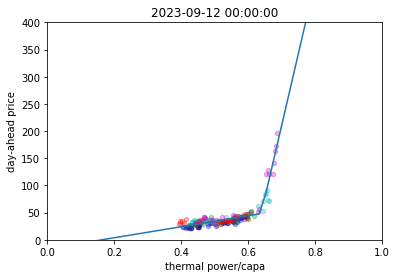

[0.63873775] [101.27674328032107, 2649.1052447835696]
model acc: 54.64630737579073 2023-09-12 00:00:00
model acc: 43.884702894069136 2023-09-11 00:00:00
model acc: 46.12801417179587 2023-09-10 00:00:00
model acc: 76.53937515398685 2023-09-09 00:00:00
model acc: 86.52164751717886 2023-09-08 00:00:00


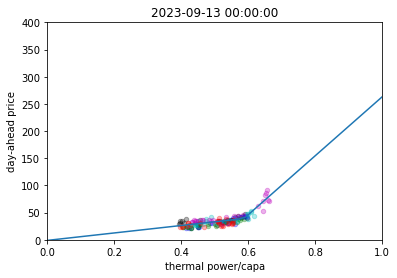

[0.58715454] [68.47797631295641, 542.2143872711058]
model acc: 73.81567301148498 2023-09-13 00:00:00
model acc: 54.64504958963676 2023-09-12 00:00:00
model acc: 43.884702972678014 2023-09-11 00:00:00
model acc: 46.128043499289994 2023-09-10 00:00:00
model acc: 76.53973401587749 2023-09-09 00:00:00


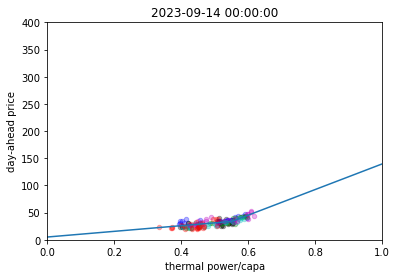

[0.55162267] [52.20908587087705, 235.67040590019266]
model acc: 75.27732625200966 2023-09-14 00:00:00
model acc: 73.81750674663317 2023-09-13 00:00:00
model acc: 54.64504963023863 2023-09-12 00:00:00
model acc: 43.8847026437889 2023-09-11 00:00:00
model acc: 46.12812418749162 2023-09-10 00:00:00


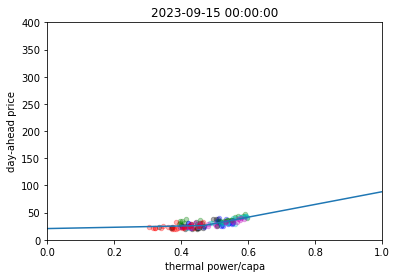

[0.46821493] [11.983037656849946, 116.96021645193133]
model acc: 47.87538879865005 2023-09-15 00:00:00
model acc: 75.27732618646594 2023-09-14 00:00:00
model acc: 73.81703628643412 2023-09-13 00:00:00
model acc: 54.645049463604245 2023-09-12 00:00:00
model acc: 43.884702697626636 2023-09-11 00:00:00


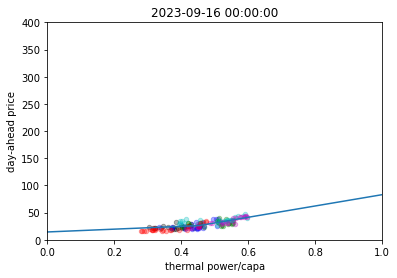

[0.4524814] [25.801557476366522, 103.95628154647166]
model acc: 36.48924957466404 2023-09-16 00:00:00
model acc: 47.875388858859665 2023-09-15 00:00:00
model acc: 75.27758551345751 2023-09-14 00:00:00
model acc: 73.81750709744274 2023-09-13 00:00:00
model acc: 54.64504947333451 2023-09-12 00:00:00


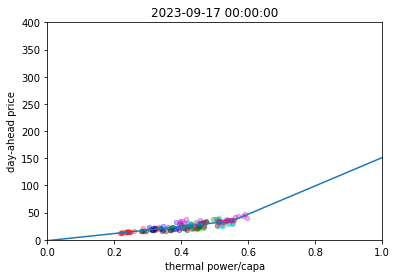

[0.55162267] [65.31131055398723, 260.34552117323835]
model acc: 25.126157104119088 2023-09-17 00:00:00
model acc: 36.48924972700373 2023-09-16 00:00:00
model acc: 47.87538983488188 2023-09-15 00:00:00
model acc: 75.2773258171653 2023-09-14 00:00:00
model acc: 73.81750718477596 2023-09-13 00:00:00


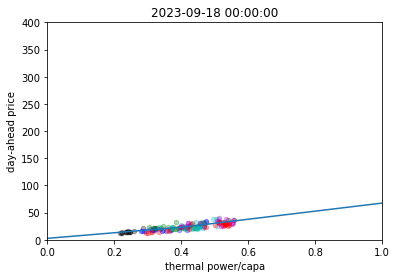

[0.41300621] [51.501632435975424, 74.34648249785955]
model acc: 36.602041043886175 2023-09-18 00:00:00
model acc: 25.12616425738198 2023-09-17 00:00:00
model acc: 36.48924581963195 2023-09-16 00:00:00
model acc: 47.875388877895574 2023-09-15 00:00:00
model acc: 75.27732628809088 2023-09-14 00:00:00


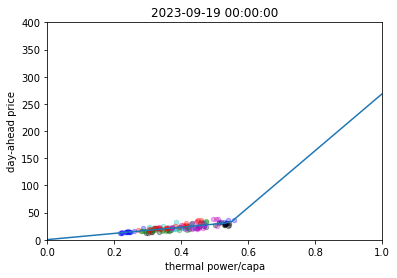

[0.54673074] [57.00552655403316, 522.987406121684]
model acc: 26.95790472919083 2023-09-19 00:00:00
model acc: 36.60216322313611 2023-09-18 00:00:00
model acc: 25.126157093163755 2023-09-17 00:00:00
model acc: 36.48924953159276 2023-09-16 00:00:00
model acc: 47.87538977557594 2023-09-15 00:00:00


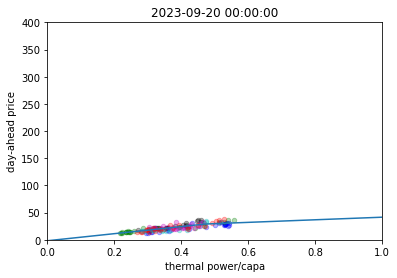

[0.47275879] [65.17302870328338, 23.74745923207127]
model acc: 40.04279000921438 2023-09-20 00:00:00
model acc: 26.9579048792745 2023-09-19 00:00:00
model acc: 36.60223981791684 2023-09-18 00:00:00
model acc: 25.126157041734455 2023-09-17 00:00:00
model acc: 36.48924956518273 2023-09-16 00:00:00


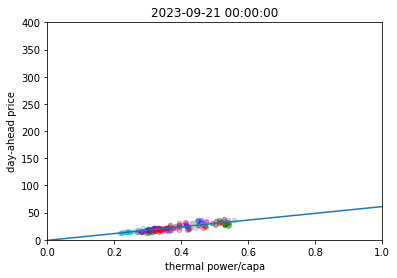

[0.50843948] [67.13682490096153, -16.875319999766624]
model acc: 51.241974361596284 2023-09-21 00:00:00
model acc: 40.04267767194152 2023-09-20 00:00:00
model acc: 26.95790501251292 2023-09-19 00:00:00
model acc: 36.602041139720704 2023-09-18 00:00:00
model acc: 25.126164376402492 2023-09-17 00:00:00


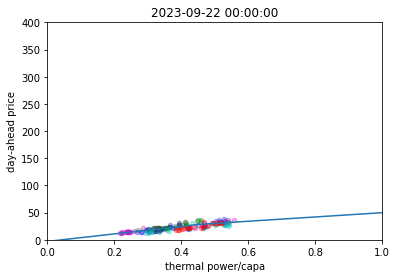

[0.45063512] [69.35349814425871, 39.42385033467956]
model acc: 26.463979676865954 2023-09-22 00:00:00
model acc: 51.24197443001795 2023-09-21 00:00:00
model acc: 40.042803120182946 2023-09-20 00:00:00
model acc: 26.958805828157914 2023-09-19 00:00:00
model acc: 36.602041052494116 2023-09-18 00:00:00


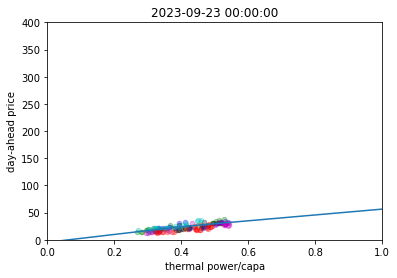

[0.4] [71.99200536134478, 53.701003502073924]
model acc: 43.55194991404911 2023-09-23 00:00:00
model acc: 26.464049540774802 2023-09-22 00:00:00
model acc: 51.24197436948938 2023-09-21 00:00:00
model acc: 40.042834540883725 2023-09-20 00:00:00
model acc: 26.958213895764 2023-09-19 00:00:00


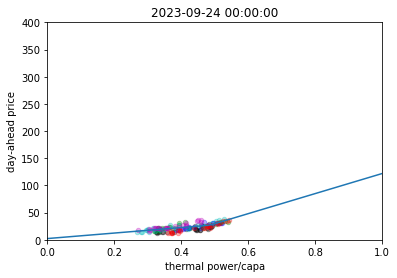

[0.48465233] [50.67882975486354, 184.50588489229202]
model acc: 27.500244572103973 2023-09-24 00:00:00
model acc: 43.55203090266173 2023-09-23 00:00:00
model acc: 26.464286400199082 2023-09-22 00:00:00
model acc: 51.24197455649632 2023-09-21 00:00:00
model acc: 40.0427325646129 2023-09-20 00:00:00


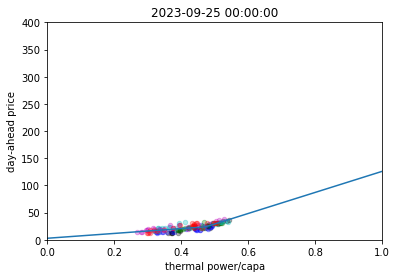

[0.47338167] [44.46089617874478, 193.76977238913176]
model acc: 52.78734093091941 2023-09-25 00:00:00
model acc: 27.500244543893118 2023-09-24 00:00:00
model acc: 43.55186482177954 2023-09-23 00:00:00
model acc: 26.465056197070865 2023-09-22 00:00:00
model acc: 51.24197441682696 2023-09-21 00:00:00


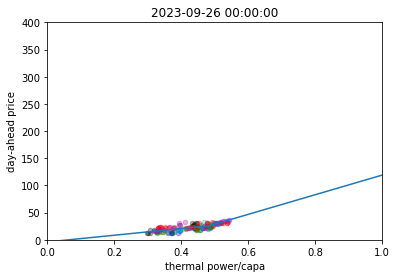

[0.48465483] [61.7848932248156, 180.52045043008278]
model acc: 38.2713342378539 2023-09-26 00:00:00
model acc: 52.787341016732434 2023-09-25 00:00:00
model acc: 27.500263127758803 2023-09-24 00:00:00
model acc: 43.55194991406272 2023-09-23 00:00:00
model acc: 26.464263671269425 2023-09-22 00:00:00


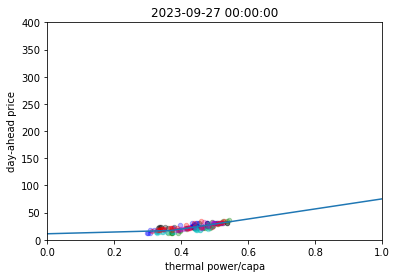

[0.37092963] [16.141980142638083, 92.55639803708405]
model acc: 43.219974384165766 2023-09-27 00:00:00
model acc: 38.27133439185416 2023-09-26 00:00:00
model acc: 52.788134653431 2023-09-25 00:00:00
model acc: 27.50049526721044 2023-09-24 00:00:00
model acc: 43.552568616422306 2023-09-23 00:00:00


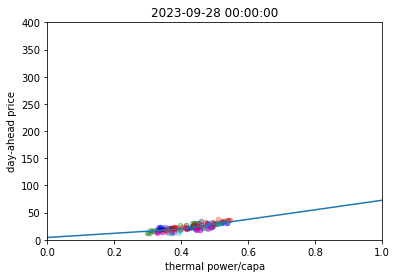

[0.39071418] [38.7104318584946, 87.61797230102135]
model acc: 30.75209028444418 2023-09-28 00:00:00
model acc: 43.21997389901862 2023-09-27 00:00:00
model acc: 38.2713342159611 2023-09-26 00:00:00
model acc: 52.787341032198114 2023-09-25 00:00:00
model acc: 27.50024456071661 2023-09-24 00:00:00


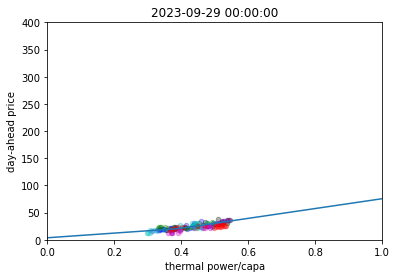

[0.39084016] [42.96061144116746, 90.39036691976787]


In [22]:
linear = []
# roll = []
pd.set_option('mode.chained_assignment', None)
for _ in pd.date_range(pd.to_datetime('2023/1/1'),pd.to_datetime('2023/9/30')):
    # print(_)
    y_pred_by_linear = np.array(predict_with_predpower_predcapa(_))
    # y_pred_by_roll = np.array(pred_by_roll(_))
    y_truth = np.array(get_price_data(_)['Locational Marginal Price'])
    if (not np.isnan(y_truth).all()) and (not np.isnan(y_pred_by_linear).all()):
        linear.append([_, y_pred_by_linear])
        # roll.append([_, y_pred_by_roll])
df_pred_by_linear = pd.DataFrame(linear)
# df_pred_by_roll = pd.DataFrame(roll)

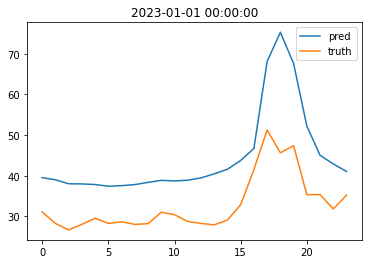

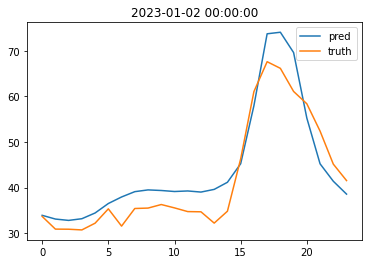

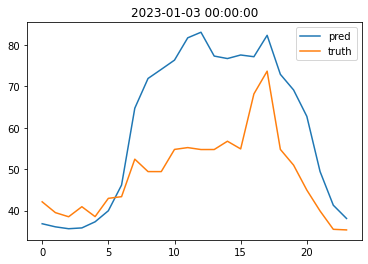

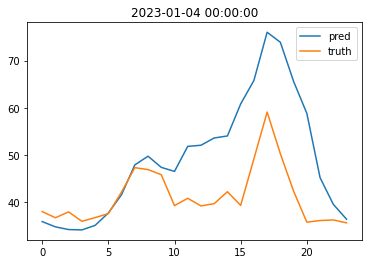

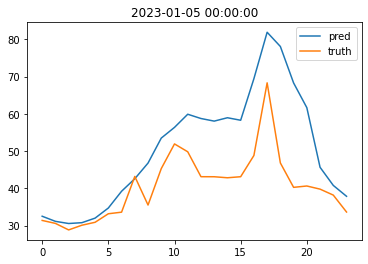

...

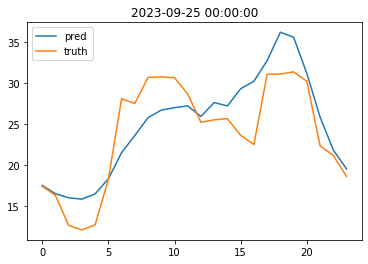

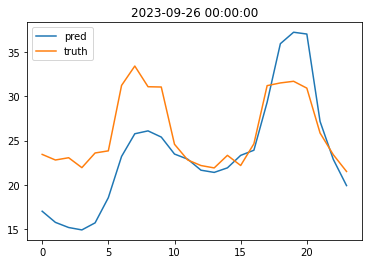

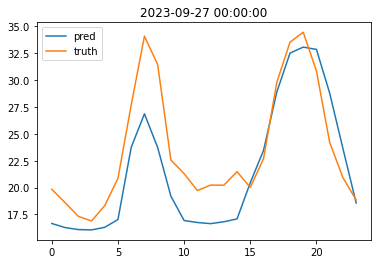

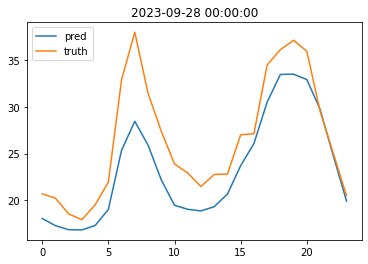

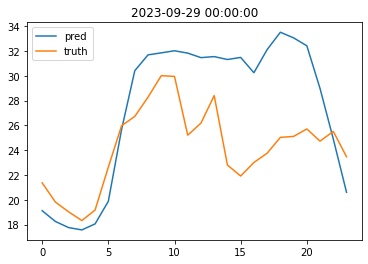

In [23]:
def get_linear_pred(tgt_day):
    df_1 = np.array(df_pred_by_linear[df_pred_by_linear.iloc[:, 0] == tgt_day].reset_index(drop=True))
    if df_1.size != 0:
        return df_1[0,1]
    else:
        return []

def calculate_loss():
    loss_record = []

    for _ in pd.date_range(pd.to_datetime('2023/1/1'),pd.to_datetime('2023/9/30')):
#         if _.weekday() != 0 and _.weekday() != 6:
        y_truth = get_price_data(_)['Locational Marginal Price']

        # y_pred = get_linear_pred(_)
        y_pred = get_linear_pred(_)
        # print(y_pred, y_truth)

        if (not np.isnan(y_truth).all()) and (not np.isnan(y_pred).all()) and not (y_pred == 0).all():
    
    #             print(y_pred, y_truth)
    #             print(y_pred_by_linear)

            plt.plot(y_pred, label='pred')

            plt.plot(y_truth, label='truth')
            plt.legend()
            plt.title(_)
            mse, rmse, mae, smape = loss(y_truth, y_pred)


            loss_record.append([_, mae, smape])
            plt.show()
    df_loss = pd.DataFrame(loss_record)
    # print(df_loss)
    df_loss.columns = ['date', 'mae', 'smape']
    return df_loss

df_loss = calculate_loss()


In [29]:
path = r'E:\day-ahead price\Code\Time-Series-Library-main\Results\iso others'
os.chdir(path)
df_pred_by_linear.to_csv('my_pred.csv', index=False)

In [24]:
# df_loss = df_loss[df_loss['mae'] != 0]
pd.DataFrame([df_loss['mae'].mean(), df_loss['smape'].mean()])

,0
0,7.883256
1,0.173042


In [9]:
# load other prediction
df_pred_by_arima = pd.read_csv('E:\day-ahead price\Code\Time-Series-Library-main\Results\iso others/arima_pred.csv')
df_pred_by_lstm = pd.read_csv('E:\day-ahead price\Code\Time-Series-Library-main\Results\iso others/lstm_pred.csv')
df_pred_by_svm = pd.read_csv('E:\day-ahead price\Code\Time-Series-Library-main\Results\iso others/svm_pred.csv')
df_pred_by_my = pd.read_csv('E:\day-ahead price\Code\Time-Series-Library-main\Results\iso others/my_pred.csv')
df_pred_by_xgb = pd.read_csv('E:\day-ahead price\Code\Time-Series-Library-main\Results\iso others/xgb_pred.csv')
df_pred_by_rf = pd.read_csv('E:\day-ahead price\Code\Time-Series-Library-main\Results\iso others/rf_pred.csv')
df_pred_by_linear = pd.read_csv('E:\day-ahead price\Code\Time-Series-Library-main\Results\iso others/linear_pred.csv')
df_pred_by_arima['Date'] = pd.to_datetime(df_pred_by_arima['Date'])
df_pred_by_lstm['Date'] = pd.to_datetime(df_pred_by_lstm['Date'])
df_pred_by_svm['Date'] = pd.to_datetime(df_pred_by_svm['Date'])
df_pred_by_my['Date'] = pd.to_datetime(df_pred_by_my['Date'])
df_pred_by_xgb['Date'] = pd.to_datetime(df_pred_by_xgb['Date'])
df_pred_by_rf['Date'] = pd.to_datetime(df_pred_by_rf['Date'])
df_pred_by_linear['Date'] = pd.to_datetime(df_pred_by_linear['Date'])

In [8]:
path = r'E:\day-ahead price\Code\Time-Series-Library-main\Results\iso Koopa\results'
os.chdir(path)
files = os.listdir(path)
df_d1 = pd.DataFrame()

for file in files:
    # print(file)
    # find date in each file name
    index = file.find('2023-')
    date = file[index:index+10]
    # change directory to each file
    os.chdir(path + '\\' + file)
    # read each npy file
    data_pred = np.load('pred.npy', allow_pickle=True)
    data_true = np.load('true.npy', allow_pickle=True)
    # data_metric = np.load('metrics.npy', allow_pickle=True)
    # print(data_pred, data_true)
#     data_true_d2 = data_true.reshape(-1)[1]
    data_pred_d1 = data_pred.reshape(-1)
    data_true_d1 = data_true.reshape(-1)
    # print(data_true_d2, data_pred_d2)
    # calculate mae and smape
    
    # print(mae, smape)
    df_d1 = df_d1.append({'date': pd.to_datetime(date), 'pred': data_pred_d1, 'true': data_true_d1}, ignore_index=True)
df_pred_by_koopa = df_d1
path = r'E:\day-ahead price\Code\Time-Series-Library-main\Results\iso iTransformer\results'
os.chdir(path)
files = os.listdir(path)
df_d1 = pd.DataFrame()

for file in files:
    # print(file)
    # find date in each file name
    index = file.find('2023-')
    date = file[index:index+10]
    # change directory to each file
    os.chdir(path + '\\' + file)
    # read each npy file
    data_pred = np.load('pred.npy', allow_pickle=True)
    data_true = np.load('true.npy', allow_pickle=True)
    # data_metric = np.load('metrics.npy', allow_pickle=True)
    # print(data_pred, data_true)
#     data_true_d2 = data_true.reshape(-1)[1]
    data_pred_d1 = data_pred.reshape(-1)
    data_true_d1 = data_true.reshape(-1)
    # print(data_true_d2, data_pred_d2)
    # calculate mae and smape
    
    # print(mae, smape)
    df_d1 = df_d1.append({'date': pd.to_datetime(date), 'pred': data_pred_d1, 'true': data_true_d1}, ignore_index=True)
df_pred_by_itransformer = df_d1
path = r'E:\day-ahead price\Code\Time-Series-Library-main\Results\iso DLinear\results'
os.chdir(path)
files = os.listdir(path)
df_d1 = pd.DataFrame()

for file in files:
    # print(file)
    # find date in each file name
    index = file.find('2023-')
    date = file[index:index+10]
    # change directory to each file
    os.chdir(path + '\\' + file)
    # read each npy file
    data_pred = np.load('pred.npy', allow_pickle=True)
    data_true = np.load('true.npy', allow_pickle=True)
    # data_metric = np.load('metrics.npy', allow_pickle=True)
    # print(data_pred, data_true)
#     data_true_d2 = data_true.reshape(-1)[1]
    data_pred_d1 = data_pred.reshape(-1)
    data_true_d1 = data_true.reshape(-1)
    # print(data_true_d2, data_pred_d2)
    # calculate mae and smape
    
    # print(mae, smape)
    df_d1 = df_d1.append({'date': pd.to_datetime(date), 'pred': data_pred_d1, 'true': data_true_d1}, ignore_index=True)
df_pred_by_dlinear = df_d1
path = r'E:\day-ahead price\Code\Time-Series-Library-main\Results\iso DNN\results'
os.chdir(path)
files = os.listdir(path)
df_d1 = pd.DataFrame()

for file in files:
    # print(file)
    # find date in each file name
    index = file.find('2023-')
    date = file[index:index+10]
    # change directory to each file
    os.chdir(path + '\\' + file)
    # read each npy file
    data_pred = np.load('pred.npy', allow_pickle=True)
    data_true = np.load('true.npy', allow_pickle=True)
    # data_metric = np.load('metrics.npy', allow_pickle=True)
    # print(data_pred, data_true)
#     data_true_d2 = data_true.reshape(-1)[1]
    data_pred_d1 = data_pred.reshape(-1)
    data_true_d1 = data_true.reshape(-1)
    # print(data_true_d2, data_pred_d2)
    # calculate mae and smape
    
    # print(mae, smape)
    df_d1 = df_d1.append({'date': pd.to_datetime(date), 'pred': data_pred_d1, 'true': data_true_d1}, ignore_index=True)
df_pred_by_dnn = df_d1
path = r'E:\day-ahead price\Code\Time-Series-Library-main\Results\iso Timesnet\results'
os.chdir(path)
files = os.listdir(path)
df_d1 = pd.DataFrame()

for file in files:
    # print(file)
    # find date in each file name
    index = file.find('2023-')
    date = file[index:index+10]
    # change directory to each file
    os.chdir(path + '\\' + file)
    # read each npy file
    data_pred = np.load('pred.npy', allow_pickle=True)
    data_true = np.load('true.npy', allow_pickle=True)
    # data_metric = np.load('metrics.npy', allow_pickle=True)
    # print(data_pred, data_true)
#     data_true_d2 = data_true.reshape(-1)[1]
    data_pred_d1 = data_pred.reshape(-1)
    data_true_d1 = data_true.reshape(-1)
    # print(data_true_d2, data_pred_d2)
    # calculate mae and smape
    
    # print(mae, smape)
    df_d1 = df_d1.append({'date': pd.to_datetime(date), 'pred': data_pred_d1, 'true': data_true_d1}, ignore_index=True)
df_pred_by_timesnet = df_d1
path = r'E:\day-ahead price\Code\Time-Series-Library-main\Results\iso VMD_LSTM\results'
os.chdir(path)
files = os.listdir(path)
df_d1 = pd.DataFrame()

for file in files:
    # print(file)
    # find date in each file name
    index = file.find('2023-')
    date = file[index:index+10]
    # change directory to each file
    os.chdir(path + '\\' + file)
    # read each npy file
    data_pred = np.load('pred.npy', allow_pickle=True)
    data_true = np.load('true.npy', allow_pickle=True)
    # data_metric = np.load('metrics.npy', allow_pickle=True)
    # print(data_pred, data_true)
#     data_true_d2 = data_true.reshape(-1)[1]
    data_pred_d1 = data_pred.reshape(-1)
    data_true_d1 = data_true.reshape(-1)
    # print(data_true_d2, data_pred_d2)
    # calculate mae and smape
    
    # print(mae, smape)
    df_d1 = df_d1.append({'date': pd.to_datetime(date), 'pred': data_pred_d1, 'true': data_true_d1}, ignore_index=True)
df_pred_by_vmd_lstm = df_d1
path = r'E:\day-ahead price\Code\Time-Series-Library-main\Results\iso FEDformer\results'
os.chdir(path)
files = os.listdir(path)
df_d1 = pd.DataFrame()

for file in files:
    # print(file)
    # find date in each file name
    index = file.find('2023-')
    date = file[index:index+10]
    # change directory to each file
    os.chdir(path + '\\' + file)
    # read each npy file
    data_pred = np.load('pred.npy', allow_pickle=True)
    data_true = np.load('true.npy', allow_pickle=True)
    # data_metric = np.load('metrics.npy', allow_pickle=True)
    # print(data_pred, data_true)
#     data_true_d2 = data_true.reshape(-1)[1]
    data_pred_d1 = data_pred.reshape(-1)
    data_true_d1 = data_true.reshape(-1)
    # print(data_true_d2, data_pred_d2)
    # calculate mae and smape
    
    # print(mae, smape)
    df_d1 = df_d1.append({'date': pd.to_datetime(date), 'pred': data_pred_d1, 'true': data_true_d1}, ignore_index=True)
df_pred_by_fedformer = df_d1

C:\Users\16562\AppData\Local\Temp\ipykernel_28488\1231031371.py:25: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_d1 = df_d1.append({'date': pd.to_datetime(date), 'pred': data_pred_d1, 'true': data_true_d1}, ignore_index=True)
C:\Users\16562\AppData\Local\Temp\ipykernel_28488\1231031371.py:25: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_d1 = df_d1.append({'date': pd.to_datetime(date), 'pred': data_pred_d1, 'true': data_true_d1}, ignore_index=True)
C:\Users\16562\AppData\Local\Temp\ipykernel_28488\1231031371.py:25: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_d1 = df_d1.append({'date': pd.to_datetime(date), 'pred': data_pred_d1, 'true': data_true_d1}, ignore_index=True)
C:\Users\16562\AppData\Local\Temp\ipykernel

In [7]:
def get_linear_pred(tgt_day):
    df_1 = np.array(df_pred_by_linear[df_pred_by_linear.iloc[:, 1] == tgt_day].reset_index(drop=True))
    if df_1.size != 0:
        s = df_1[0,2]
        # Remove the brackets
        s = s.strip("[]")
        # Split the string into a list of strings
        str_list = s.split()
        # Convert each item in the list to a float
        float_list = [float(item) for item in str_list]
        return np.array(float_list)
    else:
        return []

def get_xgb_pred(tgt_day):
    df_1 = np.array(df_pred_by_xgb[df_pred_by_xgb.iloc[:, 0] == tgt_day].reset_index(drop=True))
    if df_1.size != 0:
        s = df_1[0,1]
        # Remove the brackets
        s = s.strip("[]")
        # Split the string into a list of strings
        str_list = s.split()
        # Convert each item in the list to a float
        float_list = [float(item) for item in str_list]
        return np.array(float_list)
    else:
        return []
    
def get_dnn_pred(tgt_day):
    df_1 = np.array(df_pred_by_dnn[df_pred_by_dnn.iloc[:, 0] == tgt_day].reset_index(drop=True))
    if df_1.size != 0:
        return df_1[0,1]
    else:
        return []
    
def get_arima_pred(tgt_day):
    df_1 = np.array(df_pred_by_arima[df_pred_by_arima.iloc[:, 0] == tgt_day].reset_index(drop=True))
    if df_1.size != 0:
        s = df_1[0,1]
        # Remove the brackets
        s = s.strip("[]")
        # Split the string into a list of strings
        str_list = s.split()
        # Convert each item in the list to a float
        float_list = [float(item) for item in str_list]
        return np.array(float_list)
    else:
        return []
    
def get_lstm_pred(tgt_day):
    df_1 = np.array(df_pred_by_lstm[df_pred_by_lstm.iloc[:, 0] == tgt_day].reset_index(drop=True))
    if df_1.size != 0:
        s = df_1[0,1]
        # Remove the brackets
        s = s.strip("[]")
        # Split the string into a list of strings
        str_list = s.split()
        # Convert each item in the list to a float
        float_list = [float(item) for item in str_list]
        return np.array(float_list)
    else:
        return []
    
def get_svm_pred(tgt_day):
    df_1 = np.array(df_pred_by_svm[df_pred_by_svm.iloc[:, 0] == tgt_day].reset_index(drop=True))
    if df_1.size != 0:
        # Remove the 'array' and brackets
        s = re.sub(r'array\(\[(.*?)\]\)', r'\1', df_1[0][1])

        # Split the string into a list of strings
        str_list = s.strip('[]').split(',')

        # Convert each item in the list to a float
        float_list = [float(item) for item in str_list]
        return np.array(float_list)
    else:
        return []
    
def get_my_pred(tgt_day):
    df_1 = np.array(df_pred_by_my[df_pred_by_my.iloc[:, 2] == tgt_day].reset_index(drop=True))
    if df_1.size != 0:
        s = df_1[0,1]
        # Remove the brackets
        s = s.strip("[]")
        # Split the string into a list of strings
        str_list = s.split()
        # Convert each item in the list to a float
        float_list = [float(item) for item in str_list]
        return np.array(float_list)
    else:
        return []
    
def get_koopa_pred(tgt_day):
    df_1 = np.array(df_pred_by_koopa[df_pred_by_koopa.iloc[:, 0] == tgt_day].reset_index(drop=True))
    if df_1.size != 0:
        return df_1[0,1]
    else:
        return []
    
def get_itransformer_pred(tgt_day):
    df_1 = np.array(df_pred_by_itransformer[df_pred_by_itransformer.iloc[:, 0] == tgt_day].reset_index(drop=True))
    if df_1.size != 0:
        return df_1[0,1]
    else:
        return []
    
def get_dlinear_pred(tgt_day):
    df_1 = np.array(df_pred_by_dlinear[df_pred_by_dlinear.iloc[:, 0] == tgt_day].reset_index(drop=True))
    if df_1.size != 0:
        return df_1[0,1]
    else:
        return []
    
def get_timesnet_pred(tgt_day):
    df_1 = np.array(df_pred_by_timesnet[df_pred_by_timesnet.iloc[:, 0] == tgt_day].reset_index(drop=True))
    if df_1.size != 0:
        return df_1[0,1]
    else:
        return []
    
def get_vmd_lstm_pred(tgt_day):
    df_1 = np.array(df_pred_by_vmd_lstm[df_pred_by_vmd_lstm.iloc[:, 0] == tgt_day].reset_index(drop=True))
    if df_1.size != 0:
        return df_1[0,1]
    else:
        return []
    
def get_fedformer_pred(tgt_day):
    df_1 = np.array(df_pred_by_fedformer[df_pred_by_fedformer.iloc[:, 0] == tgt_day].reset_index(drop=True))
    if df_1.size != 0:
        return df_1[0,1]
    else:
        return []
    
def get_rf_pred(tgt_day):
    df_1 = np.array(df_pred_by_rf[df_pred_by_rf.iloc[:, 0] == tgt_day].reset_index(drop=True))
    if df_1.size != 0:
        s = df_1[0,1]
        # Remove the brackets
        s = s.strip("[]")
        # Split the string into a list of strings
        str_list = s.split()
        # Convert each item in the list to a float
        float_list = [float(item) for item in str_list]
        return np.array(float_list)
    else:
        return []


In [ ]:

def calculate_loss():
    loss_record = []

    for _ in pd.date_range(pd.to_datetime('2023/1/1'),pd.to_datetime('2023/9/30')):
#         if _.weekday() != 0 and _.weekday() != 6:
        y_truth = get_price_data(_)['Locational Marginal Price']

        # y_pred = get_linear_pred(_)
        y_pred_by_linear = get_linear_pred(_)
        y_pred_by_xgb = get_xgb_pred(_)
        y_pred_by_dnn = get_dnn_pred(_)
        y_pred_by_arima = get_arima_pred(_)
        y_pred_by_lstm = get_lstm_pred(_)
        y_pred_by_svm = get_svm_pred(_)
        y_pred_by_my = get_my_pred(_)
        y_pred_by_koopa = get_koopa_pred(_)
        y_pred_by_itransformer = get_itransformer_pred(_)
        y_pred_by_dlinear = get_dlinear_pred(_)
        y_pred_by_timesnet = get_timesnet_pred(_)
        y_pred_by_vmd_lstm = get_vmd_lstm_pred(_)
        y_pred_by_fedformer = get_fedformer_pred(_)
        y_pred_by_rf = get_rf_pred(_)
        # print(y_pred_by_linear, y_truth, y_pred_by_xgb, y_pred_by_dnn, y_pred_by_arima, y_pred_by_lstm, y_pred_by_svm, y_pred_by_my, y_pred_by_koopa, y_pred_by_itransformer, y_pred_by_dlinear, y_pred_by_timesnet, y_pred_by_vmd_lstm, y_pred_by_fedformer)
        # print(pd.isna(y_pred_by_xgb).all())
        # print(pd.isna(y_pred_by_dnn).all())
        # print(pd.isna(y_pred_by_arima).all())
        # print(pd.isna(y_pred_by_lstm).all())
        # print(pd.isna(y_pred_by_svm).all())
        # print(pd.isna(y_pred_by_my).all())
        # print(pd.isna(y_pred_by_koopa).all())
        # print(pd.isna(y_pred_by_itransformer).all())
        # print(pd.isna(y_pred_by_dlinear).all())
        # print(pd.isna(y_pred_by_timesnet).all())
        # print(pd.isna(y_pred_by_vmd_lstm).all())
        # print(pd.isna(y_pred_by_fedformer).all())
        # print(pd.isna(y_pred_by_rf).all())
        # print(pd.isna(y_truth).all())
        # print(pd.isna(y_pred_by_linear).all())
        # print(y_pred_by_linear)
        # print(pd.isna(y_pred_by_xgb).all())
        # print(y_pred_by_svm)
        # print(pd.isna(y_pred_by_dnn).all())
        # print((y_pred_by_dnn == 0).all())
        # print(pd.isna(y_pred_by_arima).all())
        # print((y_pred_by_arima == 0).all())
        # print(pd.isna(y_pred_by_lstm).all())
        # print((y_pred_by_lstm == 0).all())
        # print(pd.isna(y_pred_by_svm).all())
        # print((y_pred_by_svm == 0).all())
        # print(pd.isna(y_pred_by_my).all())
        # print((y_pred_by_my == 0).all())
        # print(pd.isna(y_pred_by_koopa).all())
        # print((y_pred_by_koopa == 0).all())
        # print(pd.isna(y_pred_by_itransformer).all())
        # print((y_pred_by_itransformer == 0).all())
        # print(pd.isna(y_pred_by_dlinear).all())
        # print((y_pred_by_dlinear == 0).all())
        # print(pd.isna(y_pred_by_timesnet).all())
        # print((y_pred_by_timesnet == 0).all())
        # print(pd.isna(y_pred_by_vmd_lstm).all())
        # print((y_pred_by_vmd_lstm == 0).all())
        # print(pd.isna(y_pred_by_fedformer).all())
        # print((y_pred_by_fedformer == 0).all())
        # print(pd.isna(y_pred_by_rf).all())
        # print((y_pred_by_rf == 0).all())


        if (pd.isna(y_truth).all() == False) and (pd.isna(y_pred_by_linear).all() == False) and (not (y_pred_by_linear == 0).all()) and (pd.isna(y_pred_by_xgb).all() == False) and (not (y_pred_by_xgb == 0).all()) and (pd.isna(y_pred_by_dnn).all() == False) and (not (y_pred_by_dnn == 0).all()) and (pd.isna(y_pred_by_arima).all() == False) and (not (y_pred_by_arima == 0).all()) and (pd.isna(y_pred_by_lstm).all() == False) and (not (y_pred_by_lstm == 0).all()) and (pd.isna(y_pred_by_svm).all() == False) and (not (y_pred_by_svm == 0).all()) and (pd.isna(y_pred_by_my).all() == False) and (not (y_pred_by_my == 0).all()) and (pd.isna(y_pred_by_koopa).all() == False) and (not (y_pred_by_koopa == 0).all()) and (pd.isna(y_pred_by_itransformer).all() == False) and (not (y_pred_by_itransformer == 0).all()) and (pd.isna(y_pred_by_dlinear).all() == False) and (not (y_pred_by_dlinear == 0).all()) and (pd.isna(y_pred_by_timesnet).all() == False) and (not (y_pred_by_timesnet == 0).all()) and (pd.isna(y_pred_by_vmd_lstm).all() == False) and (not (y_pred_by_vmd_lstm == 0).all()) and (pd.isna(y_pred_by_fedformer).all() == False) and (not (y_pred_by_fedformer == 0).all()) and (pd.isna(y_pred_by_rf).all() == False) and (not (y_pred_by_rf == 0).all()):
    #             print(y_pred, y_truth)
    #             print(y_pred_by_linear)

            plt.plot(y_pred_by_linear, label='Linear')
            plt.plot(y_pred_by_xgb, label='XGB')
            plt.plot(y_pred_by_dnn, label='DNN')
            plt.plot(y_pred_by_arima, label='ARIMA')
            plt.plot(y_pred_by_lstm, label='LSTM')
            plt.plot(y_pred_by_svm, label='SVM')
            plt.plot(y_pred_by_my, label='My')
            plt.plot(y_pred_by_koopa, label='Koopa')
            plt.plot(y_pred_by_itransformer, label='iTransformer')
            plt.plot(y_pred_by_dlinear, label='DLinear')
            plt.plot(y_pred_by_timesnet, label='Timesnet')
            plt.plot(y_pred_by_vmd_lstm, label='VMD_LSTM')
            plt.plot(y_pred_by_fedformer, label='FEDformer')
            plt.plot(y_pred_by_rf, label='RF')

            plt.plot(y_truth, label='truth')
            plt.legend()
            plt.title(_)
            mse, rmse, mae_linear, smape_linear = loss(y_truth, y_pred_by_linear)
            mse, rmse, mae_xgb, smape_xgb = loss(y_truth, y_pred_by_xgb)
            mse, rmse, mae_dnn, smape_dnn = loss(y_truth, y_pred_by_dnn)
            mse, rmse, mae_arima, smape_arima = loss(y_truth, y_pred_by_arima)
            mse, rmse, mae_lstm, smape_lstm = loss(y_truth, y_pred_by_lstm)
            mse, rmse, mae_svm, smape_svm = loss(y_truth, y_pred_by_svm)
            mse, rmse, mae_my, smape_my = loss(y_truth, y_pred_by_my)
            mse, rmse, mae_koopa, smape_koopa = loss(y_truth, y_pred_by_koopa)
            mse, rmse, mae_itransformer, smape_itransformer = loss(y_truth, y_pred_by_itransformer)
            mse, rmse, mae_dlinear, smape_dlinear = loss(y_truth, y_pred_by_dlinear)
            mse, rmse, mae_timesnet, smape_timesnet = loss(y_truth, y_pred_by_timesnet)
            mse, rmse, mae_vmd_lstm, smape_vmd_lstm = loss(y_truth, y_pred_by_vmd_lstm)
            mse, rmse, mae_fedformer, smape_fedformer = loss(y_truth, y_pred_by_fedformer)
            mse, rmse, mae_rf, smape_rf = loss(y_truth, y_pred_by_rf)
            loss_record.append([_, mae_linear, smape_linear, mae_xgb, smape_xgb, mae_dnn, smape_dnn, mae_arima, smape_arima, mae_lstm, smape_lstm, mae_svm, smape_svm, mae_my, smape_my, mae_koopa, smape_koopa, mae_itransformer, smape_itransformer, mae_dlinear, smape_dlinear, mae_timesnet, smape_timesnet, mae_vmd_lstm, smape_vmd_lstm, mae_fedformer, smape_fedformer, mae_rf, smape_rf])
            plt.show()
    df_loss = pd.DataFrame(loss_record)
    # print(df_loss)
    df_loss.columns = ['date', 'mae_linear', 'smape_linear', 'mae_xgb', 'smape_xgb', 'mae_dnn', 'smape_dnn', 'mae_arima', 'smape_arima', 'mae_lstm', 'smape_lstm', 'mae_svm', 'smape_svm', 'mae_my', 'smape_my', 'mae_koopa', 'smape_koopa', 'mae_itransformer', 'smape_itransformer', 'mae_dlinear', 'smape_dlinear', 'mae_timesnet', 'smape_timesnet', 'mae_vmd_lstm', 'smape_vmd_lstm', 'mae_fedformer', 'smape_fedformer', 'mae_rf', 'smape_rf']
    return df_loss

df_loss = calculate_loss()


In [155]:
df_loss

,date,mae_linear,smape_linear,mae_xgb,smape_xgb,mae_dnn,smape_dnn,mae_arima,smape_arima,mae_lstm,...,mae_dlinear,smape_dlinear,mae_timesnet,smape_timesnet,mae_vmd_lstm,smape_vmd_lstm,mae_fedformer,smape_fedformer,mae_rf,smape_rf
0,2023-01-01,43.550827,0.759950,3.286086,0.093993,25.194698,0.556449,36.832618,0.666224,36.377697,...,48.189090,0.849127,50.442492,0.746799,26.594950,0.587473,140.644432,1.366915,7.783767,0.217881
1,2023-01-02,49.882889,0.749191,3.177293,0.074015,16.389976,0.458290,22.580918,0.395529,31.181886,...,13.337737,0.289533,21.206880,0.660916,16.972928,0.367284,119.266341,1.187884,3.467102,0.078955
2,2023-01-03,33.984398,0.501050,10.203089,0.187175,19.227986,0.493050,16.260724,0.269953,50.504047,...,10.389601,0.227991,52.855352,1.299915,9.669802,0.193310,89.876775,0.965826,7.409632,0.143492
3,2023-01-04,30.079802,0.528135,7.234945,0.151780,3.853826,0.101998,19.988051,0.356038,58.854661,...,6.399417,0.160249,40.723697,0.665378,17.251914,0.352984,64.435939,0.880358,9.491662,0.198288
4,2023-01-05,35.393777,0.585011,14.376902,0.298710,6.078861,0.142362,14.593766,0.273375,49.841508,...,8.584445,0.206904,30.784761,0.527713,18.847960,0.394339,39.455027,0.665707,28.357966,0.482224
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
261,2023-09-25,18.588627,0.549963,5.384917,0.208267,3.602925,0.163280,6.207091,0.294378,10.143427,...,3.736141,0.166198,6.299079,0.281354,14.634792,0.496339,6.443359,0.371483,4.109920,0.170202
262,2023-09-26,18.688050,0.478317,2.625581,0.112467,5.735032,0.202051,6.357023,0.281714,13.989784,...,3.462066,0.134763,3.767829,0.157715,12.414954,0.394341,7.125223,0.336107,3.013608,0.135096
263,2023-09-27,19.833672,0.601142,1.964288,0.080954,2.784966,0.127006,3.415590,0.140180,13.763252,...,5.069922,0.202451,3.168553,0.127168,15.312328,0.509272,6.771574,0.356831,1.859899,0.078610
264,2023-09-28,8.287248,0.408343,2.119540,0.075280,2.934114,0.111058,6.981337,0.289576,13.739705,...,4.282162,0.162443,3.880209,0.139512,12.728578,0.409665,5.050828,0.252477,2.260031,0.083344


In [156]:
df_loss[(df_loss['mae_linear'] > df_loss['mae_my']) & (df_loss['mae_xgb'] > df_loss['mae_my']) & (df_loss['mae_dnn'] > df_loss['mae_my']) & (df_loss['mae_arima'] > df_loss['mae_my']) & (df_loss['mae_lstm'] > df_loss['mae_my']) & (df_loss['mae_svm'] > df_loss['mae_my']) & (df_loss['mae_koopa'] > df_loss['mae_my']) & (df_loss['mae_itransformer'] > df_loss['mae_my']) & (df_loss['mae_dlinear'] > df_loss['mae_my']) & (df_loss['mae_timesnet'] > df_loss['mae_my']) & (df_loss['mae_vmd_lstm'] > df_loss['mae_my']) & (df_loss['mae_fedformer'] > df_loss['mae_my']) & (df_loss['mae_rf'] > df_loss['mae_my'])]

,date,mae_linear,smape_linear,mae_xgb,smape_xgb,mae_dnn,smape_dnn,mae_arima,smape_arima,mae_lstm,...,mae_dlinear,smape_dlinear,mae_timesnet,smape_timesnet,mae_vmd_lstm,smape_vmd_lstm,mae_fedformer,smape_fedformer,mae_rf,smape_rf
6,2023-01-07,30.457683,0.469276,9.062165,0.188551,38.703562,0.607132,16.989531,0.321202,29.432593,...,8.580679,0.184300,9.202392,0.194903,16.645039,0.334256,6.437596,0.140487,7.364758,0.152381
7,2023-01-08,31.026734,0.534981,8.925857,0.181435,31.007483,0.519242,14.265867,0.295924,21.021799,...,9.969789,0.216077,8.162363,0.177285,16.382410,0.330521,9.115406,0.214139,10.374707,0.196416
8,2023-01-09,31.095326,0.481675,11.537232,0.234608,43.327373,0.624591,8.376527,0.172217,24.360642,...,12.079668,0.247625,12.254657,0.247767,18.224259,0.358139,14.307926,0.320084,12.999528,0.260096
18,2023-01-19,53.637675,0.849547,25.364434,0.493224,39.574840,0.728834,15.727221,0.368995,14.497007,...,38.980531,0.737626,31.911017,0.641459,42.090889,0.774135,32.944468,0.645528,18.984156,0.422657
20,2023-01-21,55.420147,0.826622,19.314360,0.406309,29.687459,0.556130,20.930216,0.440863,28.298314,...,13.517284,0.310919,17.812872,0.383164,31.599882,0.606475,20.256747,0.427469,9.297487,0.222336
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
250,2023-09-09,57.054683,0.869554,9.739229,0.226650,58.325902,0.887657,13.726355,0.300692,10.870489,...,32.565392,0.624421,36.329364,0.672915,17.055822,0.375812,13.197314,0.315895,9.727391,0.215024
254,2023-09-13,42.872693,0.781019,10.691486,0.309134,7.270679,0.271570,8.660543,0.252762,7.844068,...,11.238990,0.322557,19.198550,1.016609,11.713967,0.336771,19.019204,0.467653,7.029704,0.214921
258,2023-09-22,22.807787,0.629568,2.869574,0.104166,3.102943,0.108086,2.195385,0.085293,9.665094,...,3.877524,0.149410,5.729679,0.240717,13.782329,0.441698,6.111069,0.264746,2.939708,0.110896
260,2023-09-24,23.810843,0.833902,3.465401,0.166676,4.310601,0.203952,7.480223,0.358640,12.139878,...,6.326167,0.285020,5.804416,0.267415,16.796644,0.580133,2.437146,0.144726,2.966213,0.143748


In [158]:
df_loss[(df_loss['mae_linear'] > 5 + df_loss['mae_my']) & (df_loss['mae_xgb'] > 5 + df_loss['mae_my']) & (df_loss['mae_dnn'] > 5 + df_loss['mae_my']) & (df_loss['mae_arima'] > 5 + df_loss['mae_my']) & (df_loss['mae_lstm'] > 5 + df_loss['mae_my']) & (df_loss['mae_svm'] > 5 + df_loss['mae_my']) & (df_loss['mae_koopa'] > 5 + df_loss['mae_my']) & (df_loss['mae_itransformer'] > 5 + df_loss['mae_my']) & (df_loss['mae_dlinear'] > 5 + df_loss['mae_my']) & (df_loss['mae_timesnet'] > 5 + df_loss['mae_my']) & (df_loss['mae_vmd_lstm'] > 5 + df_loss['mae_my']) & (df_loss['mae_fedformer'] > 5 + df_loss['mae_my']) & (df_loss['mae_rf'] > 5 + df_loss['mae_my'])]

,date,mae_linear,smape_linear,mae_xgb,smape_xgb,mae_dnn,smape_dnn,mae_arima,smape_arima,mae_lstm,...,mae_dlinear,smape_dlinear,mae_timesnet,smape_timesnet,mae_vmd_lstm,smape_vmd_lstm,mae_fedformer,smape_fedformer,mae_rf,smape_rf
31,2023-02-01,46.947256,0.657659,35.283315,0.427572,33.089701,0.408848,27.624113,0.292695,48.810273,...,55.529307,0.716995,62.121443,0.840963,38.274343,0.433481,73.422800,1.097567,28.475734,0.332939
55,2023-02-25,101.531208,0.774777,66.928830,0.454307,152.768920,1.394368,69.128445,0.451103,132.168507,...,143.655265,1.255306,151.609976,1.375727,125.008163,1.006487,166.372475,1.628554,78.494999,0.597294
196,2023-07-17,55.576752,0.703956,17.066014,0.283083,26.419842,0.504082,20.945805,0.353787,25.218778,...,22.170008,0.390771,23.866659,0.401502,24.920430,0.459580,21.810521,0.371296,15.639063,0.230118


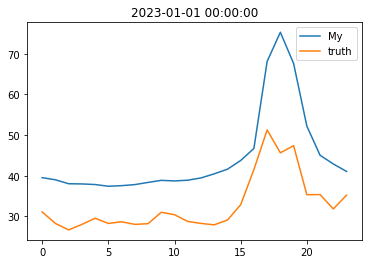

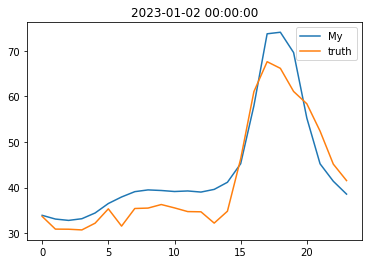

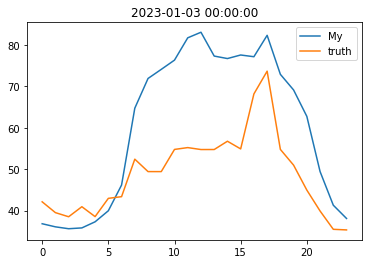

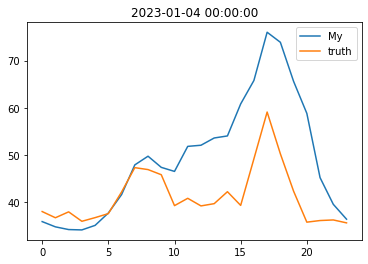

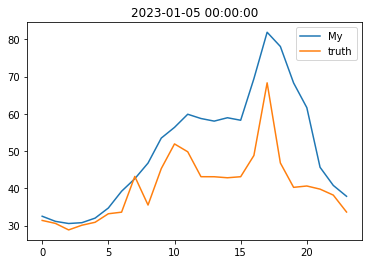

...

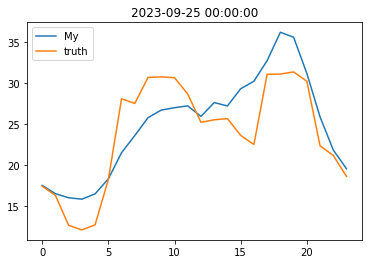

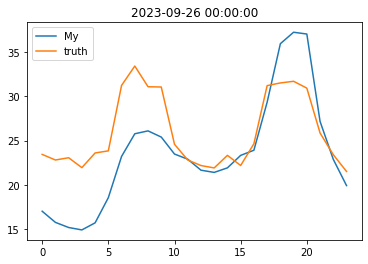

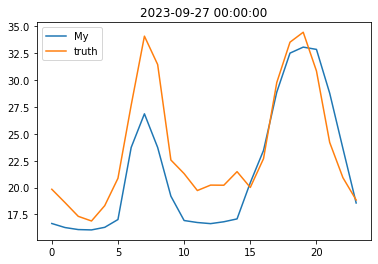

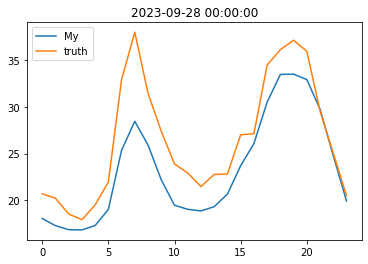

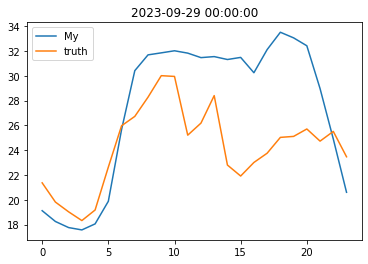

In [192]:

def calculate_loss():
    loss_record = []

    for _ in pd.date_range(pd.to_datetime('2023/1/1'),pd.to_datetime('2023/9/30')):
#         if _.weekday() != 0 and _.weekday() != 6:
        y_truth = get_price_data(_)['Locational Marginal Price'].values

        # y_pred = get_linear_pred(_)
        y_pred_by_linear = get_linear_pred(_)
        y_pred_by_xgb = get_xgb_pred(_)
        y_pred_by_dnn = get_dnn_pred(_)
        y_pred_by_arima = get_arima_pred(_)
        y_pred_by_lstm = get_lstm_pred(_)
        y_pred_by_svm = get_svm_pred(_)
        y_pred_by_my = get_my_pred(_)
        y_pred_by_koopa = get_koopa_pred(_)
        y_pred_by_itransformer = get_itransformer_pred(_)
        y_pred_by_dlinear = get_dlinear_pred(_)
        y_pred_by_timesnet = get_timesnet_pred(_)
        y_pred_by_vmd_lstm = get_vmd_lstm_pred(_)
        y_pred_by_fedformer = get_fedformer_pred(_)
        y_pred_by_rf = get_rf_pred(_)
        # print(y_pred_by_linear, y_truth, y_pred_by_xgb, y_pred_by_dnn, y_pred_by_arima, y_pred_by_lstm, y_pred_by_svm, y_pred_by_my, y_pred_by_koopa, y_pred_by_itransformer, y_pred_by_dlinear, y_pred_by_timesnet, y_pred_by_vmd_lstm, y_pred_by_fedformer)
        # print(pd.isna(y_pred_by_xgb).all())
        # print(pd.isna(y_pred_by_dnn).all())
        # print(pd.isna(y_pred_by_arima).all())
        # print(pd.isna(y_pred_by_lstm).all())
        # print(pd.isna(y_pred_by_svm).all())
        # print(pd.isna(y_pred_by_my).all())
        # print(pd.isna(y_pred_by_koopa).all())
        # print(pd.isna(y_pred_by_itransformer).all())
        # print(pd.isna(y_pred_by_dlinear).all())
        # print(pd.isna(y_pred_by_timesnet).all())
        # print(pd.isna(y_pred_by_vmd_lstm).all())
        # print(pd.isna(y_pred_by_fedformer).all())
        # print(pd.isna(y_pred_by_rf).all())
        # print(pd.isna(y_truth).all())
        # print(pd.isna(y_pred_by_linear).all())
        # print((y_pred_by_linear == 0).all())
        # print(pd.isna(y_pred_by_xgb).all())
        # print(y_pred_by_svm)
        # print(pd.isna(y_pred_by_dnn).all())
        # print((y_pred_by_dnn == 0).all())
        # print(pd.isna(y_pred_by_arima).all())
        # print((y_pred_by_arima == 0).all())
        # print(pd.isna(y_pred_by_lstm).all())
        # print((y_pred_by_lstm == 0).all())
        # print(pd.isna(y_pred_by_svm).all())
        # print((y_pred_by_svm == 0).all())
        # print(pd.isna(y_pred_by_my).all())
        # print((y_pred_by_my == 0).all())
        # print(pd.isna(y_pred_by_koopa).all())
        # print((y_pred_by_koopa == 0).all())
        # print(pd.isna(y_pred_by_itransformer).all())
        # print((y_pred_by_itransformer == 0).all())
        # print(pd.isna(y_pred_by_dlinear).all())
        # print((y_pred_by_dlinear == 0).all())
        # print(pd.isna(y_pred_by_timesnet).all())
        # print((y_pred_by_timesnet == 0).all())
        # print(pd.isna(y_pred_by_vmd_lstm).all())
        # print((y_pred_by_vmd_lstm == 0).all())
        # print(pd.isna(y_pred_by_fedformer).all())
        # print((y_pred_by_fedformer == 0).all())
        # print(pd.isna(y_pred_by_rf).all())
        # print((y_pred_by_rf == 0).all())


        if (pd.isna(y_truth).all() == False) and (pd.isna(y_pred_by_linear).all() == False) and (not (y_pred_by_linear == 0).all()) and (pd.isna(y_pred_by_xgb).all() == False) and (not (y_pred_by_xgb == 0).all()) and (pd.isna(y_pred_by_dnn).all() == False) and (not (y_pred_by_dnn == 0).all()) and (pd.isna(y_pred_by_arima).all() == False) and (not (y_pred_by_arima == 0).all()) and (pd.isna(y_pred_by_lstm).all() == False) and (not (y_pred_by_lstm == 0).all()) and (pd.isna(y_pred_by_svm).all() == False) and (not (y_pred_by_svm == 0).all()) and (pd.isna(y_pred_by_my).all() == False) and (not (y_pred_by_my == 0).all()) and (pd.isna(y_pred_by_koopa).all() == False) and (not (y_pred_by_koopa == 0).all()) and (pd.isna(y_pred_by_itransformer).all() == False) and (not (y_pred_by_itransformer == 0).all()) and (pd.isna(y_pred_by_dlinear).all() == False) and (not (y_pred_by_dlinear == 0).all()) and (pd.isna(y_pred_by_timesnet).all() == False) and (not (y_pred_by_timesnet == 0).all()) and (pd.isna(y_pred_by_vmd_lstm).all() == False) and (not (y_pred_by_vmd_lstm == 0).all()) and (pd.isna(y_pred_by_fedformer).all() == False) and (not (y_pred_by_fedformer == 0).all()) and (pd.isna(y_pred_by_rf).all() == False) and (not (y_pred_by_rf == 0).all()):
    #             print(y_pred, y_truth)
    #             print(y_pred_by_linear)

            # plt.plot(y_pred_by_linear, label='Linear')
            # plt.plot(y_pred_by_xgb, label='XGB')
            # plt.plot(y_pred_by_dnn, label='DNN')
            # plt.plot(y_pred_by_arima, label='ARIMA')
            # plt.plot(y_pred_by_lstm, label='LSTM')
            # plt.plot(y_pred_by_svm, label='SVM')
            plt.plot(y_pred_by_my, label='My')
            # plt.plot(y_pred_by_koopa, label='Koopa')
            # plt.plot(y_pred_by_itransformer, label='iTransformer')
            # plt.plot(y_pred_by_dlinear, label='DLinear')
            # plt.plot(y_pred_by_timesnet, label='Timesnet')
            # plt.plot(y_pred_by_vmd_lstm, label='VMD_LSTM')
            # plt.plot(y_pred_by_fedformer, label='FEDformer')
            # plt.plot(y_pred_by_rf, label='RF')

            plt.plot(y_truth, label='truth')
            plt.legend()
            plt.title(_)
            # print(y_truth[(y_truth > 75) | (y_truth < 30)])
            if len(y_truth[(y_truth > 60)]) > 0:
                # print(y_truth[(y_truth > 75) | (y_truth < 30)], y_pred_by_linear[(y_truth > 75) | (y_truth < 30)])
                mse, rmse, mae_linear, smape_linear = loss(y_truth[(y_truth > 60)], y_pred_by_linear[(y_truth > 60)])
                mse, rmse, mae_xgb, smape_xgb = loss(y_truth[(y_truth > 60)], y_pred_by_xgb[(y_truth > 60)])
                mse, rmse, mae_dnn, smape_dnn = loss(y_truth[(y_truth > 60)], y_pred_by_dnn[(y_truth > 60)])
                mse, rmse, mae_arima, smape_arima = loss(y_truth[(y_truth > 60)], y_pred_by_arima[(y_truth > 60)])
                mse, rmse, mae_lstm, smape_lstm = loss(y_truth[(y_truth > 60)], y_pred_by_lstm[(y_truth > 60)])
                mse, rmse, mae_svm, smape_svm = loss(y_truth[(y_truth > 60)], y_pred_by_svm[(y_truth > 60)])
                mse, rmse, mae_my, smape_my = loss(y_truth[(y_truth > 60)], y_pred_by_my[(y_truth > 60)])
                mse, rmse, mae_koopa, smape_koopa = loss(y_truth[(y_truth > 60)], y_pred_by_koopa[(y_truth > 60)])
                mse, rmse, mae_itransformer, smape_itransformer = loss(y_truth[(y_truth > 60)], y_pred_by_itransformer[(y_truth > 60)])
                mse, rmse, mae_dlinear, smape_dlinear = loss(y_truth[(y_truth > 60)], y_pred_by_dlinear[(y_truth > 60)])
                mse, rmse, mae_timesnet, smape_timesnet = loss(y_truth[(y_truth > 60)], y_pred_by_timesnet[(y_truth > 60)])
                mse, rmse, mae_vmd_lstm, smape_vmd_lstm = loss(y_truth[(y_truth > 60)], y_pred_by_vmd_lstm[(y_truth > 60)])
                mse, rmse, mae_fedformer, smape_fedformer = loss(y_truth[(y_truth > 60)], y_pred_by_fedformer[(y_truth > 60)])
                mse, rmse, mae_rf, smape_rf = loss(y_truth[(y_truth > 60)], y_pred_by_rf[(y_truth > 60)])

                loss_record.append([_, mae_linear, smape_linear, mae_xgb, smape_xgb, mae_dnn, smape_dnn, mae_arima, smape_arima, mae_lstm, smape_lstm, mae_svm, smape_svm, mae_my, smape_my, mae_koopa, smape_koopa, mae_itransformer, smape_itransformer, mae_dlinear, smape_dlinear, mae_timesnet, smape_timesnet, mae_vmd_lstm, smape_vmd_lstm, mae_fedformer, smape_fedformer, mae_rf, smape_rf])
            plt.show()
    df_loss = pd.DataFrame(loss_record)
    # print(df_loss)
    df_loss.columns = ['date', 'mae_linear', 'smape_linear', 'mae_xgb', 'smape_xgb', 'mae_dnn', 'smape_dnn', 'mae_arima', 'smape_arima', 'mae_lstm', 'smape_lstm', 'mae_svm', 'smape_svm', 'mae_my', 'smape_my', 'mae_koopa', 'smape_koopa', 'mae_itransformer', 'smape_itransformer', 'mae_dlinear', 'smape_dlinear', 'mae_timesnet', 'smape_timesnet', 'mae_vmd_lstm', 'smape_vmd_lstm', 'mae_fedformer', 'smape_fedformer', 'mae_rf', 'smape_rf']
    return df_loss

df_loss1 = calculate_loss()


In [193]:
pd.DataFrame(df_loss1.describe().T['mean'])

,mean
mae_linear,38.091678
smape_linear,0.425598
mae_xgb,26.513710
smape_xgb,0.293700
mae_dnn,39.681888
smape_dnn,0.435969
mae_arima,28.535241
smape_arima,0.363781
mae_lstm,37.991914
smape_lstm,0.526659


In [189]:
df_price1 = df_price[(df_price['Date'] >= pd.to_datetime('2023/1/1')) & (df_price['Date'] <= pd.to_datetime('2023/9/30'))]
# get 10% and 90% line of df_price1['Locational Marginal Price']
p10 = df_price1['Locational Marginal Price'].quantile(0.1)
p20 = df_price1['Locational Marginal Price'].quantile(0.2)
p30 = df_price1['Locational Marginal Price'].quantile(0.3)
p40 = df_price1['Locational Marginal Price'].quantile(0.4)
p50 = df_price1['Locational Marginal Price'].quantile(0.5)
p60 = df_price1['Locational Marginal Price'].quantile(0.6)
p70 = df_price1['Locational Marginal Price'].quantile(0.7)
p80 = df_price1['Locational Marginal Price'].quantile(0.8)
p90 = df_price1['Locational Marginal Price'].quantile(0.9)
print(p10, p20, p30, p40, p50, p60, p70, p80, p90)

20.15265235342691 22.31315104692876 24.493372293282487 26.374510957704462 29.281226788533075 32.553210977226314 36.881259392704244 43.871993426458545 58.612093572957875


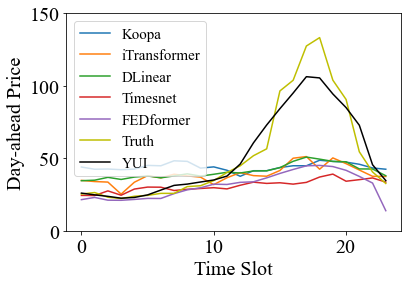

In [24]:
os.chdir('E:\day-ahead price\Code\Code')
def calculate_loss():
    loss_record = []

    for _ in pd.date_range(pd.to_datetime('2023/7/17'),pd.to_datetime('2023/7/17')):
#         if _.weekday() != 0 and _.weekday() != 6:
        y_truth = get_price_data(_)['Locational Marginal Price'].values

        # y_pred = get_linear_pred(_)
        y_pred_by_linear = get_linear_pred(_)
        y_pred_by_xgb = get_xgb_pred(_)
        y_pred_by_dnn = get_dnn_pred(_)
        y_pred_by_arima = get_arima_pred(_)
        y_pred_by_lstm = get_lstm_pred(_)
        y_pred_by_svm = get_svm_pred(_)
        y_pred_by_my = get_my_pred(_)
        y_pred_by_koopa = get_koopa_pred(_)
        y_pred_by_itransformer = get_itransformer_pred(_)
        y_pred_by_dlinear = get_dlinear_pred(_)
        y_pred_by_timesnet = get_timesnet_pred(_)
        y_pred_by_vmd_lstm = get_vmd_lstm_pred(_)
        y_pred_by_fedformer = get_fedformer_pred(_)
        y_pred_by_rf = get_rf_pred(_)
        # print(y_pred_by_linear, y_truth, y_pred_by_xgb, y_pred_by_dnn, y_pred_by_arima, y_pred_by_lstm, y_pred_by_svm, y_pred_by_my, y_pred_by_koopa, y_pred_by_itransformer, y_pred_by_dlinear, y_pred_by_timesnet, y_pred_by_vmd_lstm, y_pred_by_fedformer)
        # print(pd.isna(y_pred_by_xgb).all())
        # print(pd.isna(y_pred_by_dnn).all())
        # print(pd.isna(y_pred_by_arima).all())
        # print(pd.isna(y_pred_by_lstm).all())
        # print(pd.isna(y_pred_by_svm).all())
        # print(pd.isna(y_pred_by_my).all())
        # print(pd.isna(y_pred_by_koopa).all())
        # print(pd.isna(y_pred_by_itransformer).all())
        # print(pd.isna(y_pred_by_dlinear).all())
        # print(pd.isna(y_pred_by_timesnet).all())
        # print(pd.isna(y_pred_by_vmd_lstm).all())
        # print(pd.isna(y_pred_by_fedformer).all())
        # print(pd.isna(y_pred_by_rf).all())
        # print(pd.isna(y_truth).all())
        # print(pd.isna(y_pred_by_linear).all())
        # print((y_pred_by_linear == 0).all())
        # print(pd.isna(y_pred_by_xgb).all())
        # print(y_pred_by_svm)
        # print(pd.isna(y_pred_by_dnn).all())
        # print((y_pred_by_dnn == 0).all())
        # print(pd.isna(y_pred_by_arima).all())
        # print((y_pred_by_arima == 0).all())
        # print(pd.isna(y_pred_by_lstm).all())
        # print((y_pred_by_lstm == 0).all())
        # print(pd.isna(y_pred_by_svm).all())
        # print((y_pred_by_svm == 0).all())
        # print(pd.isna(y_pred_by_my).all())
        # print((y_pred_by_my == 0).all())
        # print(pd.isna(y_pred_by_koopa).all())
        # print((y_pred_by_koopa == 0).all())
        # print(pd.isna(y_pred_by_itransformer).all())
        # print((y_pred_by_itransformer == 0).all())
        # print(pd.isna(y_pred_by_dlinear).all())
        # print((y_pred_by_dlinear == 0).all())
        # print(pd.isna(y_pred_by_timesnet).all())
        # print((y_pred_by_timesnet == 0).all())
        # print(pd.isna(y_pred_by_vmd_lstm).all())
        # print((y_pred_by_vmd_lstm == 0).all())
        # print(pd.isna(y_pred_by_fedformer).all())
        # print((y_pred_by_fedformer == 0).all())
        # print(pd.isna(y_pred_by_rf).all())
        # print((y_pred_by_rf == 0).all())


        if (pd.isna(y_truth).all() == False) and (pd.isna(y_pred_by_linear).all() == False) and (not (y_pred_by_linear == 0).all()) and (pd.isna(y_pred_by_xgb).all() == False) and (not (y_pred_by_xgb == 0).all()) and (pd.isna(y_pred_by_dnn).all() == False) and (not (y_pred_by_dnn == 0).all()) and (pd.isna(y_pred_by_arima).all() == False) and (not (y_pred_by_arima == 0).all()) and (pd.isna(y_pred_by_lstm).all() == False) and (not (y_pred_by_lstm == 0).all()) and (pd.isna(y_pred_by_svm).all() == False) and (not (y_pred_by_svm == 0).all()) and (pd.isna(y_pred_by_my).all() == False) and (not (y_pred_by_my == 0).all()) and (pd.isna(y_pred_by_koopa).all() == False) and (not (y_pred_by_koopa == 0).all()) and (pd.isna(y_pred_by_itransformer).all() == False) and (not (y_pred_by_itransformer == 0).all()) and (pd.isna(y_pred_by_dlinear).all() == False) and (not (y_pred_by_dlinear == 0).all()) and (pd.isna(y_pred_by_timesnet).all() == False) and (not (y_pred_by_timesnet == 0).all()) and (pd.isna(y_pred_by_vmd_lstm).all() == False) and (not (y_pred_by_vmd_lstm == 0).all()) and (pd.isna(y_pred_by_fedformer).all() == False) and (not (y_pred_by_fedformer == 0).all()) and (pd.isna(y_pred_by_rf).all() == False) and (not (y_pred_by_rf == 0).all()):
    #             print(y_pred, y_truth)
    #             print(y_pred_by_linear)

            # plt.plot(y_pred_by_linear, label='Linear')
            # plt.plot(y_pred_by_xgb, label='XGB')
            # plt.plot(y_pred_by_dnn, label='DNN')
            # plt.plot(y_pred_by_arima, label='ARIMA')
            # plt.plot(y_pred_by_lstm, label='LSTM')
            # plt.plot(y_pred_by_svm, label='SVM')
            
            plt.plot(y_pred_by_koopa, label='Koopa')
            plt.plot(y_pred_by_itransformer, label='iTransformer')
            plt.plot(y_pred_by_dlinear, label='DLinear')
            plt.plot(y_pred_by_timesnet, label='Timesnet')
            plt.plot(y_pred_by_fedformer, label='FEDformer')
            # plt.plot(y_pred_by_rf, label='Lasso-RF')

            plt.plot(y_truth, label='Truth', color='y')
            plt.plot(y_pred_by_my, label='YUI', color = 'k')
            plt.legend()
            # plt.title(_)
            # print(y_truth[(y_truth > 75) | (y_truth < 30)])
            if len(y_truth[(y_truth > 60)]) > 0:
                # print(y_truth[(y_truth > 75) | (y_truth < 30)], y_pred_by_linear[(y_truth > 75) | (y_truth < 30)])
                mse, rmse, mae_linear, smape_linear = loss(y_truth[(y_truth > 60)], y_pred_by_linear[(y_truth > 60)])
                mse, rmse, mae_xgb, smape_xgb = loss(y_truth[(y_truth > 60)], y_pred_by_xgb[(y_truth > 60)])
                mse, rmse, mae_dnn, smape_dnn = loss(y_truth[(y_truth > 60)], y_pred_by_dnn[(y_truth > 60)])
                mse, rmse, mae_arima, smape_arima = loss(y_truth[(y_truth > 60)], y_pred_by_arima[(y_truth > 60)])
                mse, rmse, mae_lstm, smape_lstm = loss(y_truth[(y_truth > 60)], y_pred_by_lstm[(y_truth > 60)])
                mse, rmse, mae_svm, smape_svm = loss(y_truth[(y_truth > 60)], y_pred_by_svm[(y_truth > 60)])
                mse, rmse, mae_my, smape_my = loss(y_truth[(y_truth > 60)], y_pred_by_my[(y_truth > 60)])
                mse, rmse, mae_koopa, smape_koopa = loss(y_truth[(y_truth > 60)], y_pred_by_koopa[(y_truth > 60)])
                mse, rmse, mae_itransformer, smape_itransformer = loss(y_truth[(y_truth > 60)], y_pred_by_itransformer[(y_truth > 60)])
                mse, rmse, mae_dlinear, smape_dlinear = loss(y_truth[(y_truth > 60)], y_pred_by_dlinear[(y_truth > 60)])
                mse, rmse, mae_timesnet, smape_timesnet = loss(y_truth[(y_truth > 60)], y_pred_by_timesnet[(y_truth > 60)])
                mse, rmse, mae_vmd_lstm, smape_vmd_lstm = loss(y_truth[(y_truth > 60)], y_pred_by_vmd_lstm[(y_truth > 60)])
                mse, rmse, mae_fedformer, smape_fedformer = loss(y_truth[(y_truth > 60)], y_pred_by_fedformer[(y_truth > 60)])
                mse, rmse, mae_rf, smape_rf = loss(y_truth[(y_truth > 60)], y_pred_by_rf[(y_truth > 60)])

                loss_record.append([_, mae_linear, smape_linear, mae_xgb, smape_xgb, mae_dnn, smape_dnn, mae_arima, smape_arima, mae_lstm, smape_lstm, mae_svm, smape_svm, mae_my, smape_my, mae_koopa, smape_koopa, mae_itransformer, smape_itransformer, mae_dlinear, smape_dlinear, mae_timesnet, smape_timesnet, mae_vmd_lstm, smape_vmd_lstm, mae_fedformer, smape_fedformer, mae_rf, smape_rf])
             # 添加标题和轴标签
            # plt.title('MAE of different models')
            plt.xlabel('Time Slot')
            plt.ylabel('Day-ahead Price')
            plt.ylim(0, 150)

            # 设置坐标轴刻度的字体大小和颜色
            plt.tick_params(axis='both', labelsize=20, labelcolor='black')

            # 设置图例的字体大小
            plt.legend(fontsize=15)
            plt.savefig('case_0717_1.pdf', dpi=1200, format='pdf', bbox_inches='tight')
            plt.show()
    df_loss = pd.DataFrame(loss_record)
    # print(df_loss)
    df_loss.columns = ['date', 'mae_linear', 'smape_linear', 'mae_xgb', 'smape_xgb', 'mae_dnn', 'smape_dnn', 'mae_arima', 'smape_arima', 'mae_lstm', 'smape_lstm', 'mae_svm', 'smape_svm', 'mae_my', 'smape_my', 'mae_koopa', 'smape_koopa', 'mae_itransformer', 'smape_itransformer', 'mae_dlinear', 'smape_dlinear', 'mae_timesnet', 'smape_timesnet', 'mae_vmd_lstm', 'smape_vmd_lstm', 'mae_fedformer', 'smape_fedformer', 'mae_rf', 'smape_rf']
    return df_loss

df_tmp = calculate_loss()


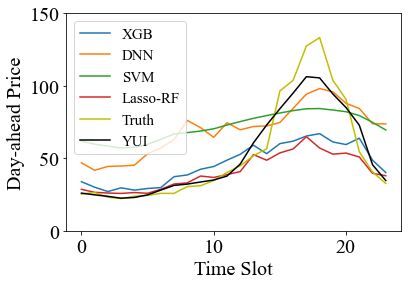

In [22]:
os.chdir('E:\day-ahead price\Code\Code')
def calculate_loss():
    loss_record = []

    for _ in pd.date_range(pd.to_datetime('2023/7/17'),pd.to_datetime('2023/7/17')):
#         if _.weekday() != 0 and _.weekday() != 6:
        y_truth = get_price_data(_)['Locational Marginal Price'].values

        # y_pred = get_linear_pred(_)
        y_pred_by_linear = get_linear_pred(_)
        y_pred_by_xgb = get_xgb_pred(_)
        y_pred_by_dnn = get_dnn_pred(_)
        y_pred_by_arima = get_arima_pred(_)
        y_pred_by_lstm = get_lstm_pred(_)
        y_pred_by_svm = get_svm_pred(_)
        y_pred_by_my = get_my_pred(_)
        y_pred_by_koopa = get_koopa_pred(_)
        y_pred_by_itransformer = get_itransformer_pred(_)
        y_pred_by_dlinear = get_dlinear_pred(_)
        y_pred_by_timesnet = get_timesnet_pred(_)
        y_pred_by_vmd_lstm = get_vmd_lstm_pred(_)
        y_pred_by_fedformer = get_fedformer_pred(_)
        y_pred_by_rf = get_rf_pred(_)
        # print(y_pred_by_linear, y_truth, y_pred_by_xgb, y_pred_by_dnn, y_pred_by_arima, y_pred_by_lstm, y_pred_by_svm, y_pred_by_my, y_pred_by_koopa, y_pred_by_itransformer, y_pred_by_dlinear, y_pred_by_timesnet, y_pred_by_vmd_lstm, y_pred_by_fedformer)
        # print(pd.isna(y_pred_by_xgb).all())
        # print(pd.isna(y_pred_by_dnn).all())
        # print(pd.isna(y_pred_by_arima).all())
        # print(pd.isna(y_pred_by_lstm).all())
        # print(pd.isna(y_pred_by_svm).all())
        # print(pd.isna(y_pred_by_my).all())
        # print(pd.isna(y_pred_by_koopa).all())
        # print(pd.isna(y_pred_by_itransformer).all())
        # print(pd.isna(y_pred_by_dlinear).all())
        # print(pd.isna(y_pred_by_timesnet).all())
        # print(pd.isna(y_pred_by_vmd_lstm).all())
        # print(pd.isna(y_pred_by_fedformer).all())
        # print(pd.isna(y_pred_by_rf).all())
        # print(pd.isna(y_truth).all())
        # print(pd.isna(y_pred_by_linear).all())
        # print((y_pred_by_linear == 0).all())
        # print(pd.isna(y_pred_by_xgb).all())
        # print(y_pred_by_svm)
        # print(pd.isna(y_pred_by_dnn).all())
        # print((y_pred_by_dnn == 0).all())
        # print(pd.isna(y_pred_by_arima).all())
        # print((y_pred_by_arima == 0).all())
        # print(pd.isna(y_pred_by_lstm).all())
        # print((y_pred_by_lstm == 0).all())
        # print(pd.isna(y_pred_by_svm).all())
        # print((y_pred_by_svm == 0).all())
        # print(pd.isna(y_pred_by_my).all())
        # print((y_pred_by_my == 0).all())
        # print(pd.isna(y_pred_by_koopa).all())
        # print((y_pred_by_koopa == 0).all())
        # print(pd.isna(y_pred_by_itransformer).all())
        # print((y_pred_by_itransformer == 0).all())
        # print(pd.isna(y_pred_by_dlinear).all())
        # print((y_pred_by_dlinear == 0).all())
        # print(pd.isna(y_pred_by_timesnet).all())
        # print((y_pred_by_timesnet == 0).all())
        # print(pd.isna(y_pred_by_vmd_lstm).all())
        # print((y_pred_by_vmd_lstm == 0).all())
        # print(pd.isna(y_pred_by_fedformer).all())
        # print((y_pred_by_fedformer == 0).all())
        # print(pd.isna(y_pred_by_rf).all())
        # print((y_pred_by_rf == 0).all())


        if (pd.isna(y_truth).all() == False) and (pd.isna(y_pred_by_linear).all() == False) and (not (y_pred_by_linear == 0).all()) and (pd.isna(y_pred_by_xgb).all() == False) and (not (y_pred_by_xgb == 0).all()) and (pd.isna(y_pred_by_dnn).all() == False) and (not (y_pred_by_dnn == 0).all()) and (pd.isna(y_pred_by_arima).all() == False) and (not (y_pred_by_arima == 0).all()) and (pd.isna(y_pred_by_lstm).all() == False) and (not (y_pred_by_lstm == 0).all()) and (pd.isna(y_pred_by_svm).all() == False) and (not (y_pred_by_svm == 0).all()) and (pd.isna(y_pred_by_my).all() == False) and (not (y_pred_by_my == 0).all()) and (pd.isna(y_pred_by_koopa).all() == False) and (not (y_pred_by_koopa == 0).all()) and (pd.isna(y_pred_by_itransformer).all() == False) and (not (y_pred_by_itransformer == 0).all()) and (pd.isna(y_pred_by_dlinear).all() == False) and (not (y_pred_by_dlinear == 0).all()) and (pd.isna(y_pred_by_timesnet).all() == False) and (not (y_pred_by_timesnet == 0).all()) and (pd.isna(y_pred_by_vmd_lstm).all() == False) and (not (y_pred_by_vmd_lstm == 0).all()) and (pd.isna(y_pred_by_fedformer).all() == False) and (not (y_pred_by_fedformer == 0).all()) and (pd.isna(y_pred_by_rf).all() == False) and (not (y_pred_by_rf == 0).all()):
    #             print(y_pred, y_truth)
    #             print(y_pred_by_linear)

            # plt.plot(y_pred_by_linear, label='Linear')
            plt.plot(y_pred_by_xgb, label='XGB')
            plt.plot(y_pred_by_dnn, label='DNN')
            # plt.plot(y_pred_by_arima, label='ARIMA')
            # plt.plot(y_pred_by_lstm, label='LSTM')
            plt.plot(y_pred_by_svm, label='SVM')
            
            # plt.plot(y_pred_by_koopa, label='Koopa')
            # plt.plot(y_pred_by_itransformer, label='iTransformer')
            # plt.plot(y_pred_by_dlinear, label='DLinear')
            # plt.plot(y_pred_by_timesnet, label='Timesnet')
            # plt.plot(y_pred_by_fedformer, label='FEDformer')
            plt.plot(y_pred_by_rf, label='Lasso-RF')

            plt.plot(y_truth, label='Truth', color='y')
            plt.plot(y_pred_by_my, label='YUI', color = 'k')
            plt.legend()
            # plt.title(_.strftime('%Y-%m-%d'))
            # print(y_truth[(y_truth > 75) | (y_truth < 30)])
            if len(y_truth[(y_truth > 60)]) > 0:
                # print(y_truth[(y_truth > 75) | (y_truth < 30)], y_pred_by_linear[(y_truth > 75) | (y_truth < 30)])
                mse, rmse, mae_linear, smape_linear = loss(y_truth[(y_truth > 60)], y_pred_by_linear[(y_truth > 60)])
                mse, rmse, mae_xgb, smape_xgb = loss(y_truth[(y_truth > 60)], y_pred_by_xgb[(y_truth > 60)])
                mse, rmse, mae_dnn, smape_dnn = loss(y_truth[(y_truth > 60)], y_pred_by_dnn[(y_truth > 60)])
                mse, rmse, mae_arima, smape_arima = loss(y_truth[(y_truth > 60)], y_pred_by_arima[(y_truth > 60)])
                mse, rmse, mae_lstm, smape_lstm = loss(y_truth[(y_truth > 60)], y_pred_by_lstm[(y_truth > 60)])
                mse, rmse, mae_svm, smape_svm = loss(y_truth[(y_truth > 60)], y_pred_by_svm[(y_truth > 60)])
                mse, rmse, mae_my, smape_my = loss(y_truth[(y_truth > 60)], y_pred_by_my[(y_truth > 60)])
                mse, rmse, mae_koopa, smape_koopa = loss(y_truth[(y_truth > 60)], y_pred_by_koopa[(y_truth > 60)])
                mse, rmse, mae_itransformer, smape_itransformer = loss(y_truth[(y_truth > 60)], y_pred_by_itransformer[(y_truth > 60)])
                mse, rmse, mae_dlinear, smape_dlinear = loss(y_truth[(y_truth > 60)], y_pred_by_dlinear[(y_truth > 60)])
                mse, rmse, mae_timesnet, smape_timesnet = loss(y_truth[(y_truth > 60)], y_pred_by_timesnet[(y_truth > 60)])
                mse, rmse, mae_vmd_lstm, smape_vmd_lstm = loss(y_truth[(y_truth > 60)], y_pred_by_vmd_lstm[(y_truth > 60)])
                mse, rmse, mae_fedformer, smape_fedformer = loss(y_truth[(y_truth > 60)], y_pred_by_fedformer[(y_truth > 60)])
                mse, rmse, mae_rf, smape_rf = loss(y_truth[(y_truth > 60)], y_pred_by_rf[(y_truth > 60)])

                loss_record.append([_, mae_linear, smape_linear, mae_xgb, smape_xgb, mae_dnn, smape_dnn, mae_arima, smape_arima, mae_lstm, smape_lstm, mae_svm, smape_svm, mae_my, smape_my, mae_koopa, smape_koopa, mae_itransformer, smape_itransformer, mae_dlinear, smape_dlinear, mae_timesnet, smape_timesnet, mae_vmd_lstm, smape_vmd_lstm, mae_fedformer, smape_fedformer, mae_rf, smape_rf])
            # 添加标题和轴标签
            # plt.title('MAE of different models')
            plt.xlabel('Time Slot')
            plt.ylabel('Day-ahead Price')
            plt.ylim(0, 150)

            # 设置坐标轴刻度的字体大小和颜色
            plt.tick_params(axis='both', labelsize=20, labelcolor='black')

            # 设置图例的字体大小
            plt.legend(fontsize=15)
            plt.savefig('case_0717_2.pdf', dpi=1200, format='pdf', bbox_inches='tight')
            
            plt.show()
    df_loss = pd.DataFrame(loss_record)
    # print(df_loss)
    df_loss.columns = ['date', 'mae_linear', 'smape_linear', 'mae_xgb', 'smape_xgb', 'mae_dnn', 'smape_dnn', 'mae_arima', 'smape_arima', 'mae_lstm', 'smape_lstm', 'mae_svm', 'smape_svm', 'mae_my', 'smape_my', 'mae_koopa', 'smape_koopa', 'mae_itransformer', 'smape_itransformer', 'mae_dlinear', 'smape_dlinear', 'mae_timesnet', 'smape_timesnet', 'mae_vmd_lstm', 'smape_vmd_lstm', 'mae_fedformer', 'smape_fedformer', 'mae_rf', 'smape_rf']
    return df_loss

df_tmp = calculate_loss()


In [131]:
df_loss[df_loss['mae'] > 40]

,date,mae,smape
18,2023-01-19,44.528071,0.772558
31,2023-02-01,41.735953,0.543053
33,2023-02-03,57.886162,0.331526
34,2023-02-04,82.429581,0.452657
35,2023-02-05,41.319791,0.362176
54,2023-02-24,69.748569,0.988031
55,2023-02-25,120.363038,0.965296
59,2023-03-01,75.576035,0.896254
60,2023-03-02,75.041952,1.035582


24.868506532080602
0
160.890448854693
584.2411996535353
590.7805957935443
427.26548844051626
8632.197624451906
search 3 days for 3 part


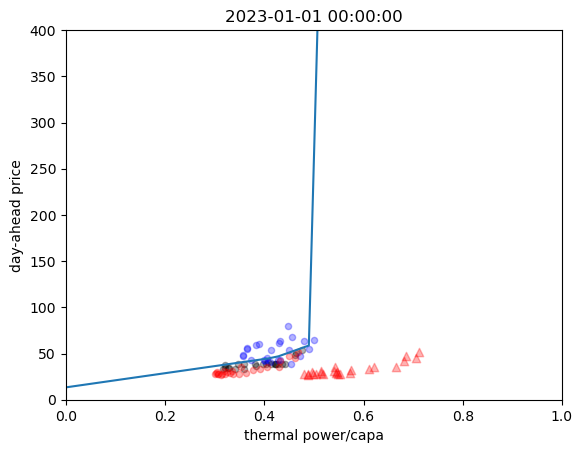

30.26492695729595
0
24.868992154354608
231.0553478764686
160.8904488546899
717.9750521912662
590.7806157504692
427.2654884423079
8672.788002968678
search 4 days for 3 part


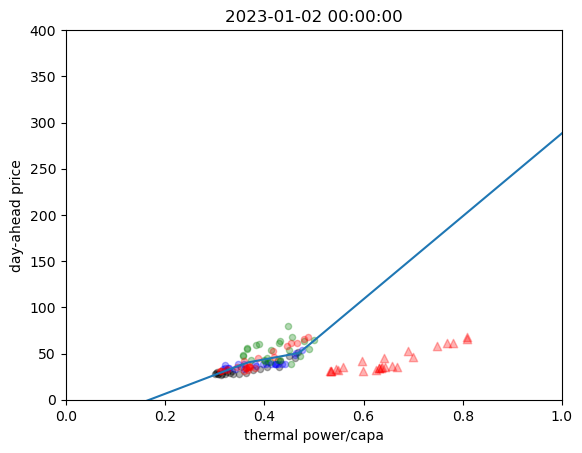

34.79277989070235
0
30.264593234595434
441.078837689998
24.868631594668813
388.6061796927306
160.8904488546847
340.21501254115105
590.780607514151


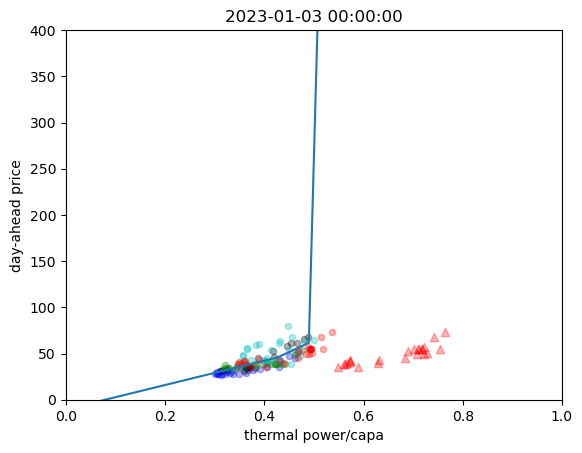

60.5627144924349
0
34.792779890809896
502.6518789281368
30.26459338477452
284.40193860831704
24.868770099283843
95.20553068327445
160.89044885469724
537.4315805836346


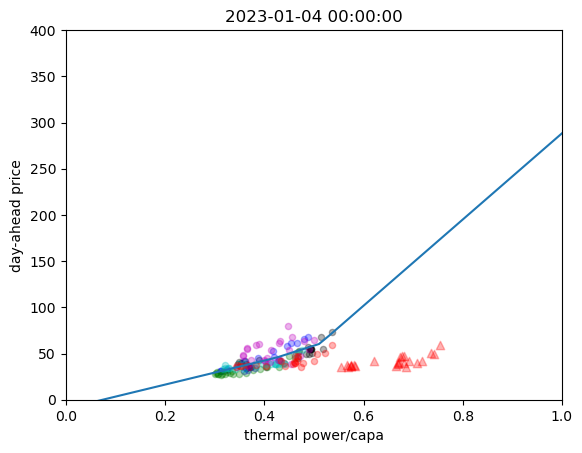

49.393560742945034
0
60.56260235858578
260.52239976181113
34.792779890783166
581.6852683503371
30.264593217994133
256.66180070892864
24.869185077612222
110.4568887898355


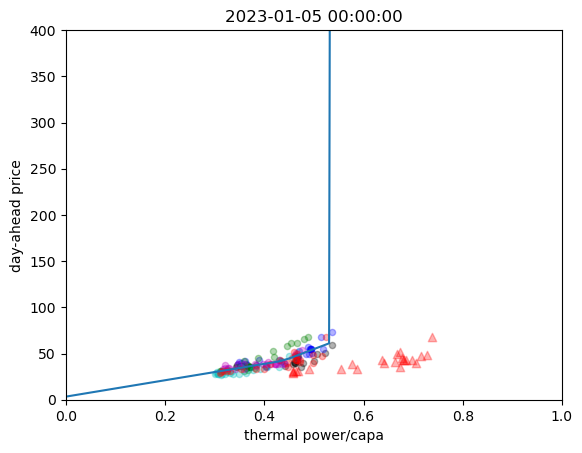

54.20921725906854
0
49.39356074307802
127.50131078346574
60.56267698572218
241.70337211538038
34.79277989027024
457.61258124859415
30.319050966013986
151.48280371027266


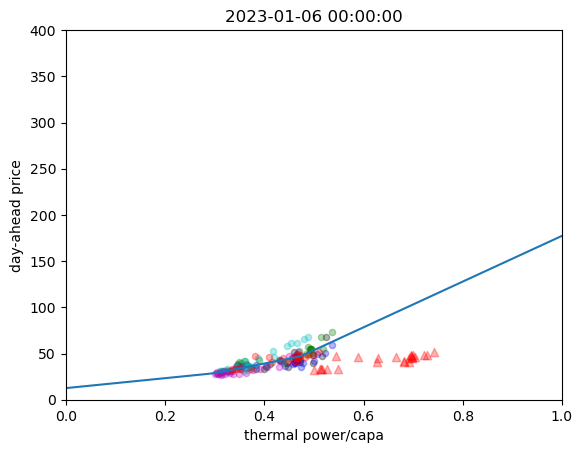

38.82665527101469
0
54.20972220240792
153.22911590147666
49.393560742919895
211.04359310293023
60.56265254312174
235.15179915394663
34.79277988941241
374.7037062748704


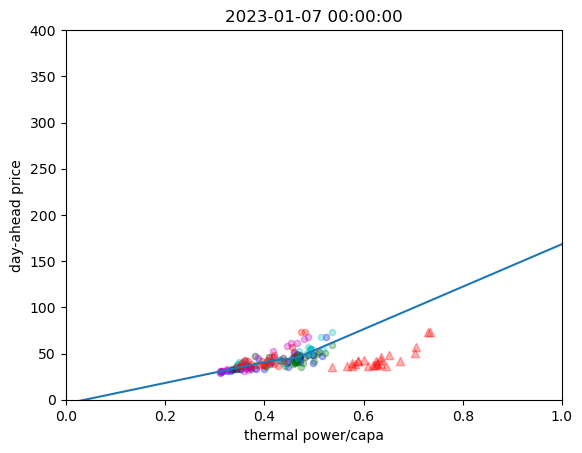

64.68264125943793
0
38.82665527103103
368.78466227421075
53.893516293513706
374.3906158376949
49.393560742935456
365.90354726282317
60.562647723549055
250.0637773367341


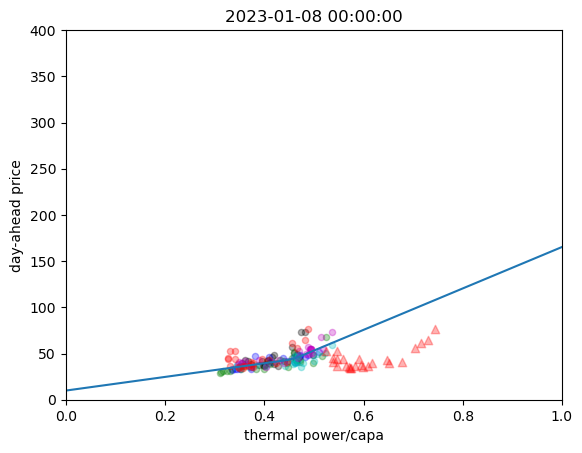

86.84776376560148
0
64.68449279678975
111.24750037038622
38.82665527102213
321.25783235344164
54.20983657894453
385.502509284508
49.39356074299284
357.8247534181068


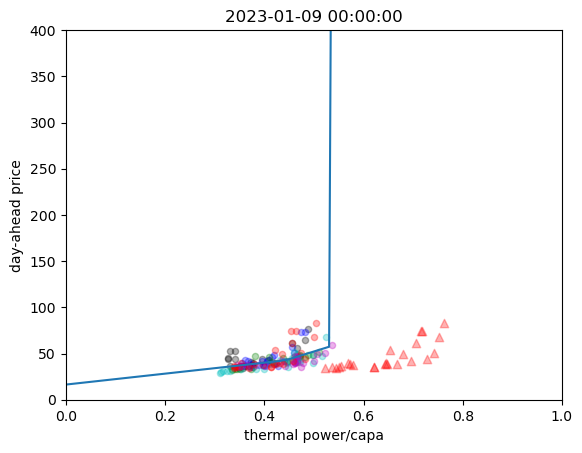

138.67645286340263
0
86.84775095417577
140.04695927924587
64.6818820047921
213.30916384626232
38.82665527105965
357.2953564813589
54.20939153183544
370.98493430454687


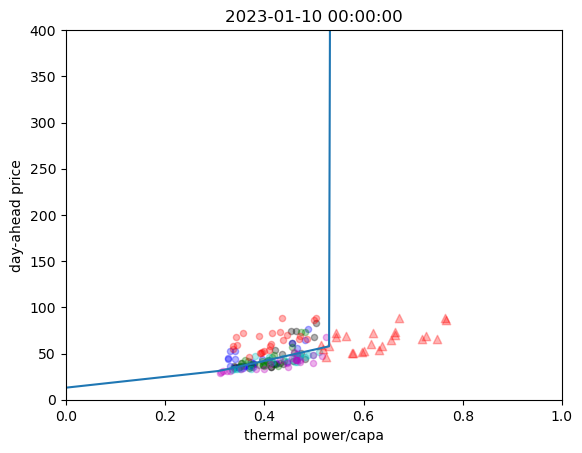

144.7528667371627
0
138.67645079839644
992.0464877551797
86.84775117121823
936.5633699436377
64.68386976001565
922.6365872856181
38.82665527229213
1196.1798130029117


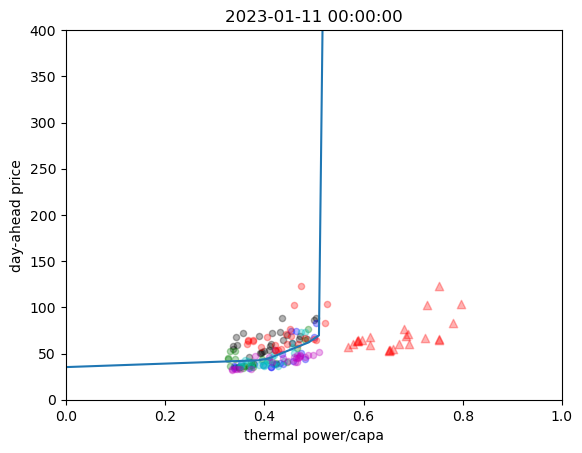

211.63610810526436
0
144.75287088111872
307.48264015306995
138.67645024507698
1020.5569879278383
86.8477504234572
982.1199880116072
64.67824410204918
978.0287629381502


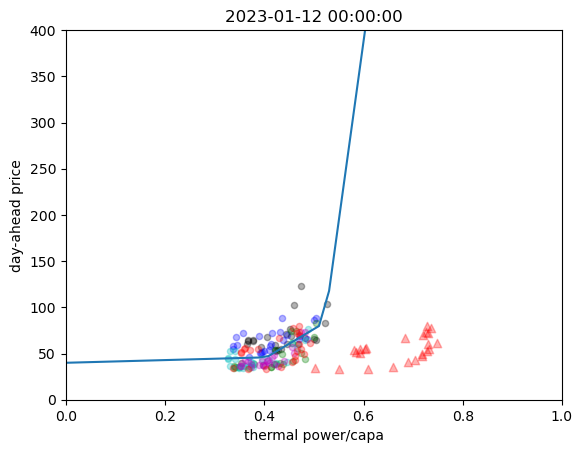

221.9602542660657
0
211.6340546654789
780.4866856076735
144.752870673092
690.8339295820365
138.67645247646772
395.6474780385507
86.84775084954578
364.55077248741696


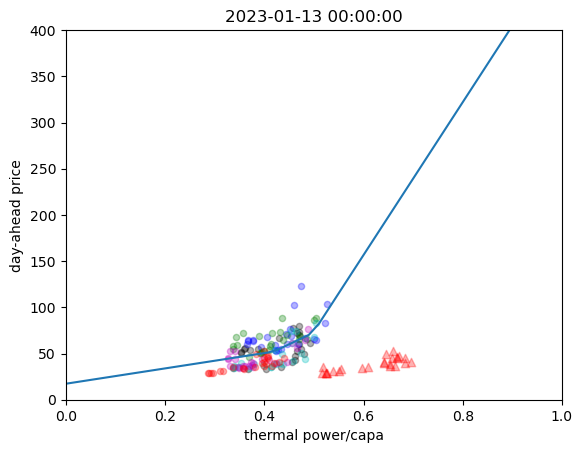

66.0701176321851
0
228.9941361617295
381.4578822021376
211.6323016320901
906.1285389070262
146.00262782599748
1053.7271734443543
138.6764653012749
143.5514326314373


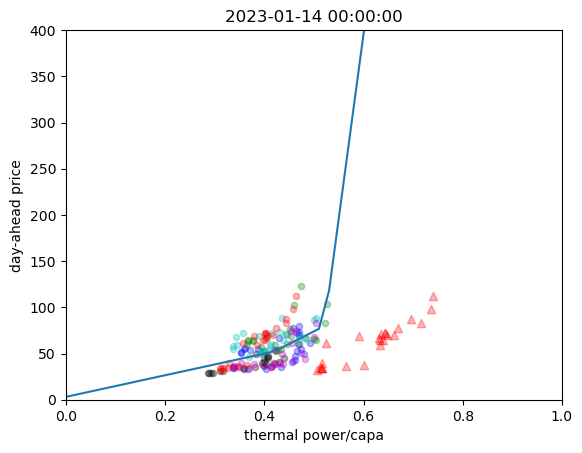

84.61283670120625
0
63.47778228865398
956.6929131081134
221.96020046039442
1023.6008054692767
211.45003996497297
720.2457107464745
144.75287140166392
742.918365063535


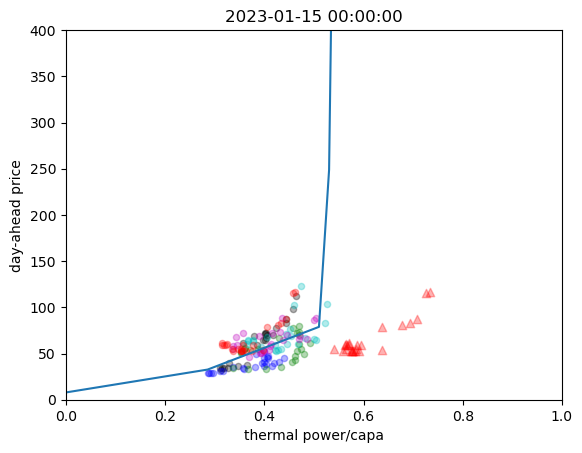

52.957699435450245
0
84.61283244398065
347.46338577039455
66.07011763077956
1251.4217283373173
221.96042864346094
1124.054340921766
211.6336730392825
833.9892226461259


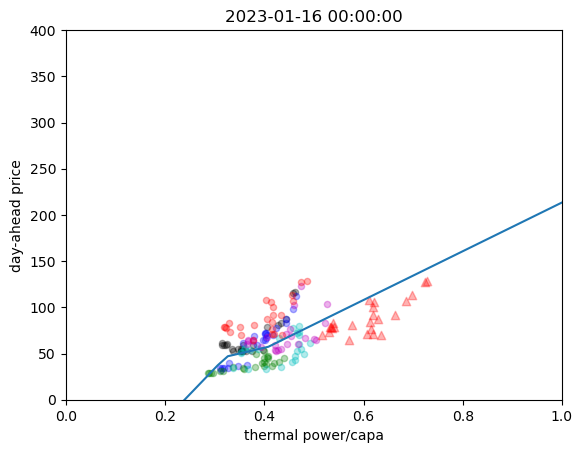

190.5518107132855
0
52.93923371417348
872.8389659586052
84.61294842901398
1114.8586507168466
63.47778228615023
2240.295946443972
221.96022242942558
2095.6428731087353


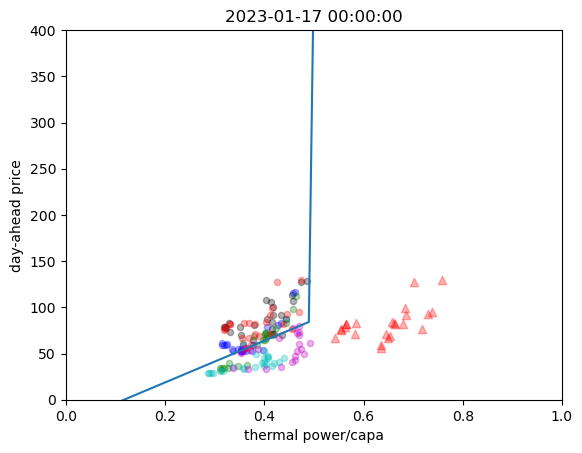

209.21387622894582
0
190.59636323152154
423.35223196133495
52.94528026787392
718.3722287549431
84.61283734042851
913.9892641660625
63.477782287571166
2043.703551576039


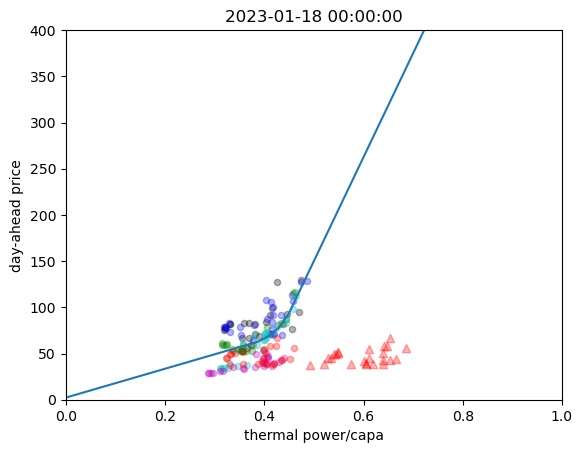

141.4104451854974
0
209.21387623591644
1715.8675378973774
190.61445193633045
1942.9922713508392
52.94542333250246
1106.0753317277215
84.61283734818798
965.5169655486843


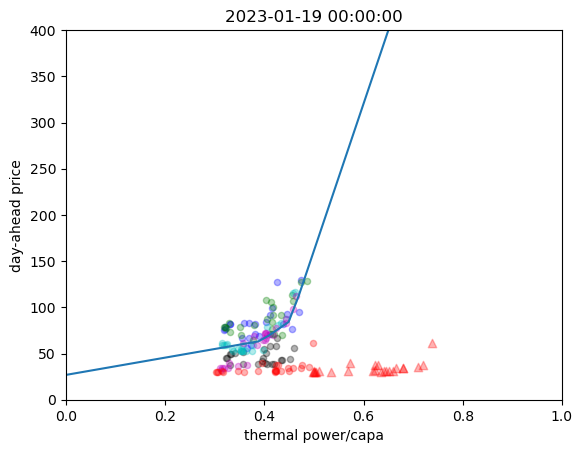

38.93965511846412
0
141.41044518549245
732.7268505439947
209.21387623591724
2536.77846489985
190.67961098594836
2916.353317256728
52.934774885440376
1865.7521192282868


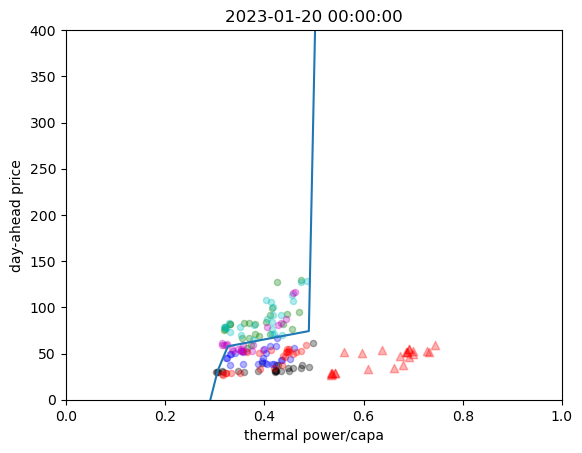

92.77179767525497
0
38.93965507512115
576.5363794515044
141.41044518547696
318.6584741923614
209.21598516161282
1997.1492112994295
190.60012551525585
2334.638028225472


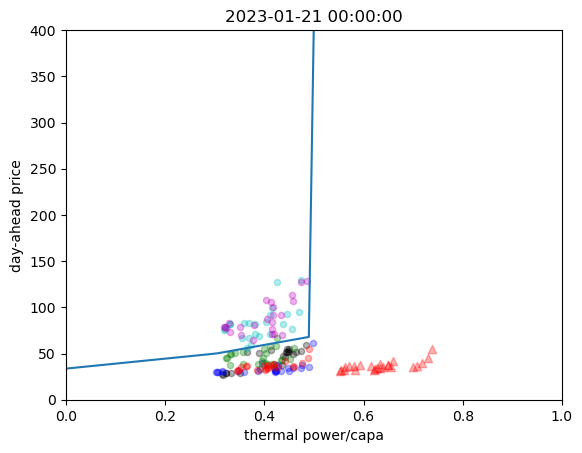

40.18056050649204
0
92.77179069776005
518.3806775944958
38.93965502793954
172.89274148685791
141.4104451854888
574.2001874325305
209.21387605490133
2412.655044741223


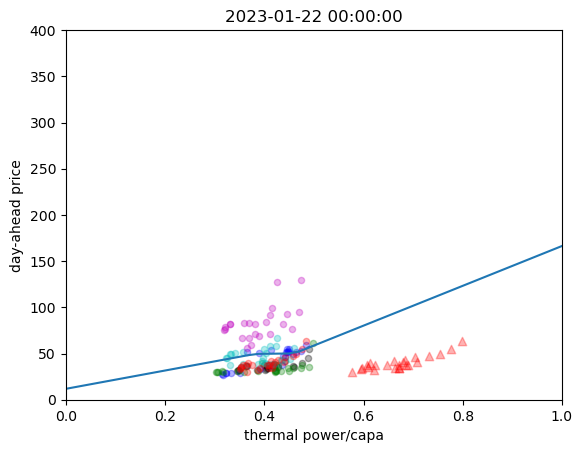

46.70666310745688
0
40.18046073767519
264.91062948851567
92.77181183122138
293.3255481002914
38.93965513758485
416.0582783791965
141.41044518550797
428.8831233521562


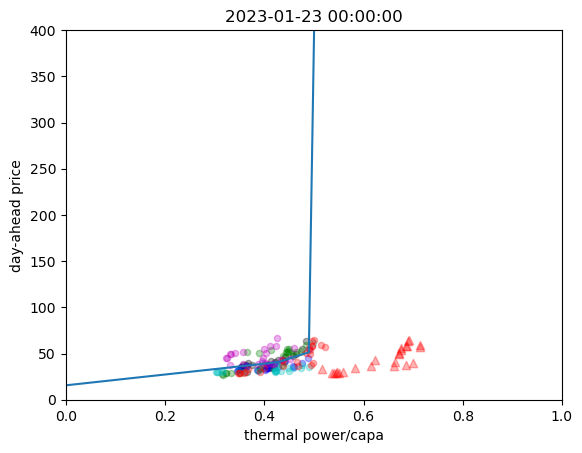

85.78782780007916
0
46.706663114227915
273.3838098093415
40.19533348293041
139.99414410923322
92.77183528530077
542.095775064165
38.93965507788231
193.14569067561646


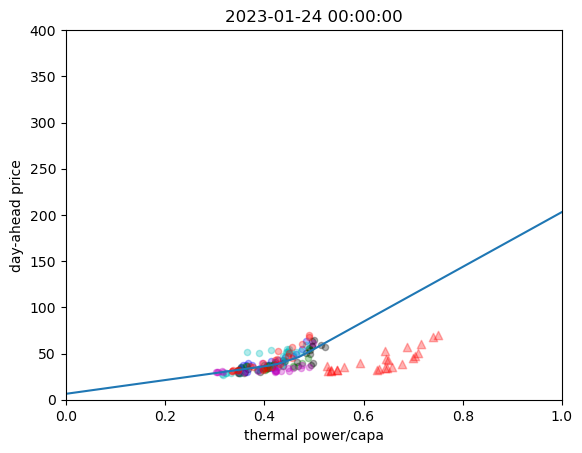

58.56148090581657
0
85.56577619580771
358.08621382628337
46.70666310613698
109.8309609821437
40.180429922732195
372.237486708588
92.77181155885381
242.69626281320387


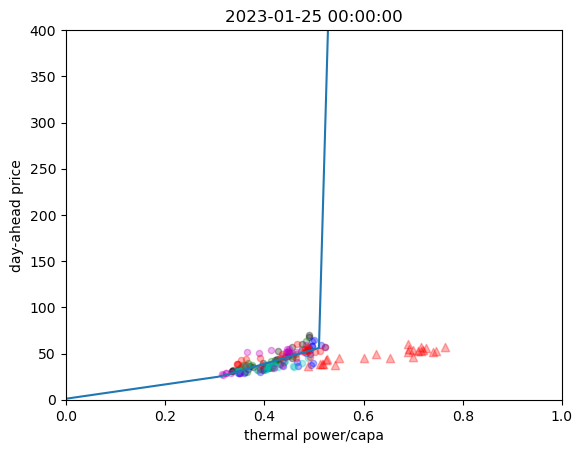

50.763650871068656
0
58.561480709065656
325.18716664268493
85.64040266017427
468.4268780621363
46.70666309724127
303.4984721808033
40.18036099512862
505.5129424540267


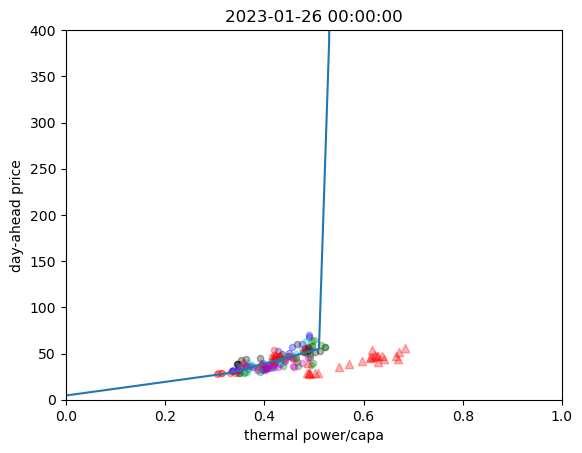

50.421363824856854
0
56.327098804963065
144.35307862504197
58.56148108493055
251.51286699795438
85.56462525552872
354.38018938110383
46.706663153260024
218.47079563038326


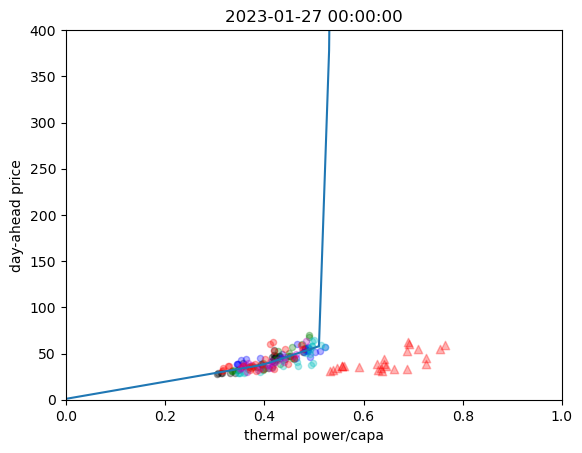

101.75563504269512
0
50.42136384196323
214.87779742630528
56.32709880500072
278.2011347351606
58.56148096782927
222.57546195852217
85.56469826398032
470.24159467434697


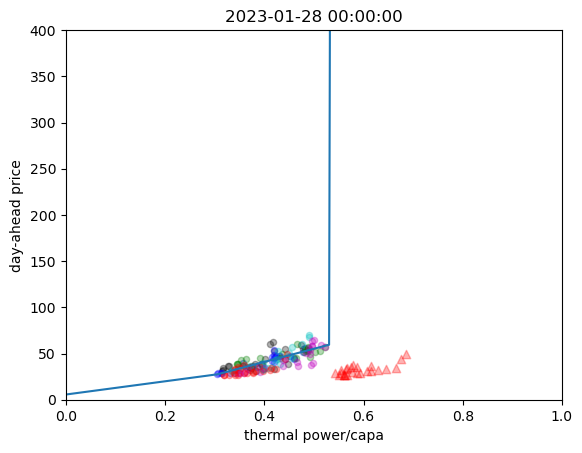

51.67759573749562
0
101.75563288437844
392.6758408746774
50.421363683679694
325.8751705728379
50.763650871061664
512.348190498582
58.5614810237287
168.39632638149993


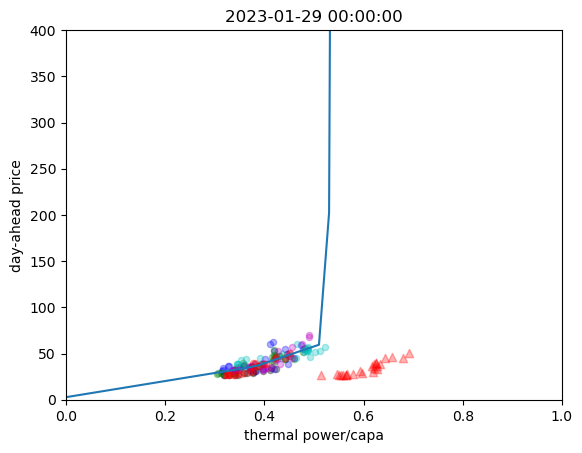

32.58131428099037
0
51.677601853039505
252.65426975224347
101.75563115399768
259.26779218504805
50.421366342821884
182.25066779497564
56.3270988049682
259.08237324156016


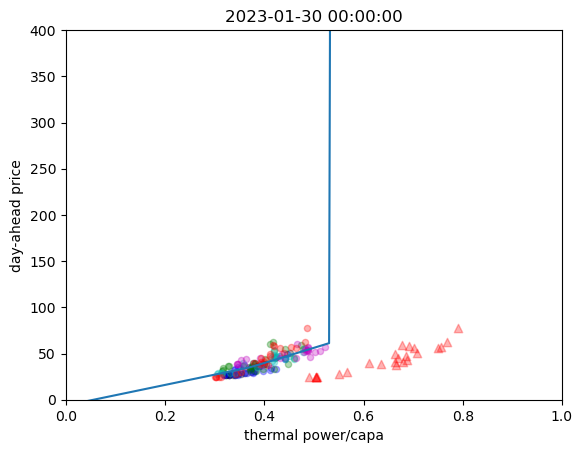

62.55045936474005
0
32.581328990617344
211.20674972113125
51.67759858075601
378.210262178916
101.75563024879301
252.34447386950967
50.421363794622664
268.382199489428


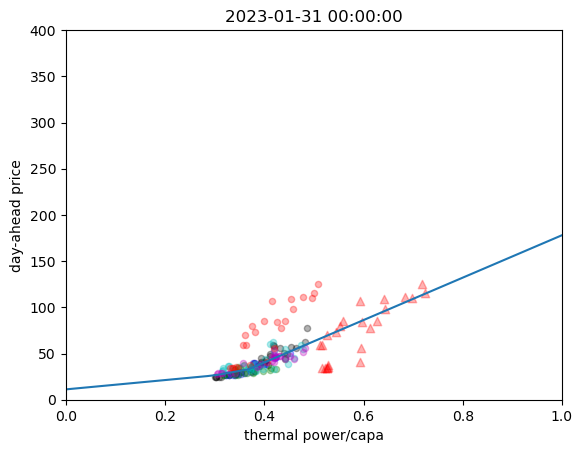

213.0797007490574
0
62.5502445780988
1452.7927016138024
32.581315143226234
1505.9834975634906
51.67759761653757
1644.3381780722611
101.75563909286822
1500.7235252501248


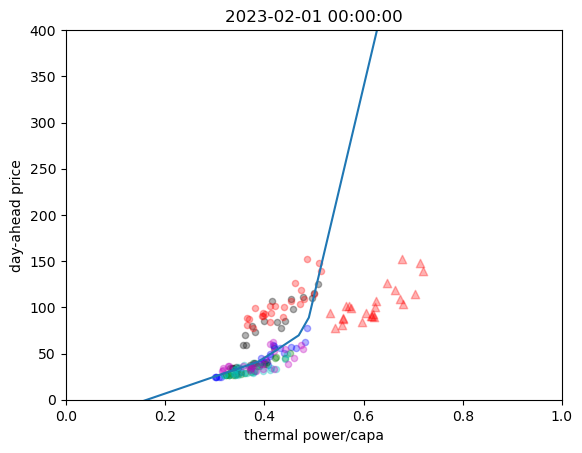

158.8921740575238
0
213.07970173473802
810.3225275372077
62.54964429638173
2448.303172371344
32.581314939490326
2694.7351744141993
51.677597762378255
2983.9532982380697


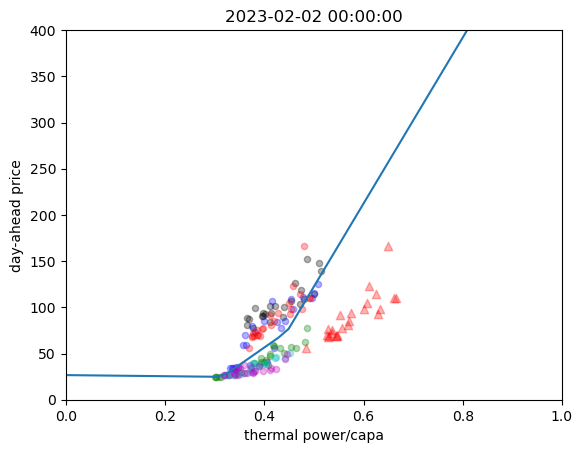

112.04738515818914
0
158.8921740574775
535.2770325793465
213.07970637035464
502.3847160863849
62.54967234968605
2059.0109750918614
32.58962518119742
2070.324238420918


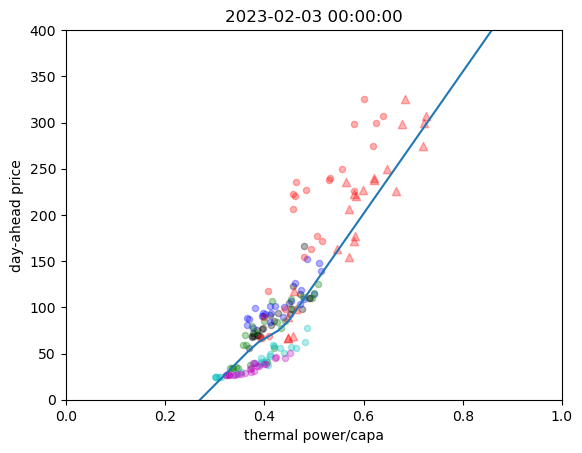

557.0876071644994
112.04738515818995
0
158.89217405753482
535.2770325794838
213.07970125877523
489.8784654654603
62.54978707327902
2062.361401316007


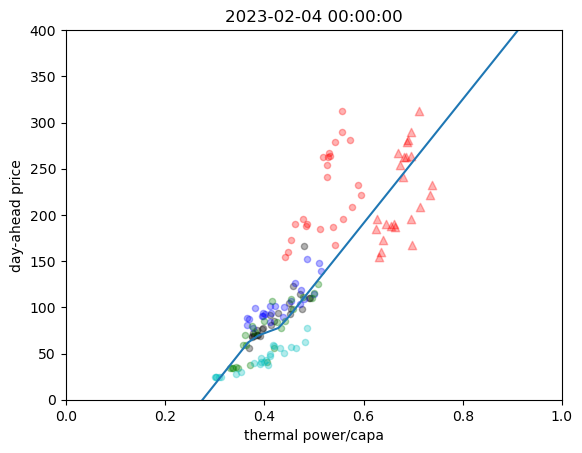

550.7324037690036
557.0873395938075
112.04738515818772
0
158.89217405752976
630.0491742051302
213.07970555882102
567.061675528522


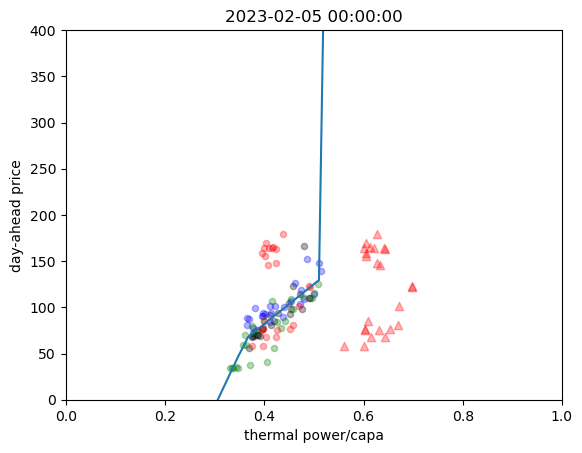

718.9668585424362
550.7324037691156
557.0915272991051
112.04738515808631
0
158.8921740583164
599.7047321804878


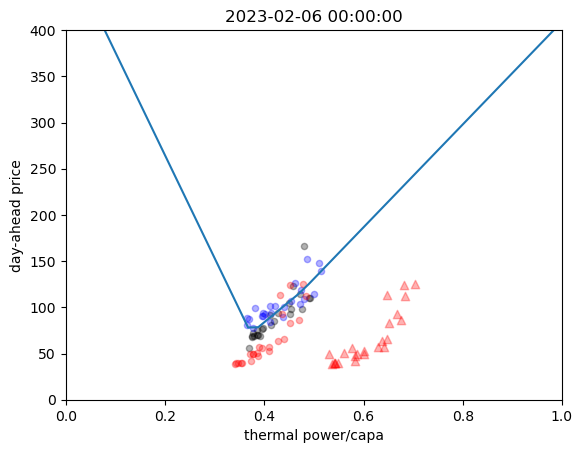

165.80854545643717
0
718.966807413109
550.7324037686715
557.0924665514707
112.04738515822359
894.563023352793


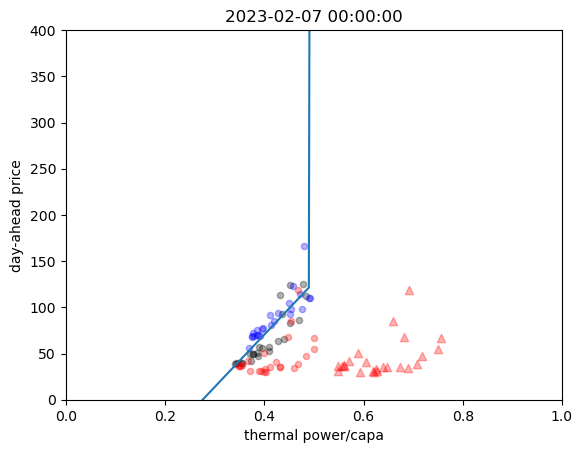

212.17201887685576
0
165.8088144327729
1324.737211387166
718.9671132161118
564.3039130735324
557.0789500375


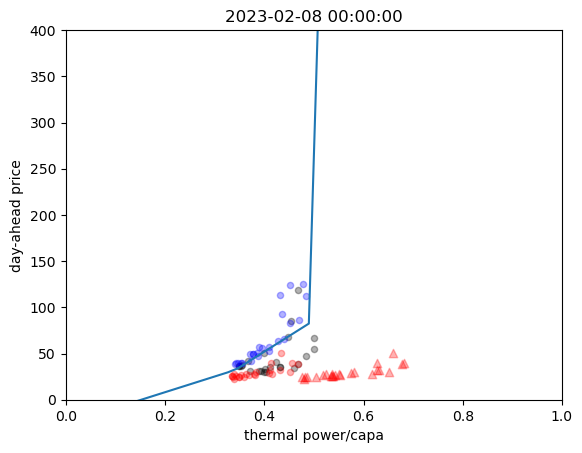

52.92418771803274
0
212.17202224461283
559.0503545497027
165.8085517858559
1640.0940850132267
718.9668368204173
564.3039130733525


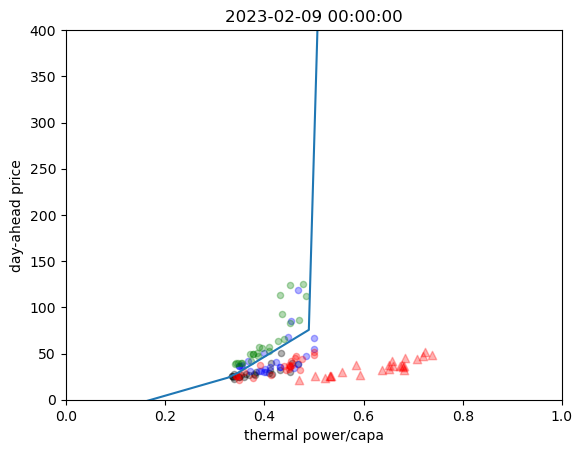

66.84794057384798
0
52.92418771904239
173.96230445708096
212.1720188106841
623.666359441166
165.80856121335103
1896.7470940522844
718.9667249927736


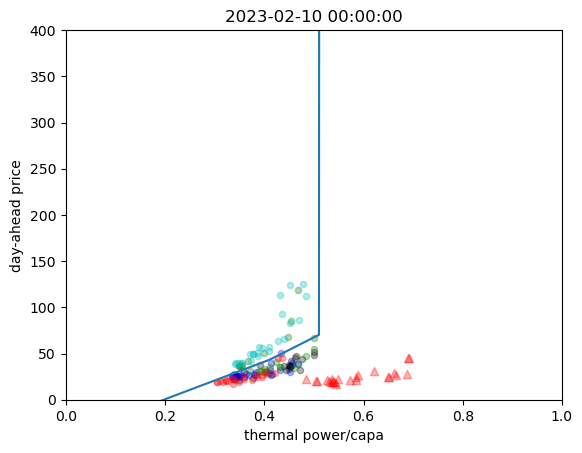

28.469916611762375
0
66.84794057384258
260.3635997101852
52.924187718528486
204.07243608528535
212.17201836596712
509.9010578595879
165.80855591413913
1298.0919454616978


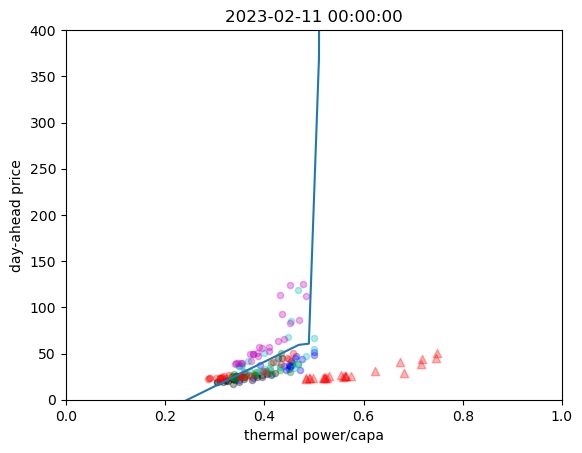

24.979706218572193
0
28.4697518285372
208.4054507717604
66.84794057384947
290.4983138886841
52.92418771649186
140.4499019914555
212.17201870484024
429.0334824849068


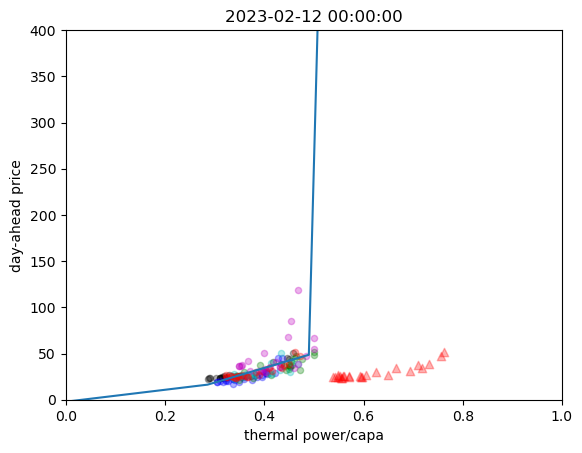

31.491347953645
0
24.987896858653528
155.14963426771237
28.469779263064044
233.3181452149788
66.84794057389904
168.13924058117055
52.92418771748816
141.07432449185018


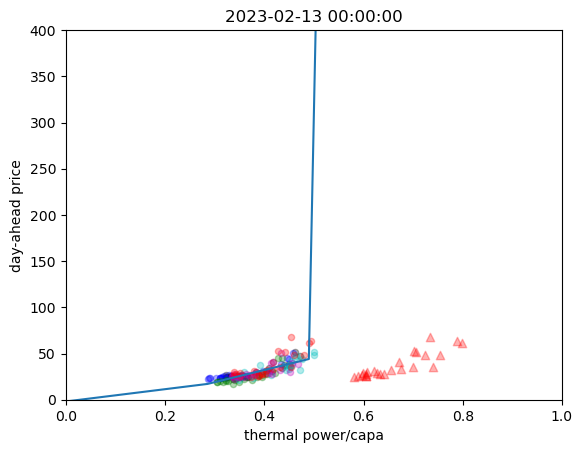

97.28927874998811
0
31.491343952990526
231.20295577730684
24.98789685865134
111.47004793996533
28.469748183557083
207.2048661731246
66.84794057387543
382.99055324696707


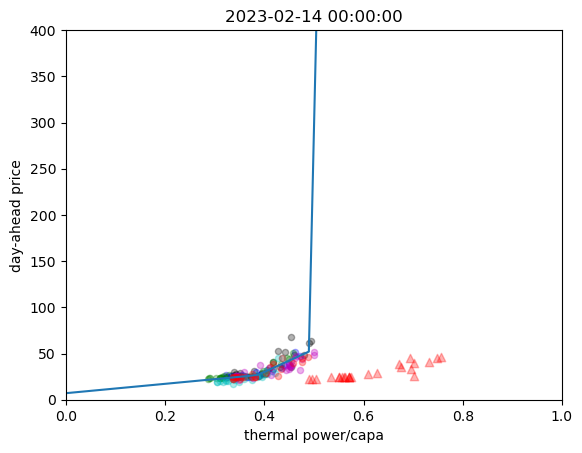

48.99053253744802
0
97.28927819895905
285.35871277513945
31.49140332849683
142.8632274476117
24.987896858650345
126.73144759623332
28.469747113729607
169.42352072048868


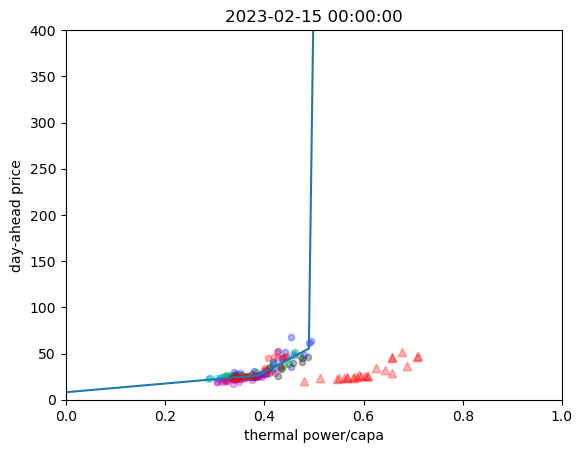

51.02794786706021
0
48.99053626718421
186.41404069802422
99.952034573275
135.42265493563897
31.491347368854438
217.78736927456075
24.979707147507476
114.89017574040246


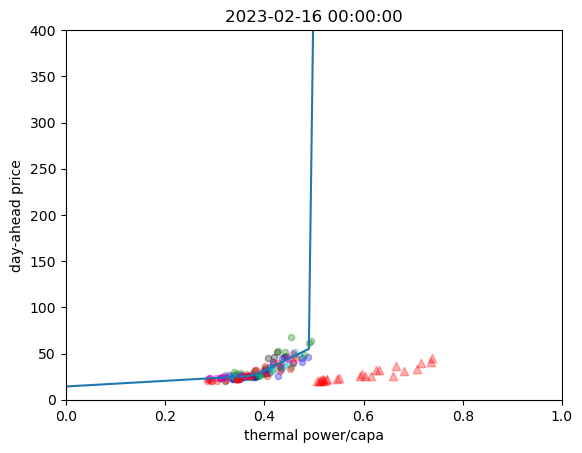

44.81472834354509
0
51.02794787591127
187.34338875849403
48.99053362391057
89.18538932089498
97.28927814638888
274.079137198473
31.491346944539615
71.65413287685865


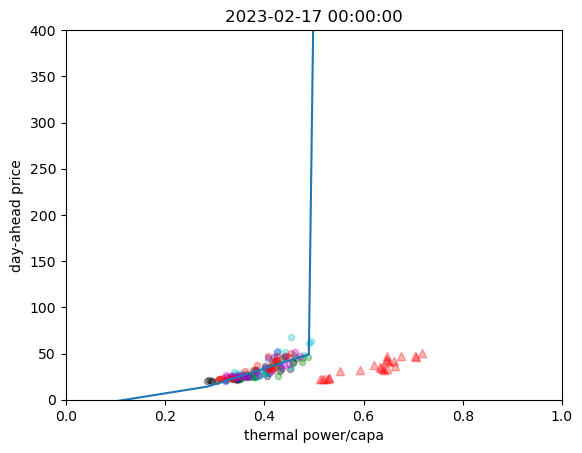

65.3709528585537
0
44.81472826808043
305.3324216585065
51.02794806967002
231.14294021532382
46.39649593932562
365.0068331887377
97.28927820960764
221.50506435316106


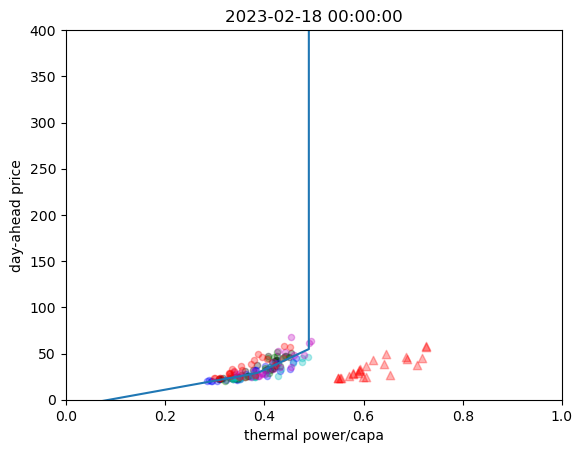

82.51137809204893
0
65.37095285856486
184.65201324693504
44.814728548373786
430.53020305651927
51.02794787110234
390.97778804057106
48.99053254659989
484.4438998164651


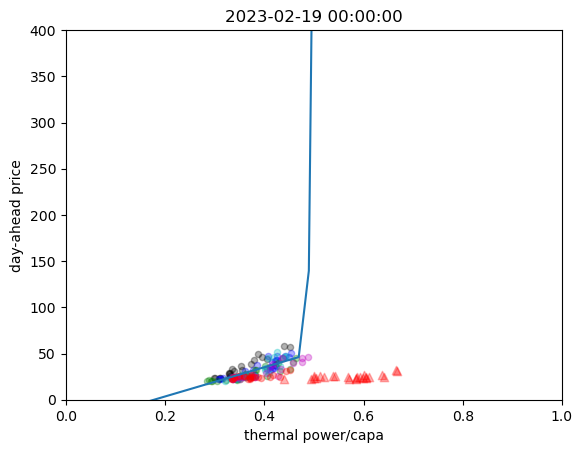

22.149172759968312
0
82.51137626171615
747.6335325335813
65.37095285857353
554.454501243956
44.814728498175015
225.4976351788336
51.02794804072829
391.7106672745574


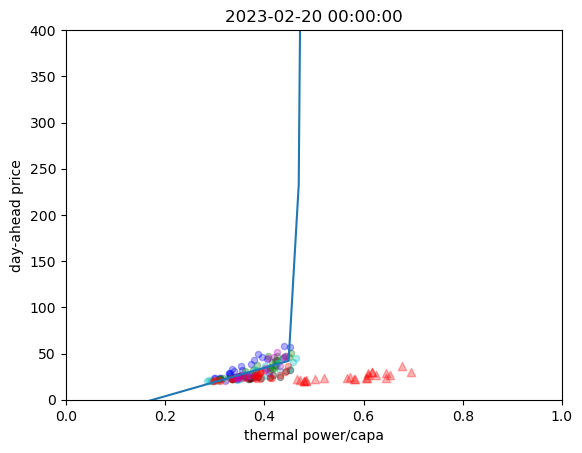

33.90742089623777
0
22.151479320337618
62.97944497442999
82.51137421239115
582.7041096664198
58.24694912250314
420.3241706556657
44.81472835469842
149.2631476733161


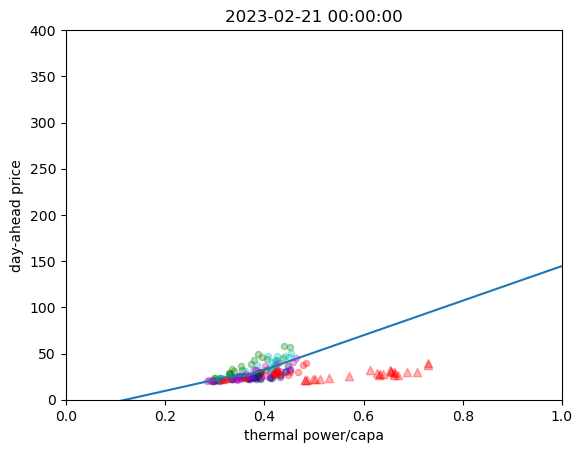

29.56497634619047
0
33.90862559316658
83.25650200958906
22.151479918897287
111.05763450349743
82.51137407952469
619.556123280579
65.3709528585431
458.661970034832


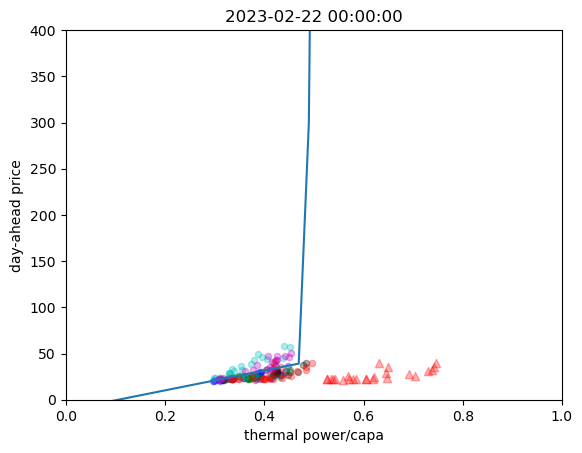

51.92360105211081
0
29.563605098137778
142.75687595277694
33.909651325376295
129.7571691136104
22.151479900096454
120.94308981420988
82.51137507366779
765.7911314545953


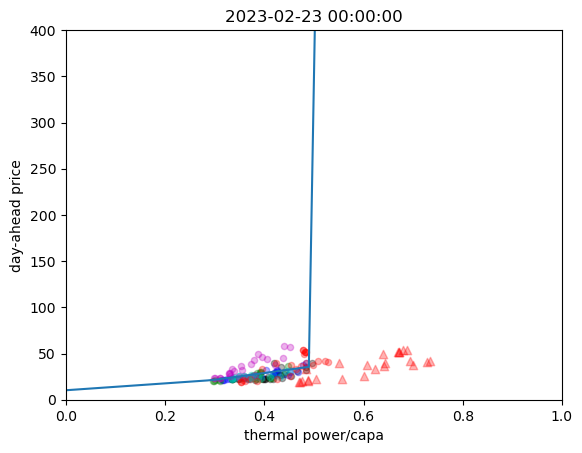

83.85995588839
0
51.92360105380218
176.76820993308144
29.567243910203374
154.53454263855878
33.90736664012202
138.7770914828531
22.15147996686722
124.36853160866141


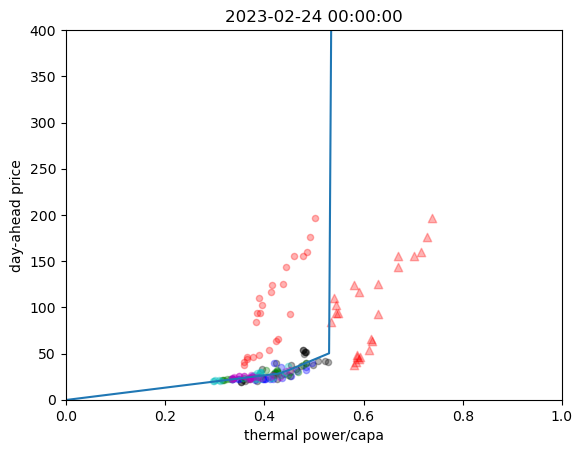

388.1824129356371
0
83.85995616299054
3850.756082536955
51.923601053119754
3899.688595015854
29.564364352375012
3490.2197417983025
33.912995561686614
2776.576703092589


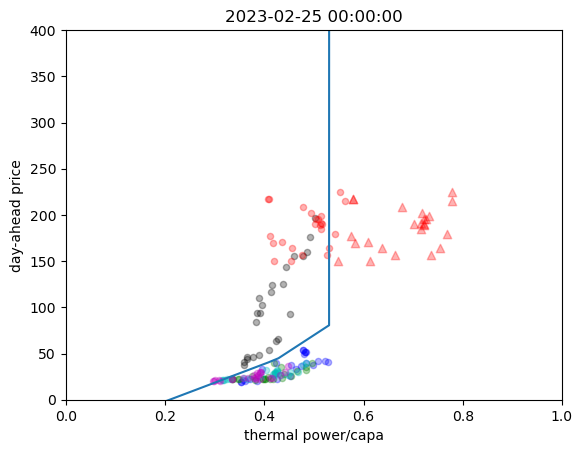

288.6871552393067
0
388.1824129353979
2097.40900863544
83.85996988674218
6968.4494954695865
51.92360105279624
7099.718304153959
search 3 days for 3 part


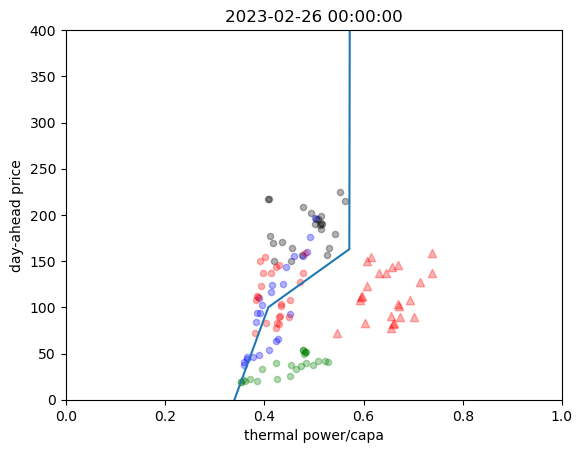

369.6227506118354
0
288.6860898719395
2952.965255458508
388.18241293542405
1081.1881307949816
83.85996553205507
4203.546454494206
51.92360105301254
4335.989390803607


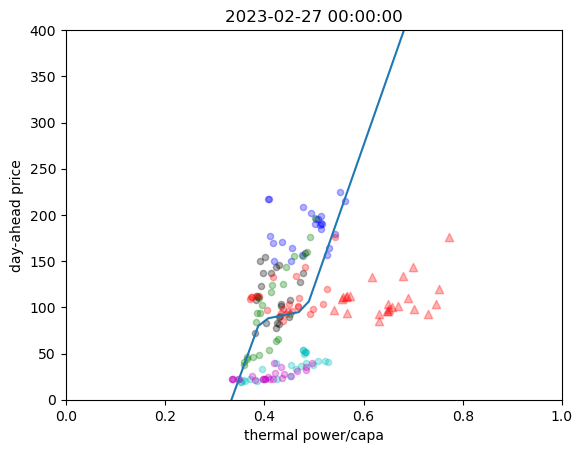

209.93696801397437
0
369.622750583711
759.2016943511862
288.68672730356167
3332.589908930774
388.1824129352202
1625.5920955155843
83.85997174111978
3647.010451955922


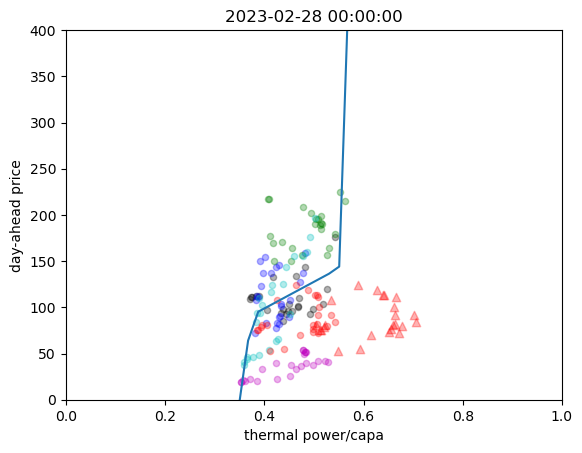

328.2260946193097
0
209.93864035397758
1196.488028422933
369.62275064459766
1648.3657798425838
289.10489736072486
4449.894960617183
388.1824129375493
1828.848768662372


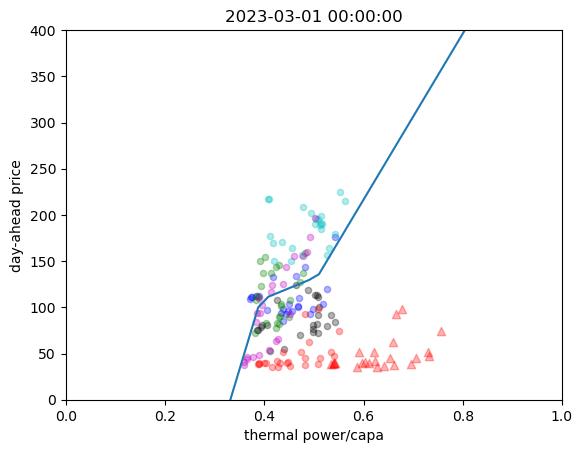

223.86254496786924
0
328.2260946193047
2054.7166902293447
210.21869180360545
3244.6724890344426
369.62275064615596
3575.80831779994
288.68693823476866
6522.211227857863


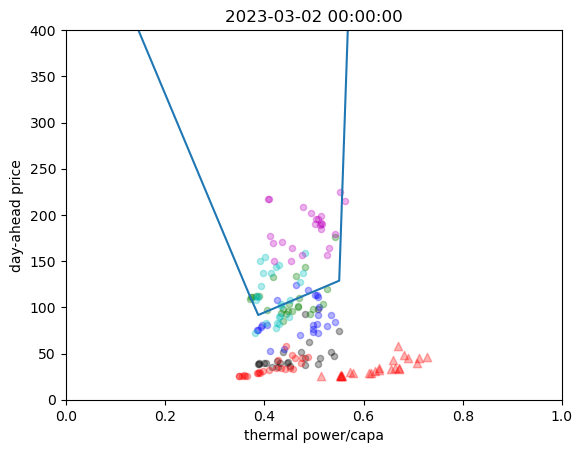

68.887773528046
0
223.8626744324192
386.1184228058677
328.22609461930904
2430.9216277141027
209.9957322002362
3455.9224644086307
369.6227499514405
3895.3680563988114


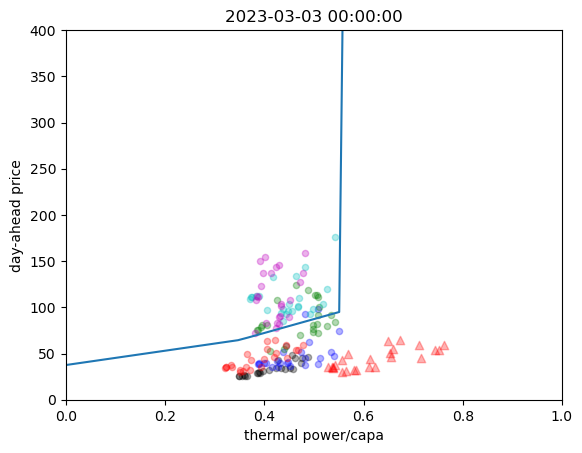

96.60586622447326
0
68.88777352803051
669.9424325370112
223.86254531128813
406.5710597323362
328.2260946193085
1641.2202032922687
209.93847477204355
2772.5800965969715


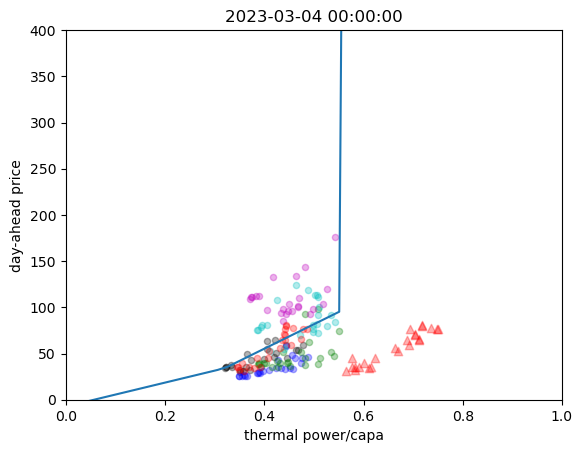

105.17083696287769
0
96.60586631191435
376.8739171114863
68.88777352982449
970.6447009936685
223.86255810804576
782.5956684235488
328.2260946172616
1017.9484571716025


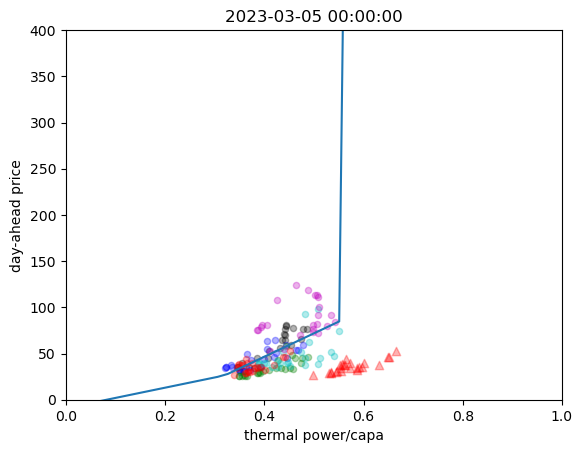

61.65626518845994
0
104.99588149931564
507.3697163070363
96.60586439530607
414.2237078272475
68.88777352826327
267.40189181374524
223.86353092363768
142.19009427089634


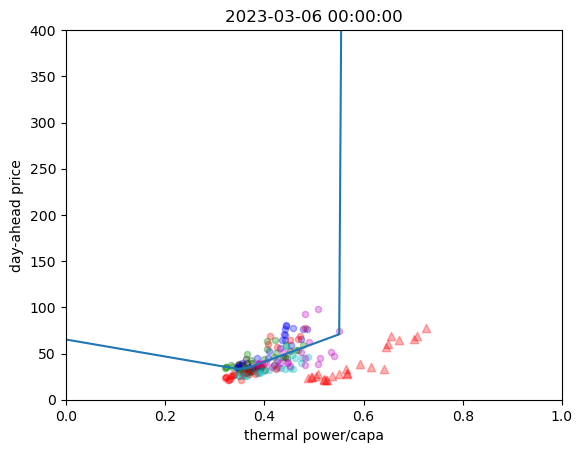

89.76829731066584
0
61.656265373434266
544.8453034421955
105.18577652089233
276.0615401406692
96.60586619160068
369.42155398910734
68.88777352870176
771.8505044816793


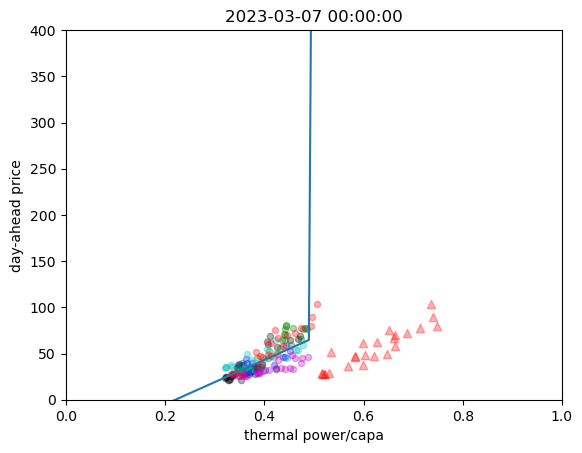

111.68055884048306
0
89.76846099805879
269.3838986788095
61.65626518856189
615.0488179870911
105.18530601923075
206.73794303063494
96.60586641696065
406.6230240587848


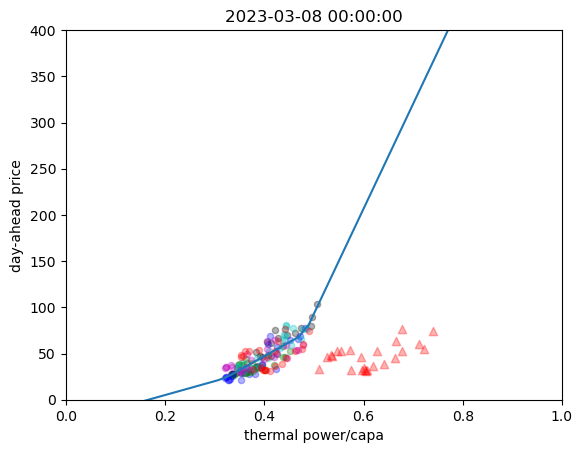

161.54509697038918
0
111.60086681587431
618.6849250893711
89.76829212209348
568.7322104153304
61.656264325430556
398.4414066814852
105.1832157437093
541.2979173101355


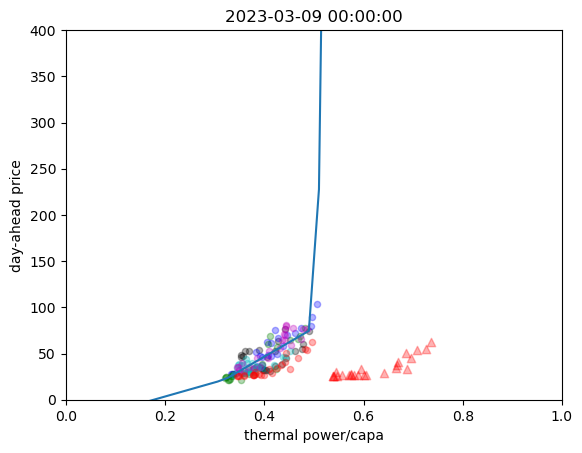

42.48499018523349
0
161.54646550855804
667.9788101398183
111.59466320503218
1038.2777698720772
89.76829296441863
743.6370695195902
61.656265035462795
331.3079423379144


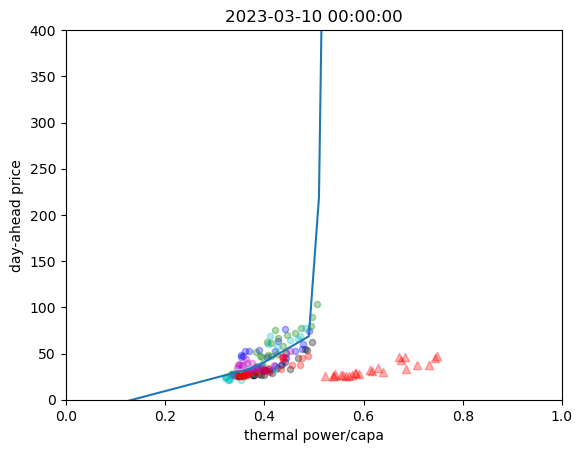

34.15797146034234
0
42.48498991953018
138.53281491713648
161.54506031262866
682.3407276966602
111.66417947437972
1058.2422523132234
89.76948740106991
758.0218686860878


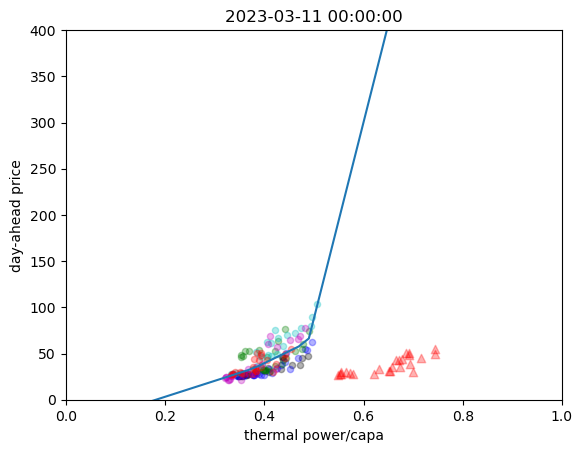

96.81549571505707
0
34.157971460836286
336.13599322201594
42.484990245221155
393.18704656370113
161.54582462599666
397.0951433867052
111.77916396493582
496.15813293956387


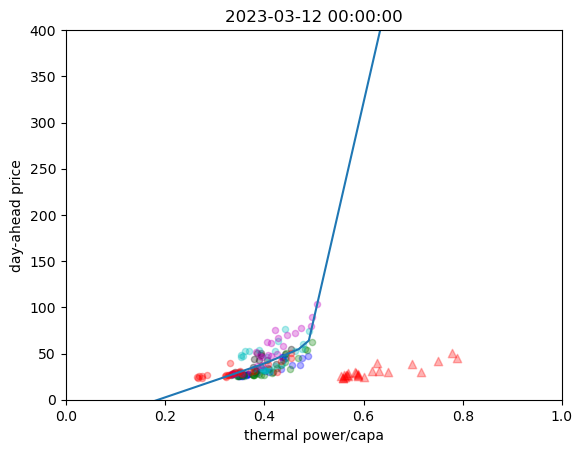

47.43814625812132
0
96.81548531315282
214.2177876329076
34.15797145998033
123.39069405566593
42.48498979350265
190.87269655760514
161.54504159726213
510.9116116660274


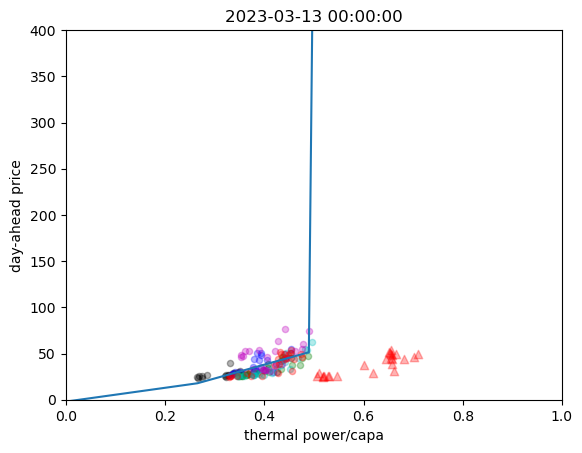

79.28291989955778
0
47.438146257927016
107.35066549790055
96.81567774189338
256.18937032510115
34.15797146033863
111.95481564283946
42.48498973286604
163.1104296498811


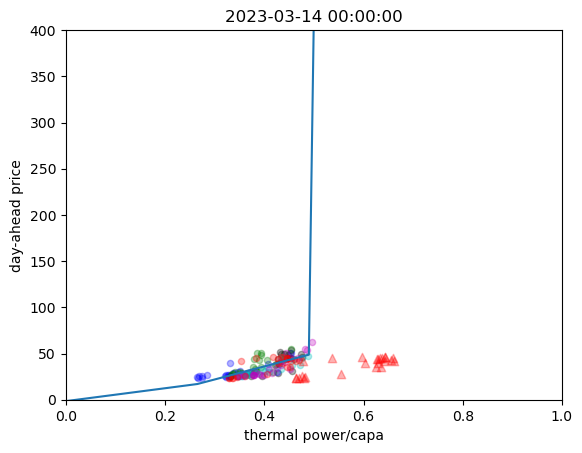

90.7757598617668
0
79.28292397622249
291.6422621519903
47.438146257902595
262.47591598998144
96.81577545846088
180.29817137875565
34.157971460424235
326.486674509307


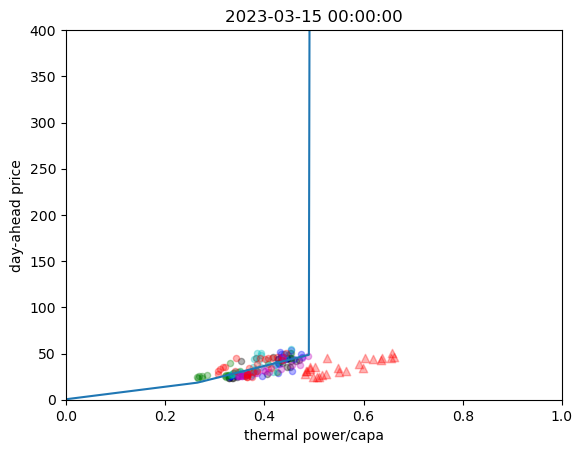

84.99924353169183
0
90.77575986174705
358.9860899179028
79.28299286597293
325.43665656788846
47.43814625792668
303.49360221631616
96.81547376435628
312.4243299577051


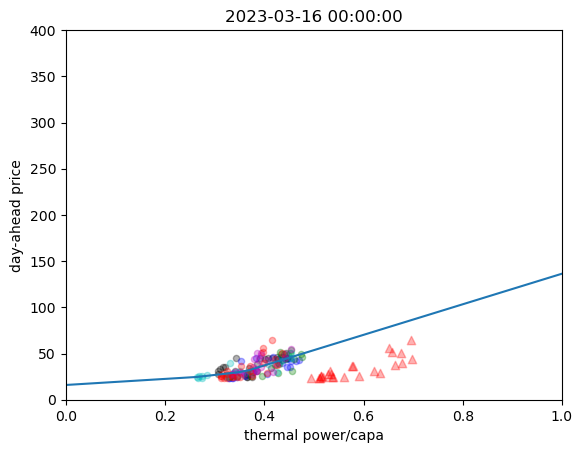

121.58729539516202
0
84.99257737369766
331.2439436854651
90.77575986174438
263.168686867518
79.28292994668426
381.89550685378543
47.43814625792801
317.217905955251


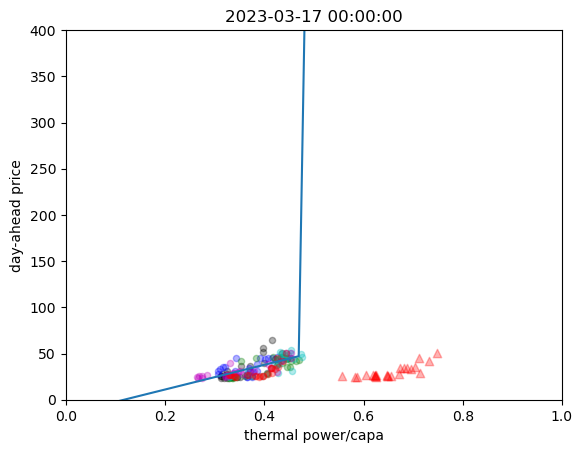

34.70721745899729
0
121.58729539516719
410.70311647556576
85.01218015300444
427.1466624302847
90.77575986175874
416.35290799940293
79.28292792373665
145.8868117778666


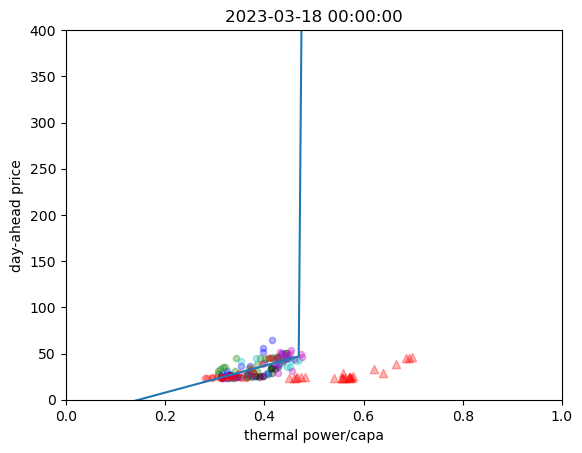

22.993758179660052
0
34.707197535052074
326.0676177590947
121.58729539495033
170.00537644513682
85.01362358199593
308.59500685452696
90.77575986173227
308.76051038653765


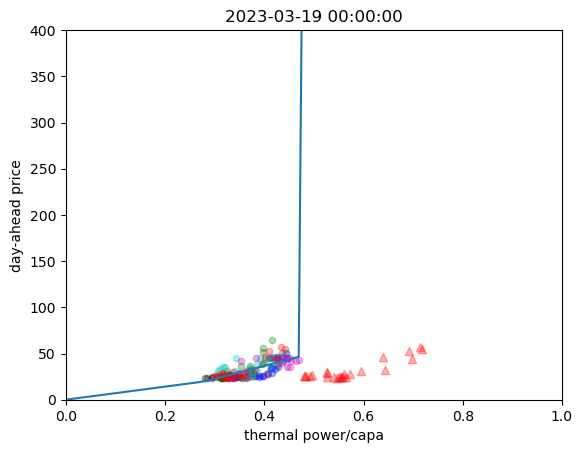

46.42376393634298
0
22.993926553016024
117.62292023272927
34.70725325016303
421.8978062371041
121.58729539516366
172.40041196074756
85.00934146483719
324.99893768228435


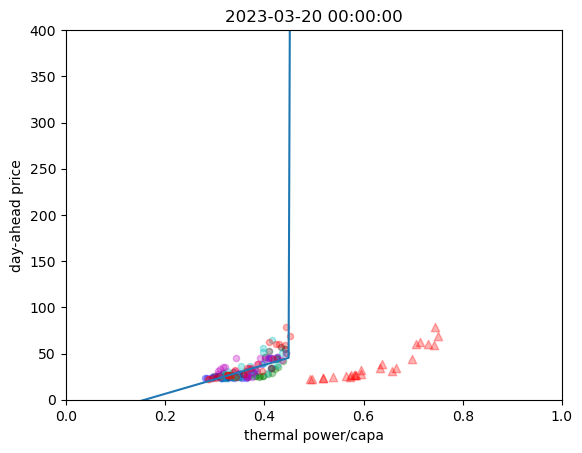

73.57030216392538
0
46.42376459399174
196.86399633469185
23.01838430319761
201.99049971881888
34.707253214025215
609.6130403823547
121.58729539516864
280.0561654389138


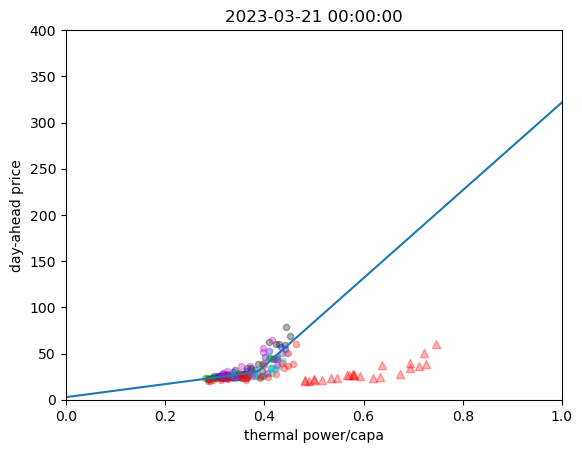

68.17983203519722
0
73.57030216393068
575.2614520660331
46.42376391675642
446.42869821204124
23.00574930775459
274.0162423773708
34.70723172847737
140.94442846497736


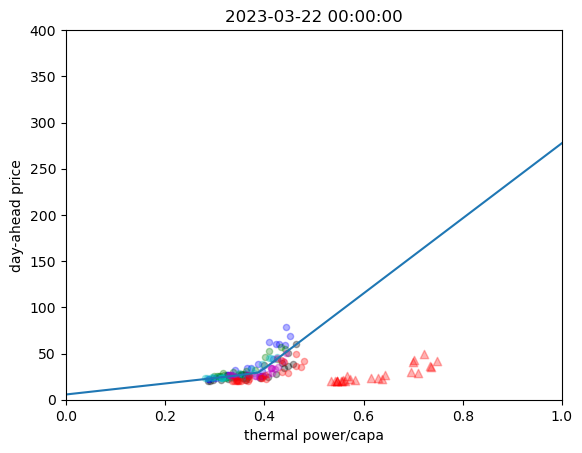

58.529967724618004
0
68.17991719330514
199.2724535266752
73.57030216380446
952.458868500177
46.423882278777626
692.3000626649961
23.01263984500322
545.4462410972272


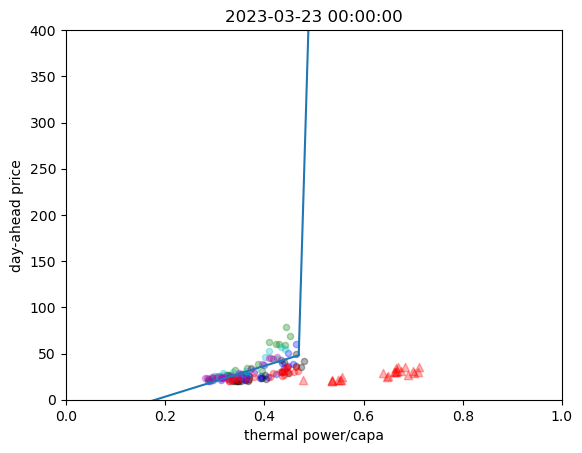

34.693479788614695
0
58.529967724628804
178.7944650957208
68.17984066295655
225.0517208605105
73.57030216392366
890.7667017931632
46.42376390760538
667.2456352824203


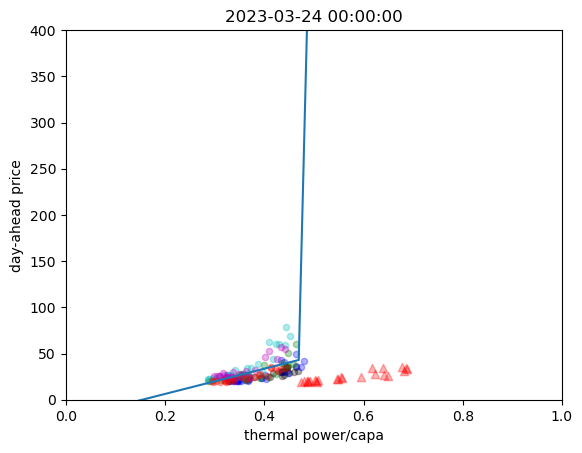

23.269284903623742
0
34.693483208533266
113.21684795896155
58.52996772372707
105.2623077084541
68.17982766465187
100.49515121119902
73.57030216385732
619.1851296244928


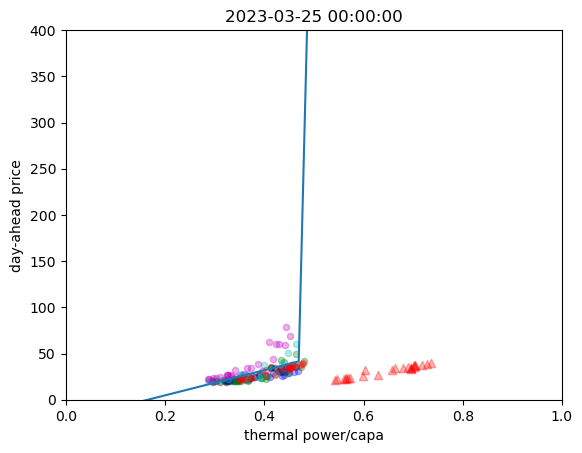

24.76444624069709
0
23.269284903765428
80.59853370610207
34.693489535282154
78.06637711908434
58.52996772457005
148.95107091138323
68.17983661112058
167.77529624347966


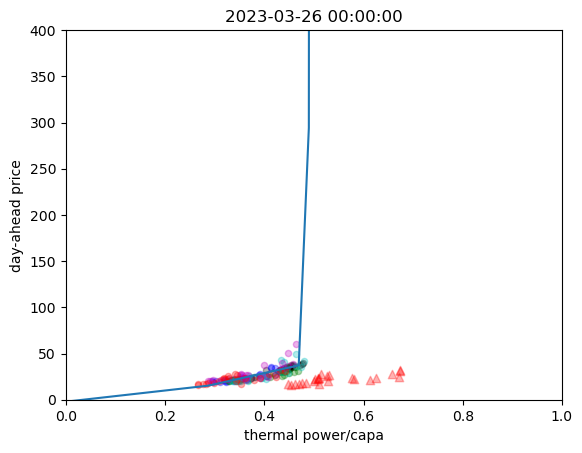

35.31884588174794
0
24.76444408716211
96.81406149275378
23.2692849030824
143.96833050549355
34.69347987536284
83.49332786913251
58.52996772464313
142.7623502085333


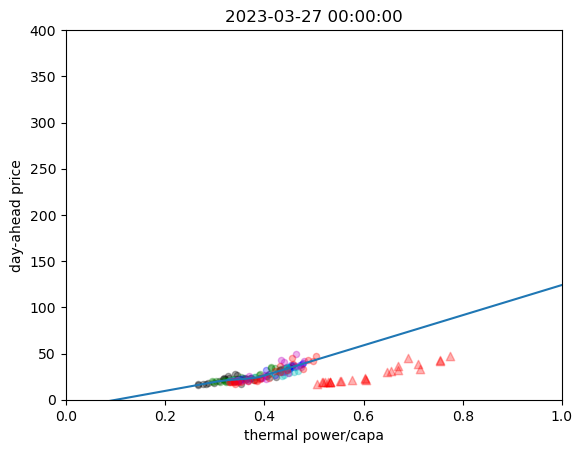

42.19388116066304
0
35.319057016706154
111.89406686264837
24.764443826384078
126.98022565558654
23.26928490362798
186.68389378968868
34.69348003098682
157.95346033705


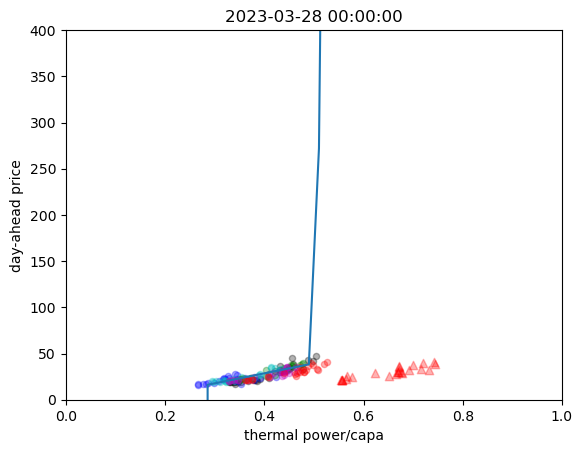

38.38270913928142
0
42.19398153395949
273.35603398494356
35.320733469675716
90.11594694360966
24.76444389315318
231.82617377689394
23.269284903618836
237.4111736061383


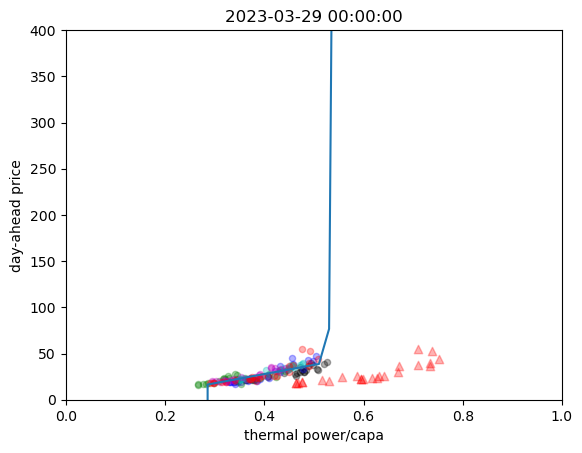

48.37937484688429
0
38.38271298551841
243.3408025921922
42.1676967995677
152.6925259932067
35.31623662182986
106.79495495117291
24.76444409125316
170.36916364254432


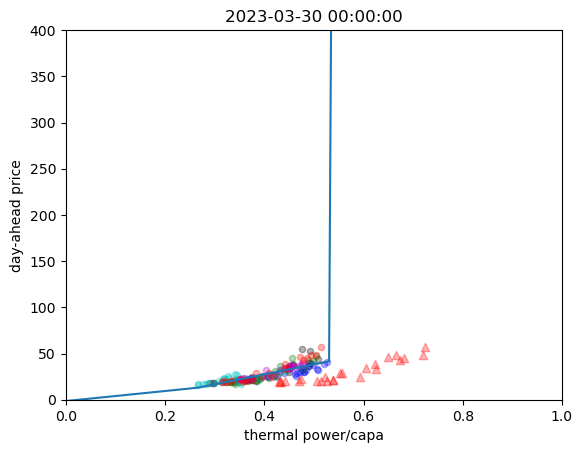

36.633736626627396
0
48.38497858077139
133.86313386921222
38.38271072965735
367.92536315204995
42.19392855010581
107.61614814101503
35.32178184192817
90.64394927415628


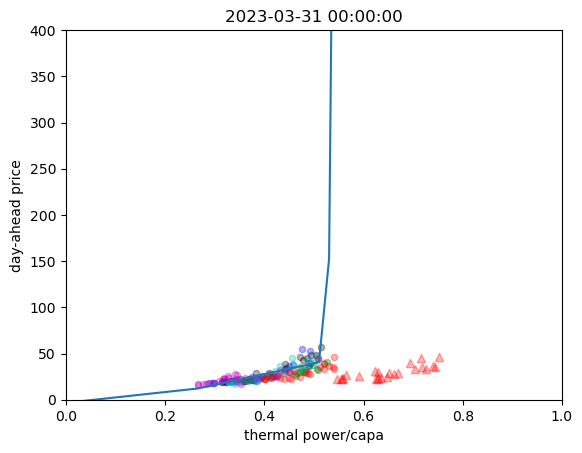

63.33975825845188
0
36.64969565888039
571.2816235124811
48.37930798441941
422.5619719612436
37.980712512571856
113.64636561840963
42.19436962285861
441.31861835104985


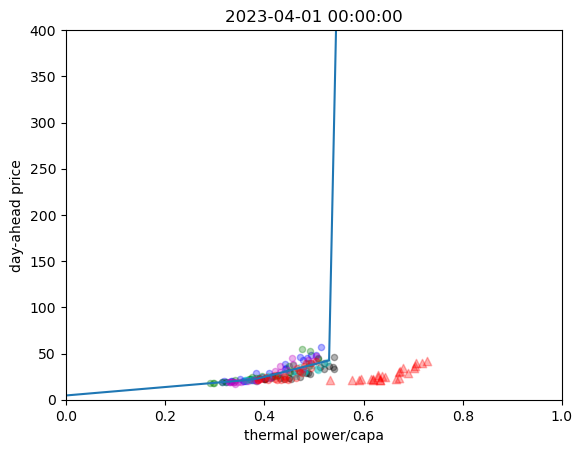

43.333361561523304
0
63.33975825968133
146.37661374259002
36.64825662520666
445.617557195779
48.37399014852692
330.0950212078095
38.382707268006605
135.37667106625275


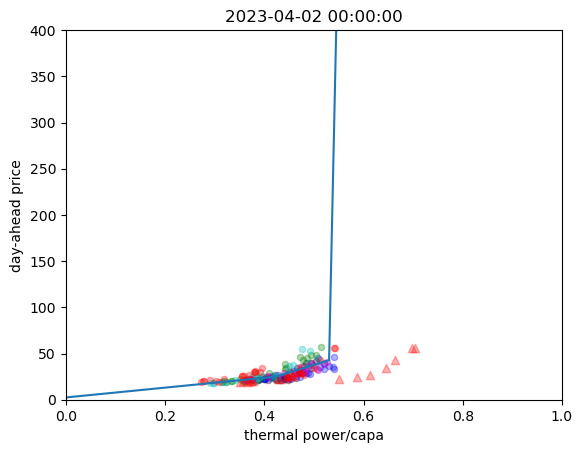

31.851511739460936
0
43.33336156172973
370.4216894290372
63.33975825912674
329.86916032043393
36.65905358277524
458.3387212485356
48.39026261473114
406.7500715691344


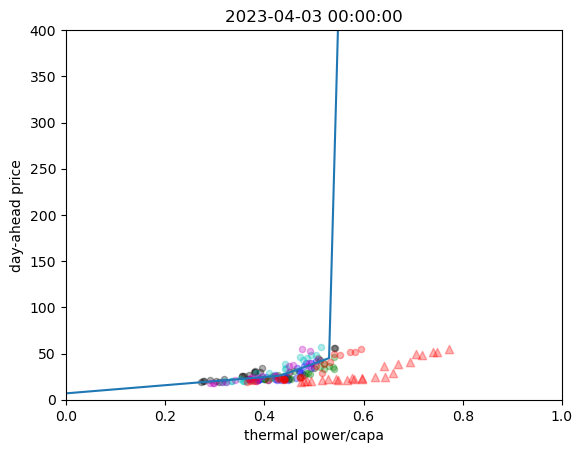

27.14382973363794
0
31.850656940157723
359.3415371150464
43.3333615614808
201.6352415016833
63.339758259656165
143.52857716668515
36.64830135515011
590.955499387597


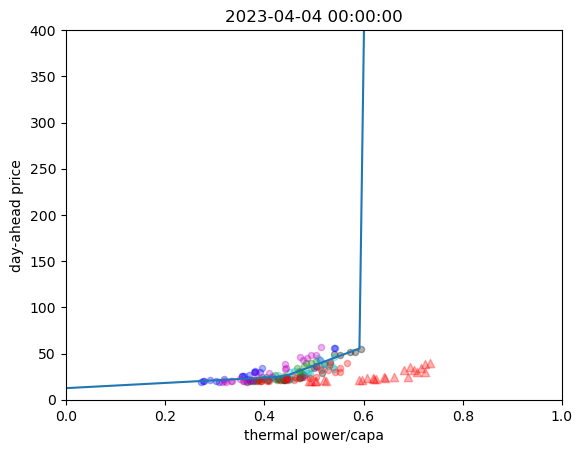

32.5080951908281
0
27.143829146660924
194.8778652928368
31.850655490789535
452.3238959394333
43.33336156157196
249.15309157826715
63.339758259645
191.95129371749601


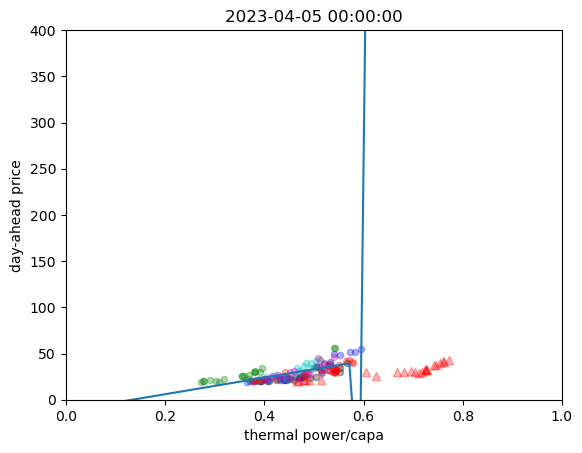

30.12193009918545
0
32.50809518923589
169.7166062341746
27.143828774299372
234.58620362109065
31.850708058912407
442.8498239256346
43.33336156148366
172.19957277245192


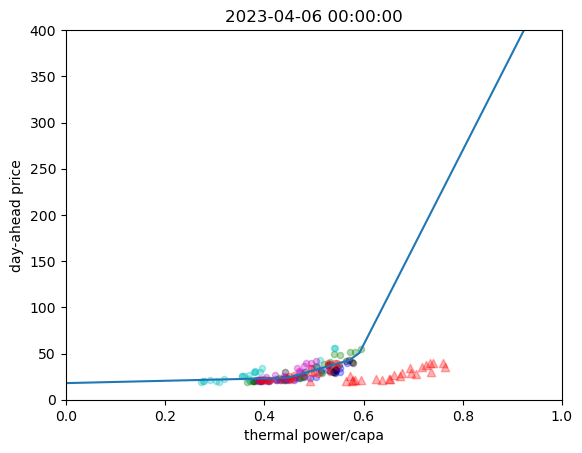

41.82365392205101
0
30.121930645111664
99.80983713086064
32.50809518887553
96.38131447649116
27.143828782640796
113.28886413634218
31.85064598311149
394.419346636243


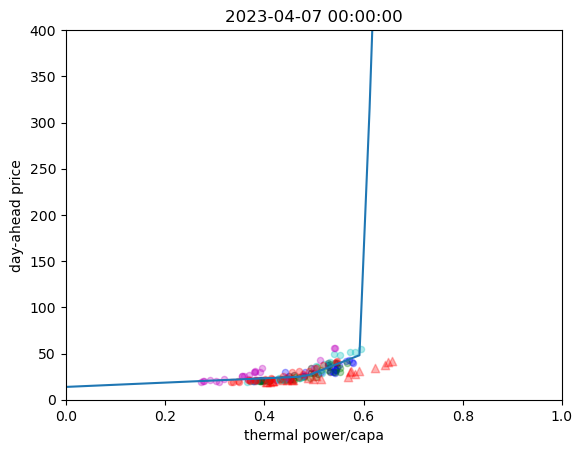

17.362287212924123
0
37.96726087966759
132.5865696722667
30.1219381623904
127.98929267087168
32.508095182723245
210.97452155738802
27.143828790491412
133.70558079867536


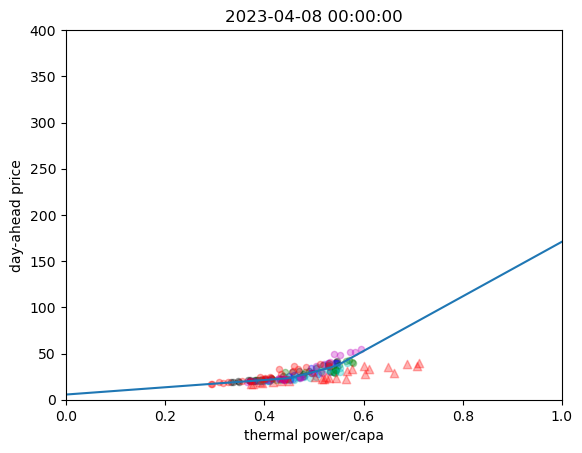

41.77951614127625
0
17.37427395291075
96.0994877854163
37.96725995271304
233.42472238877224
30.12193125940452
194.11105079332182
32.50809518887975
303.836002336467


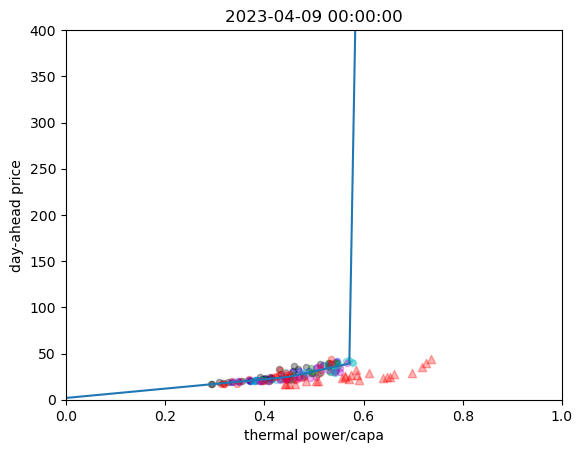

41.89972086908375
0
41.779512482015576
156.62399299928498
17.361321419108915
129.8488733464792
41.823653920323004
152.81869984942773
30.121931400726748
153.79761132910184


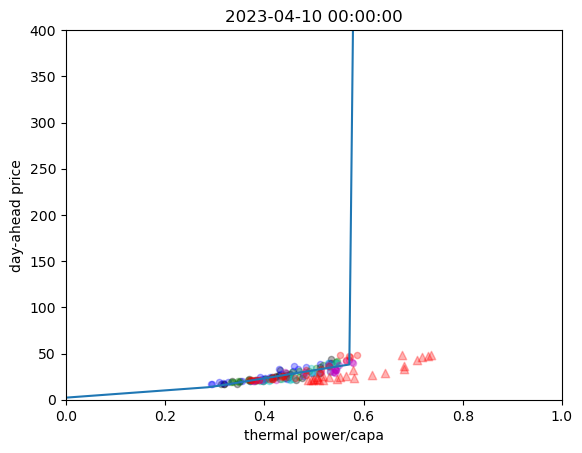

30.361835302452146
0
41.899720926209
114.58803697478088
41.77951772159176
157.88023405106048
17.371552862806386
63.23487432928134
37.967259950921196
94.11440403680874


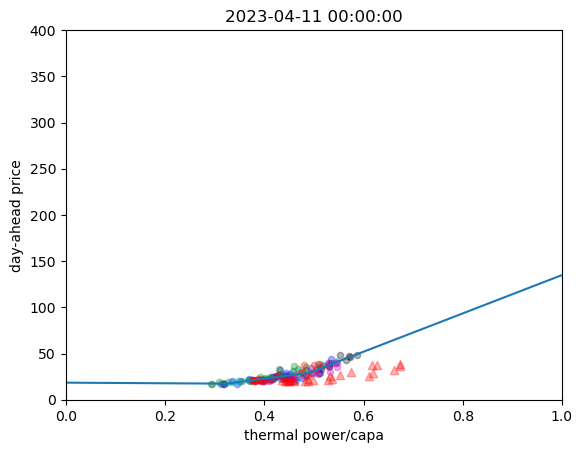

39.44212791963717
0
30.381575918873075
98.44248407415543
41.89971756582304
201.00781576859308
41.77951549065588
124.75801738389424
17.35126058219126
54.24617887032939


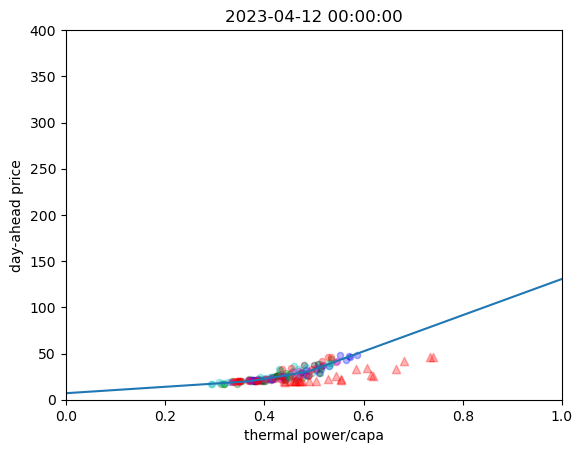

44.57016792122452
0
39.44212791971033
154.45228790487107
30.371477694506183
172.54741664409053
41.89991418804571
113.26245295903902
41.779514408446616
153.6958229784675


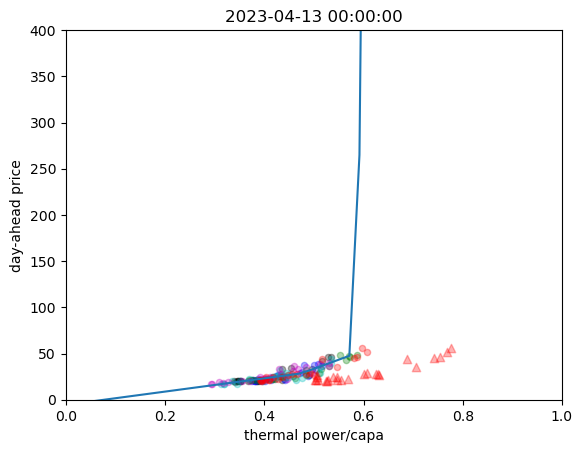

39.96478736000458
0
34.7722187810608
125.45964953734348
39.44212791963091
96.24429231886585
30.3815909717674
52.29255445103462
41.899693849041014
135.58087930555422


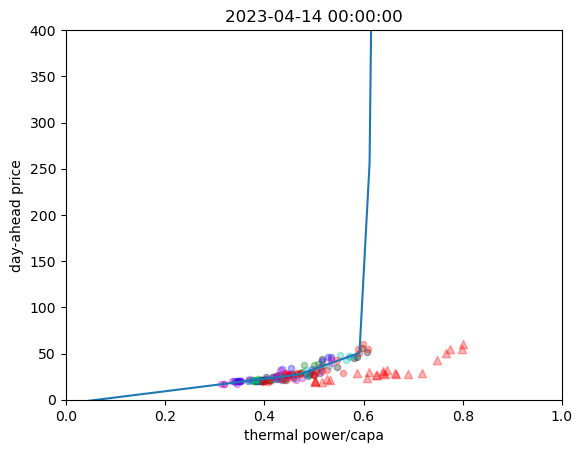

53.06121298465396
0
39.96478736041183
165.1490552880396
34.766848097103704
209.04548284825626
39.442127919624575
122.99861445823004
30.38156737430649
140.8993649919239


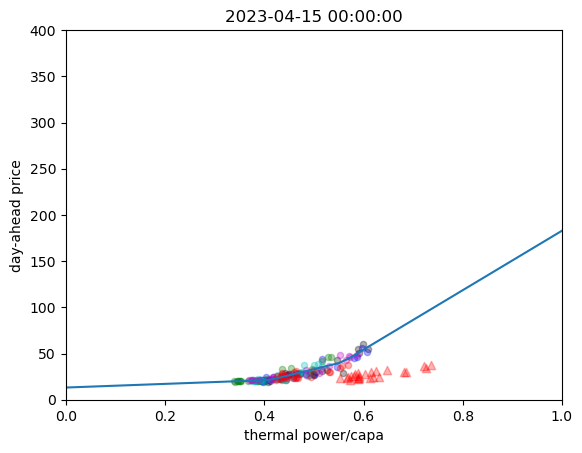

44.376008482067675
0
53.060992892093545
72.59762896926615
39.96478736041868
205.36555149000662
34.765700810571325
274.13476350746646
39.44212791962852
183.01223487925324


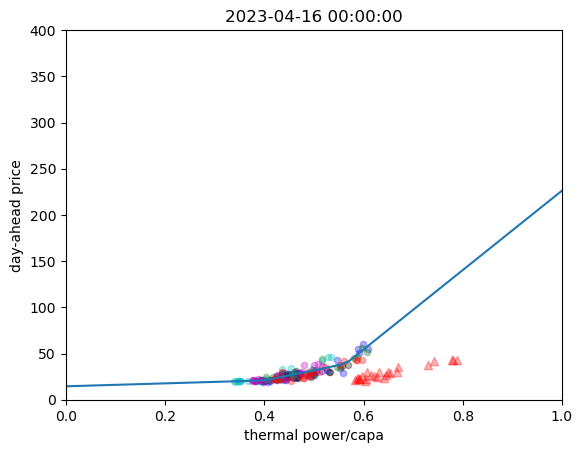

35.345793650675326
0
44.37600848681723
135.81052891057234
53.06121653768791
139.07297547864383
39.96478736037754
207.02578108625556
34.77031392850403
299.91308975335573


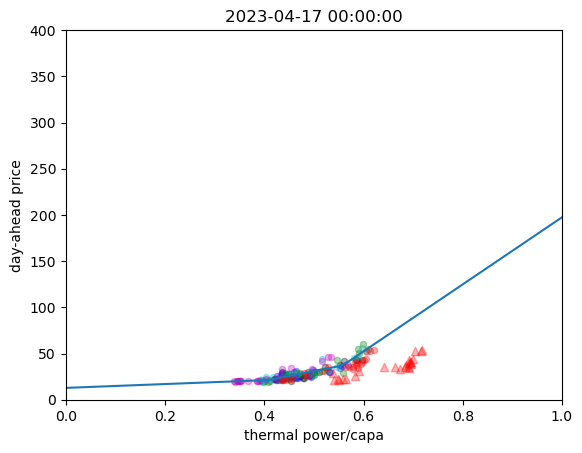

36.445000572234484
0
36.404997765813874
149.69689444423062
44.37600895907544
70.83036413247534
53.06121296266206
200.9247819818312
39.964787360122585
285.53925544178963


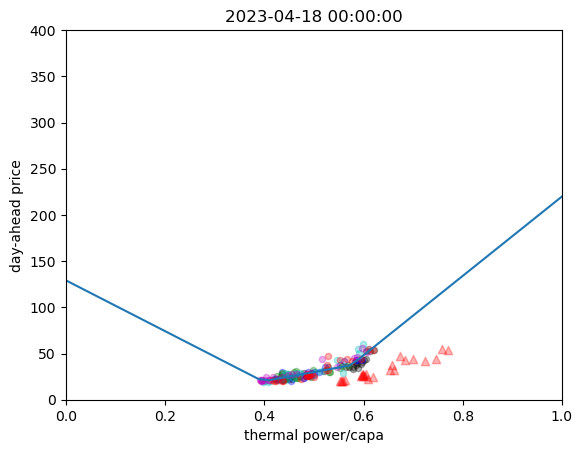

43.502590564456035
0
39.66865625175932
215.81425126660386
35.345791469591546
152.7714785522152
44.37600878906831
201.78076655322832
53.061149776056
213.67238243888244


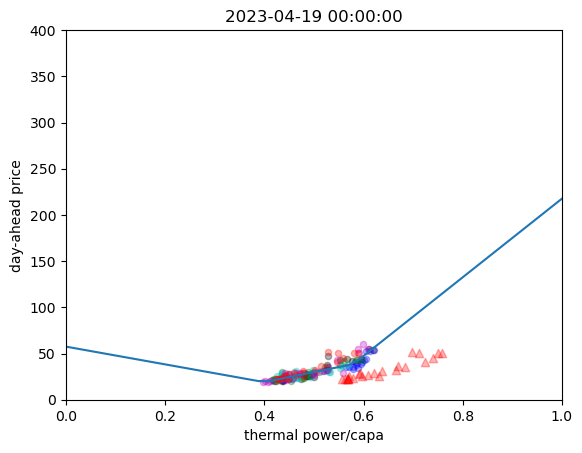

43.63640230191767
0
43.50259061170772
227.48194845815442
39.67977366730811
355.70931630606435
36.404764838139904
287.80967730835255
44.37600871215578
311.5976607213524


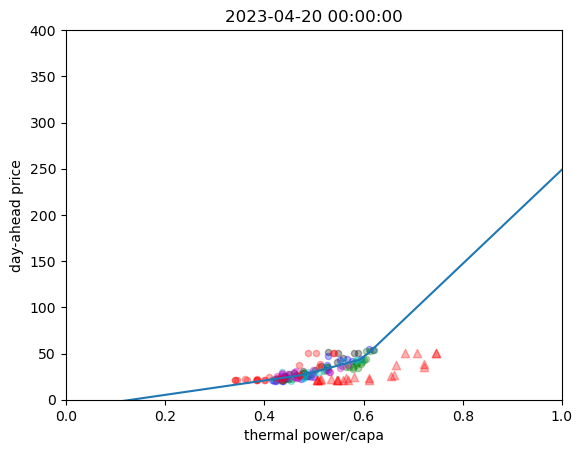

62.305689339255984
0
43.6364023014007
288.59959726616324
43.50259063035696
429.4052246953822
39.67992842012765
464.1440285672718
39.32298138877328
432.2150944725142


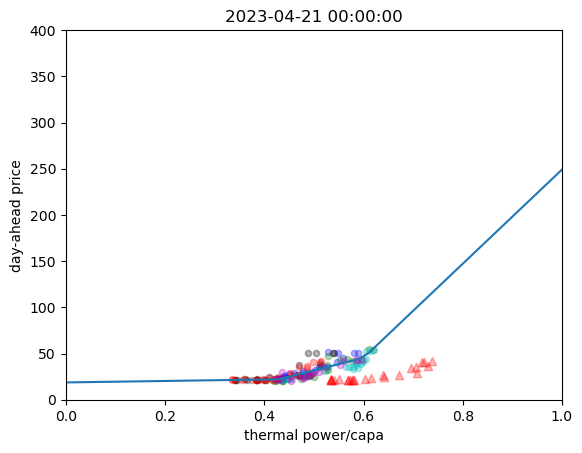

24.992273072128295
0
62.30597733065457
119.47414306371383
43.63640230133086
186.9451483429846
43.50265853202204
374.03547861324034
36.4461463396981
370.03744846282035


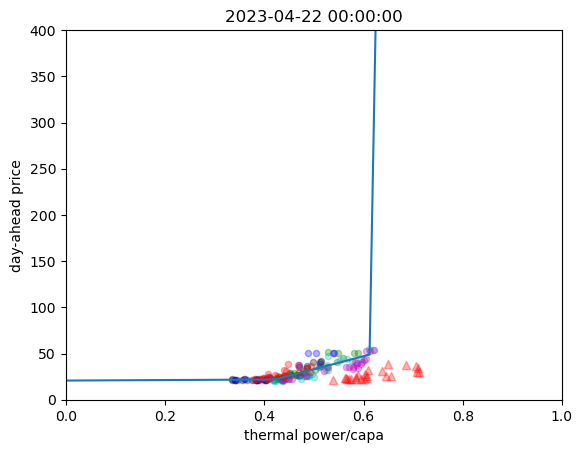

39.6374519991504
0
24.992284416871115
152.84712127890563
62.30370678655234
264.92177559381724
43.63640230155569
280.5654777495015
43.50259061556282
436.9469875085429


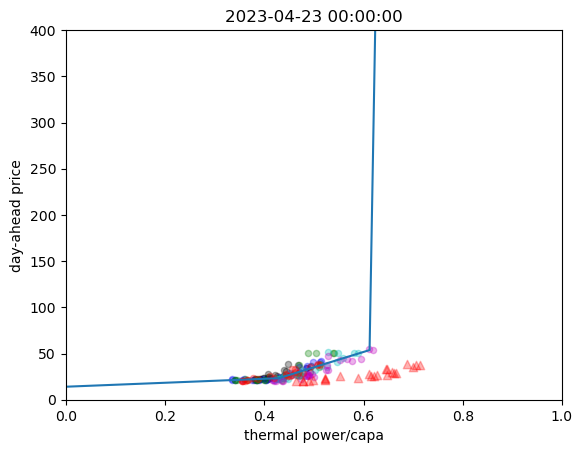

27.746240642902347
0
39.639187488898315
121.28180099465877
24.9922843311329
90.75611467213207
62.30917074444031
187.15068694917642
43.63640230172503
139.38047505014424


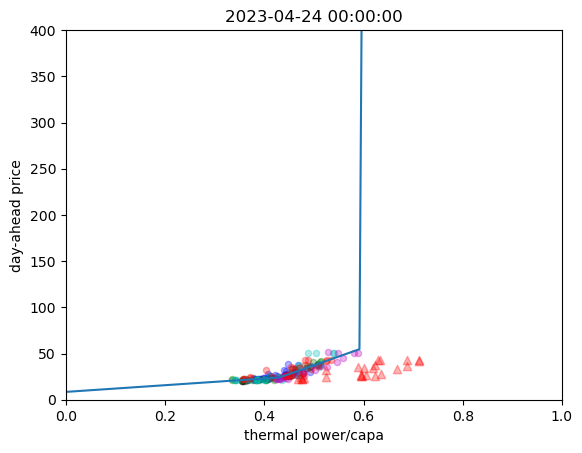

58.47580901399533
0
27.746058770535868
141.62402593041548
39.634243023290864
186.31945942316744
24.992302291014518
135.32211193280128
62.3064364705664
241.11020941672558


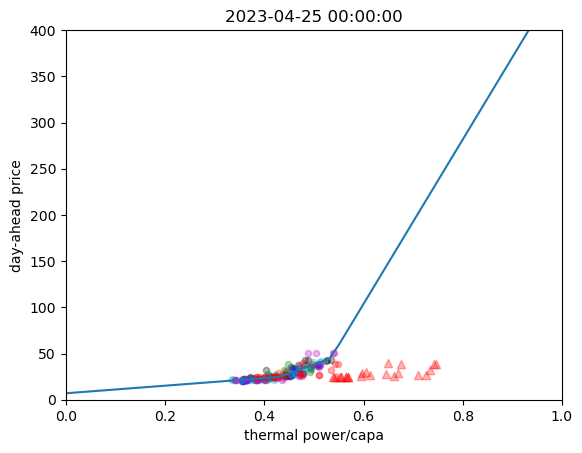

51.964139992848104
0
58.47581094638966
264.1821725973253
28.914209590154993
102.93632626347679
39.6419097083841
106.77408547669394
24.99228422820647
187.30474420440945


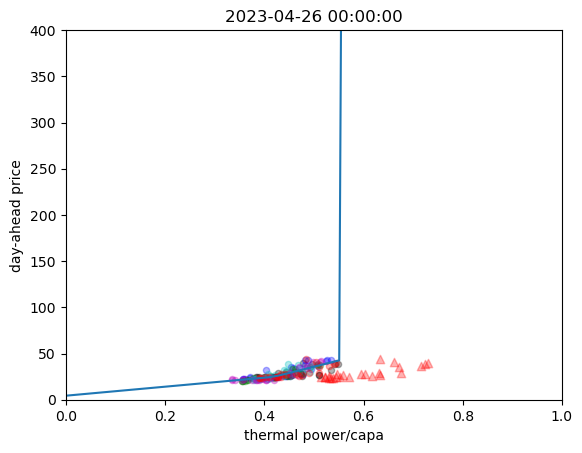

44.25914850952535
0
51.96568658031617
172.41760090006733
63.20967452508842
157.85169883224484
28.914209589700274
65.74087830673906
39.63533735048675
179.380822498718


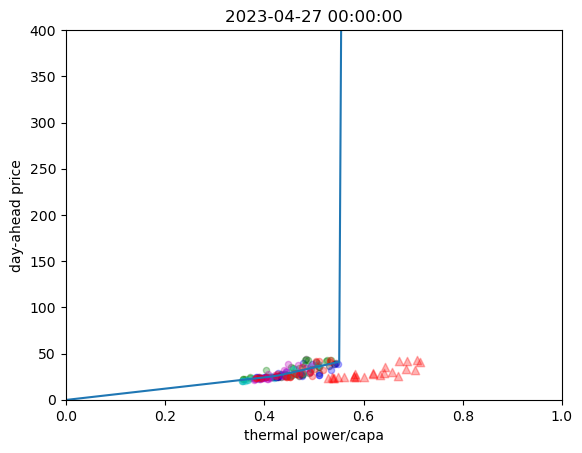

45.67400222157142
0
44.259148509890416
105.13609524341004
51.96562781161444
190.30145251401927
58.47903340381881
186.83668665802057
27.746371987852807
75.79793919699756


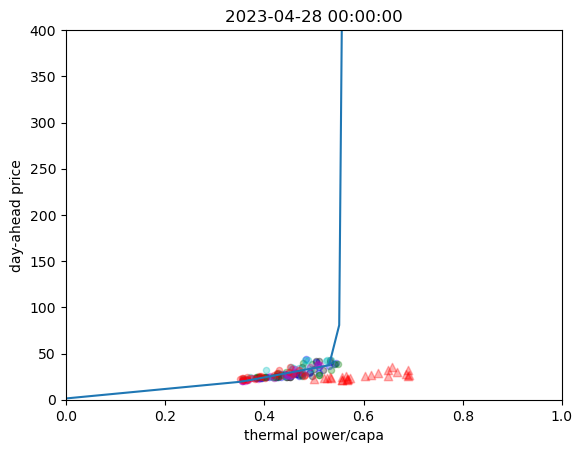

31.72479412383803
0
45.674006292071624
117.69918873934625
44.259148509778804
147.83657199477912
51.964560101548145
83.37703246020871
58.47581017219319
142.5684196379267


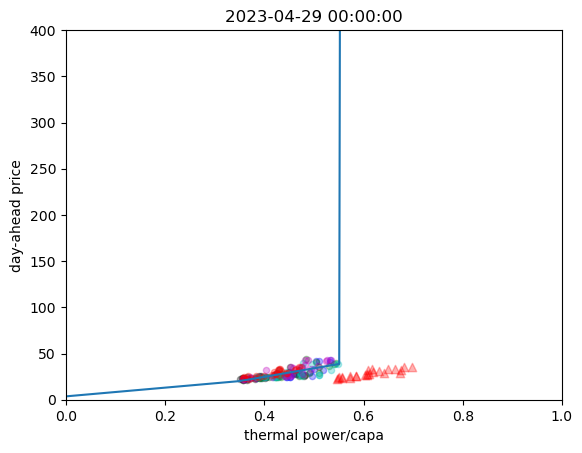

31.14586426378324
0
31.724745312492708
74.14705555219719
45.674004735184866
173.28362552985004
44.25914851008839
203.7606492651417
51.96364147636078
124.07063227330633


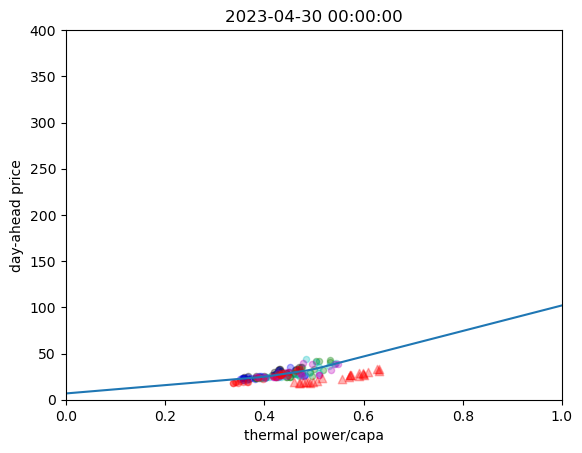

16.243391587902003
0
31.145854031978228
130.17887605539332
31.724883838519364
87.44708774134483
45.674005614806646
81.92367280152433
44.259148509786115
100.67510861625293


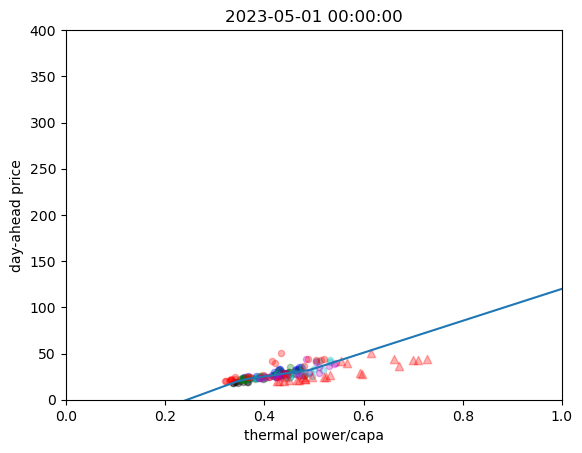

63.22305635619992
0
16.243392986665658
339.104385388569
31.145858080642082
239.69525418028314
31.746348838130753
292.16097649361745
45.67400408788855
399.89503563216374


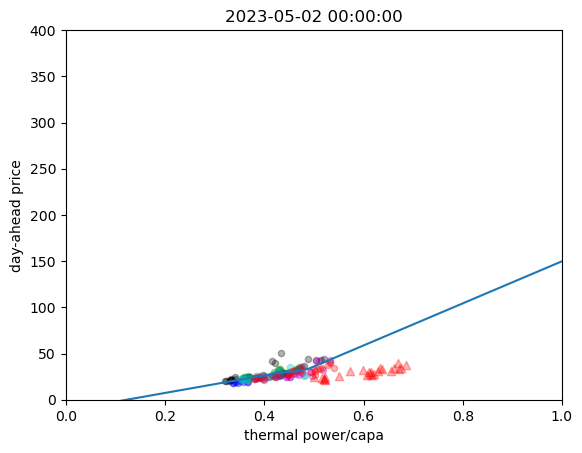

29.375288960429874
0
63.22305635471393
416.5824004111088
16.24501679191664
51.47170913536469
31.14543075129915
152.96989001999157
31.724719189466278
102.55981957980897


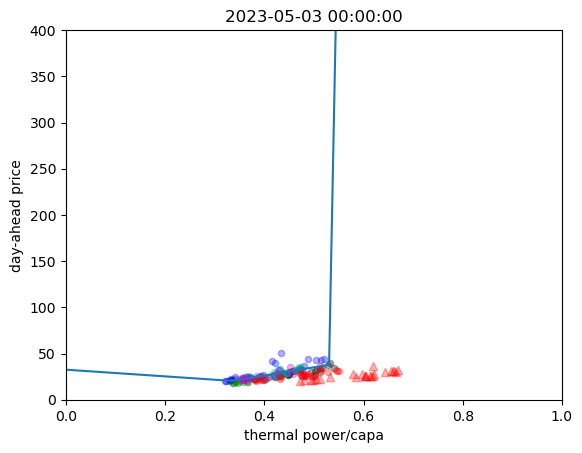

24.31495332649023
0
29.375267701280354
180.80829016168497
63.2230563559955
589.1663867035708
16.24339472136626
179.40380782005383
31.145936562735162
298.54009153424073


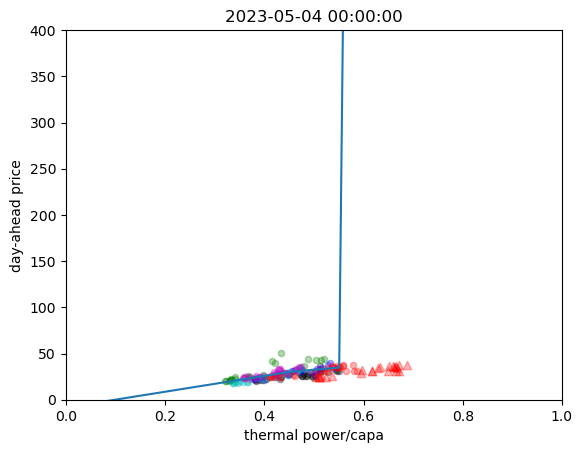

27.552059612635823
0
24.314952945497783
130.56265741743994
29.375276522715794
101.09334367398823
63.22305635599733
472.4176892859878
16.243394061976467
133.64481549287117


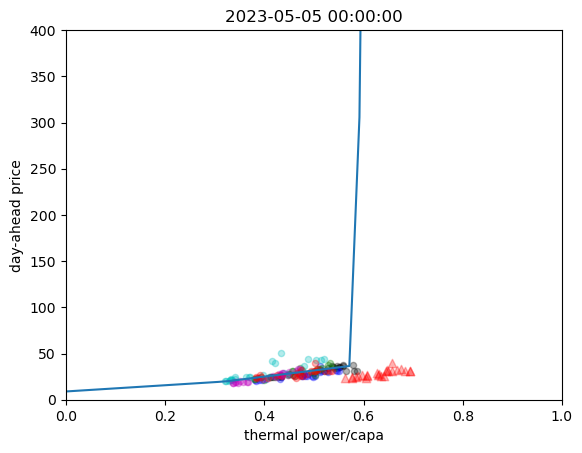

35.524910142576346
0
30.736685583923055
65.6800574794094
24.314950236116267
123.69723968190527
29.37526749255667
95.78983636835717
63.22305635595009
441.05779154306254


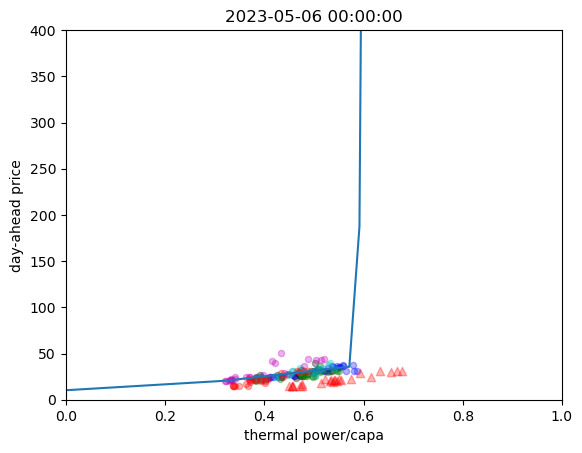

27.19296674051319
0
35.53808394355814
140.66383454649161
27.552057450357495
83.27099387085549
24.31495238481148
131.2457372738486
29.375264508131952
83.60572359414311


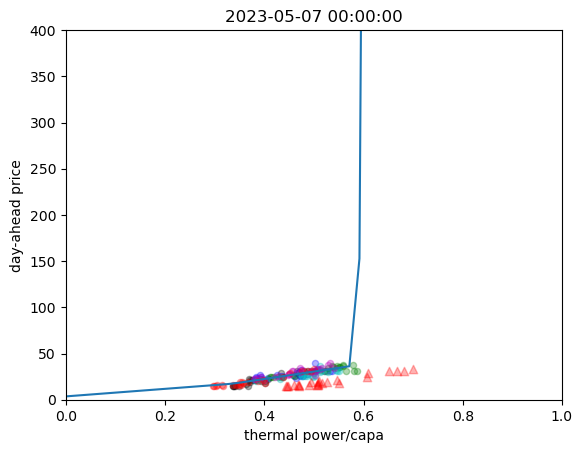

17.628889384392757
0
27.192967030881164
58.41734952806136
35.54134634545137
170.14223176448212
27.552058399136897
120.12456549053826
24.31495553575823
162.05876622642808


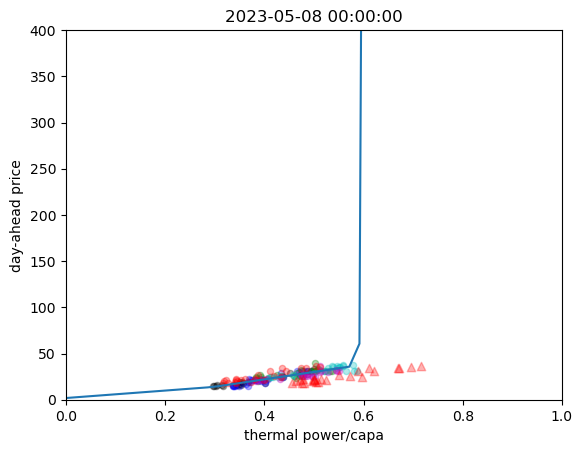

41.41358386030966
0
17.628899018575474
196.9517060186201
27.192966697192062
183.50420426113794
35.56980031858879
202.05288206432135
27.552057098003722
253.04427471394726


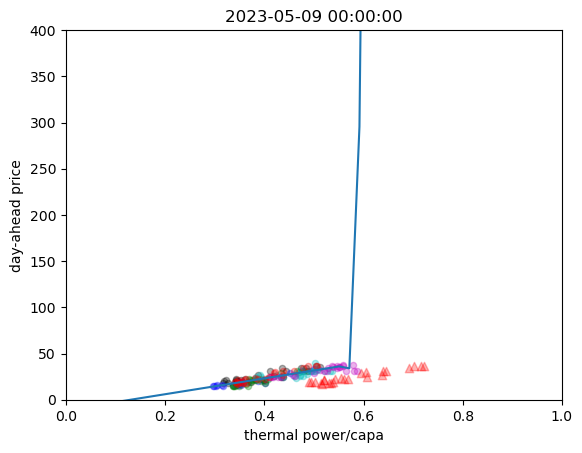

26.575098477262028
0
41.41358386031237
32.224280347607376
17.628913786179375
177.01183302729095
27.19296668880105
147.0308861758711
35.540531090353646
206.93013896288517


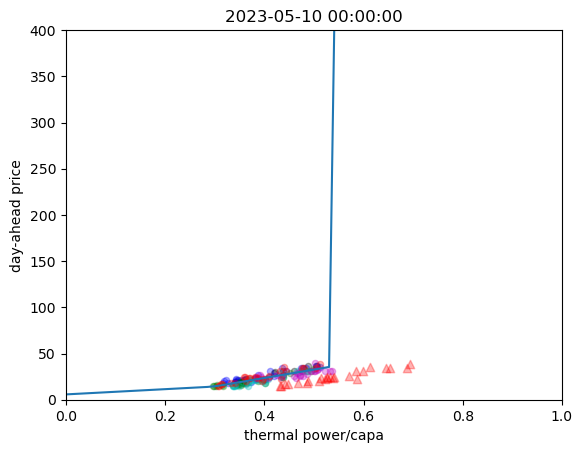

36.58874681811362
0
26.57520094001241
64.05595568657577
41.41358386031689
60.184997966544856
17.62888913361953
175.2759665093991
27.192966130262604
169.99170436889227


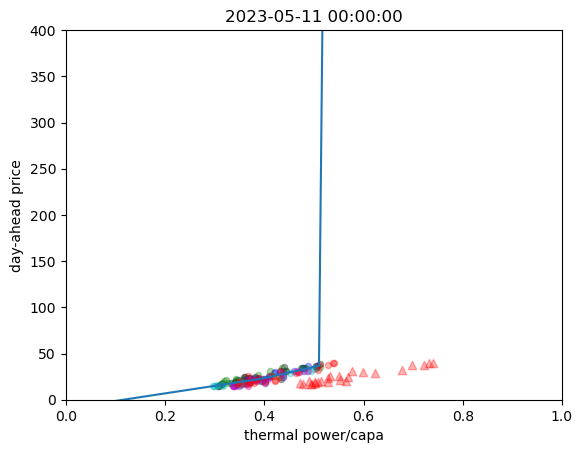

43.87611295786744
0
44.090330195432415
130.51946804588772
26.575098078378435
99.07242461788674
41.41358386058717
110.02194158575017
17.62888926570583
78.79892257127698


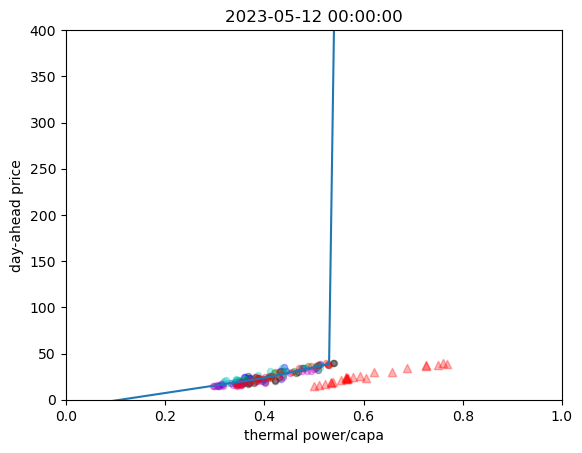

30.097001408208314
0
43.876110964874385
82.89554375094278
36.58874687545997
61.610640413651836
26.57509869878485
53.86938470523989
41.41358385986222
77.11779665934917


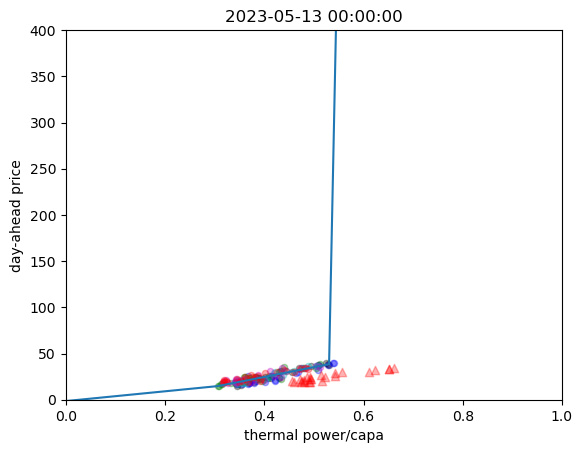

33.65422723011726
0
30.097104478357323
120.1537902379616
43.87610981278182
165.80571488902524
36.58874463619436
81.97690476055277
26.575099091609587
75.21088067252148


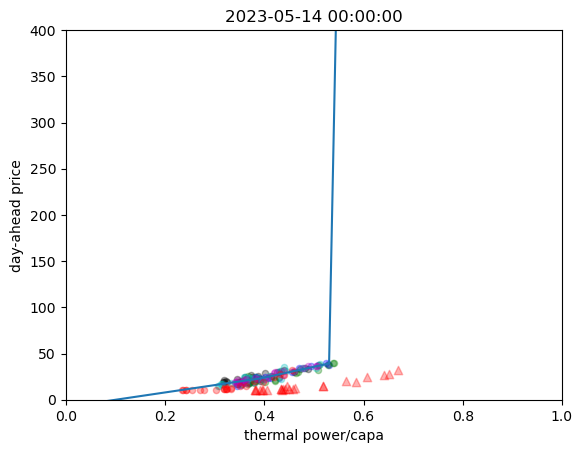

16.933056556322022
0
33.65422722986614
278.86017897816413
30.14212112922653
104.77596293131467
43.876109995625704
93.69036326106436
36.5887465836272
209.4927258410326


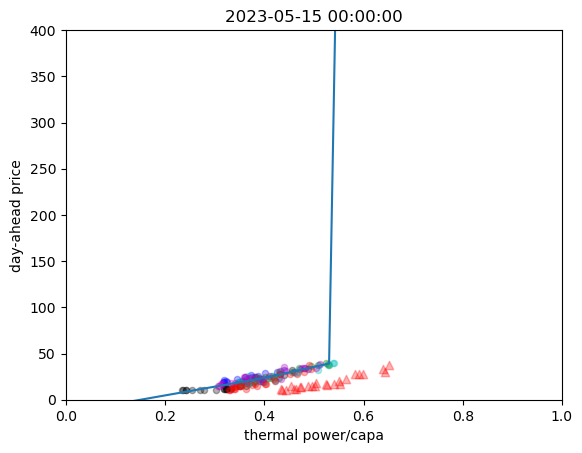

35.69568574633799
0
16.933022891227985
106.37225084292625
33.654227230139114
314.26019497398374
30.096982080118636
186.94183177084096
43.876110275777265
136.63271610701227


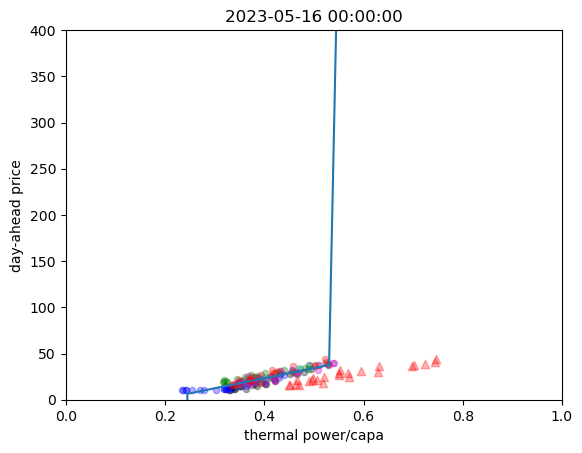

39.918354293200096
0
35.69262586495143
272.5737931436661
16.93302526321229
189.05706673385453
33.65422723014461
85.59252785291196
30.097013593269885
126.09493958195696


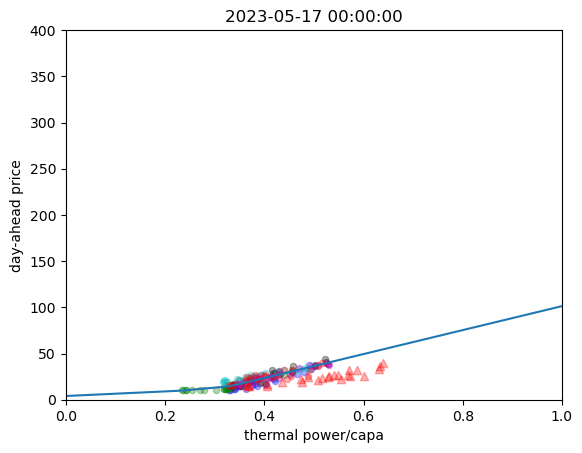

53.11490110332515
0
39.91835429320035
176.81843482243272
35.69273488832907
212.4628399699171
16.933024733318383
158.8433873475663
33.654227230138375
165.85133373375893


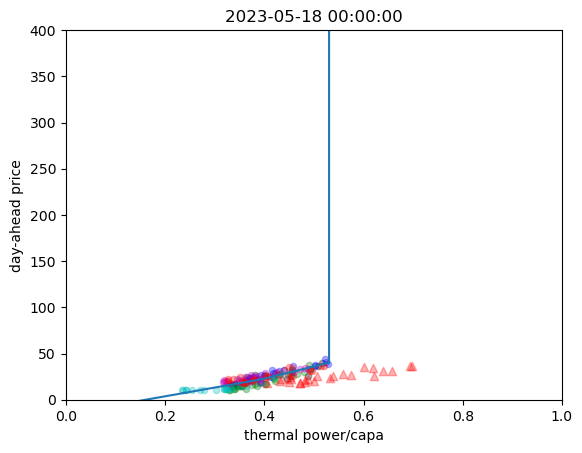

41.3372238965051
0
53.114901812090054
112.52065147235751
39.91835429319873
153.54219043319304
35.69650349933925
219.8128912086943
16.933024739493753
186.6204047189601


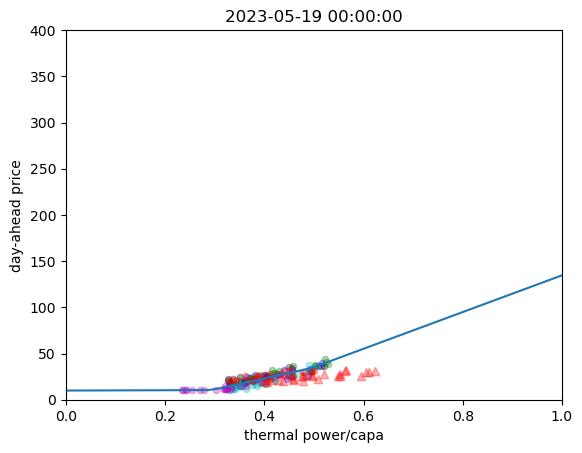

42.0386437013495
0
41.337215945392714
93.9272177961177
53.108854872425795
71.19375859890731
39.918354293197595
163.3867381498293
35.69602019298691
277.76573922491605


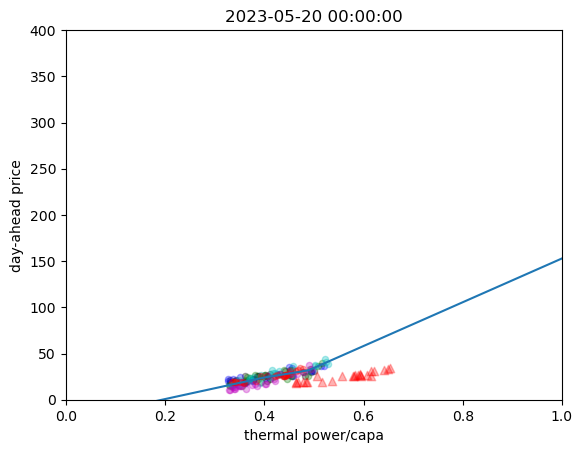

18.844325097783813
0
42.03864370136351
96.28557131315438
41.337221566824155
56.20033059831989
53.11340561114571
64.64388332388559
39.91835429319795
80.65030569337864


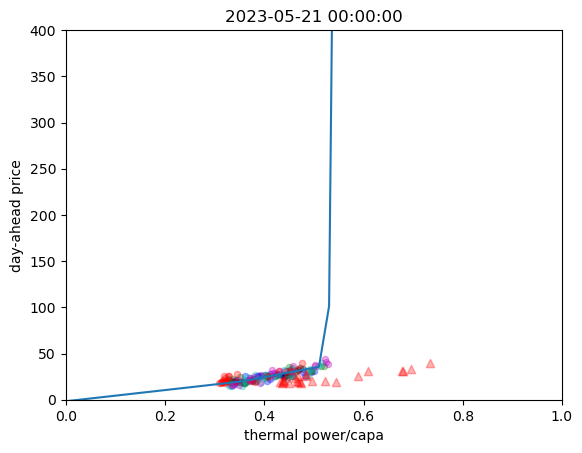

42.94357730215644
0
18.84432520927814
120.04547152559624
42.03722668043676
151.00951973197562
41.33718328719008
107.15326304619504
53.118672025431955
194.76264091576473


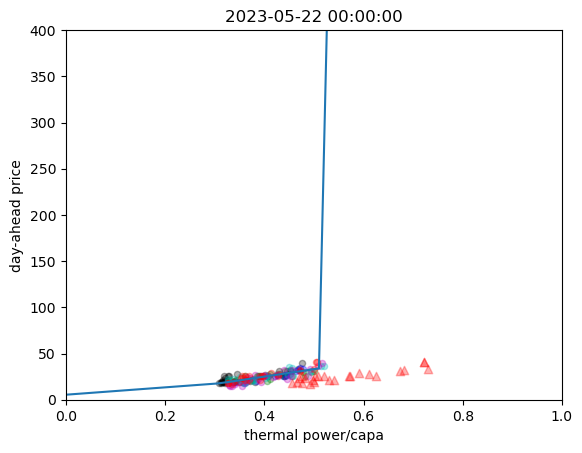

32.48854037619596
0
42.94356370913876
142.49118370571185
18.84432489943037
91.27139161089181
42.03864370129935
75.11906089819382
41.337224223435726
74.20093942136774


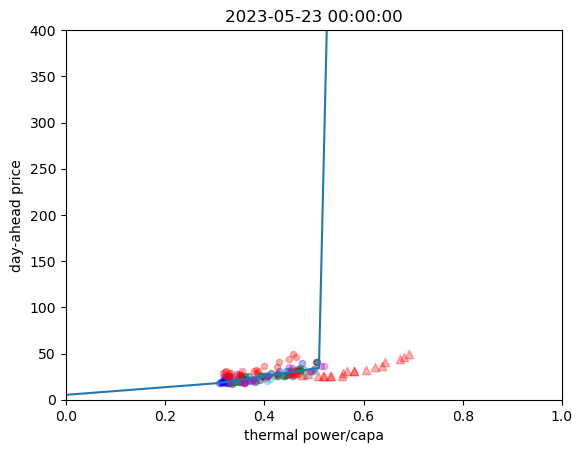

38.57985214943329
0
32.49817535176835
456.4010325907436
42.943567955129296
429.1512722550434
18.84432310839791
537.3145195525929
42.03864370134343
498.08761421806486


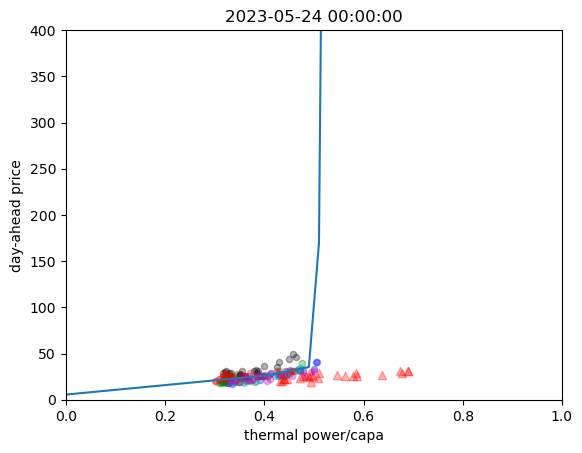

36.00265384735807
0
38.58040967300492
339.1443901689057
32.47738268694009
96.35817485999627
42.943563044572656
127.27053870020617
18.844328011690195
159.89511862558248


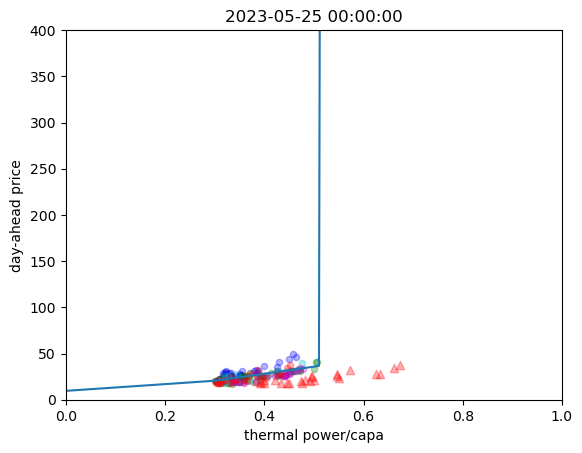

33.221596169665304
0
36.00910067811141
142.10997351624152
38.58022070483151
380.91662674780565
32.513200064724685
136.54056429596523
42.94356353185346
144.41348756224676


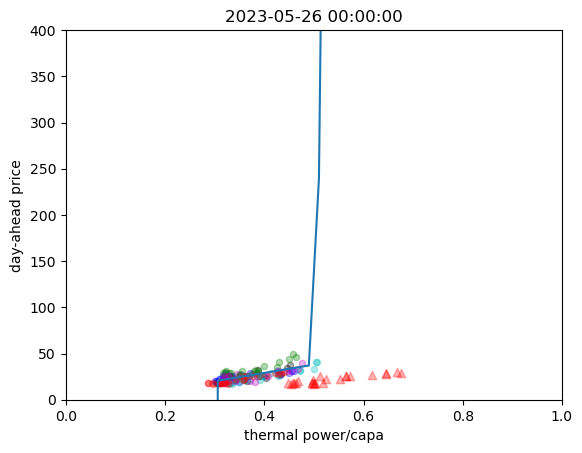

16.07749849512671
0
33.21375398021058
92.93224326572862
36.006910409734395
91.16939159078434
38.58384013582047
351.86969693937294
32.51427941780477
53.00149508822796


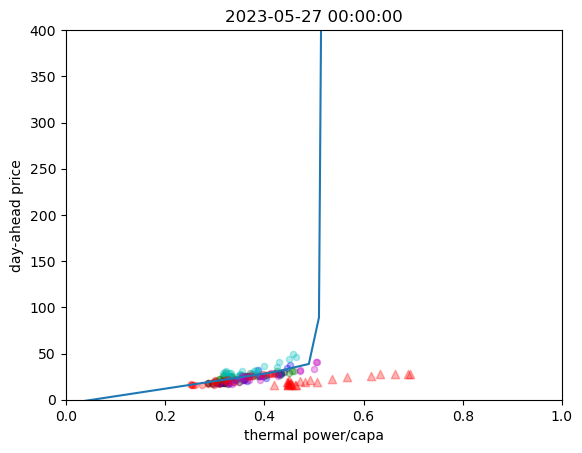

21.4476011549721
0
16.07763724773115
43.30935336477205
33.230502947654074
83.40000950295395
36.008237221460924
109.59242248727095
38.58034675452739
315.6303803093434


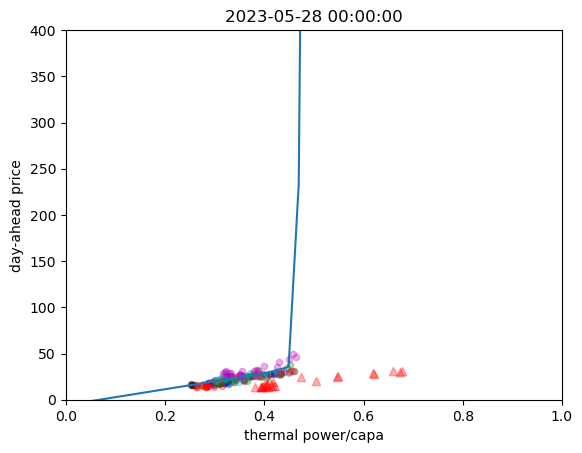

28.64210554096435
0
21.44760120981779
73.23680354966513
16.077347155795625
57.88658195133162
33.238597273073744
129.44626348911208
35.99580629544853
124.71537516713747


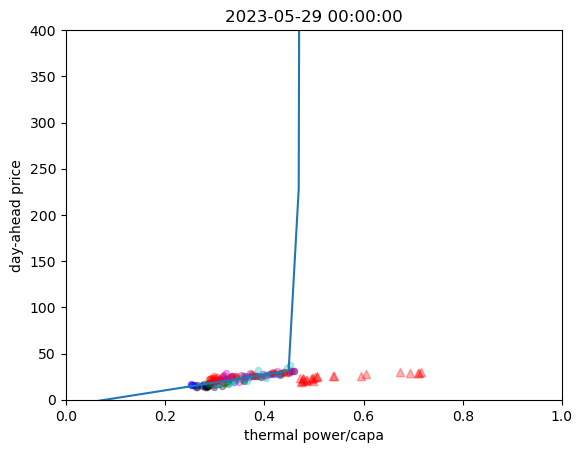

30.849172207547095
0
28.64210554179646
172.0453737144602
21.4476019225023
126.6449537745339
16.077471711746472
122.2189645337054
33.21036563189034
139.3052650317636


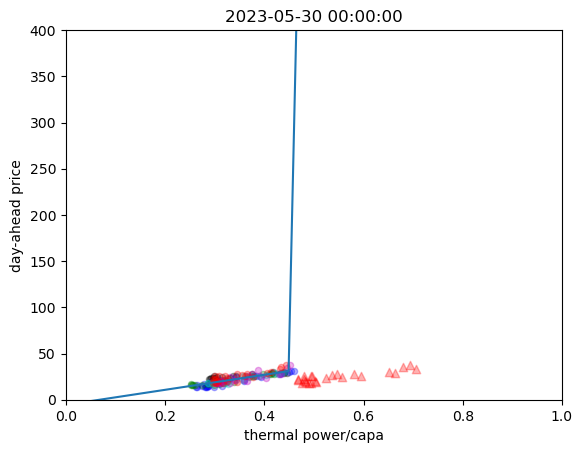

48.08036041059128
0
29.338781709160997
103.27085364451199
28.642105541004078
177.91492935921792
21.447601156931974
128.0640296957948
16.077464616217487
146.36664614541098


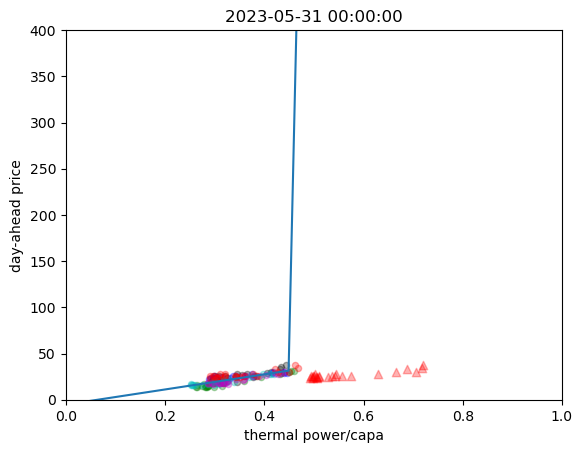

26.573361584727238
0
48.08028839894058
134.84239613812247
30.84742370367665
63.60684907305973
28.642105540989824
244.44270682517381
21.4476020878383
190.19551038761855


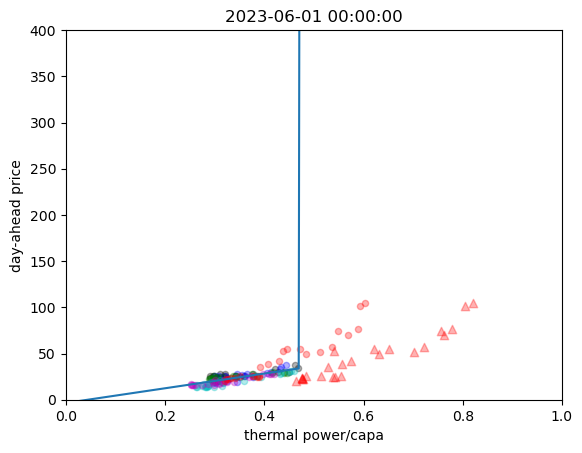

90.15384155881966
0
26.573361584747406
347.1637173773114
48.08029014428745
259.98645179497555
29.338756891283047
315.62599639038643
28.642105540986726
424.4565024563582


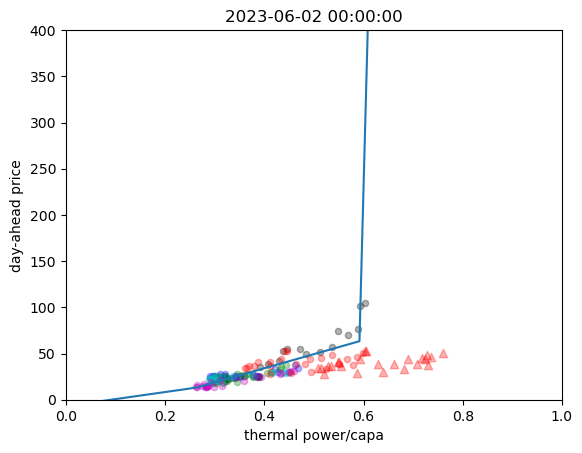

101.7951463491284
0
90.15407442528817
807.6089238834511
28.919505811477215
432.47963870942954
48.08028915475457
547.0092124533376
29.338768777858668
600.4379884979901


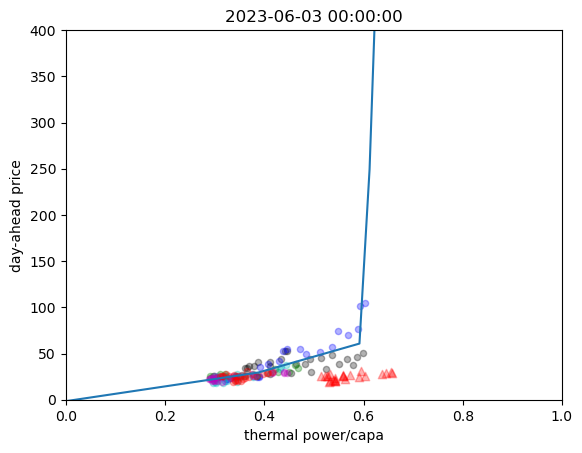

39.7635387725436
0
101.79514634894949
491.42443344538754
90.15384732028933
220.60920806719696
26.57336158635267
82.86646323573692
48.080288681277295
100.93530821285086


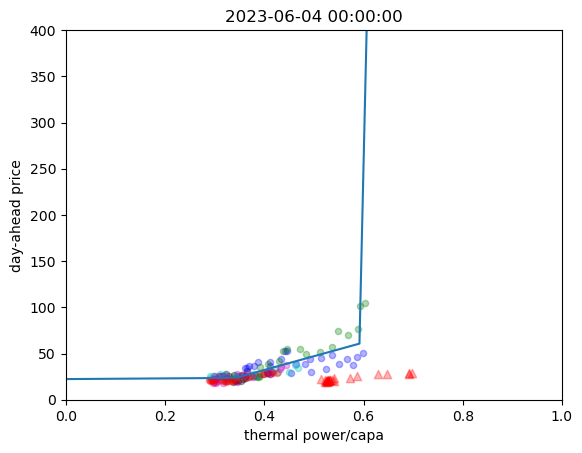

12.45123025917719
0
44.124843254083785
96.6976855332737
101.79514634889242
546.4264344842373
90.15385101557807
230.8792520592016
26.573361584725607
138.6420869544388


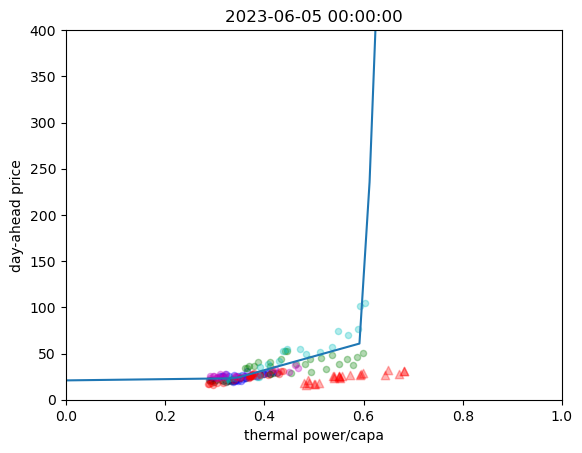

23.848616859419604
0
12.451178659833865
44.591864222348946
40.210024403164155
91.10683546727482
101.79514634888024
577.4563967790479
90.15384193121761
267.24441361763235


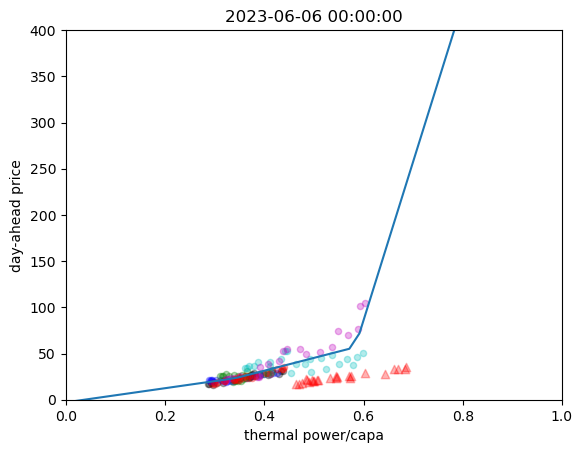

17.94236047694757
0
22.28948609013498
44.50860435963543
12.451178633740593
33.84938231587921
44.12486658635845
106.68006390515272
101.79514634898288
553.5840755146754


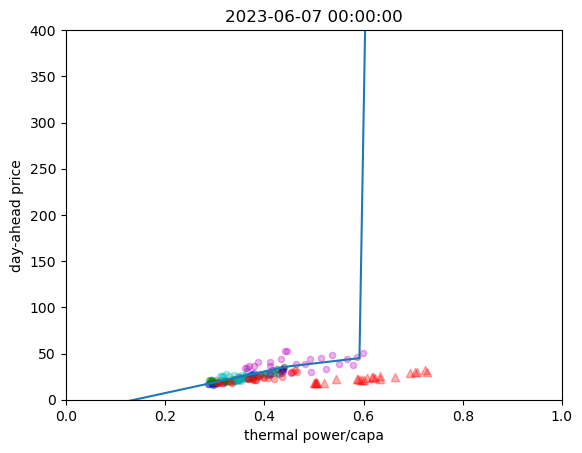

19.300244560451183
0
17.942360476979708
184.9870469273906
23.84861685984943
156.77230730193733
12.451178686547234
161.83279102997778
40.21002441191079
229.96880072697996


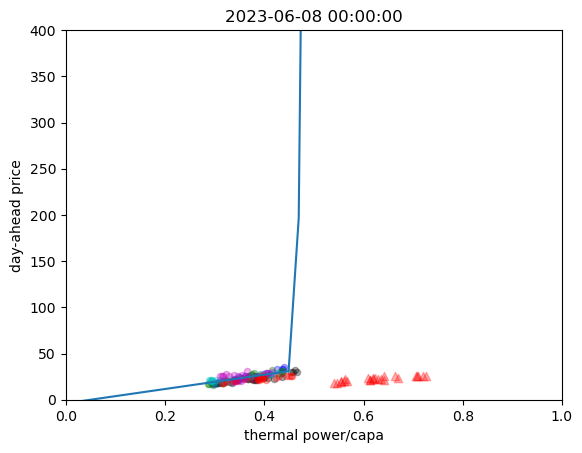

19.033482777036827
0
19.300247699635975
33.76051985463104
17.942360476967508
198.1957677776919
23.848616859387214
178.9462043814509
12.451178348743223
163.4631536044045


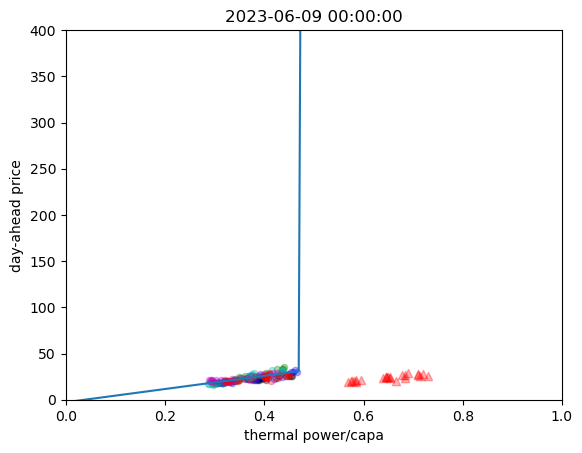

22.45798571901541
0
19.033482777051006
44.351578723808004
19.300247915230262
45.45910960658977
17.94236047697942
182.3354682298271
23.84861685938695
156.44156236643317


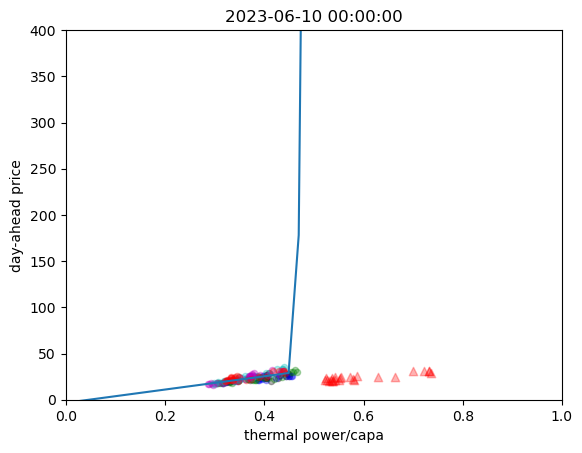

27.872777386178154
0
22.457985719064695
123.5437387336403
19.03348277703575
144.34563134041332
19.30024792825502
134.5881550957188
17.942360476979708
102.32306998221898


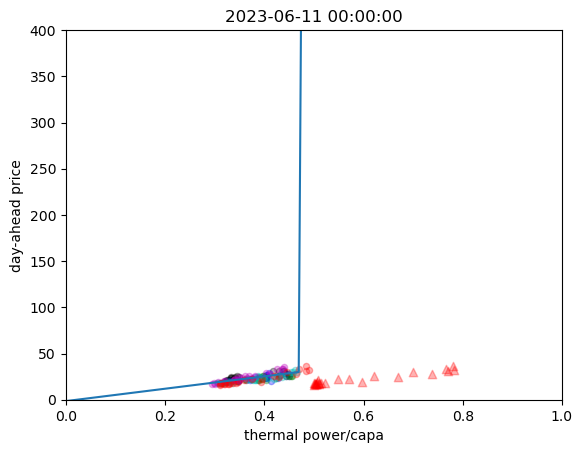

23.921744326575293
0
27.87277610775777
184.91812641495443
22.457985719047482
116.88725784509053
19.033482777032642
87.50263997357678
19.300247929339402
65.06552616505007


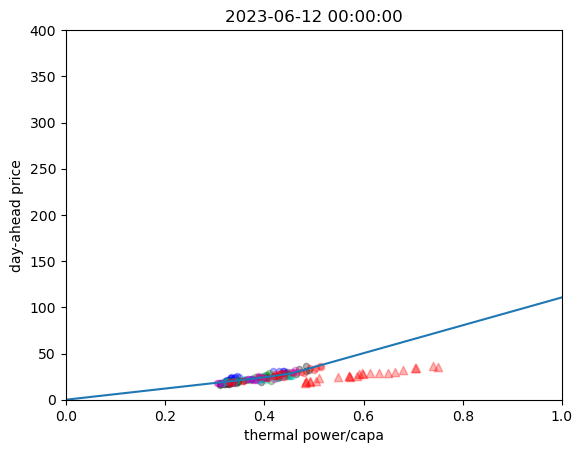

20.4531122431781
0
26.201868332757314
74.04751694129843
27.8727774049863
101.9084518691879
22.457985719032255
68.86421630256538
19.033482777078333
67.04724002900517


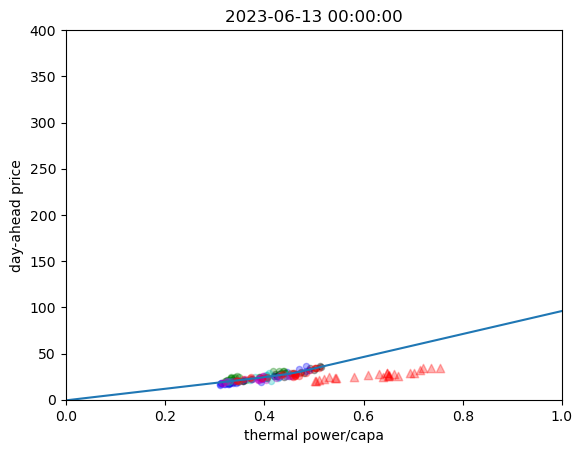

21.44586569291176
0
20.45311161474948
28.717180507649125
23.921722255890963
118.89111300451765
27.87277738420615
78.46668427083844
22.457985718201886
60.0086614085454


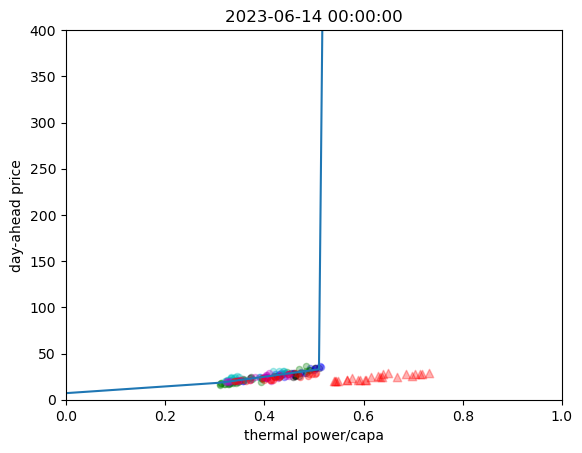

18.379320081018815
0
21.445865892003106
107.51909657368202
20.467995092808756
102.17808227909634
23.92171150318433
80.27384200170611
27.87277735523031
177.80439500102176


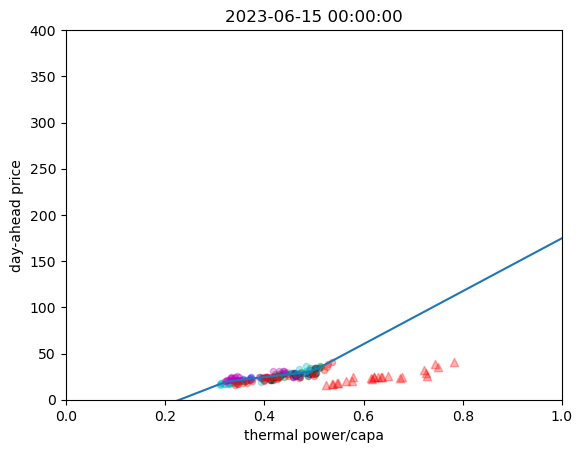

23.458072913699667
0
18.379317048383367
81.47581041797824
21.445865680887042
155.4826427484518
20.487707854106098
165.99416433138109
23.921760226565734
121.60120047224143


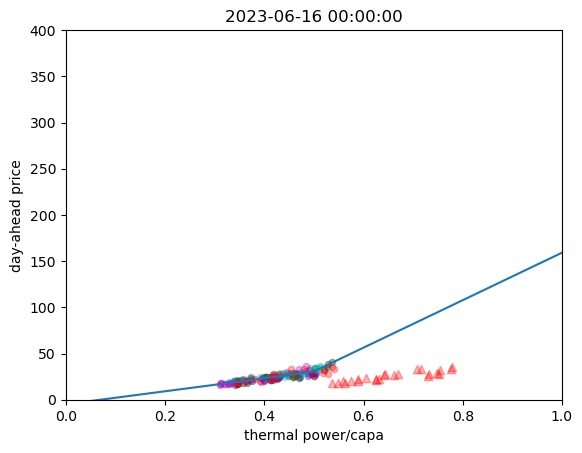

41.67330908235329
0
23.45830743246693
117.01106393640973
18.379323059907886
90.96880283968912
21.445865672499597
123.48849020305333
20.453111675746456
105.71524075143321


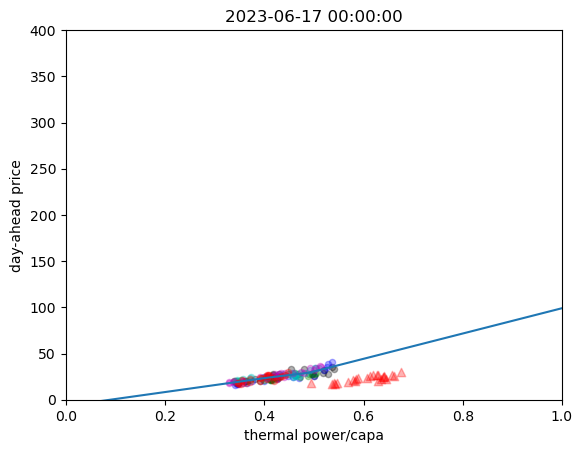

23.788807379069677
0
41.67330871269435
57.9079250567079
23.458777943213995
75.0116476385378
18.379305461184856
84.50439951887375
21.445865685269048
90.99021721373967


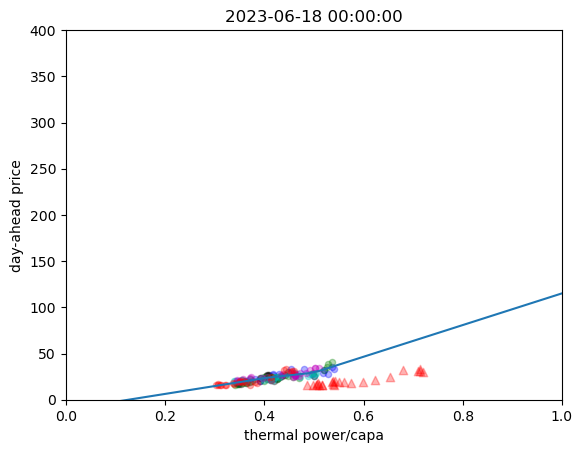

17.485459784337145
0
23.759368778420303
222.72191892459375
41.673309951012165
164.0375180294069
23.458074212649038
204.43079199087683
18.379337772518717
191.1792784431761


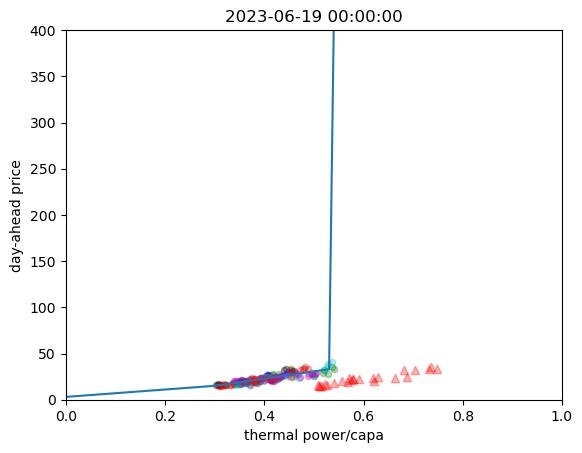

24.30792769934675
0
17.48505673275784
173.78322951844544
23.75936908634842
50.59410246624515
41.673308916483464
57.99160241271067
23.458129464495837
117.36796844084866


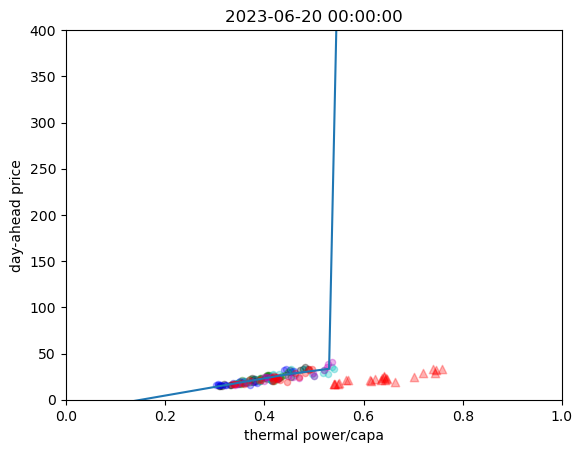

26.69073450095949
0
24.307927699340546
126.81672330541792
17.485047380954263
223.02420056120036
23.759369017994075
129.98561138119706
41.6733093210654
132.49314653468429


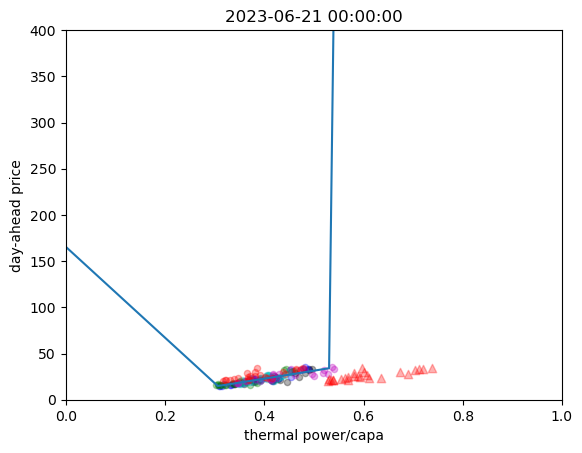

34.571342085985606
0
26.6907317502202
288.7406038292494
24.30792769933526
187.6339775879208
17.4850457567009
266.2393466862768
23.759368962774715
182.18820092164546


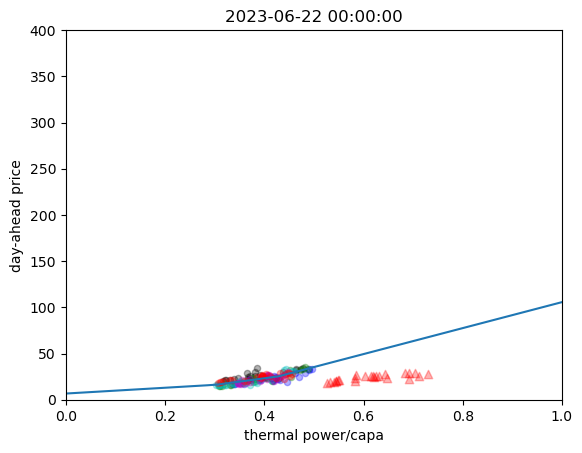

25.71546078144291
0
34.57134208620889
126.93111437730575
26.6907317042317
176.53771848186386
24.307927699262766
108.34056474207186
17.48504420335
201.10747998066364


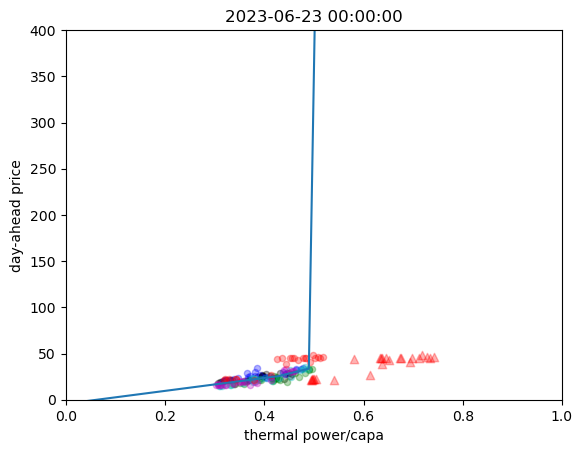

27.90199315530242
0
25.7154607814439
330.8450967954278
34.5713418318671
353.56352138245853
26.69073164651174
520.2674463978417
24.307927699334186
412.70253499190807


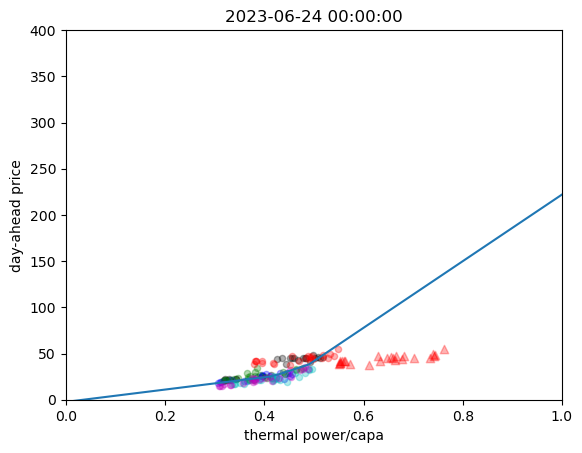

38.585446529955696
0
27.901991879681514
299.8617262889793
25.715460781438864
728.5113658443846
34.57134208212038
650.4831414784617
26.69073091615805
880.551613084999


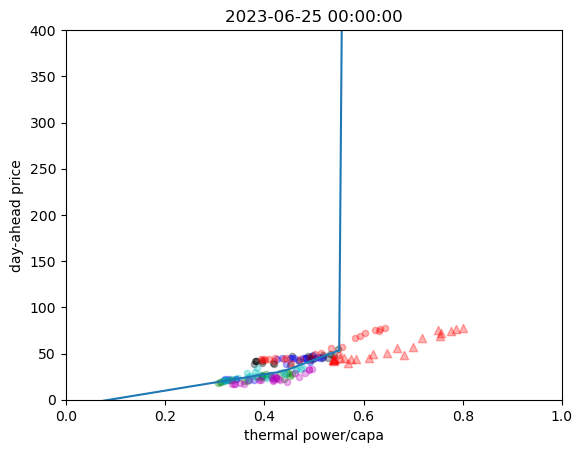

33.277309740720455
0
38.5867344555961
146.04601011323211
27.901991662719922
289.23498101772645
25.715460781442033
887.5850542282111
34.57134212814542
818.0406001290623


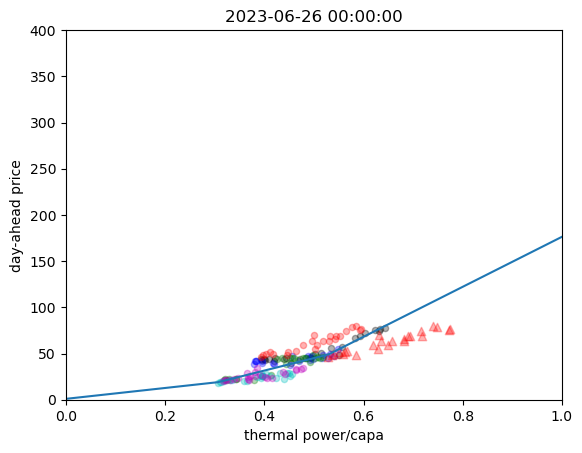

52.48934320929628
0
33.27730978833118
528.5402452412065
38.585388350965545
663.7923884777964
27.90199172488189
749.9703481774224
25.71546078144276
1220.5580850922845


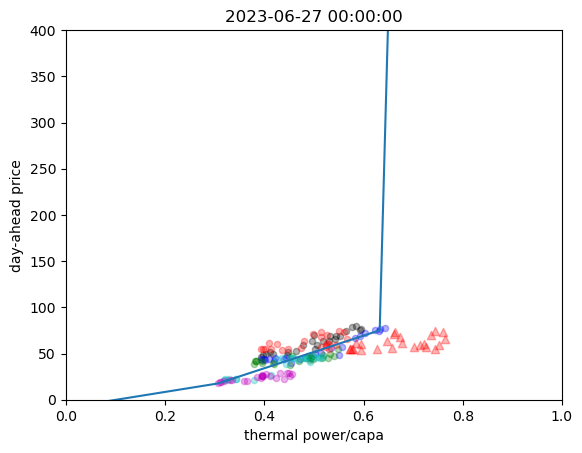

91.22143581678714
0
52.48927093649396
212.4690524994749
33.277310139911776
661.5449963657486
38.58538783009495
797.037751975314
27.901991992908382
950.7197761313065


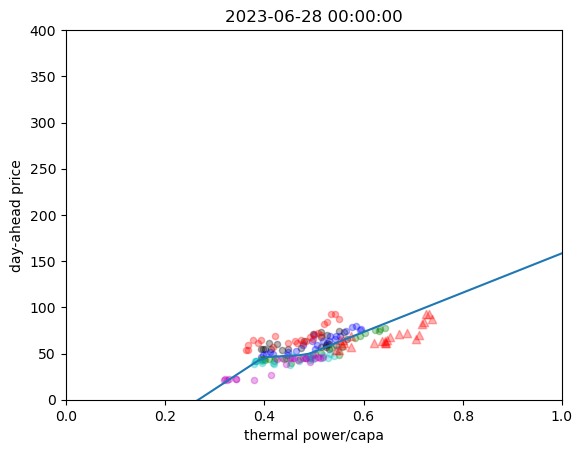

62.804404723995965
0
97.09688219602654
438.6546476719167
52.489341787569465
606.9959365777493
33.27731006612174
1137.8698879255066
38.585644545331704
1252.4192181637795


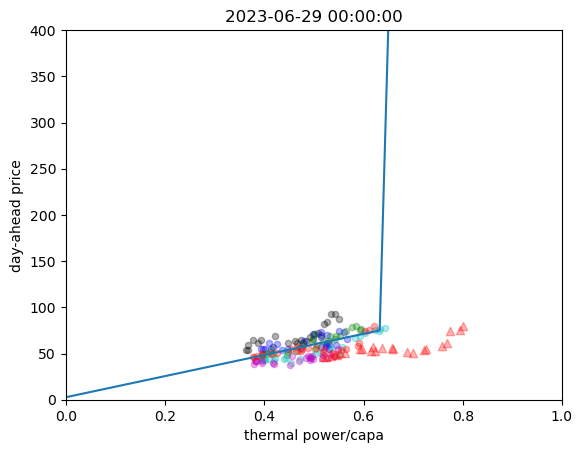

32.59786822380256
0
62.807532788082085
817.015209112246
91.22144727062206
403.74686773050723
52.48934678698741
410.1230735832412
33.27731027614153
336.2919600389132


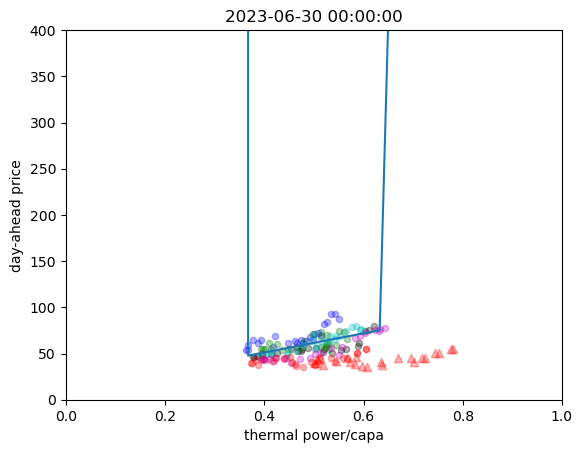

39.35211276730589
0
32.59786753831
512.5174209556593
62.80460397334719
1353.3188395954028
91.221435596405
944.9285085186908
57.51525045467429
896.5740004452548


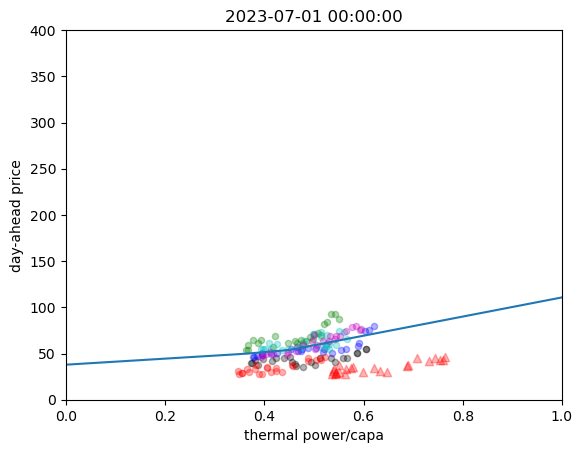

45.745526679058244
0
39.352112763065726
382.92681778974867
32.597867543308766
771.5763919722827
62.802109390873916
1417.2128456708836
91.22143520478377
1075.9285811509822


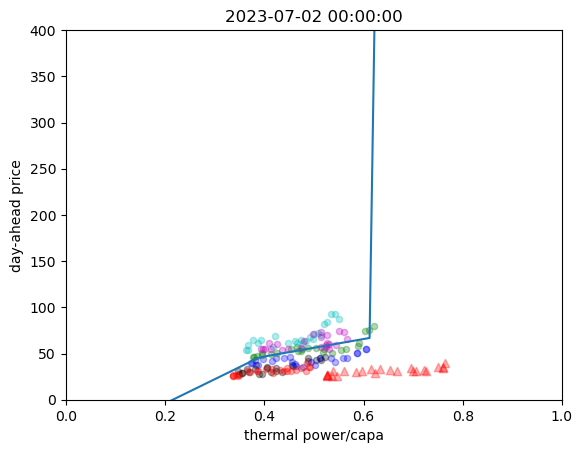

25.60841604731124
0
40.58184029292367
168.04057413992055
39.35211277288999
448.7048886338734
32.597867535138114
971.9332425654828
62.80415863630801
1524.0569797527655


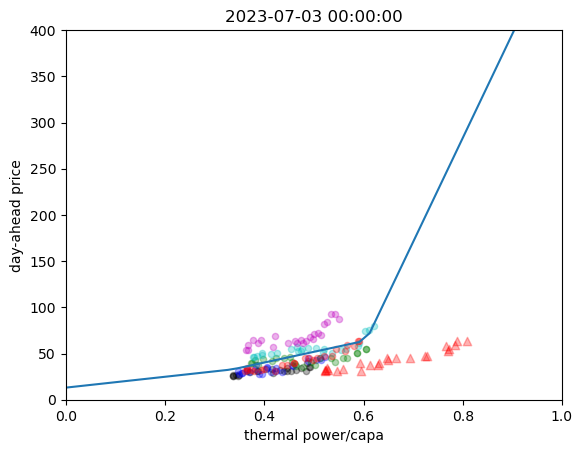

33.095352467822195
0
24.76455460380298
206.1767965113953
45.734805074932474
82.19307199865003
39.35211276180172
383.1227693230634
32.597868336352455
519.4635197927207


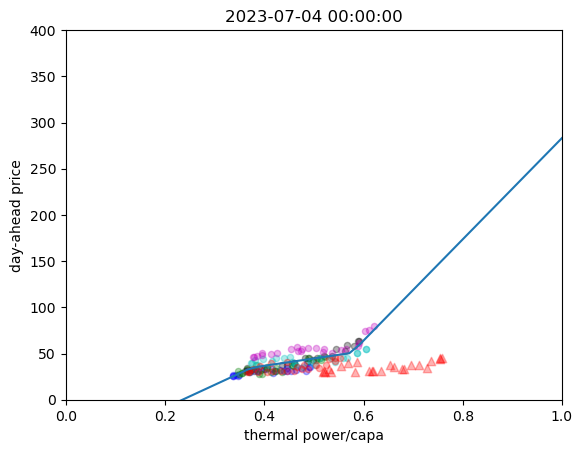

53.371691682596676
0
33.0953524688631
239.4391501775635
24.764554189701624
67.6563139557395
40.58184029296402
182.3552736258243
39.352112772496476
308.9849621622363


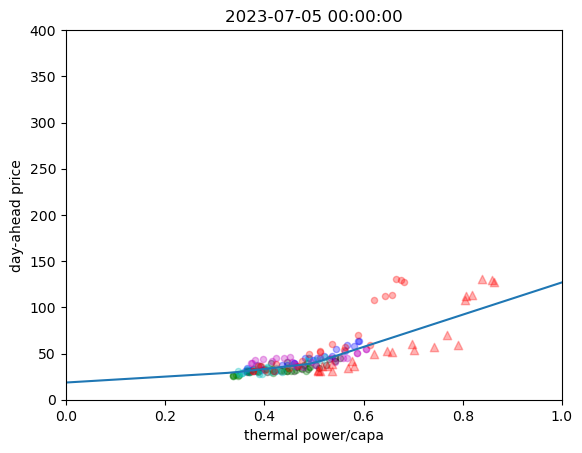

91.85804166607076
0
53.37169526514489
385.0763766014349
33.0953524675933
130.71510057207587
24.764554302628095
310.74302028959323
40.58184029288476
226.13969333876855


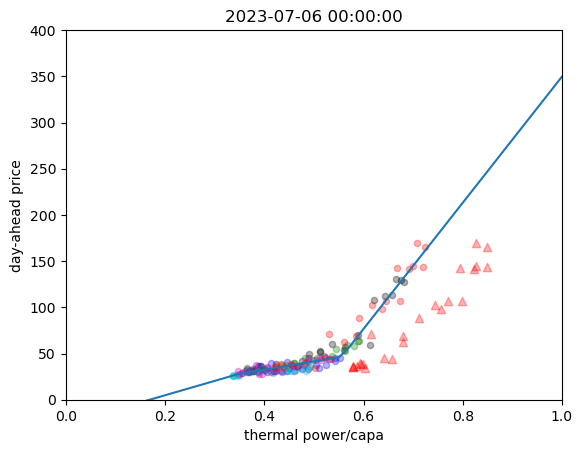

164.20596729082334
0
91.8580416660882
419.29818825113006
53.37169595550253
287.6226833754564
33.09535247446465
307.29260942662654
24.764554727423818
219.5057928658248


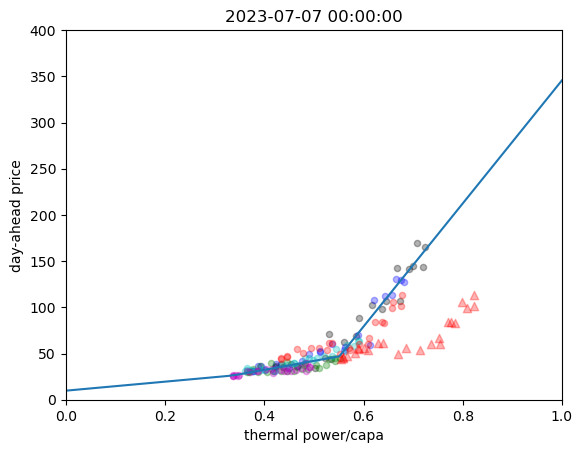

77.75458089696693
0
164.2205629126878
780.7849179749616
91.85804166606479
520.0339534381296
53.37169495267054
815.0606430479748
33.09535246664379
403.75114864241857


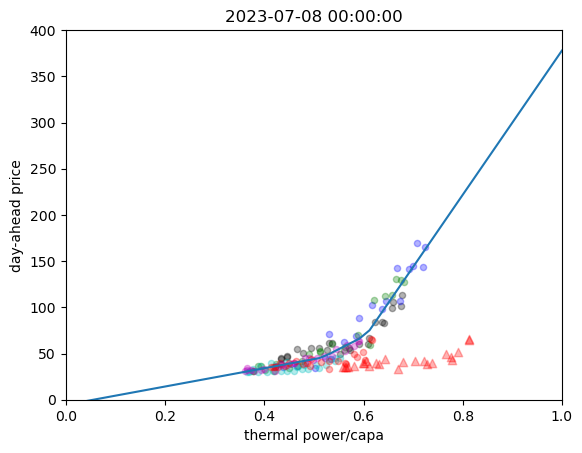

56.919777954013455
0
77.77343382024054
646.441155295904
164.27981510403157
679.3368512616885
91.8580416660605
533.4827207741722
53.37169862529008
187.60786250092852


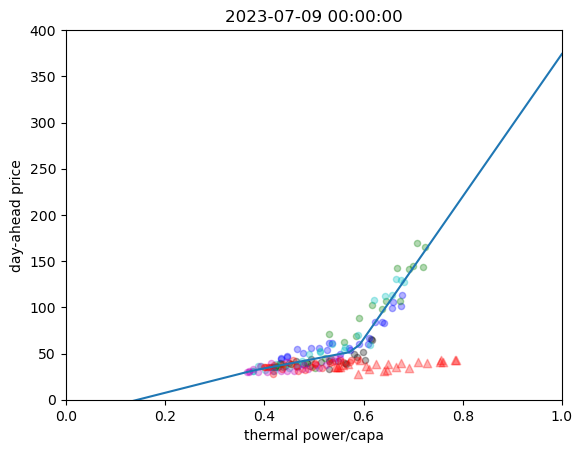

44.683943988680895
0
56.9168797753324
95.19166359766326
77.763399391822
744.6604128307042
164.20567479267277
542.0724870037765
91.85804166605168
478.9410755045193


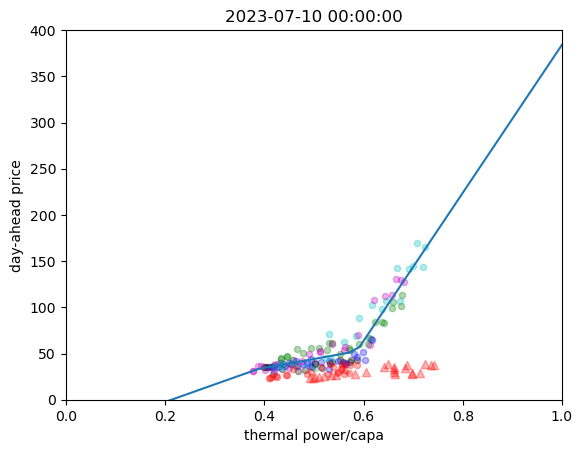

57.807223255515126
0
44.68395406472328
377.3764672345019
56.91263554154465
443.30897373505087
77.71292776215839
1090.0960619009015
164.20624409066477
878.1291692749966


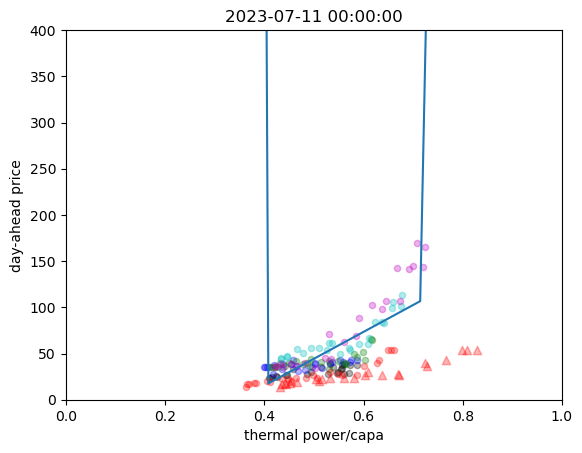

30.16788993277197
0
57.80722325551695
300.3506304232203
44.683941262188256
673.4196069666222
56.91803952157199
778.4716926748274
77.77554915817377
1525.773704985686


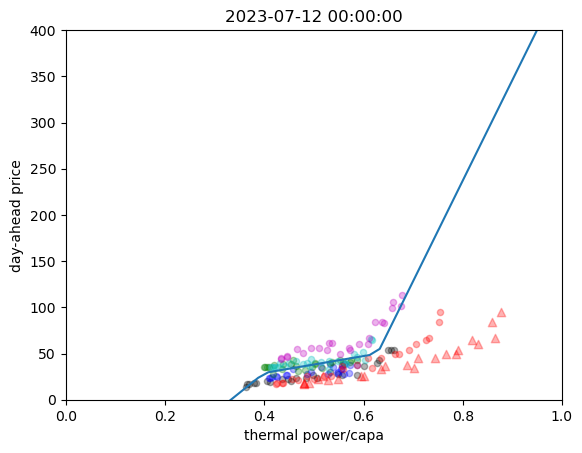

39.808755562014284
0
30.16789293481728
182.22836335864324
57.80722325553356
237.68091391626712
44.68396061020546
587.6922766036361
56.91700276720834
671.9877451804114


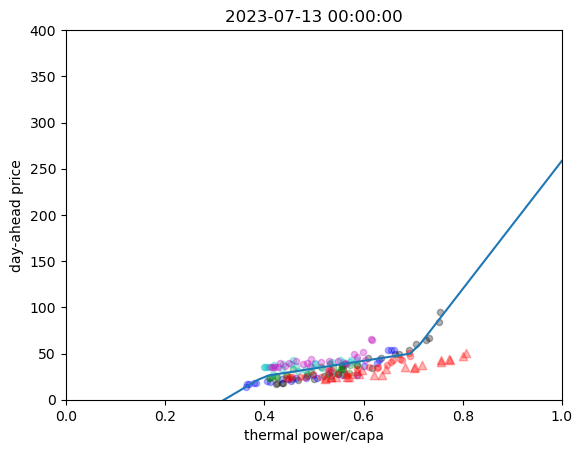

30.460838254929357
0
39.80875119451435
224.22913764558683
30.167881738627134
156.26943559043855
57.80722325552306
244.0579321536402
44.68394321679352
566.3907948744794


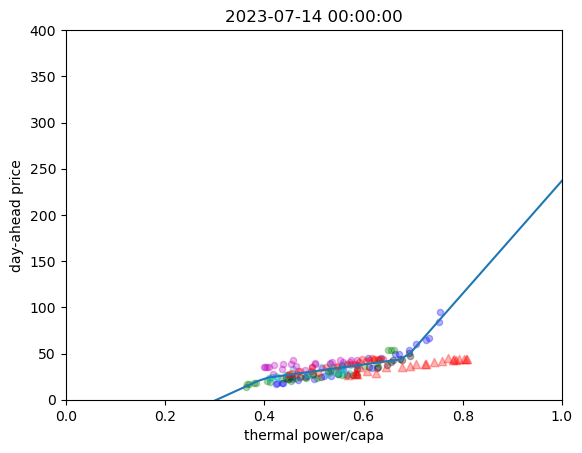

22.888612393035974
0
30.460838555476325
360.439066628076
39.80875322859859
247.53824688239402
30.16788128508336
374.0210025207561
57.8072232555139
87.80657723113967


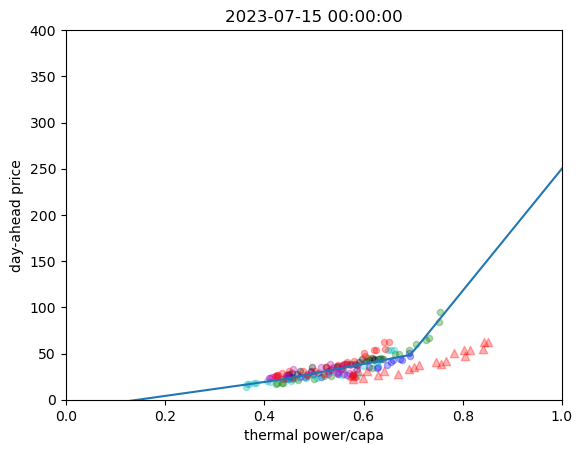

42.827260207000236
0
22.888612949996457
182.77588549517262
30.461148746538047
487.10582906568396
39.80875234001172
381.02101824536777
30.167884863487465
444.81579777635403


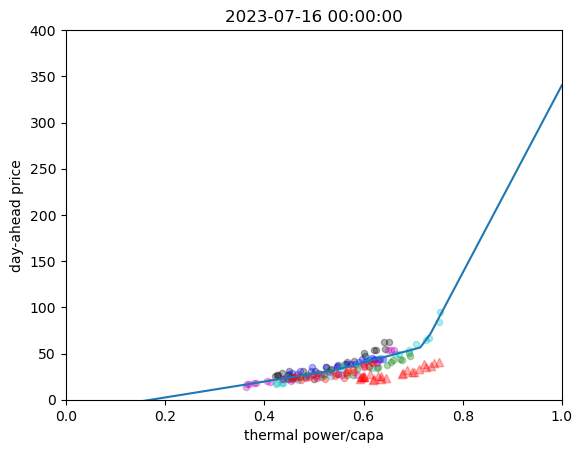

33.60323591777262
0
42.82688518429683
417.5842316163406
22.888612482863778
374.86098048575576
30.461257108226135
147.9783043033495
39.80875283195188
153.42222957698328


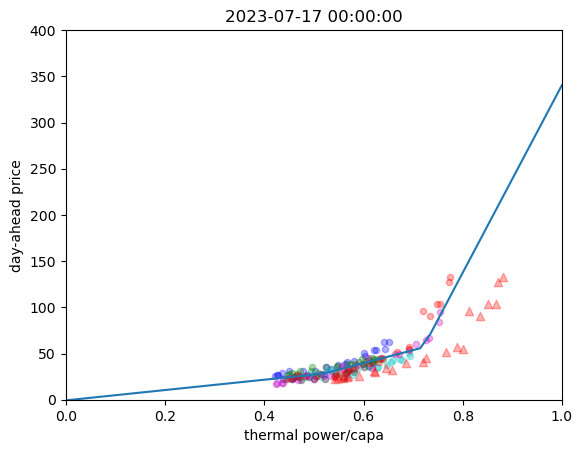

50.426508791271914
0
33.59972766340602
64.31741178296366
42.827170372959266
390.3800263155286
22.888612279908514
279.4430566772627
30.460838994911832
217.92605044174024


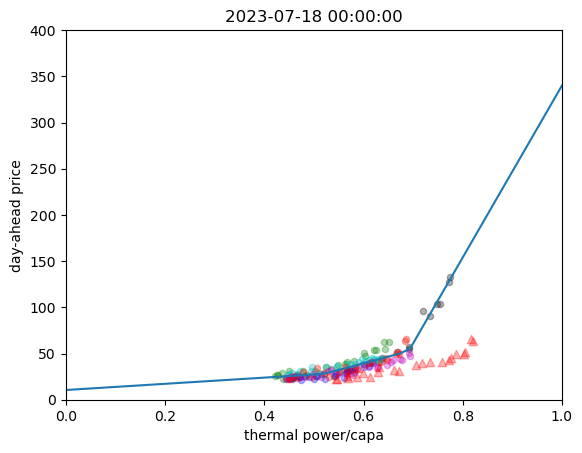

36.52047111118373
0
50.4237301469365
92.75753794973679
33.606048052109465
109.63391961706591
42.82726501380451
369.52775293290847
22.888611522538024
245.37712704656644


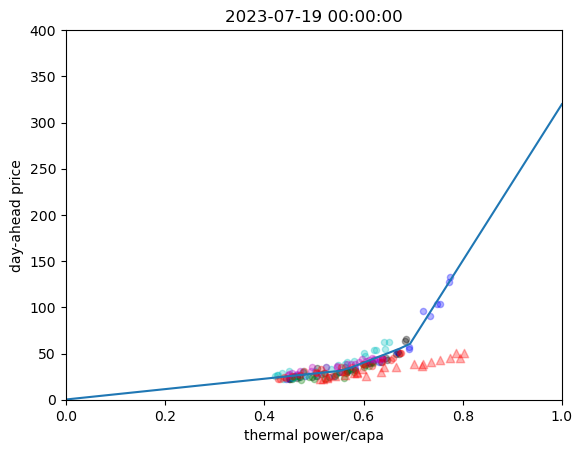

35.985644131652265
0
36.52593414478632
77.891772744506
50.42393453368483
105.6867584415011
33.608308511940635
168.7721955833513
42.82746967266645
313.99880603273596


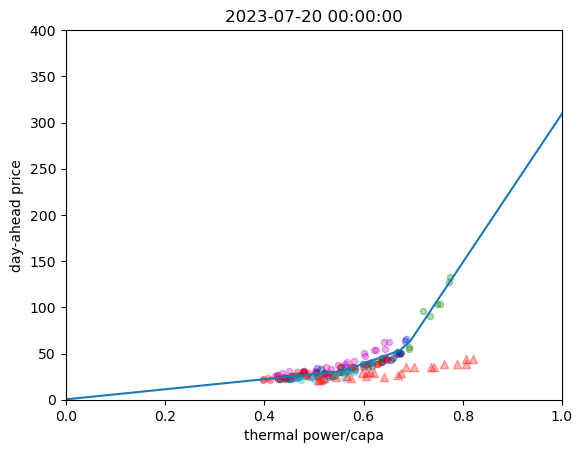

29.77273667719703
0
35.98564396487886
71.61566752427908
36.52692323255377
72.06735433338517
50.417998223210034
99.32804961812585
33.60623602292786
139.9421122451796


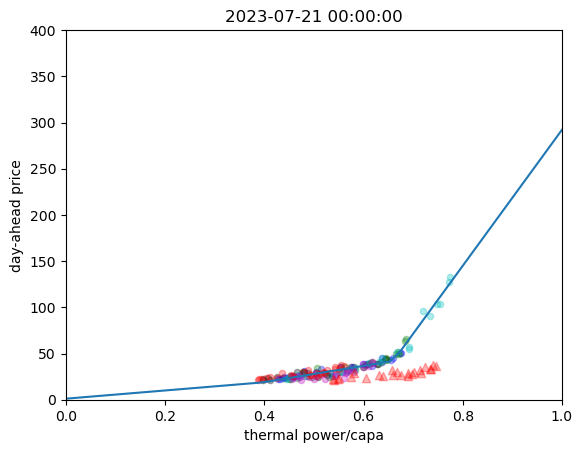

23.450154969672266
0
29.772737187340592
85.41999847717685
35.985643412971314
146.6986364563746
36.50951362523054
135.6578950095238
50.4242164822452
213.25148307281782


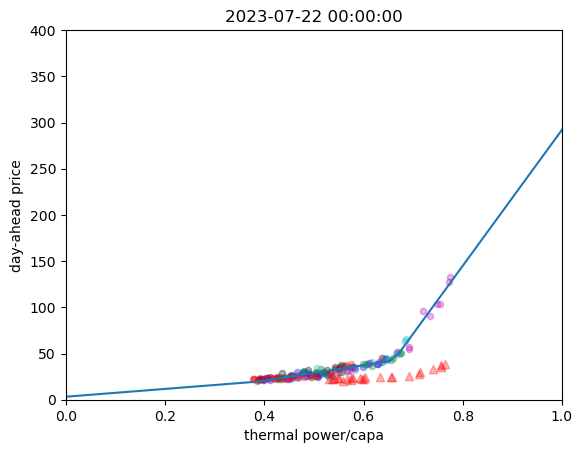

17.042223132752014
0
23.45239727911866
129.56078282114126
29.77282070545249
106.49887007277884
35.98564396331827
159.90523668954384
36.56279130399517
118.02748630473394


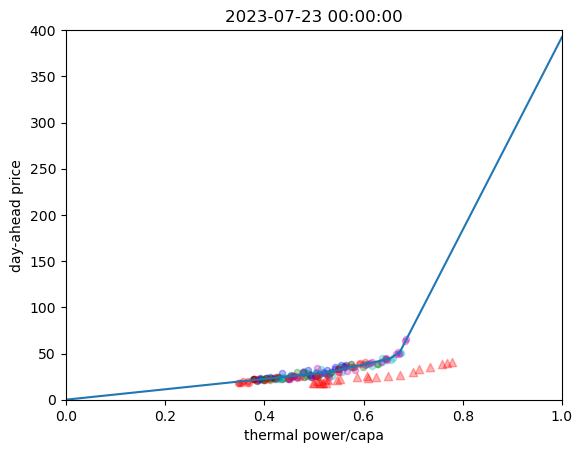

20.211909157185914
0
17.04222271102757
56.482725717435166
23.453118447466142
116.45933117792336
29.772757206986327
66.09717909327382
35.985643958314256
110.64228040222368


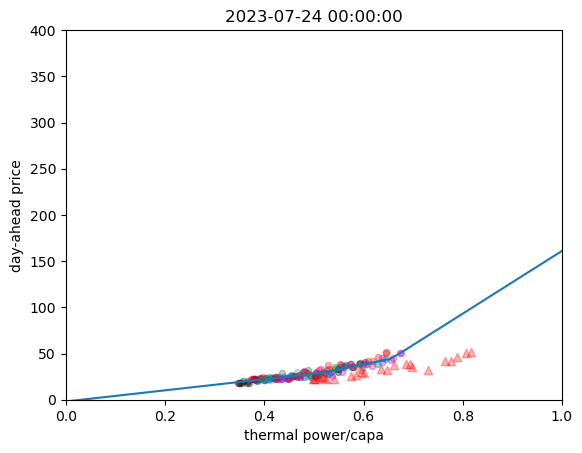

38.4512686063704
0
20.21186678813672
164.68788403968216
17.042222390927186
161.35640677069705
23.452714259137498
54.42077486189861
29.77273359884253
153.22850065653222


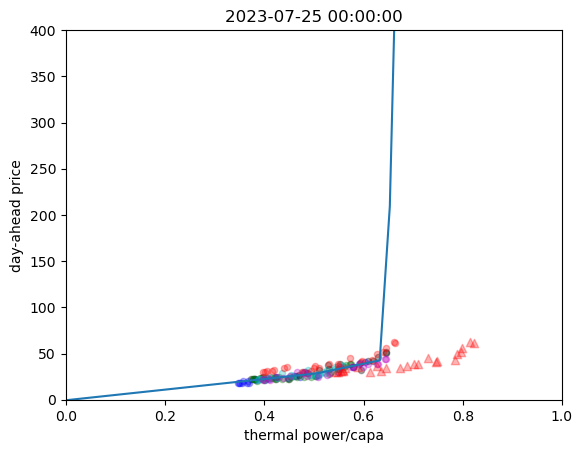

33.81308343220758
0
38.45126705772738
233.8842554103452
20.211795292457502
355.67881880575146
17.042223596785544
389.90761932383396
23.455210098924645
277.11716931523466


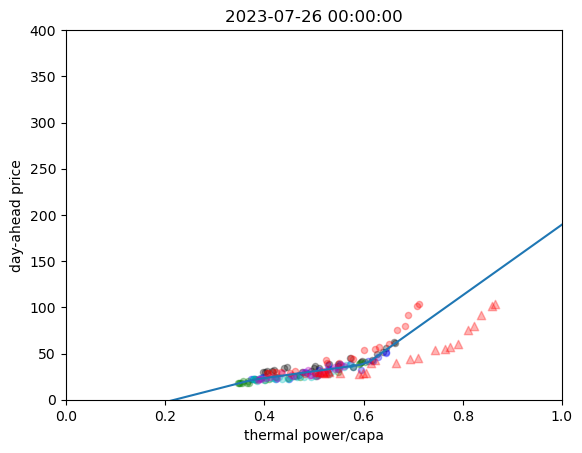

45.062091930211125
0
33.81353994003311
213.97849872167683
38.451267446902015
302.27759664728495
20.212210457151265
351.8089562795617
17.041395118433176
328.4548854467712


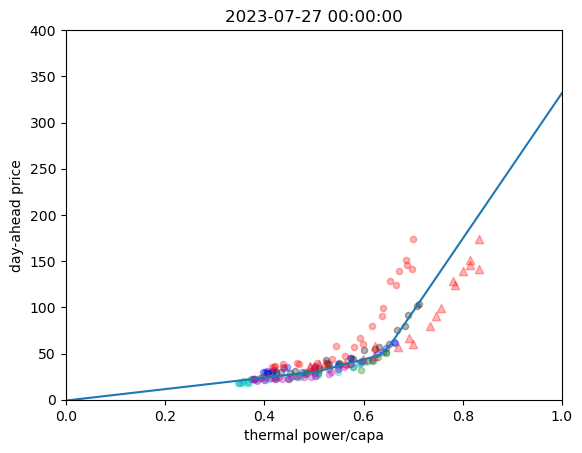

103.9278676568274
0
45.062092811350105
1122.0810804088308
33.81566731852668
931.6792806268053
38.45126744798803
1006.1768663386777
20.211881717084335
845.2469682542533


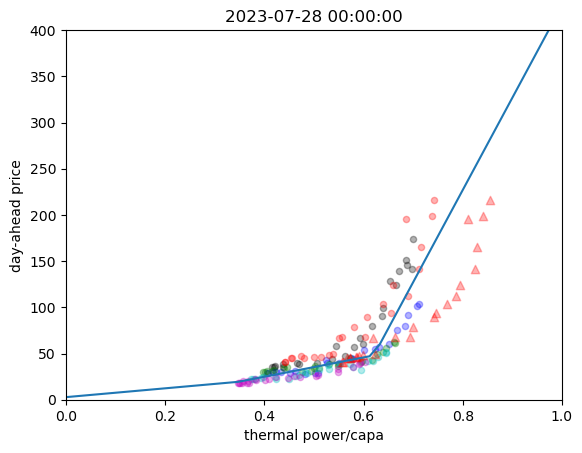

219.9384416025551
0
103.92784736471575
340.1824474208679
45.06209197030974
1486.4283303261395
33.813629111188845
1352.8491870474516
38.45126719575157
1431.6888592961373


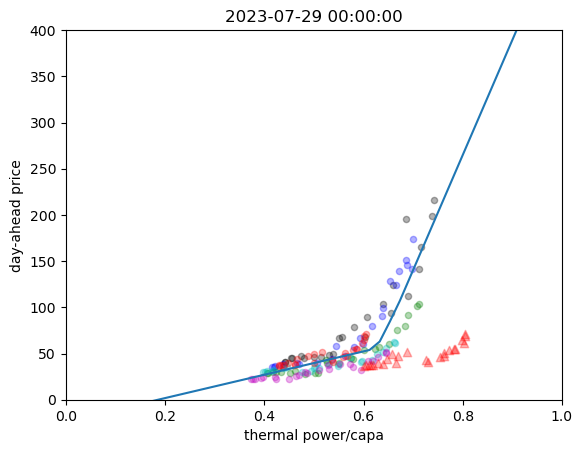

48.82531197671374
0
219.93844801295344
425.73640103960435
103.92783929538354
146.3061250521656
45.06209283026165
513.2163155719638
33.81285863426139
529.6053432996205


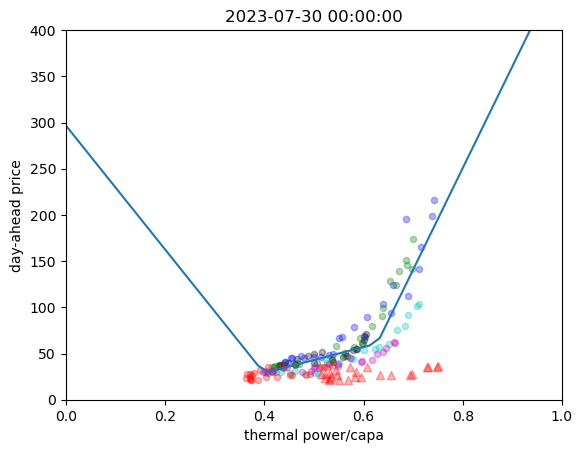

60.789416361899015
0
48.82531252100172
691.745713794536
219.93844776325986
950.8720435840867
103.24106458955421
481.71854283902053
45.06209231595446
82.57137651512004


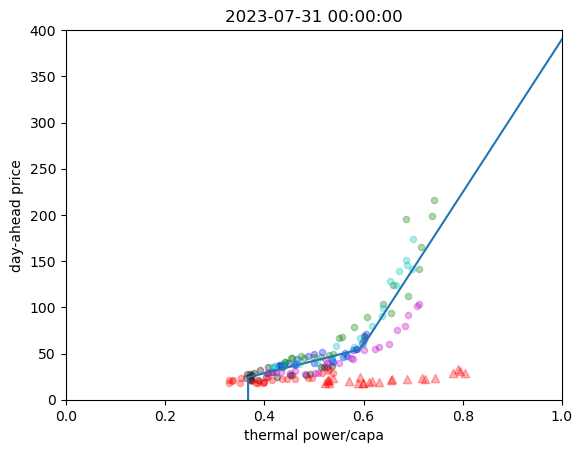

31.80362046730024
0
60.79890604307073
298.43708162458273
48.825311049002934
956.0464193180775
219.93844657629037
1198.3691916200955
103.92783928899765
857.2034748849404


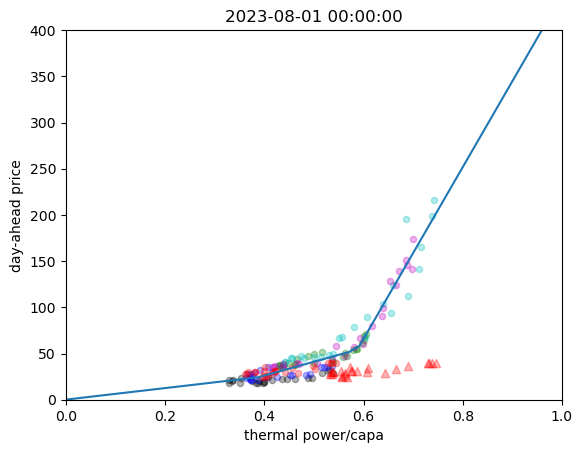

42.93891391799092
0
31.803621503439054
470.298854245168
60.77647093418118
177.58376297677722
48.825319897625235
420.1710558758813
219.938445613397
703.8916930735566


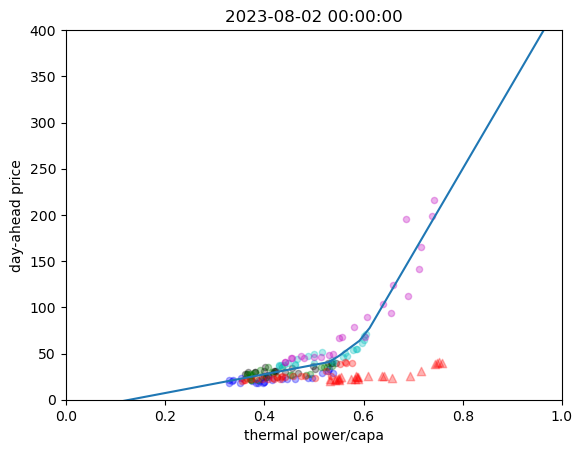

21.117646424392888
0
39.7885878263432
401.1860169579581
31.803621637293706
119.1037514112281
60.770323839370974
237.56246317960392
48.82530976256463
764.5160077154516


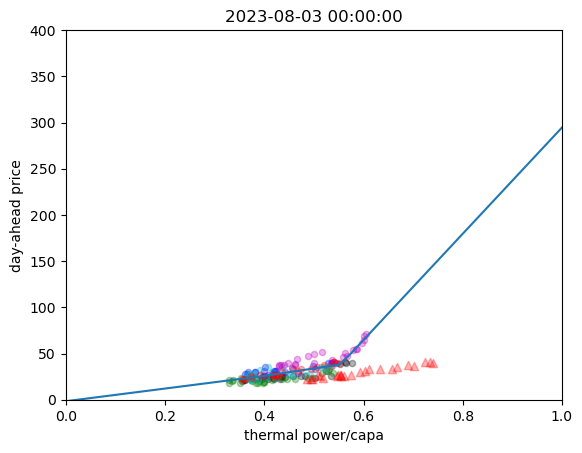

21.185039486318086
0
21.117673958546973
308.50959985061564
39.78476747851373
95.26115491722034
31.803718943826414
365.1893767684943
60.782795516998235
188.60748385850184


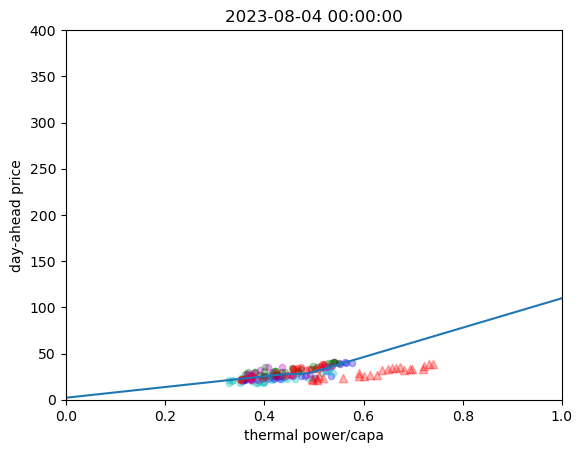

30.13498912149576
0
21.185039470685375
46.635654924421615
21.117917897738945
231.36709593995926
41.72179587817681
137.6848702008407
31.803621546452014
326.897159267786


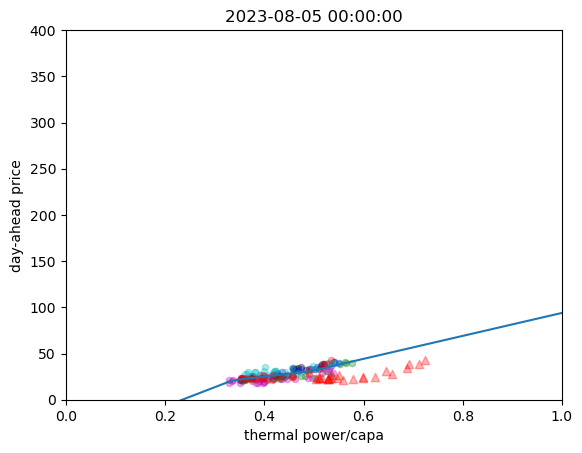

21.597672913626106
0
30.134989120469445
133.08344262156382
21.185039470652242
170.1872177430591
21.117602311242063
147.9952379847672
42.93891391925051
271.3690380474556


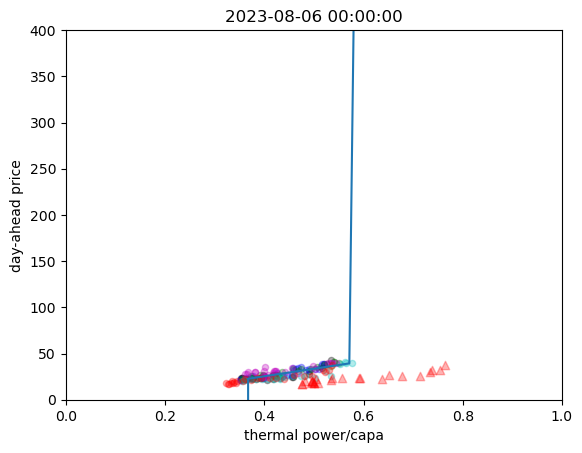

22.028454846810348
0
21.611695122995826
105.54170019660623
30.134989121541278
212.55125632509356
21.185039471536985
249.17939306347824
21.117602294128147
49.238168176194854


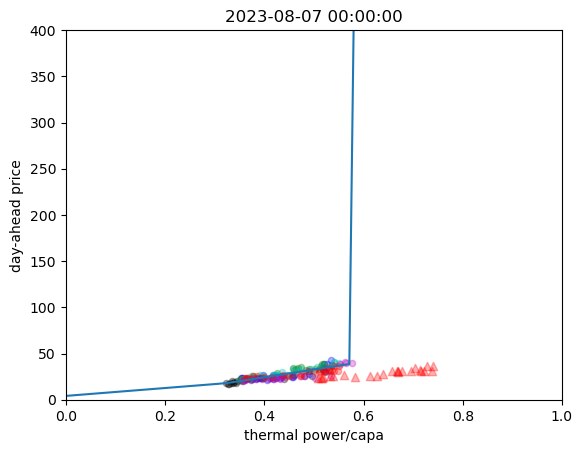

23.369316067634788
0
22.02845496529158
114.13987928103253
21.613855434951482
113.2376031529497
30.134989119620165
118.46062452266875
21.1850394703449
165.56565352522426


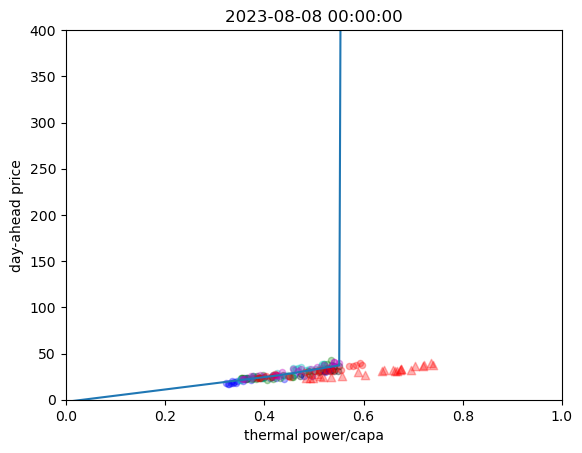

23.61006389901448
0
23.369315362299382
34.75157265944365
22.02845478947087
101.94750570797616
21.61389648209842
120.14912734560787
30.13498912086108
157.98072596025608


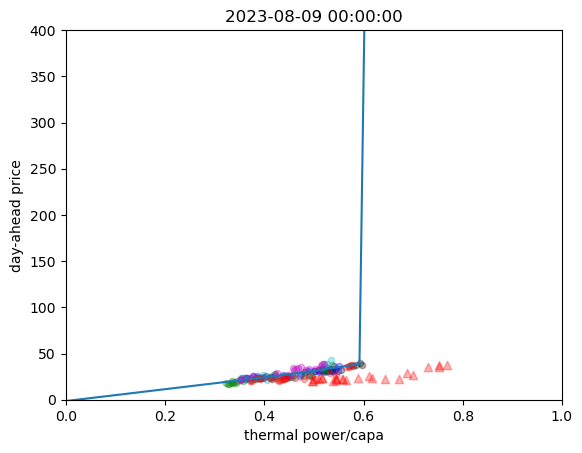

24.965464450717356
0
23.610063972120933
200.8972066614761
24.906976109692756
226.5191407973591
22.028454744300667
126.25915863433231
21.60497902298604
229.32244022669195


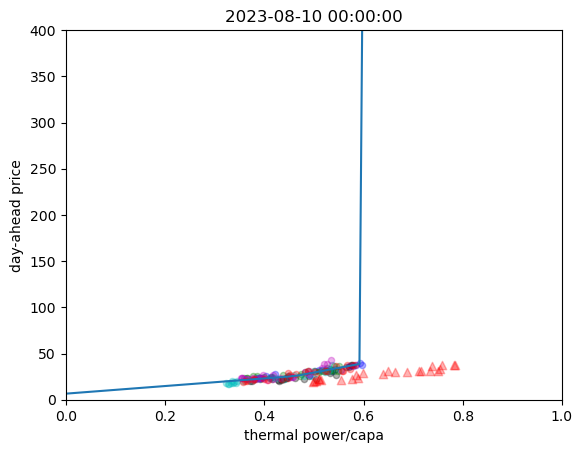

30.929681377355244
0
24.965464342030945
173.63865008995688
23.61006441810133
74.58607653699715
24.906975941503777
74.84927443913051
22.028454897790034
89.03126666207419


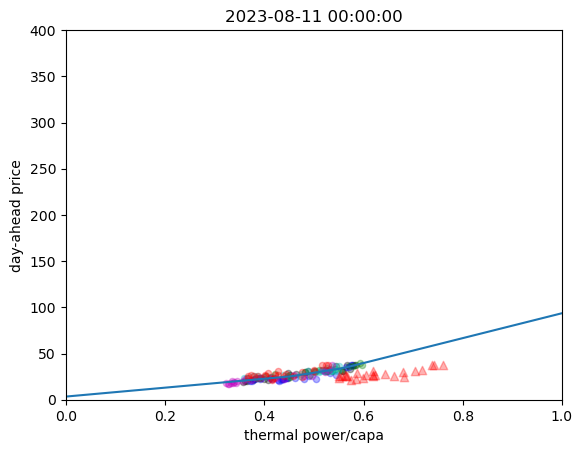

33.53943234233158
0
30.929681377364407
149.19963254965387
24.965464684528666
273.10309217177155
23.610065764284048
113.32513676386202
23.369391529658156
91.14164411569047


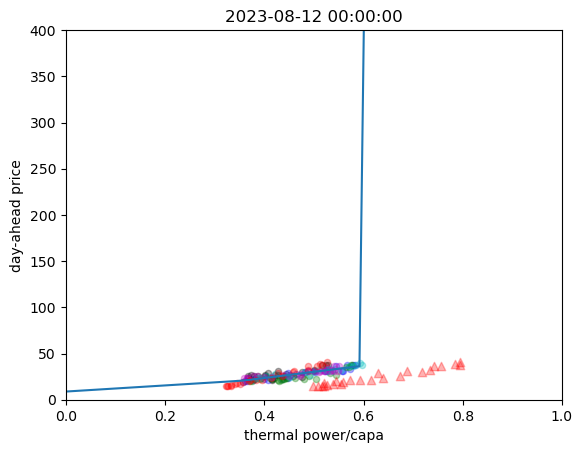

16.856286823400985
0
33.551026910550235
167.78710330966595
31.55009438575528
167.24252529376128
24.96546448767504
328.423488859487
23.610063671569296
211.9913014916042


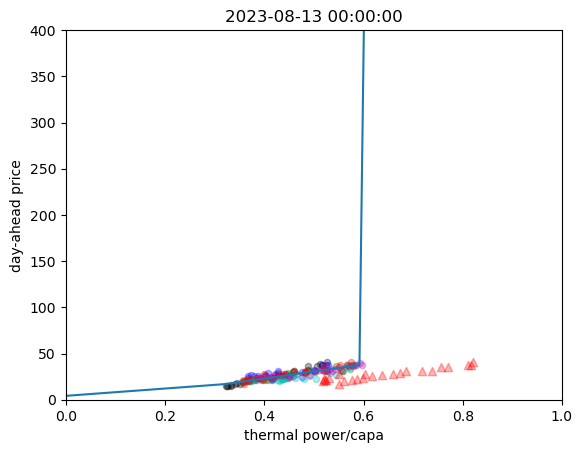

26.918068855843245
0
16.856287353150186
98.94941025098791
33.539462985060005
145.25897252782158
30.929681377357312
105.50875819665887
24.965465054632187
257.98846991725094


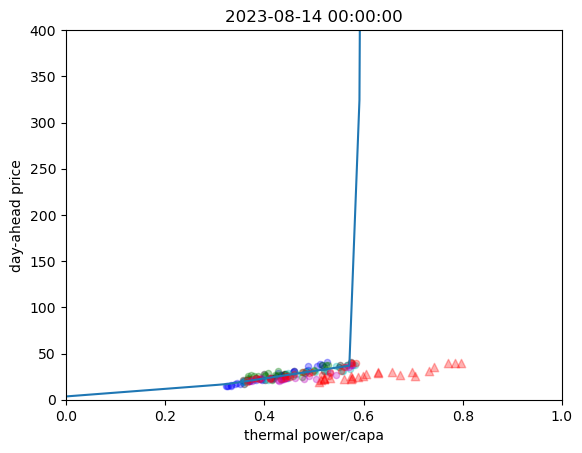

30.23578810452275
0
26.918065796454194
125.59401507313352
16.85632490370773
188.24757997134807
33.539379711437505
163.51284502410726
31.550092075555348
101.89401773428213


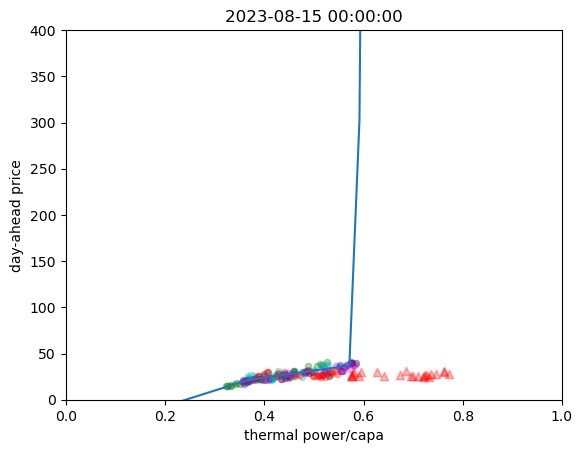

27.019354503276226
0
30.2357850250372
118.79406970107111
26.769619571219078
201.56647795777405
16.856287341091296
290.68274138449044
33.53939010822407
170.6670364057672


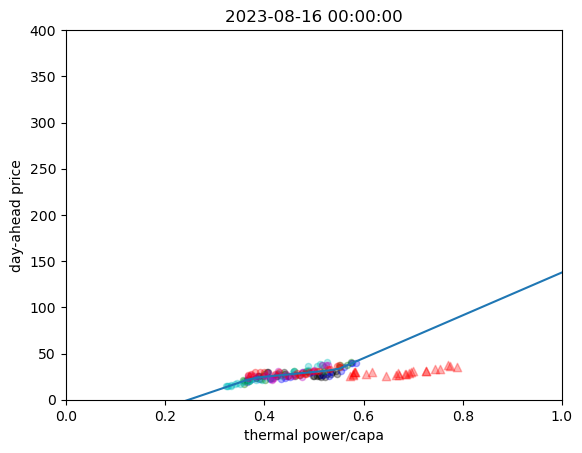

19.368555840604845
0
27.034443727032404
141.27263197250716
30.235785538475486
183.9449419992914
29.51356112764758
127.4041765791299
16.85628727840218
254.28535267750738


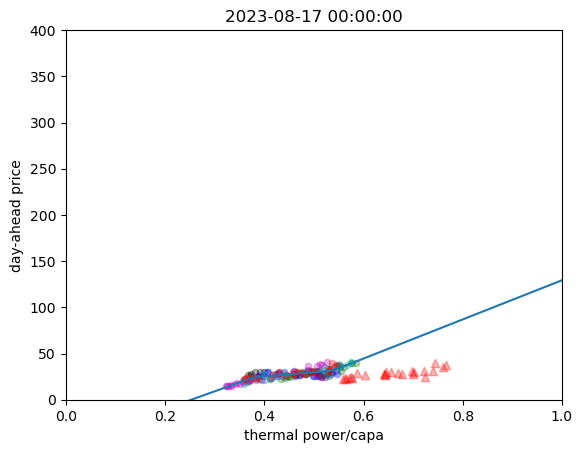

20.952172877879097
0
19.368558161365826
140.58092247331493
27.015131757617045
123.51161286051213
30.235804759045305
121.78838207414387
29.514765205115125
97.48921290359328


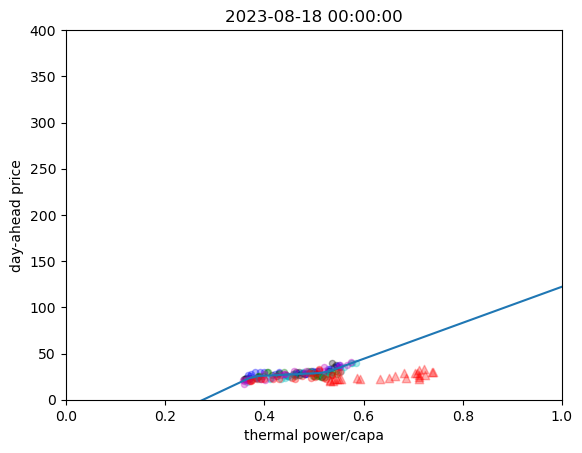

32.86283138584524
0
20.95217271879248
193.21608612097165
19.36855819669553
256.17824719051333
27.01513185887784
154.15049443975144
30.235863422598264
76.13494760842002


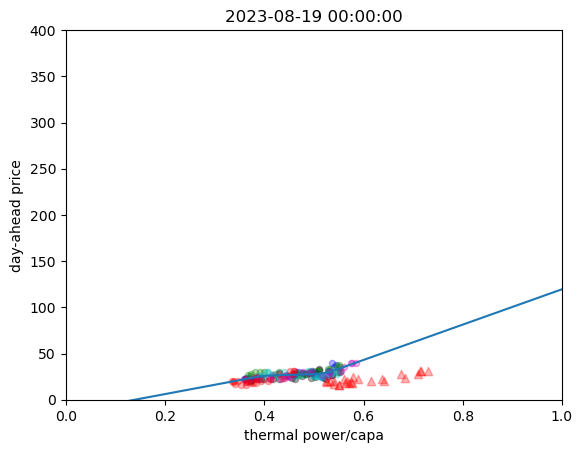

40.69368716142607
0
32.86283120169582
77.43586784707733
20.952172905997497
145.3146444585355
19.368558175152273
282.80344982574155
27.01547868951983
199.44624028106827


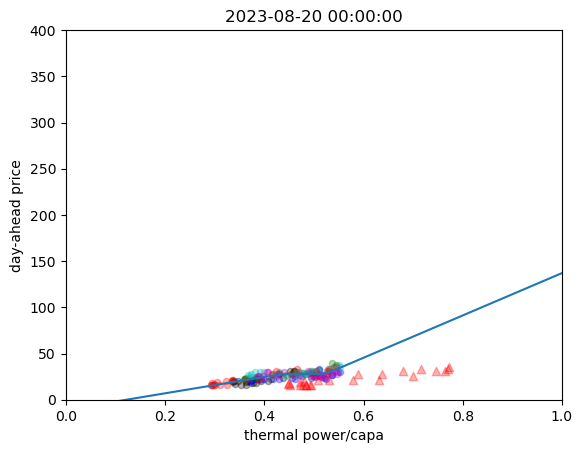

35.02812044710068
0
40.6937186666748
159.33999396652098
32.86283144689129
219.5277467025621
20.952173342935254
107.99413861643495
19.368558193188196
152.09168753083333


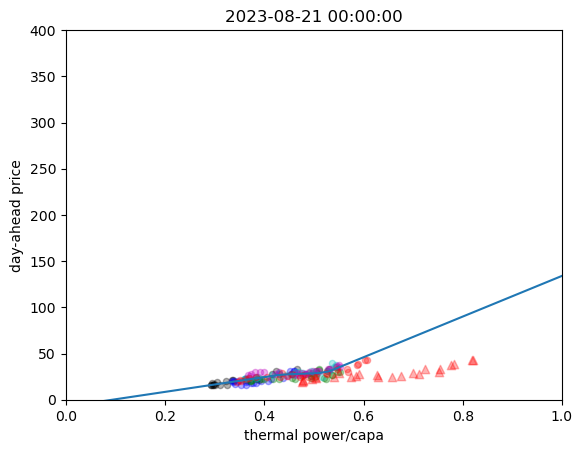

26.006464042769544
0
35.028120447119406
113.3879868204179
40.6936845359745
140.3073206780183
32.86284275750235
99.5103510216542
20.95217276435613
95.69514865779246


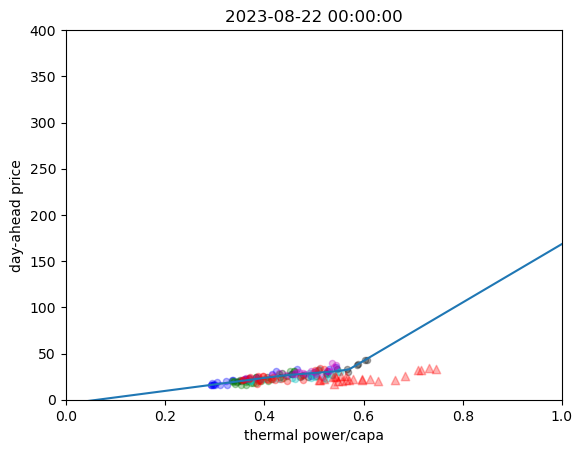

37.9468820001304
0
26.006464045124897
143.96931013142589
35.02812044712065
219.0884197469851
40.6936786166974
139.5871149938255
32.86283170036997
111.0994972850794


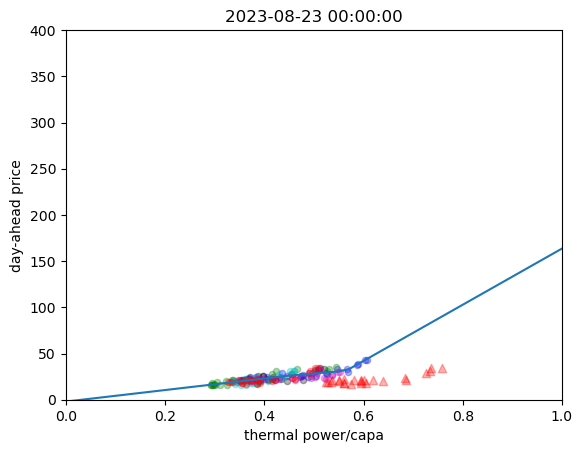

25.758209244297262
0
37.946882234416826
80.3543766007938
26.006464023899937
195.1608401754009
35.028120447226
265.42333009567665
40.69363410203999
105.46172463292959


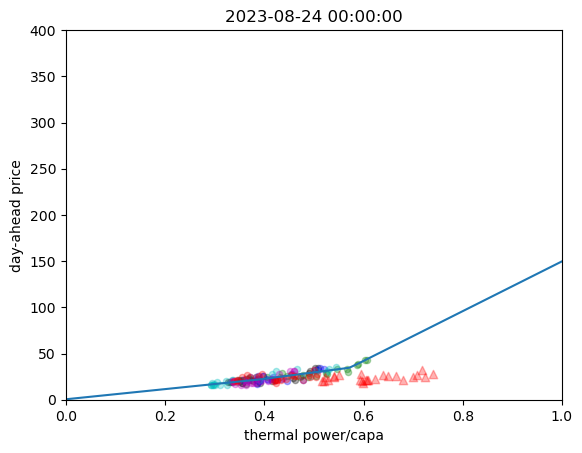

35.56945605821855
0
25.75820155756611
162.74043367292566
37.94688606242502
118.37406920128686
26.006463871383975
123.78464788677383
35.028120447121026
206.40468930398487


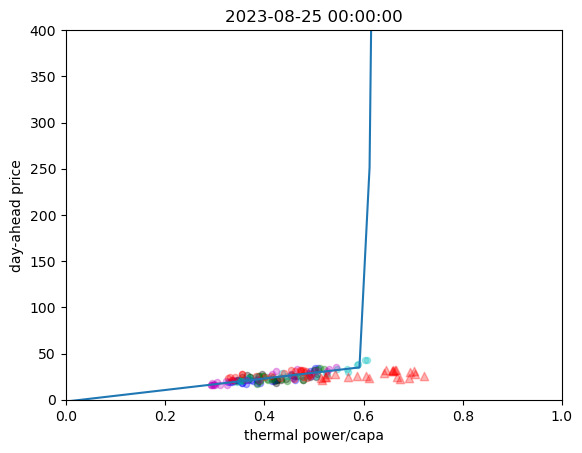

48.14136554810135
0
35.569536270073584
166.8806213995522
25.75820160023692
273.70939372092164
37.946883896698644
211.26112949211932
26.006464025913697
93.30619375816431


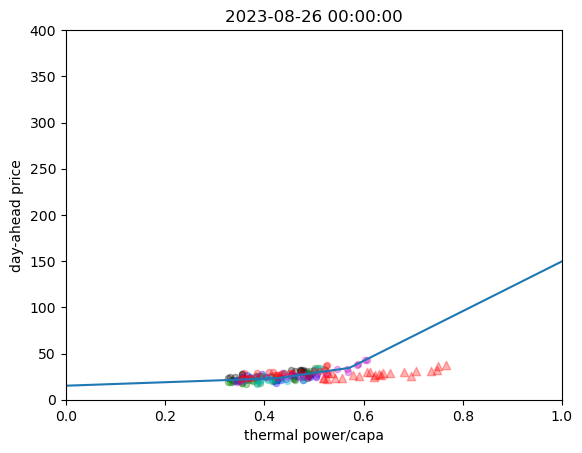

32.991206539429996
0
48.14135641690097
62.0327359936187
35.56931733127202
167.02054913163101
25.758199932937284
267.74716630243086
37.94688277049678
188.69460420877712


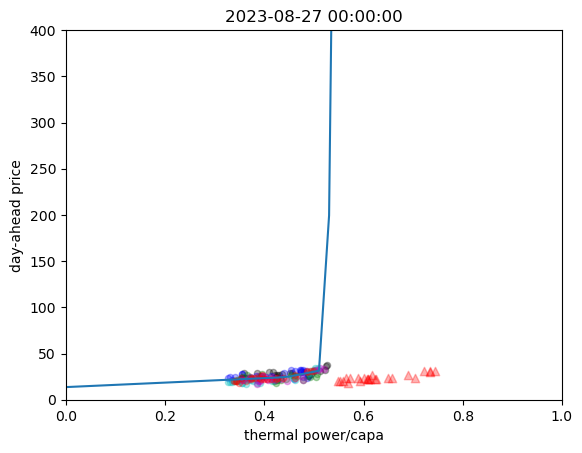

23.768321081800778
0
32.991206539429115
175.5696523365397
48.14133883833229
165.55066782711776
35.569387394573056
114.91670138354446
25.758202872448113
117.11348812928335


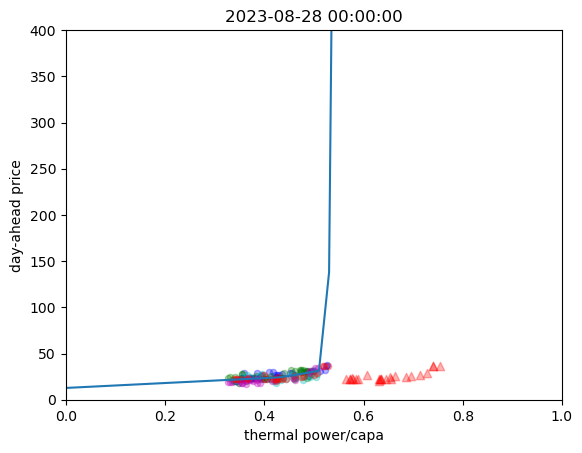

20.77267442721113
0
23.76835515700633
80.31943072715616
32.99120653943062
183.99371598795122
48.14134110366781
177.55307425055648
35.569836546651594
96.36682120347048


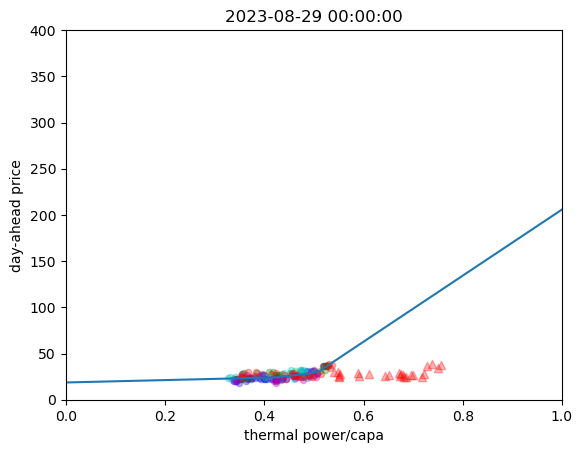

29.87616219242921
0
20.772674439922756
171.44689594991647
23.76832157317288
184.7175743046452
32.99120653943069
101.5267273443336
48.14133669621696
89.84084590461467


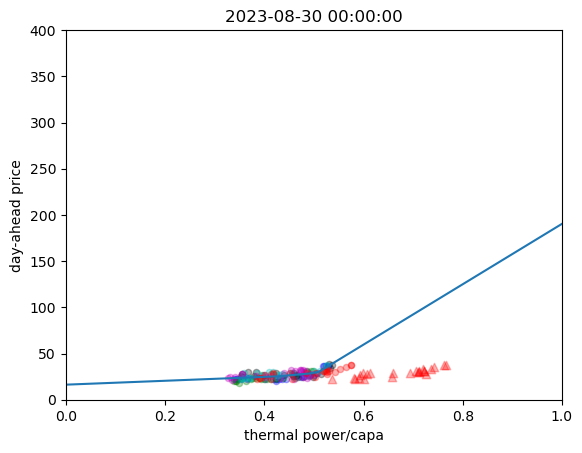

32.26728608574768
0
29.876161816155587
126.47365354383854
20.772674331095015
156.8788780634784
23.768319606268165
180.5046103069373
32.991206539431495
123.25573989760821


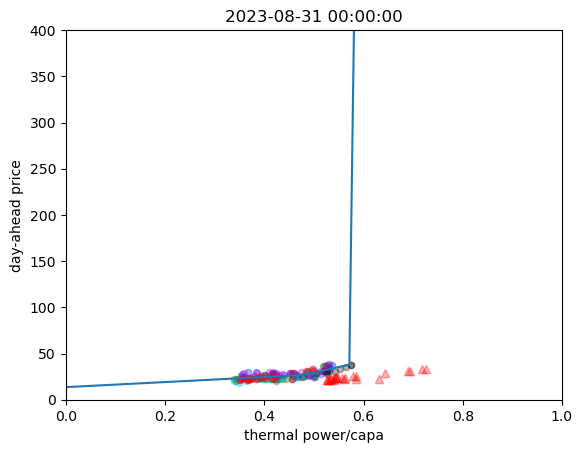

23.504692115965096
0
32.26728571739627
178.91159287742857
29.87618443446751
178.5741717023238
20.772674331922246
106.29448858105636
23.768322322582215
41.83806655510328


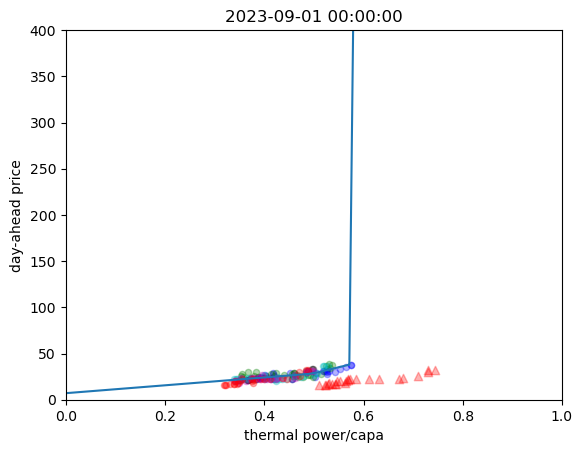

22.268722898467537
0
23.499726520939614
72.89260880817017
32.267285407701
225.93440974059843
29.876162195001903
237.93329139662652
20.772674340113706
111.48103318976007


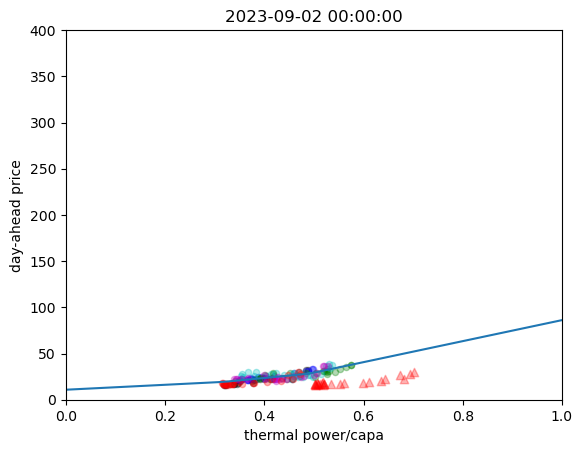

20.43985328693236
0
22.268729911143495
78.84208457297052
23.500455043816203
151.08179083891255
32.267285111992095
286.35627263186313
29.88286871969072
309.0835316867774


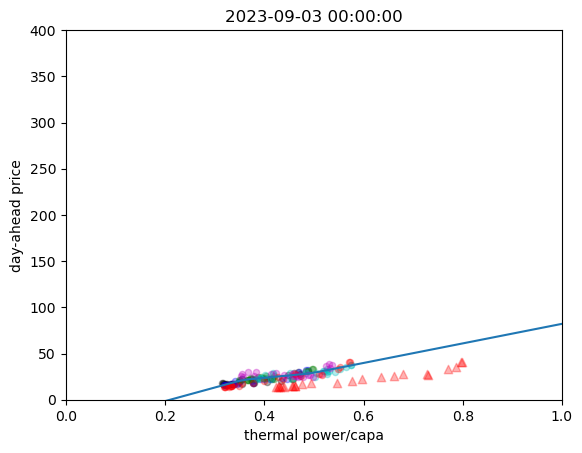

13.00005888864439
0
20.439874167548467
66.00057521418597
22.26872290193603
91.90704325561487
21.20980691180256
149.65777703778045
32.267129569128244
151.62591273313237


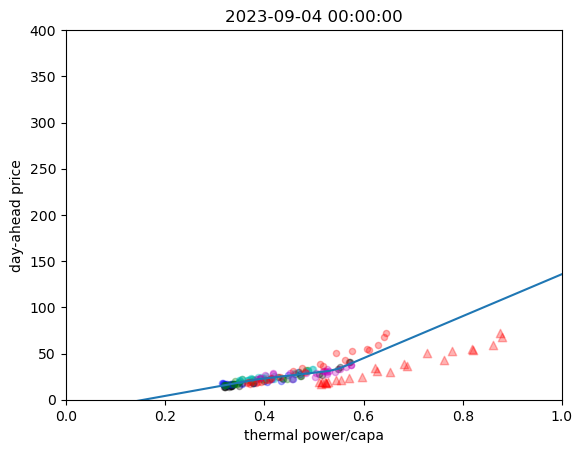

32.678675390771105
0
13.000066582646104
305.1647891366373
20.439616206936222
128.77035016262036
22.268722865162452
147.1370422797064
21.20980691180375
144.41017317631008


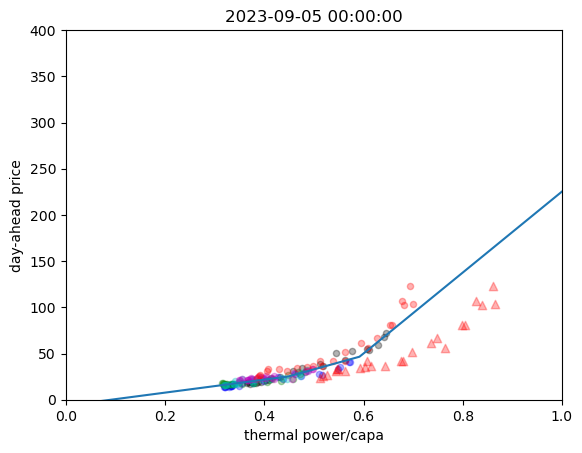

76.90229914450632
0
32.67869250909702
166.82233466422133
12.999696432467845
516.6384656767492
20.439844919852536
430.52978673621607
22.268722903963116
379.40634532790676


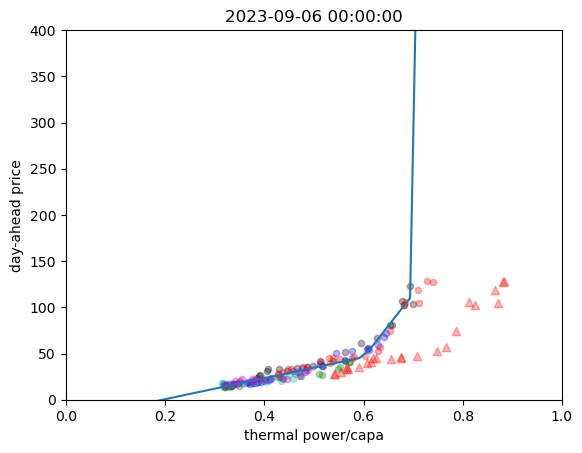

49.47152299890998
0
76.90230040504525
207.7071624564113
32.67867546661104
130.53635259236307
12.99965275624761
457.4968672815353
20.43985754248131
372.3429623401825


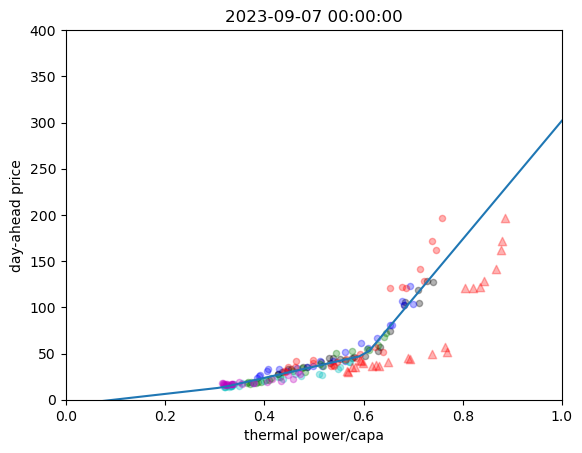

135.34237697516625
0
49.47156044512551
506.7265371742851
76.90229915677651
384.571684875624
32.67867533676322
203.95863039228732
13.000066090126744
496.03871206297833


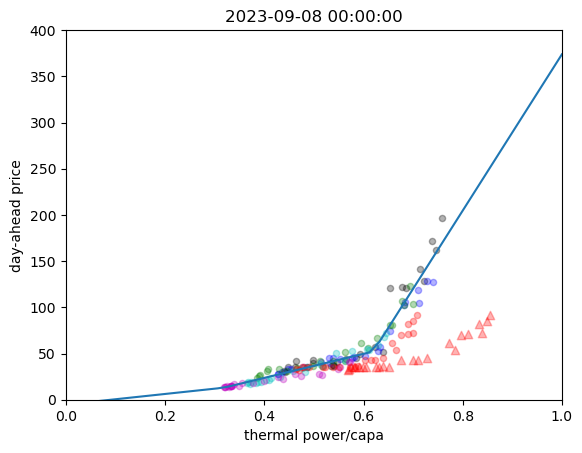

58.91221865523863
0
135.34237697522076
921.9898665098881
49.47127800926084
609.2765526112578
76.90231215297386
795.9622169117316
32.678676682067774
459.63907902512364


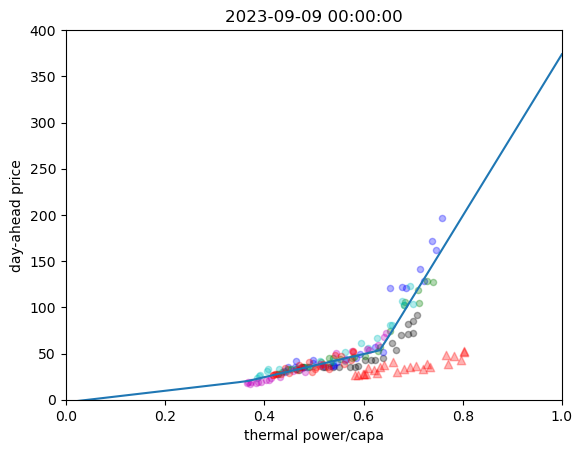

60.32605362294906
0
58.912219485216795
249.71916481373185
135.34237697506103
102.5309156313366
49.47137636625419
92.04590658900246
76.90230586528881
144.50376051178236


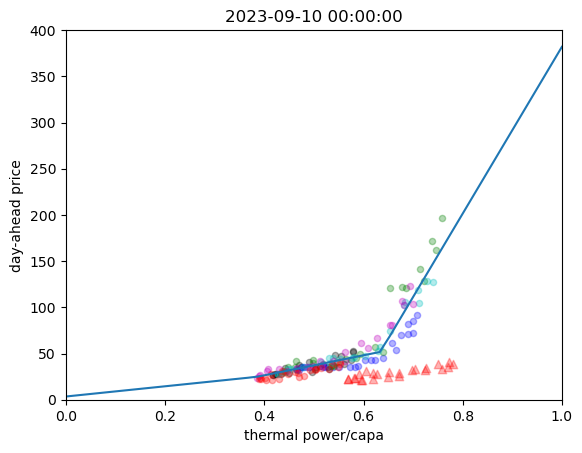

39.44888647662566
0
60.326053623060275
197.65158000501503
58.912225850562834
162.5908147513452
135.3423769753451
299.46246429726637
49.47154658236586
253.4989676288033


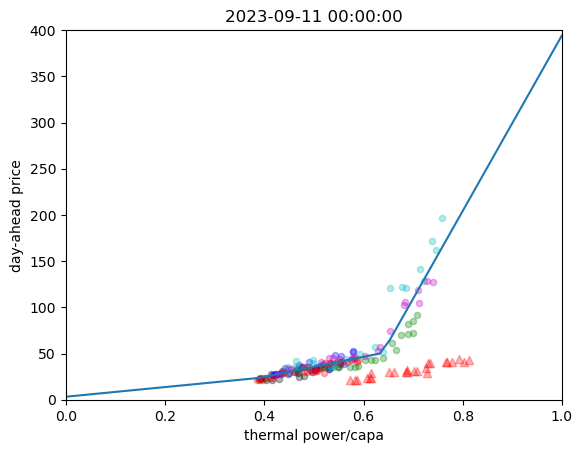

24.842143618783123
0
39.448906981312305
73.82275888074597
60.32605362292121
196.01611205560968
58.912140453149355
238.267032789952
135.34237697516562
238.68852234607374


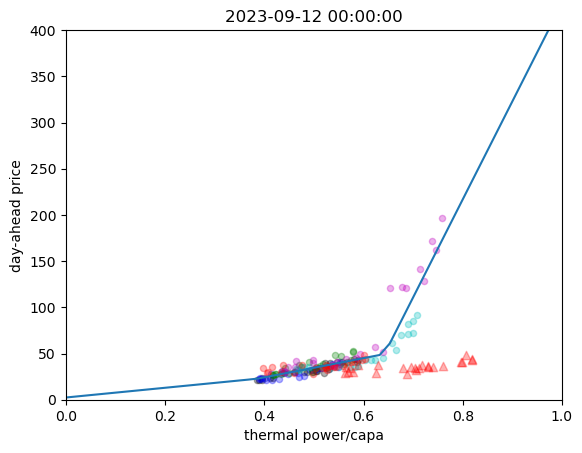

50.17566798448745
0
24.84213175692765
212.9967269849766
39.44888558818424
187.54055996254888
60.32605362291747
197.19492854802147
58.912267602799
135.435904090716


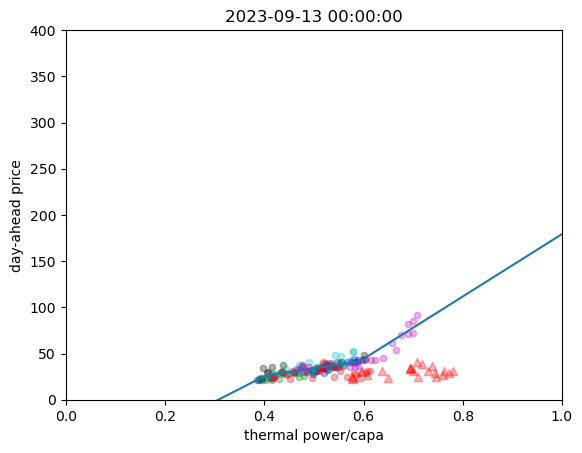

47.50789910653066
0
50.17566798446997
343.45407527647154
24.842112811348663
246.30144654413348
39.44888958450284
113.20427625442935
60.32605362298487
359.146426675356


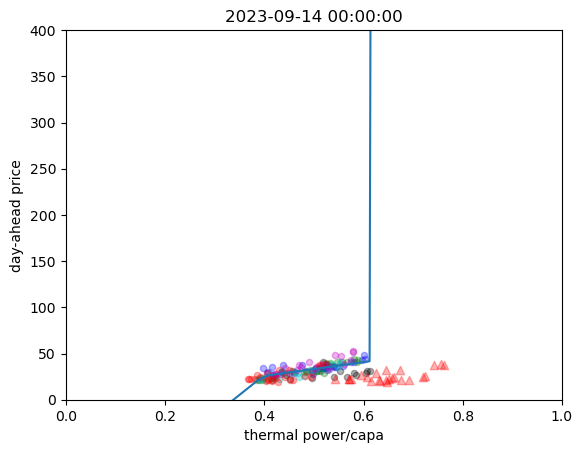

53.418708102665974
0
47.507903393472546
185.093981904457
50.175667984468916
380.6885590709612
24.842139723791117
141.73299196907095
39.44888760010407
155.67622410950233


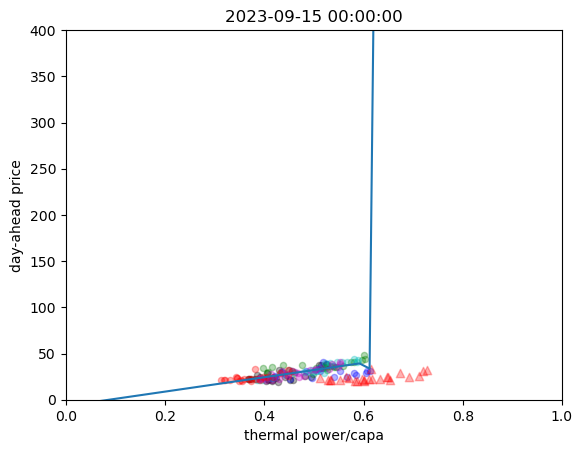

32.6177642146514
0
53.41870810263407
119.84868001434789
47.56680811428444
96.21926208887479
50.1756679844746
270.7764504412934
24.842125307756252
107.98896280164536


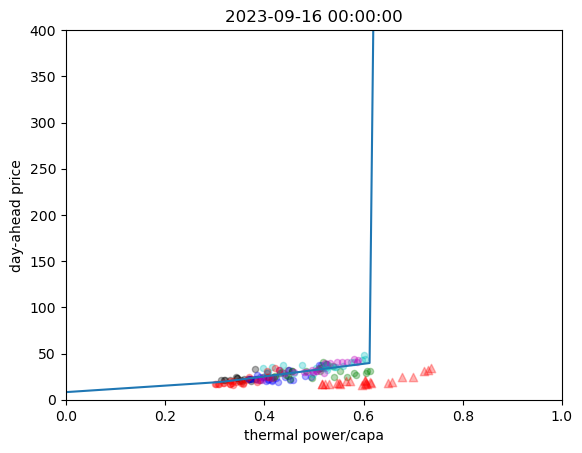

34.81076026880291
0
32.61897674779675
170.20013559476223
53.418708102641645
227.7981202665037
47.50790448185231
438.86867804137387
50.175667984479034
128.74421490131047


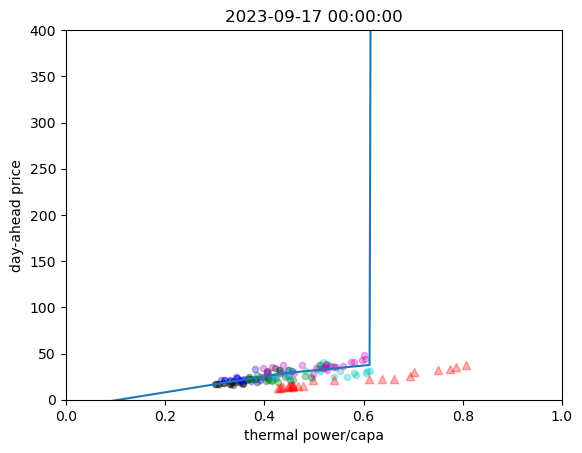

ValueError: bounds should be a sequence containing real valued (min, max) pairs for each value in x

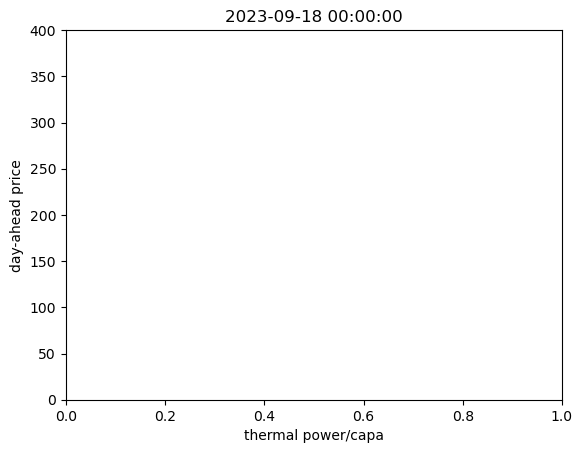

In [66]:
record = []
count = 0
tmp_record = []
color = ['k', 'b', 'g', 'c', 'm']
pd.set_option('mode.chained_assignment', None)
for _ in pd.date_range(pd.to_datetime('2023/1/1'),pd.to_datetime('2023/10/31')):
    X = np.array([])
    Y = np.array([])
    X1 = np.array([])
    Y1 = np.array([])
    tmp_model = 0
    model_dis = 0
    min1, max1, min2, max2 = 0, 0, 0, 0
    t = 0
    plt.cla()
    plt.xlim(0,1)
    plt.ylim(0,400)
    plt.xlabel('thermal power/capa')
    plt.ylabel('day-ahead price')
    plt.title('{}'.format(_))
    for __ in range(1, 6):
        date = _ - datetime.timedelta(__)
        df10 = get_price_data(date)['Locational Marginal Price']
        df11 = get_predpower_predcapa(date)['thermal/capa']
        df12 = pd.concat([df11, df10], axis=1)
        df12[df12['Locational Marginal Price'] < 0] = np.nan
        df12[df12['Locational Marginal Price'] > 450] = np.nan
        df12 = df12.dropna(how='all')
        tmp1 = df12[df12['Locational Marginal Price'] <10]
        if tmp1.shape[0]:
            for x, y in zip(tmp1['thermal/capa'], tmp1['Locational Marginal Price']):
                newrow = pd.DataFrame(np.repeat([[x,y]],math.exp((10-y)/10)*10,axis=0))
                newrow.columns = ['thermal/capa', 'Locational Marginal Price']
                df12 = pd.concat([df12, newrow])
        y = df12['Locational Marginal Price'].values
        x = df12['thermal/capa'].values.astype(float)
        # print(x,y)
        if np.isnan(x).any() or np.isnan(y).any():
            continue
        model = simulate_by_3_part_line(x, y)
        print(evaluate_model_accu(model, x, y))
        if evaluate_model_accu(model, x, y) > 500:
            continue
        if not tmp_model:
            min1, max1 = min(x), max(x)
            tmp_model = model
        else:
            min2, max2 = min(x), max(x)
            up = min(max1, max2)
            down = max(min1, min2)
            model_dis = evaluate_model_dist(tmp_model, model, down, up)
        print(model_dis)
        if model_dis > 7000:
            print('search {} days for 3 part'.format(__-1))
            break
        X = np.append(X, x)
        Y = np.append(Y, y)
        if t < 5:    
            plt.scatter(x, y, s = 20, alpha = 0.3, color = color[t])
            t += 1
        # if __ > 2:
        #     df10 = get_price_data(date)['realtime_price']
        #     df11 = get_pred_load_data5(date)['gap/capa']
        #     df12 = pd.concat([df11, df10], axis=1)
        #     df12[df12['realtime_price'] < 60] = np.nan
        #     df12[df12['realtime_price'] > 1450] = np.nan
        #     df12 = df12.dropna(how='all')
        #     tmp1 = df12[df12['realtime_price'] <200]
        #     if tmp1.shape[0]:
        #         for x, y in zip(tmp1['gap/capa'], tmp1['realtime_price']):
        #             newrow = pd.DataFrame(np.repeat([[x,y]],math.exp((60-y)/60)*100,axis=0))
        #             newrow.columns = ['gap/capa', 'realtime_price']
        #             df12 = pd.concat([df12, newrow])
        #     y = df12['realtime_price']
        #     x = df12['gap/capa']
        #     if np.isnan(x).all() or np.isnan(y).all():
        #         continue
        #     plt.scatter(x, y, s = 20, alpha = 0.3, color = 'y')
        #     X = np.append(X, x)
        #     Y = np.append(Y, y)
    if not(np.isnan(X).all() or np.isnan(Y).all()):
        myPWLF, [midpoint1, midpoint2] = simulate_by_3_part_line1(X,Y)
    else:
        continue
    x = get_predpower_predcapa(_)['thermal/capa']
    y = get_price_data(_)['Locational Marginal Price']
    x, y = np.array(pd.DataFrame(np.append(x,y).reshape(2,-1)).T.dropna().T)[0,:].astype(float), np.array(pd.DataFrame(np.append(x,y).reshape(2,-1)).T.dropna().T)[1,:].astype(float)
    if not(np.isnan(x).all() or np.isnan(y).all()):
        plt.scatter(x, y, s = 20, alpha = 0.3, color='r')
        y_real = get_price_data(_)['Locational Marginal Price']
        x_real = get_realpower_realcapa(_)['thermal/capa']
        if not(np.isnan(x_real).all()):
#         x_real = get_pred_load_data(_)['thermal/capa']
            plt.scatter(x_real, y_real, marker='^', alpha = 0.3, color='r')
    s1, s2, s3 = myPWLF.calc_slopes()
    if midpoint1 > midpoint2:
        midpoint1, midpoint2 = midpoint2, midpoint1
    # if not s3>s2+50>50:
    #     # X = np.append(X, [min(X)-0.01 for i in range(60)])
    #     # Y = np.append(Y, [0 for i in range(60)])
    #     X = np.append(X, [max(X)+0.01 for i in range(20)])
    #     Y = np.append(Y, [500 for i in range(20)])
    #     myPWLF, [midpoint1, midpoint2] = simulate_by_3_part_line1(X,Y)
    #     s1, s2, s3 = myPWLF.calc_slopes()
    xd = np.linspace(0, 1)
    plt.plot(xd, myPWLF.predict(xd))
    plt.show()
    


In [23]:
df_real = pd.merge(df_real_load, df_price, how='inner', on=['Date', 'Hour Ending'])
df_real = pd.merge(df_real, df_wind_generation, how='inner', on=['Date', 'Hour Ending'])
# df_capa.drop(['Hour Ending'], axis=1, inplace=True)
df_real = pd.merge(df_real, df_capa, how='inner', on=['Date'])
df_real.drop(['year', 'local_day', 'local_hour_end'], axis=1, inplace=True)
tmp_col = df_real.pop('Locational Marginal Price')
df_real['Locational Marginal Price'] = tmp_col
df_real['Date'] = pd.to_datetime(df_real['Date']) + pd.to_timedelta(df_real['Hour Ending'], unit='h')
df_real.drop(['Hour Ending'], axis=1, inplace=True)
df_real.to_csv('E:\day-ahead price\Data\ISO_New_England\cleared data/df_real.csv', index=False)
df_real

,Date,Day-Ahead Cleared Demand,Energy Component,Congestion Component,Marginal Loss Component,tot_wind_mwh,_FREQ_,Capacity Supply Obligation,Capacity Additions EcoMax Bid CSO,Generation Outages and Reductions,...,Uncommitted Available DRR,Net Deliveries,Total Available Capacity,Peak Load Forecast,Total Operating Reserve Requirements,Capacity Required,Surplus Deficiency,Replacement Reserve Requirement,Excess Commitment Surplus Deficiency,Locational Marginal Price
0,2023-01-01 01:00:00,9825.0,31.28,0.000000,-0.190831,233.564,54,28274.0,3160.0,3108.0,...,12.0,-3119.0,18632.0,14610.0,2475.0,17085.0,1547.0,180.0,1367.0,31.089169
1,2023-01-01 02:00:00,9322.0,28.44,0.000000,-0.165255,234.742,54,28274.0,3160.0,3108.0,...,12.0,-3119.0,18632.0,14610.0,2475.0,17085.0,1547.0,180.0,1367.0,28.274745
2,2023-01-01 03:00:00,9366.0,26.83,0.000000,-0.155929,289.882,56,28274.0,3160.0,3108.0,...,12.0,-3119.0,18632.0,14610.0,2475.0,17085.0,1547.0,180.0,1367.0,26.674071
3,2023-01-01 04:00:00,9316.0,28.19,0.000000,-0.158923,356.773,53,28274.0,3160.0,3108.0,...,12.0,-3119.0,18632.0,14610.0,2475.0,17085.0,1547.0,180.0,1367.0,28.031077
4,2023-01-01 05:00:00,9668.0,29.70,0.000000,-0.158569,409.672,57,28274.0,3160.0,3108.0,...,12.0,-3119.0,18632.0,14610.0,2475.0,17085.0,1547.0,180.0,1367.0,29.541431
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6547,2023-09-30 20:00:00,12666.0,30.98,0.000000,-0.104490,77.428,41,28076.0,1496.0,6365.0,...,12.0,-232.0,15963.0,12900.0,2111.0,15011.0,952.0,160.0,792.0,30.875510
6548,2023-09-30 21:00:00,12238.0,26.45,0.000000,-0.070411,97.503,41,28076.0,1496.0,6365.0,...,12.0,-232.0,15963.0,12900.0,2111.0,15011.0,952.0,160.0,792.0,26.379589
6549,2023-09-30 22:00:00,12047.0,24.97,0.000000,-0.050814,97.517,41,28076.0,1496.0,6365.0,...,12.0,-232.0,15963.0,12900.0,2111.0,15011.0,952.0,160.0,792.0,24.919186
6550,2023-09-30 23:00:00,11311.0,22.66,0.000000,-0.025288,95.512,44,28076.0,1496.0,6365.0,...,12.0,-232.0,15963.0,12900.0,2111.0,15011.0,952.0,160.0,792.0,22.634712
